In [1]:
!pwd

/Users/macbook/divtel/SST


In [2]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload
%matplotlib inline
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
import sys
from ipywidgets import interactive, FloatSlider, interact, fixed
from divtel import *
import copy
import astropy.units as u
from astropy.coordinates import SkyCoord
from astroplan.plots import plot_sky
from astroplan import FixedTarget
#from . import utils
#from .const import COLORS
#from . import pointing

from matplotlib.transforms import Affine2D
from astropy.visualization.wcsaxes import SphericalCircle

import healpy as hp
import tqdm

#!jupyter labextension install @jupyter-widgets/jupyterlab-manager

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


## LOAD CTA CONFIG

In [3]:
cta = CTA_Info('south')

Observer         :  CTA South
Location         :  Paranal , (1946.635798, -5467.63394562, -2642.49852123) km
Observation time :  2025-02-21T12:35:51.241


In [4]:
# Note that if the radius is in meters, 
# you can set LoadConfig(file, radius="meters")
# defalut is in degrees

array = LoadConfig("/Users/macbook/divtel/Paranal_only_SST.txt", frame=cta)


## Check configuration table

In [5]:
array.table.units = "deg"
array.table


id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,199.0,0.0,16.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,200.19
2,-230.0,0.0,22.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,229.36
3,-249.0,-325.0,40.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.12
4,-249.0,325.0,17.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.16
5,-249.0,-577.0,54.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.62
6,-249.0,577.0,8.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.51
7,-220.0,-797.0,68.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,827.51
8,-220.0,797.0,10.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,826.84


In [6]:
table=array.table

## Check the telescope spatial distribution
This is useful to pick the groups

In [7]:
array.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,199.0,0.0,16.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,200.19
2,-230.0,0.0,22.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,229.36
3,-249.0,-325.0,40.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.12
4,-249.0,325.0,17.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.16
5,-249.0,-577.0,54.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.62
6,-249.0,577.0,8.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.51
7,-220.0,-797.0,68.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,827.51
8,-220.0,797.0,10.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,826.84


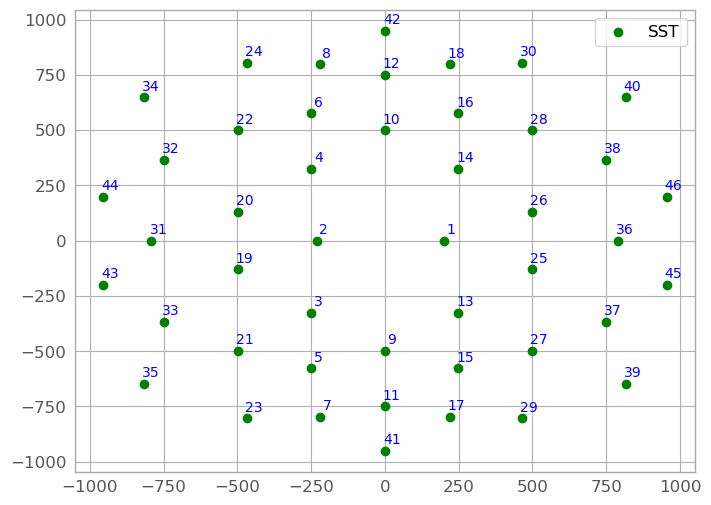

In [8]:
# Loop through all the telescopes
#for fov in array.table["fov"]:
#    print(fov)
colors = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}
for i in range(len(array.table)):
    plt.scatter(array.table['x'][i], array.table['y'][i], c=colors[i], label=fov_labels[colors[i]])

    # Annotate each point with the telescope ID
    #matplotlib.pyplot.annotate(text, xy, xytext=None, xycoords='data', textcoords=None, arrowprops=None, annotation_clip=None, **kwargs)
#Annotate the point xy with text text.
#In the simplest form, the text is placed at xy.
    plt.annotate(str(array.table["id"][i]),
                 (array.table['x'][i], array.table['y'][i]),  # Point position
                 textcoords="offset points",  # Text position relative to the point
                 xytext=(5, 5),  # Offset in pixels (to avoid overlapping the point)
                 ha='center', fontsize=10, color='blue')
handles, labels = plt.gca().get_legend_handles_labels()
#handles, labels like this is doing
    #plt.gca() gets the current Axes object, which is where your plot is
    #.get_legend_handles_labels()
        #handles: Returns a list of the graphical elements (e.g., lines, scatter plot points) that would appear in the legend.
        # labels: Returns the text labels associated with each graphical element in handles

by_label = dict(zip(labels, handles))  # Remove duplicate labels, the dictionary by the structure takes out the double 
plt.legend(by_label.values(), by_label.keys())
#by_label.values This is pulling out the unique graphical elements
# by_label.keys  This is retrieving the unique text 
plt.savefig("./different_telescopes.png", dpi=300, bbox_inches="tight")
plt.show() 

## Check the hyper field of view (hFoV)

This is the whole telescope array hFoV maybe? (ask)

In [9]:
array.hFoV(m_cut=3) 

46it [00:07,  5.90it/s]


(62.238869377690584, 46.0)

In [10]:
#array.hFoV(m_cut=3)

## Grouping telescopes

In [11]:

sub_groups = {'1':[44,33,20], 
             '2':[43,3,21],
              '3':[35,23,15],
              '4':[10,34,24],
              '5':[19,22,14,13],
              '6':[31,6,2],
              '7':[7,12,39],
              '8':[41,4,18],
              '9':[8,16,26],
              '10':[5,27,17],
              '11':[9,30,40],
              '12':[11,36,37],
              '13':[32,42,28],
              '14':[1,38,45],
              '15':[25,29,46]
             }
sub_groups_2 = {'1':[44,35,5], 
             '2':[43,32,24],
              '3':[34,42,3],
              '4':[10,20,28],
              '5':[19,22,14,13],
              '6':[31,6,2],
              '7':[7,12,39],
              '8':[41,4,18],
              '9':[8,16,26],
              '10':[33,15,23],
              '11':[9,30,40],
              '12':[11,36,37],
              '13':[17,21,27],
              '14':[1,38,45],
              '15':[25,29,46]
             }

sub_group_2_div = {'1':[24,12,30,42,8,18], 
             '2':[44,32,34],
              '3':[43,33,35],
              '4':[23,41,29,11,7,17],
              '5':[37,39,45],
              '6':[38,40,46],
              '7':[1,25,26],
              '8':[27,28,36],
              '9':[6,10,16],
              '10':[5,9,15],
              '11':[3,4,13,14],
              '12':[2,19,20],
              '13':[21,22,31]
            
    
}
sub_group_2_div_2 = {'1':[24,12,30,42,8,18], 
             '2':[44,32,34],
              '3':[43,33,35],
              '4':[23,41,29,11,7,17],
              '5':[37,39,45],
              '6':[38,40,46],
              '7':[1,2,9,10],
              '8':[16,26,28],
              '9':[15,25,27],
              '10':[13,14,36],
              '11':[5,19,21],
              '12':[6,20,22],
              '13':[3,4,31]
            
    
}


In [12]:
def compute_center_of_gravity(group):
    x, y, z = group['x'], group['y'], group['z']
    cog_x = round(np.mean(x),2)
    cog_y = round(np.mean(y),2)
    cog_z = round(np.mean(z),2)
    return cog_x, cog_y, cog_z

# Function to create new telescope list with center of gravity
def create_new_group_list(tel_group):
    new_telescopes = []
    for group in tel_group.groups:
        print(tel_group.groups)
        print (group['focal'][0],round(group['radius'][0],2))
        #id_ = group["id"][0]
        cog = compute_center_of_gravity(group)
        focal, fov = group['focal'][0], round(group['radius'][0],2)  # Assuming same within a group
        new_telescopes.append([*cog, focal, fov])
    return new_telescopes


In [13]:
tel_group_2, labels_2, number_of_telescopes_subarray_2 =array.group_by(sub_groups_2)
#tel_group_3, labels_3 = group_by(array, group=only_MST)

In [14]:
tel_group, labels, number_of_telescopes_subarray_1 =array.group_by(sub_groups)

In [15]:
tel_group_3, labels_3, number_of_telescopes_subarray_3 =array.group_by(sub_group_2_div)
tel_group_4, labels_4, number_of_telescopes_subarray_4 =array.group_by(sub_group_2_div_2)

In [16]:
# Step 2: Create new telescope list with center of gravity
new_telescopes = create_new_group_list(tel_group)
new_telescopes_2 = create_new_group_list(tel_group_2)
new_telescopes_3 = create_new_group_list(tel_group_3)
new_telescopes_4 = create_new_group_list(tel_group_4)
#Why are you creating an extra telescope?


<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3  6  9 12 16 19 22 25 28 31 34 37 40 43 46]>
5.6 4.45
<TableGroups indices=[ 0  3 

In [17]:
# Define the file path where you want to save the output
output_file_path = './SST_file_1.txt'

# Open the file in write mode
with open(output_file_path, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
    for i, telescope in enumerate(new_telescopes):
        # Assuming telescope is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        # Write the data to the file
        #print(values)
        file.write(f"{values}\n")

print(f"New telescope data has been written to {output_file_path}")


New telescope data has been written to ./SST_file_1.txt


In [18]:
print(list(enumerate(new_telescopes_2)))

[(0, [-673.67, -342.0, 50.42, 5.6, 4.45]), (1, [-723.0, 324.0, 24.58, 5.6, 4.45]), (2, [-355.33, 424.33, 26.42, 5.6, 4.45]), (3, [0.0, 376.0, 16.58, 5.6, 4.45]), (4, [-125.0, 92.25, 21.38, 5.6, 4.45]), (5, [-423.33, 192.33, 20.42, 5.6, 4.45]), (6, [198.67, -232.0, 40.75, 5.6, 4.45]), (7, [-9.67, 57.33, 39.25, 5.6, 4.45]), (8, [176.0, 501.33, 12.42, 5.6, 4.45]), (9, [-321.67, -582.67, 57.25, 5.6, 4.45]), (10, [427.33, 317.67, 31.92, 5.6, 4.45]), (11, [512.67, -372.0, 23.58, 5.6, 4.45]), (12, [73.33, -598.33, 48.58, 5.6, 4.45]), (13, [634.0, 56.0, 10.08, 5.6, 4.45]), (14, [640.0, -245.0, 23.92, 5.6, 4.45])]


In [19]:
# Define the file path where you want to save the output
output_file_path_2 = './SST_2.txt'

# Open the file in write mode
with open(output_file_path_2, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
    for i, telescope in enumerate(new_telescopes_2):
        # Assuming telescope is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        # Write the data to the file
        #print(values)
        file.write(f"{values}\n")

print(f"New telescope data has been written to {output_file_path_2}")


New telescope data has been written to ./SST_2.txt


In [20]:
# Define the file path where you want to save the output
output_file_path_3 = './SST_2_divergences.txt'

# Open the file in write mode
with open(output_file_path_3, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
    for i, telescope in enumerate(new_telescopes_3):
        # Assuming telescope is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        # Write the data to the file
        #print(values)
        file.write(f"{values}\n")

print(f"New telescope data has been written to {output_file_path_3}")


New telescope data has been written to ./SST_2_divergences.txt


In [21]:
# Define the file path where you want to save the output
output_file_path_4 = './SST_2_divergences_try_2.txt'

# Open the file in write mode
with open(output_file_path_4, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
    for i, telescope in enumerate(new_telescopes_4):
        # Assuming telescope is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        # Write the data to the file
        #print(values)
        file.write(f"{values}\n")

print(f"New telescope data has been written to {output_file_path_4}")


New telescope data has been written to ./SST_2_divergences_try_2.txt


In [22]:
## First to start understanding what is going on I wanted to graph in the 4 plots together 

FoV_array

## PENSAR COMO AUTOMIZAR LO SIGUIENTE EL FOV CHE STUDIO TIENE QUE SER SI O SI DEL FULL ARRAY CON EL MINIMO DEL ARRAY DE TELESCOPIOS QUE TENGO PRARA PODER CONFRONTAR MEJOR. En cambio no poner ningun limite para los subarrays

In [23]:
number_of_telescopes_subarray_1

[3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]

## MULTIPLE DIVERGENCES

SST configuration with two subarrays

In [24]:
array_SST_2_diff_div= LoadConfig('./SST_2_divergences.txt', frame=cta, pointing2src=True)

In [25]:
array_SST_2_diff_div_try_2 = LoadConfig('./SST_2_divergences_try_2.txt', frame=cta, pointing2src=True)

In [26]:
array_SST_2_diff_div.table.units = "deg"
array_SST_2_diff_div.table
array_SST_2_diff_div_try_2.table.units = "deg"
array_SST_2_diff_div_try_2.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,0.0,816.83,21.83,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,816.85
2,-840.0,404.67,16.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,931.85
3,-840.0,-404.67,55.92,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.21
4,0.0,-816.83,65.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,817.70
5,839.67,-404.67,17.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.76
6,839.67,404.67,10.08,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.87
7,-7.75,0.0,22.5,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,8.77
8,415.67,402.0,12.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,578.95


In [27]:
number_of_telescopes_subarray_3

[6, 3, 3, 6, 3, 3, 3, 3, 3, 3, 4, 3, 3]

## Here I am trying to find the multiplicity for each subarray division 

In [28]:
number_of_telescopes_subarray_4

[6, 3, 3, 6, 3, 3, 4, 3, 3, 3, 3, 3, 3]

In [29]:
number_of_telescopes_subarray_3

[6, 3, 3, 6, 3, 3, 3, 3, 3, 3, 4, 3, 3]

In [30]:
table_SST_conv = []
number_of_telescopes_subarray_3_first_half=[] #Because now we have to change the place 
table_SST= array_SST_2_diff_div.table
# Append the columns for LST so I know what to get or expect
table_SST_conv.append(table_SST['x'])
table_SST_conv.append(table_SST['y'])
table_SST_conv.append(table_SST['z'])
table_SST_conv.append(table_SST['focal'])
table_SST_conv.append(table_SST['radius'])
table_SST_conv.append(table_SST['fov'])

# Initialize sub_config and other variables
sub_config = []
telescopes = [1, 2,3,4,5,6]  # Telescope indices
# Loop through the telescopes so I can write them in a file
for tel in telescopes:
    # Putting it tel-1 because the first column we had the index
    sub_config.append([col[tel - 1] for col in table_SST_conv])
    ## Here I am putting the multiplicity where it should be 
    ## I am trying to improve this so it does that in a function so it would be clearer 
    number_of_telescopes_subarray_3_first_half.append(number_of_telescopes_subarray_3[tel-1])


# Print the result for verification
print(sub_config)
print(number_of_telescopes_subarray_3_first_half)

[[0.0, 816.83, 21.83, 5.6, 4.450000000000001, 62.46242685852285], [-840.0, 404.67, 16.75, 5.6, 4.450000000000001, 62.46242685852285], [-840.0, -404.67, 55.92, 5.6, 4.450000000000001, 62.46242685852285], [0.0, -816.83, 65.42, 5.6, 4.450000000000001, 62.46242685852285], [839.67, -404.67, 17.75, 5.6, 4.450000000000001, 62.46242685852285], [839.67, 404.67, 10.08, 5.6, 4.450000000000001, 62.46242685852285]]
[6, 3, 3, 6, 3, 3]


In [31]:
table_SST_conv_2 = []
table_SST_2= array_SST_2_diff_div_try_2.table
number_of_telescopes_subarray_4_first_half=[]
# Append the columns for LST so I know what to get or expect
table_SST_conv_2.append(table_SST_2['x'])
table_SST_conv_2.append(table_SST_2['y'])
table_SST_conv_2.append(table_SST_2['z'])
table_SST_conv_2.append(table_SST_2['focal'])
table_SST_conv_2.append(table_SST_2['radius'])
table_SST_conv_2.append(table_SST_2['fov'])

# Initialize sub_config and other variables
sub_config_3 = []
telescopes = [1, 2,3,4,5,6]  # Telescope indices
# Loop through the telescopes so I can write them in a file
for tel in telescopes:
    # Putting it tel-1 because the first column we had the index
    sub_config_3.append([col[tel - 1] for col in table_SST_conv_2])
    number_of_telescopes_subarray_4_first_half.append(number_of_telescopes_subarray_4[tel-1])


# Print the result for verification
print(sub_config_3)
print(number_of_telescopes_subarray_4_first_half)

[[0.0, 816.83, 21.83, 5.6, 4.450000000000001, 62.46242685852285], [-840.0, 404.67, 16.75, 5.6, 4.450000000000001, 62.46242685852285], [-840.0, -404.67, 55.92, 5.6, 4.450000000000001, 62.46242685852285], [0.0, -816.83, 65.42, 5.6, 4.450000000000001, 62.46242685852285], [839.67, -404.67, 17.75, 5.6, 4.450000000000001, 62.46242685852285], [839.67, 404.67, 10.08, 5.6, 4.450000000000001, 62.46242685852285]]
[6, 3, 3, 6, 3, 3]


In [32]:
table_SST_div = []
table_SST= array_SST_2_diff_div.table
number_of_telescopes_subarray_3_second_half=[]
# Append the columns for LST so I know what to get or expect
table_SST_div.append(table_SST['x'])
table_SST_div.append(table_SST['y'])
table_SST_div.append(table_SST['z'])
table_SST_div.append(table_SST['focal'])
table_SST_div.append(table_SST['radius'])
table_SST_div.append(table_SST['fov'])

# Initialize sub_config and other variables
sub_config_2= []
telescopes = [7,8,9,10,11,12,13]  # Telescope indices
# Loop through the telescopes so I can write them in a file
for tel in telescopes:
    # Adjust for 1-based indexing in telescopes to 0-based indexing in Python
    sub_config_2.append([col[tel - 1] for col in table_SST_div])
    number_of_telescopes_subarray_3_second_half.append(number_of_telescopes_subarray_3[tel-1])


# Print the result for verification
print(sub_config_2)
print(number_of_telescopes_subarray_3_second_half)

[[399.0, 0.0, 12.58, 5.6, 4.450000000000001, 62.46242685852285], [596.0, 0.0, 14.92, 5.6, 4.450000000000001, 62.46242685852285], [0.0, 551.0, 12.42, 5.6, 4.450000000000001, 62.46242685852285], [0.0, -551.0, 45.08, 5.6, 4.450000000000001, 62.46242685852285], [0.0, 0.0, 25.5, 5.6, 4.450000000000001, 62.46242685852285], [-409.33, 0.0, 27.42, 5.6, 4.450000000000001, 62.46242685852285], [-596.33, 0.0, 33.25, 5.6, 4.450000000000001, 62.46242685852285]]
[3, 3, 3, 3, 4, 3, 3]


In [33]:
table_SST_div_2 = []
table_SST_2= array_SST_2_diff_div_try_2.table
number_of_telescopes_subarray_4_second_half=[]
# Append the columns for LST so I know what to get or expect
table_SST_div_2.append(table_SST_2['x'])
table_SST_div_2.append(table_SST_2['y'])
table_SST_div_2.append(table_SST_2['z'])
table_SST_div_2.append(table_SST_2['focal'])
table_SST_div_2.append(table_SST_2['radius'])
table_SST_div_2.append(table_SST_2['fov'])

# Initialize sub_config and other variables
sub_config_4= []
telescopes = [7,8,9,10,11,12,13]  # Telescope indices
# Loop through the telescopes so I can write them in a file
for tel in telescopes:
    # Adjust for 1-based indexing in telescopes to 0-based indexing in Python
    sub_config_4.append([col[tel - 1] for col in table_SST_div_2])
    number_of_telescopes_subarray_4_second_half.append(number_of_telescopes_subarray_4[tel-1])


# Print the result for verification
print(sub_config_4)
print(number_of_telescopes_subarray_4_second_half)

[[-7.75, 0.0, 22.5, 5.6, 4.450000000000001, 62.46242685852285], [415.67, 402.0, 12.42, 5.6, 4.450000000000001, 62.46242685852285], [415.67, -402.0, 27.92, 5.6, 4.450000000000001, 62.46242685852285], [429.33, 0.0, 16.08, 5.6, 4.450000000000001, 62.46242685852285], [-415.67, -402.0, 48.25, 5.6, 4.450000000000001, 62.46242685852285], [-415.67, 402.0, 15.58, 5.6, 4.450000000000001, 62.46242685852285], [-429.67, 0.0, 29.42, 5.6, 4.450000000000001, 62.46242685852285]]
[4, 3, 3, 3, 3, 3, 3]


In [34]:
# Define the file path where you want to save the output
output_file_path_3 = './SST_conv.txt'

# Open the file in write mode
with open(output_file_path_3, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
   for telescope in sub_config:
        # Assuming each telescope in sub_config is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        file.write(f"{values}\n")  # Write each row of telescope data

print(f"New telescope data has been written to {output_file_path_3}")
# Define the file path where you want to save the output
output_file_path_4 = './SST_div.txt'

# Open the file in write mode
with open(output_file_path_4, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
   for telescope in sub_config_2:
        # Assuming each telescope in sub_config is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        file.write(f"{values}\n")  # Write each row of telescope data

print(f"New telescope data has been written to {output_file_path_4}")

New telescope data has been written to ./SST_conv.txt
New telescope data has been written to ./SST_div.txt


In [35]:
# Define the file path where you want to save the output
output_file_path_5 = './SST_conv_2.txt'

# Open the file in write mode
with open(output_file_path_5, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
   for telescope in sub_config_3:
        # Assuming each telescope in sub_config is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        file.write(f"{values}\n")  # Write each row of telescope data

print(f"New telescope data has been written to {output_file_path_5}")
# Define the file path where you want to save the output
output_file_path_6 = './SST_div_2.txt'

# Open the file in write mode
with open(output_file_path_6, 'w') as file:
    
    # Write a header
    #file.write("Group ID, X_Center, Y_Center, Z_Center, Focal Length, FOV\n")
    
    # Loop through all new telescopes (grouped telescopes)
   for telescope in sub_config_4:
        # Assuming each telescope in sub_config is a list like [x_center, y_center, z_center, focal_length, fov]
        values = ' '.join(map(str, telescope))  # Convert all elements to string
        file.write(f"{values}\n")  # Write each row of telescope data

print(f"New telescope data has been written to {output_file_path_6}")

New telescope data has been written to ./SST_conv_2.txt
New telescope data has been written to ./SST_div_2.txt


In [41]:
full_array = LoadConfig("/Users/macbook/divtel/Paranal_only_SST.txt", frame=cta)

In [42]:
array_conv= LoadConfig('./SST_conv.txt', frame=cta, pointing2src=True)
array_div=LoadConfig('./SST_div.txt', frame=cta, pointing2src=True)

In [43]:
array_conv_2= LoadConfig('./SST_conv_2.txt', frame=cta, pointing2src=True)
array_div_2=LoadConfig('./SST_div_2.txt', frame=cta, pointing2src=True)

In [44]:
array_conv.table.units= "deg"
array_conv.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,0.0,816.83,21.83,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,816.88
2,-840.0,404.67,16.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.41
3,-840.0,-404.67,55.92,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.62
4,0.0,-816.83,65.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,817.54
5,839.67,-404.67,17.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.29
6,839.67,404.67,10.08,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,932.44


In [45]:
array_div.table.units='deg'
array_div.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,399.0,0.0,12.58,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,400.70
2,596.0,0.0,14.92,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,597.60
3,0.0,551.0,12.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,551.13
4,0.0,-551.0,45.08,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,551.39
5,0.0,0.0,25.5,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,1.85
6,-409.33,0.0,27.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,407.82
7,-596.33,0.0,33.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,594.87


In [46]:
full_array.table.units='deg'
full_array.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,199.0,0.0,16.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,200.19
2,-230.0,0.0,22.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,229.36
3,-249.0,-325.0,40.75,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.12
4,-249.0,325.0,17.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,409.16
5,-249.0,-577.0,54.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.62
6,-249.0,577.0,8.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,628.51
7,-220.0,-797.0,68.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,827.51
8,-220.0,797.0,10.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,826.84


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.63it/s]
7it [00:01,  6.53it/s]
6it [00:00,  6.17it/s]


12.514095936230444


7it [00:01,  6.36it/s]


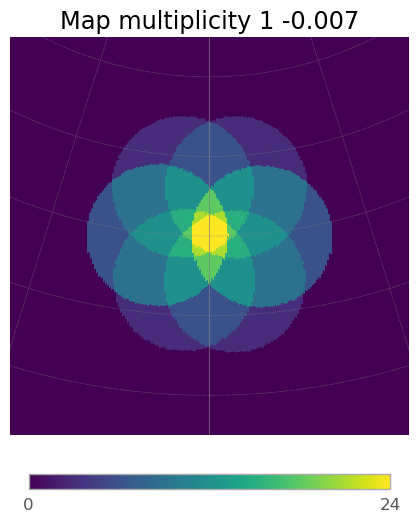

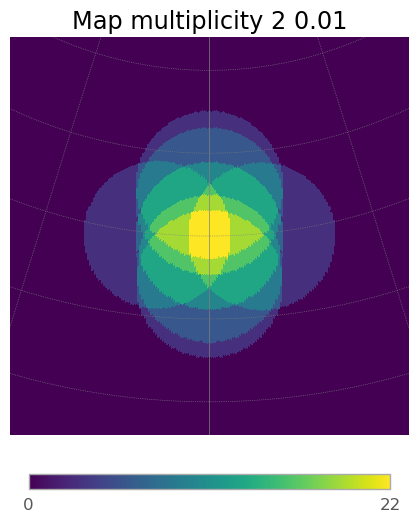

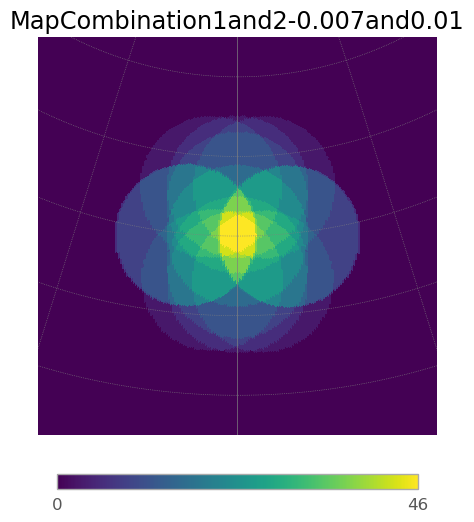

In [47]:
array_conv.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div, div1=-0.007, div2=0.01, az=0, alt=60)
array_conv.multiplicity_plot_2_div(array_div, subarray_mult_1=number_of_telescopes_subarray_3_first_half, subarray_mult_2=number_of_telescopes_subarray_3_second_half)

In [48]:
array_conv_2.table.units= "deg"
array_conv_2.table
array_div_2.table.units='deg'
array_div_2.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,-7.75,0.0,22.5,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,6.92
2,415.67,402.0,12.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,579.22
3,415.67,-402.0,27.92,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,579.10
4,429.33,0.0,16.08,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,430.57
5,-415.67,-402.0,48.25,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,577.91
6,-415.67,402.0,15.58,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,577.50
7,-429.67,0.0,29.42,0.000,0.000,90.000,5.600,4.450,62.462,1.000,-0.000,0.000,428.54


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.25it/s]
7it [00:01,  6.39it/s]
6it [00:01,  5.97it/s]


12.514095936230444


7it [00:01,  6.52it/s]


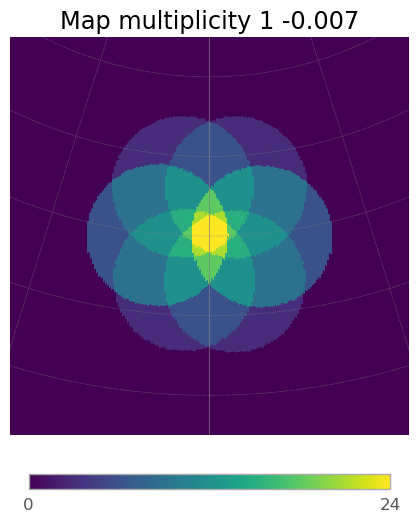

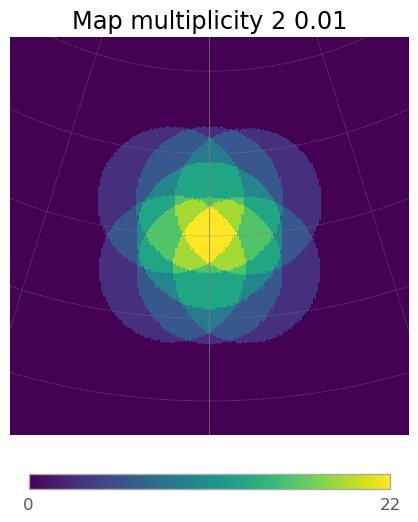

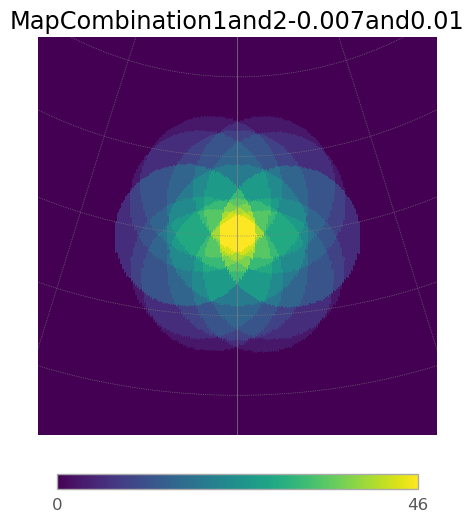

In [50]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=-0.007, div2=0.01, az=0, alt=60)
array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)

6it [00:00,  6.33it/s]
7it [00:01,  6.67it/s]
6it [00:00,  6.25it/s]
7it [00:01,  6.09it/s]
6it [00:00,  6.44it/s]
7it [00:01,  6.14it/s]
6it [00:01,  5.98it/s]


9.450044810959682


7it [00:01,  6.22it/s]


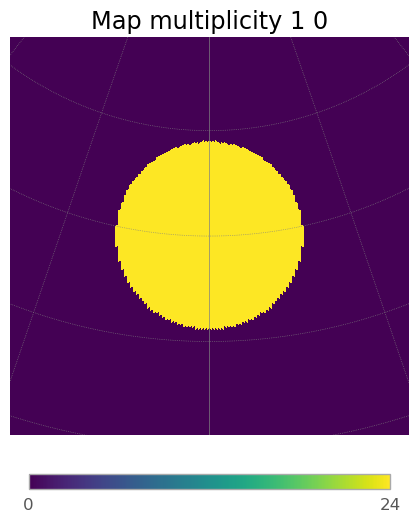

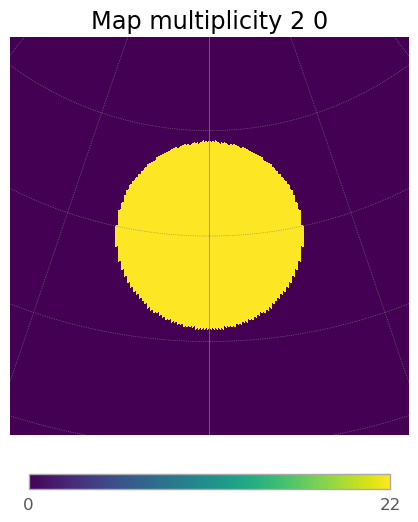

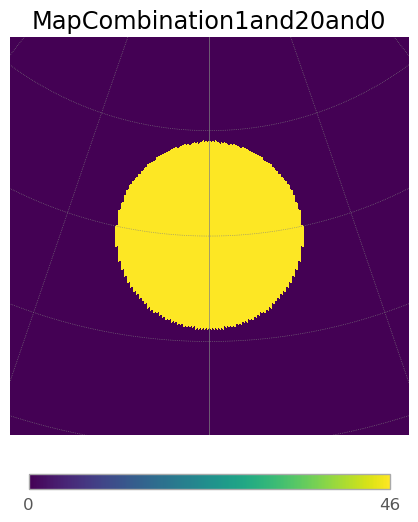

In [51]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=0, div2=0, az=0, alt=70)
FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)

In [52]:
multiplicity

46.0

In [53]:
div_too_much=np.linspace(0,0.014, 5)
div=np.linspace(0,0.014, 20)

6it [00:00,  6.43it/s]
7it [00:01,  6.25it/s]
6it [00:00,  6.24it/s]
7it [00:01,  6.30it/s]
6it [00:00,  6.00it/s]
7it [00:01,  6.11it/s]
6it [00:00,  6.19it/s]


9.450044810959682


7it [00:01,  5.86it/s]


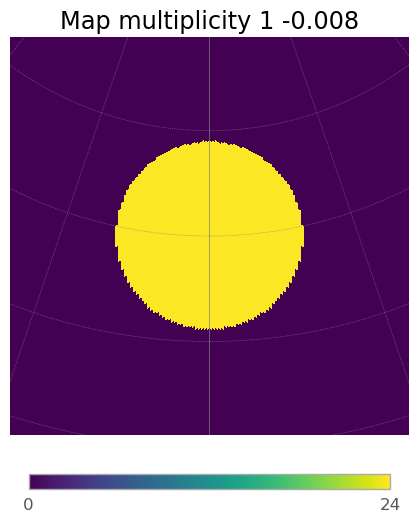

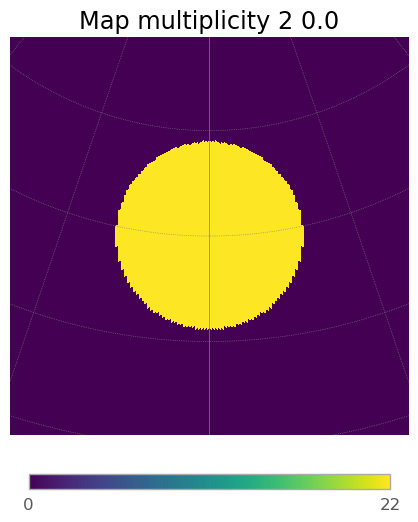

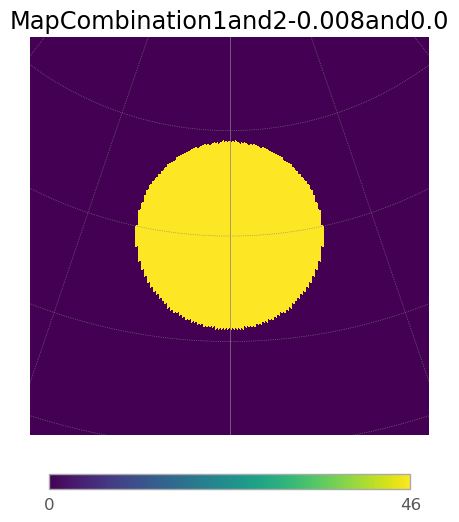

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.69it/s]
7it [00:01,  5.92it/s]
6it [00:00,  6.06it/s]
7it [00:01,  6.24it/s]
6it [00:00,  6.03it/s]
7it [00:01,  6.19it/s]
6it [00:01,  5.85it/s]


13.07274650697345


7it [00:01,  6.09it/s]


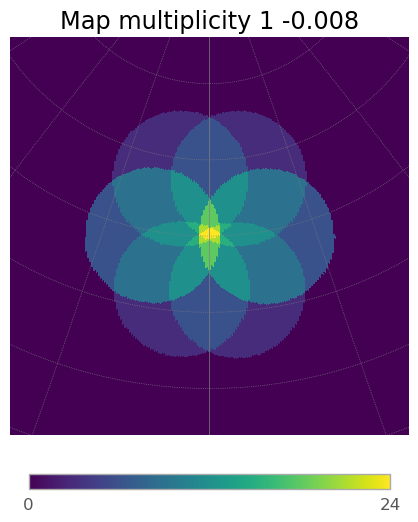

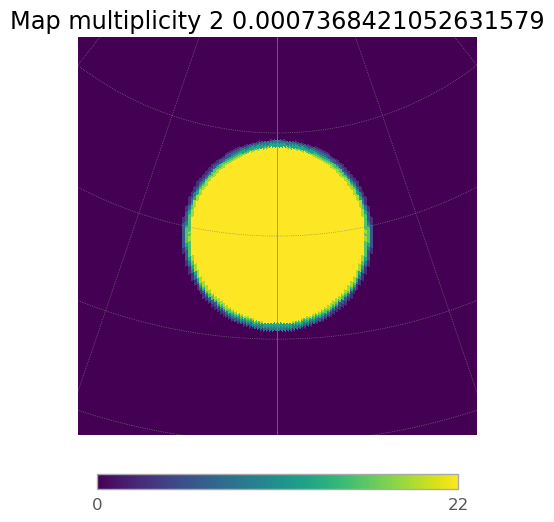

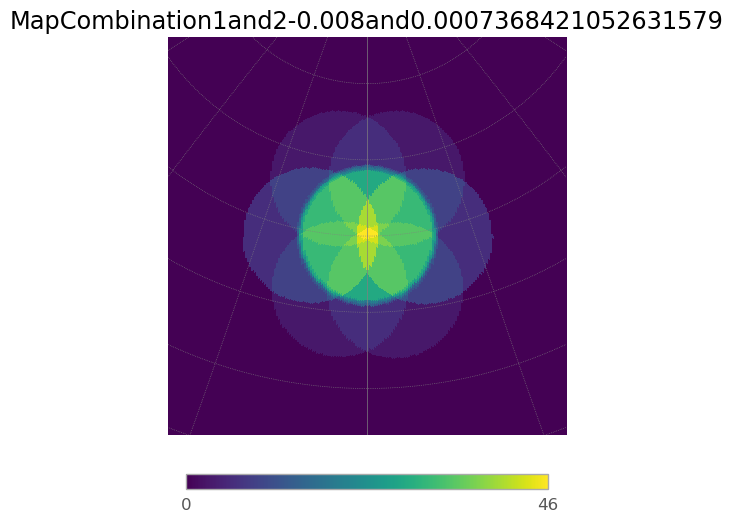

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.76it/s]
7it [00:01,  6.16it/s]
6it [00:01,  5.77it/s]
7it [00:01,  5.80it/s]
6it [00:00,  6.13it/s]
7it [00:01,  6.16it/s]
6it [00:01,  5.75it/s]


13.07274650697345


7it [00:01,  5.93it/s]


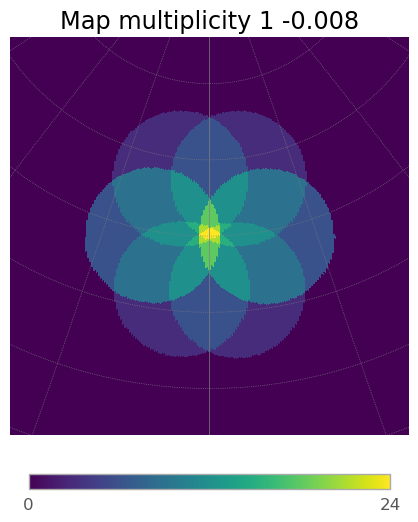

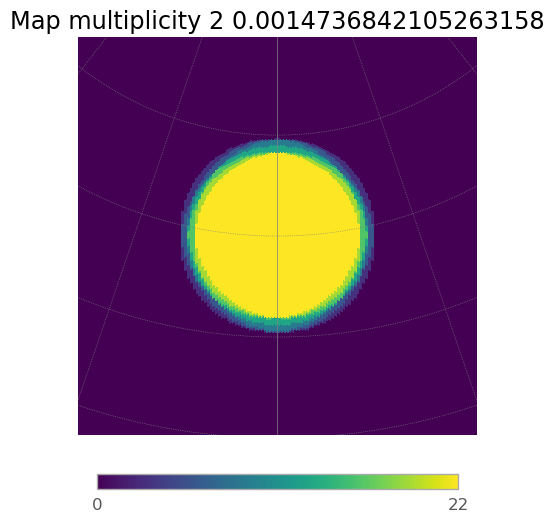

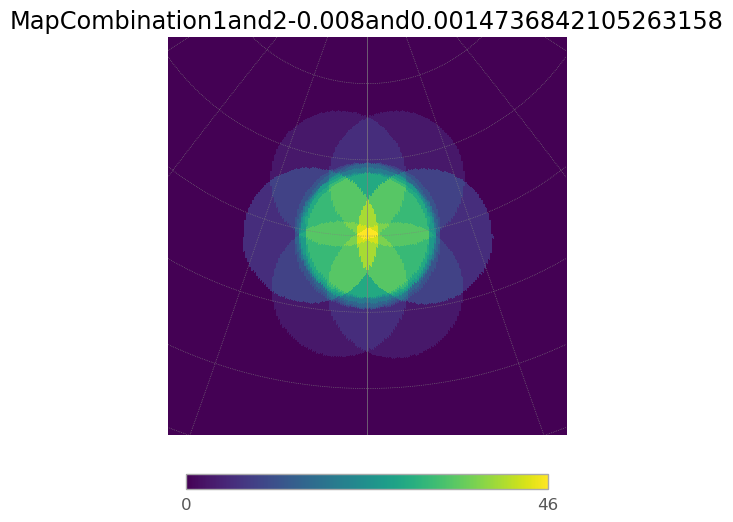

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.67it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.91it/s]
7it [00:01,  6.28it/s]
6it [00:01,  5.96it/s]
7it [00:01,  6.00it/s]
6it [00:01,  5.83it/s]


13.07274650697345


7it [00:01,  5.88it/s]


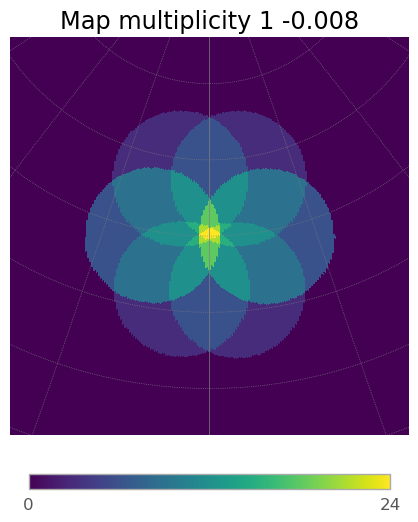

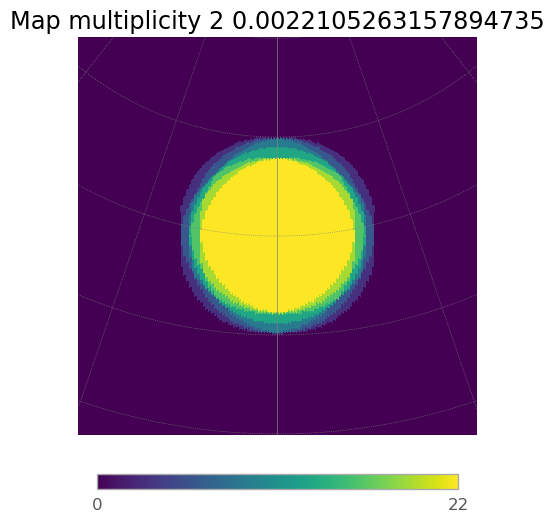

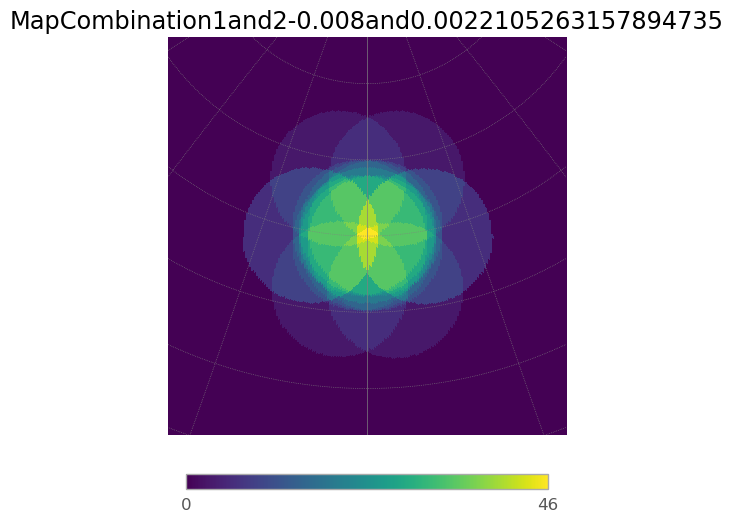

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.37it/s]
7it [00:01,  5.96it/s]
6it [00:00,  6.09it/s]
7it [00:01,  5.94it/s]
6it [00:01,  5.92it/s]
7it [00:01,  6.04it/s]
6it [00:01,  5.92it/s]


13.07274650697345


7it [00:01,  6.09it/s]


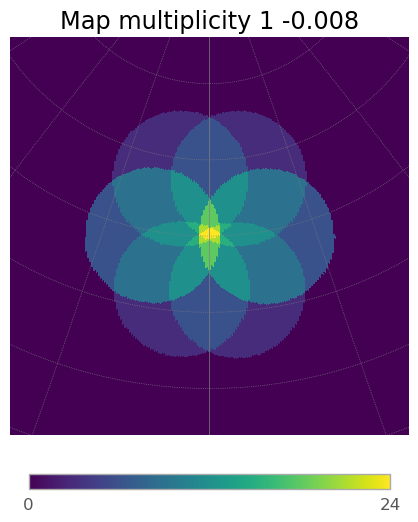

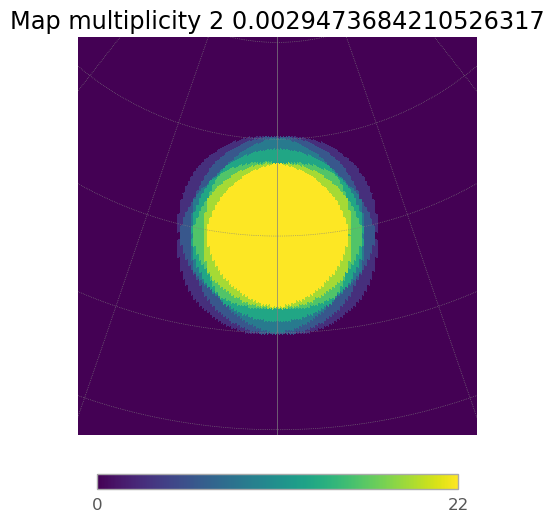

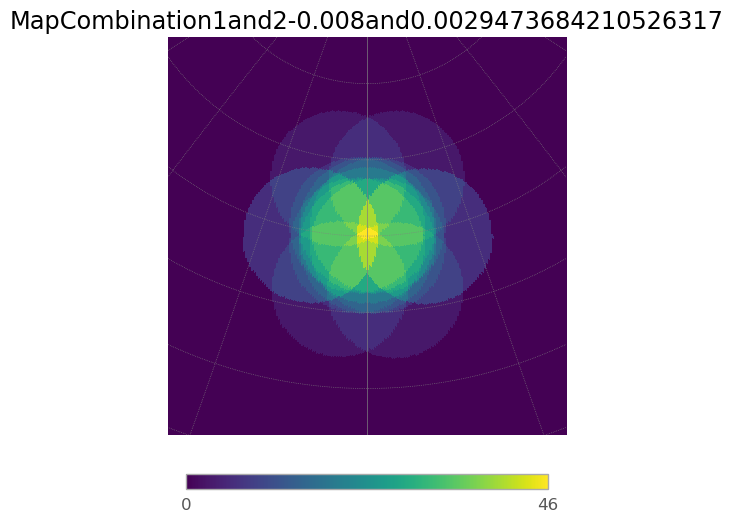

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.88it/s]
7it [00:01,  6.08it/s]
6it [00:01,  5.95it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.99it/s]
7it [00:01,  5.90it/s]
6it [00:01,  5.79it/s]


13.07274650697345


7it [00:01,  5.92it/s]


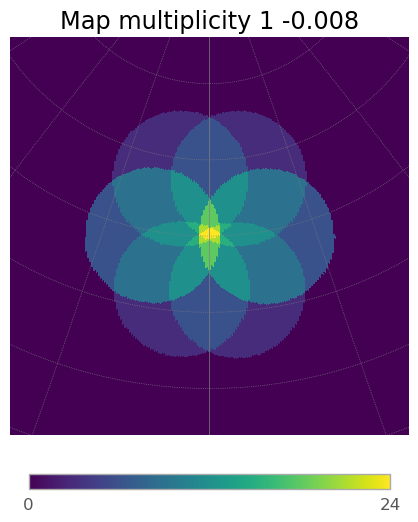

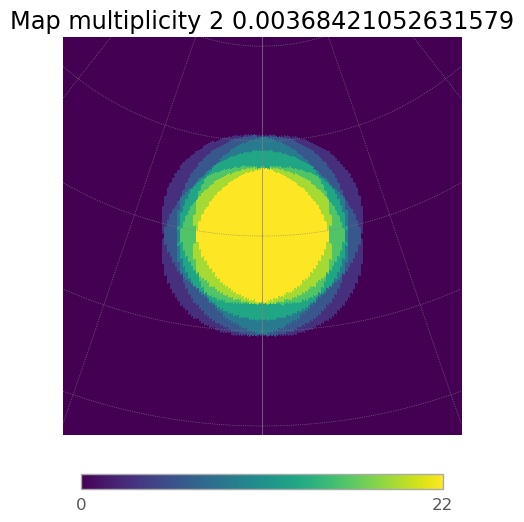

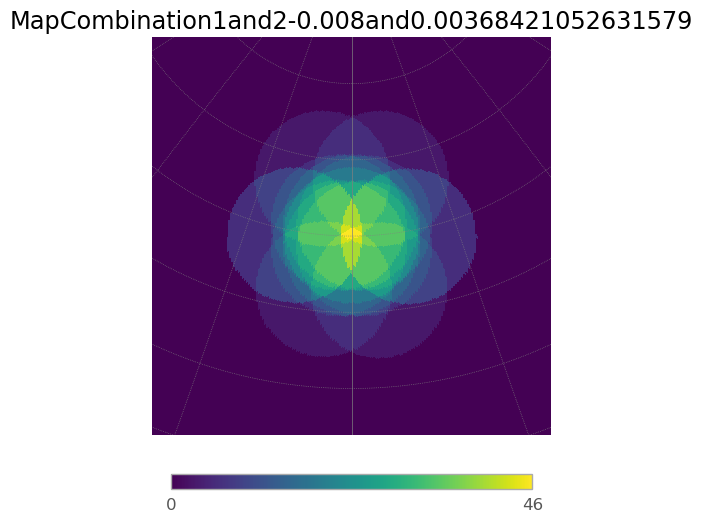

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.37it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.79it/s]
7it [00:01,  5.96it/s]
6it [00:01,  5.79it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.59it/s]


13.07274650697345


7it [00:01,  5.44it/s]


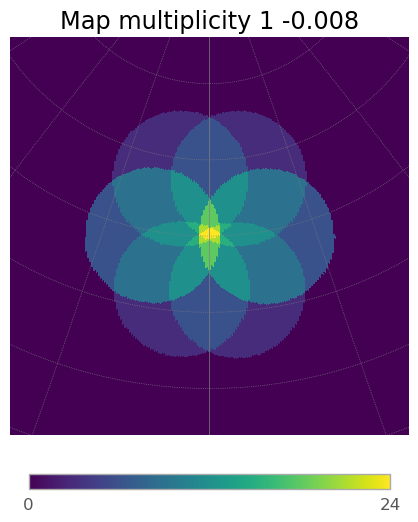

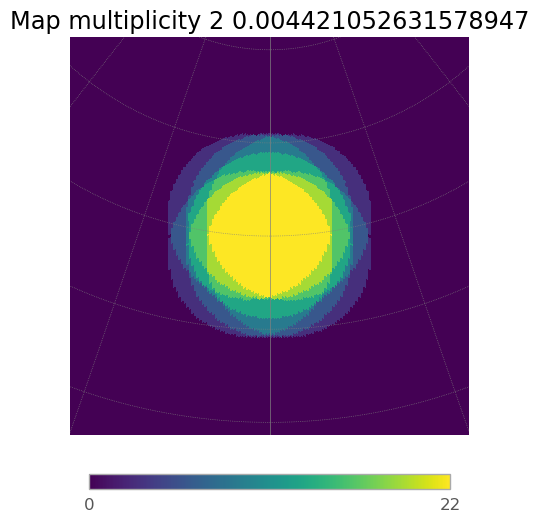

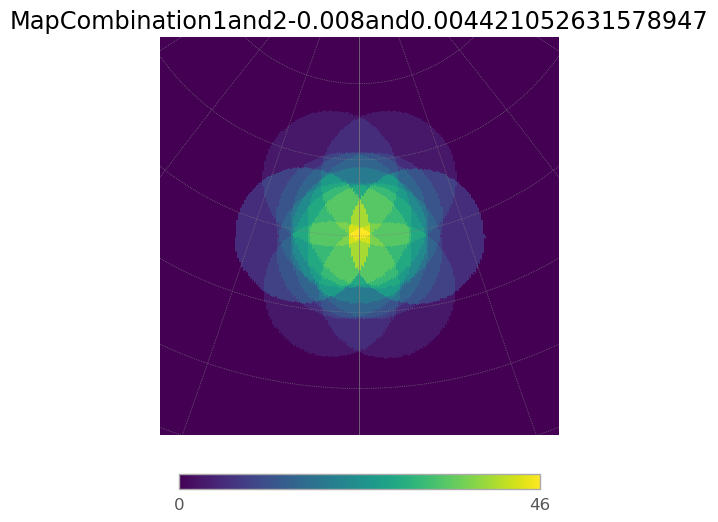

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.90it/s]
7it [00:01,  5.85it/s]
6it [00:00,  6.02it/s]
7it [00:01,  5.93it/s]
6it [00:01,  5.91it/s]
7it [00:01,  5.96it/s]
6it [00:01,  5.26it/s]


13.07274650697345


7it [00:01,  5.98it/s]


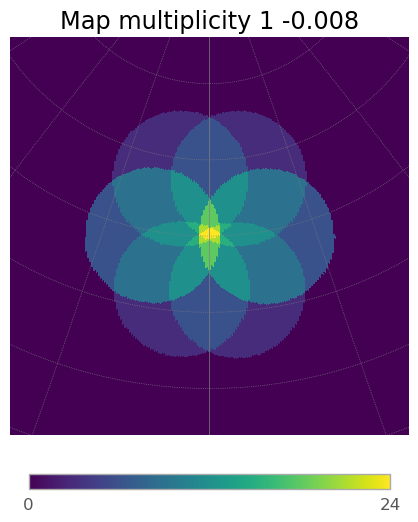

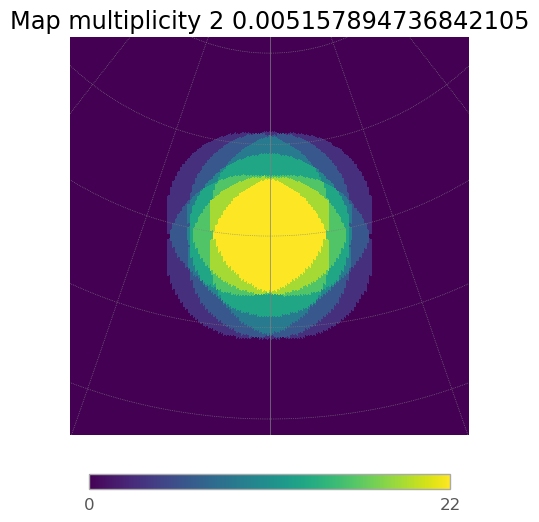

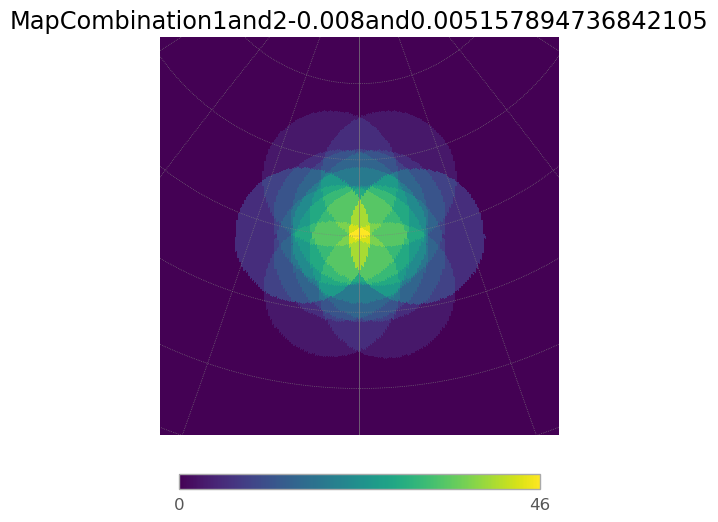

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.64it/s]
7it [00:01,  6.15it/s]
6it [00:01,  5.57it/s]
7it [00:01,  5.77it/s]
6it [00:01,  5.74it/s]
7it [00:01,  5.80it/s]
6it [00:01,  5.56it/s]


13.07274650697345


7it [00:01,  5.78it/s]


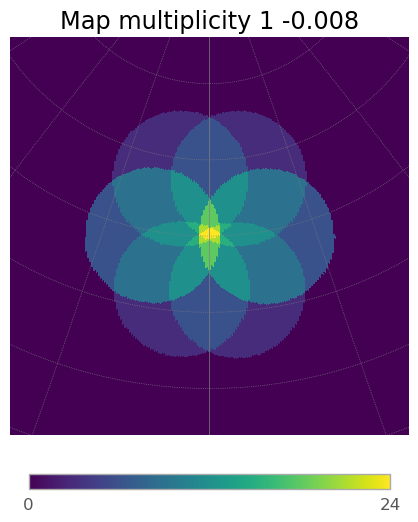

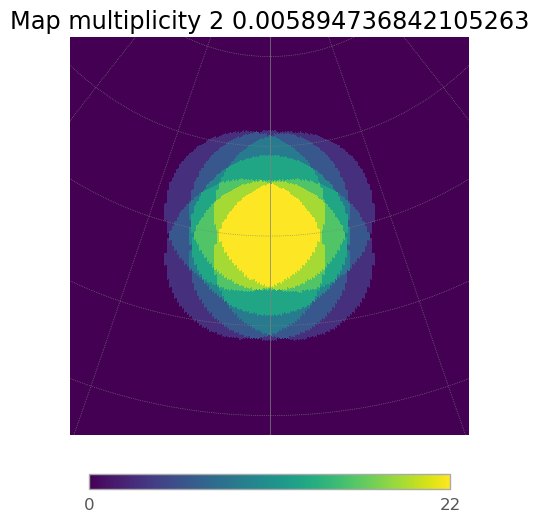

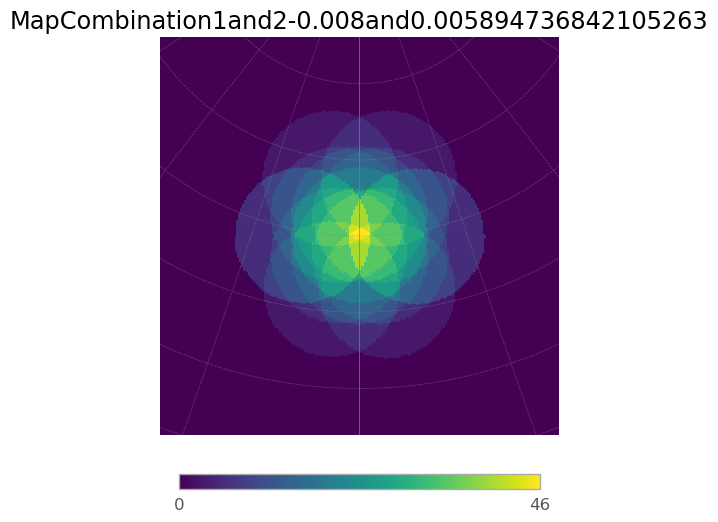

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.71it/s]
7it [00:01,  6.00it/s]
6it [00:01,  5.54it/s]
7it [00:01,  6.08it/s]
6it [00:01,  5.93it/s]
7it [00:01,  5.90it/s]
6it [00:01,  5.57it/s]


13.07274650697345


7it [00:01,  6.02it/s]


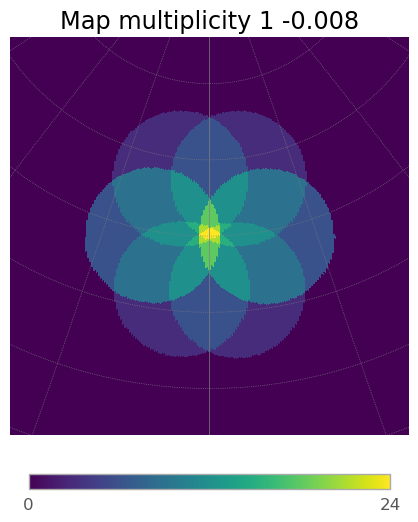

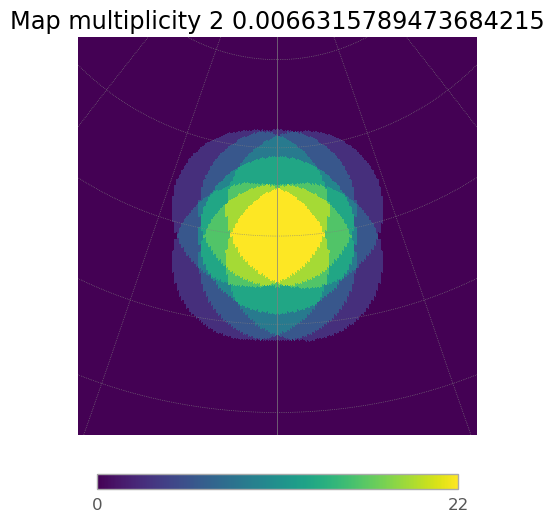

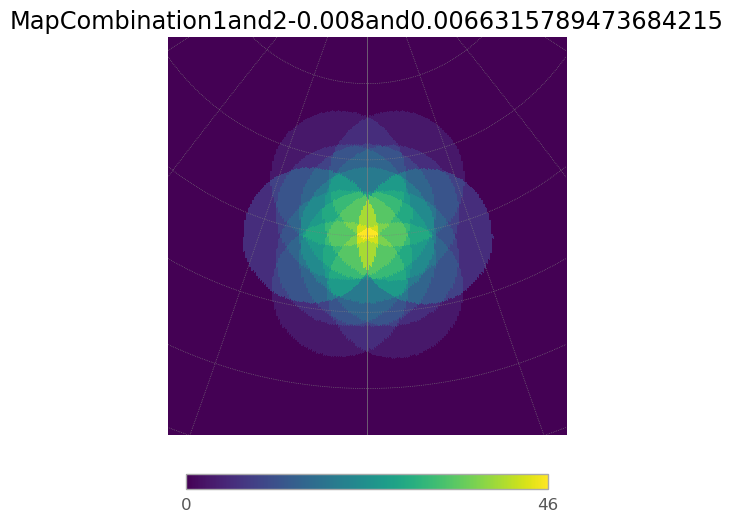

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.60it/s]
7it [00:01,  5.97it/s]
6it [00:01,  5.84it/s]
7it [00:01,  5.91it/s]
6it [00:00,  6.04it/s]
7it [00:01,  5.96it/s]
6it [00:01,  5.23it/s]


13.07274650697345


7it [00:01,  5.93it/s]


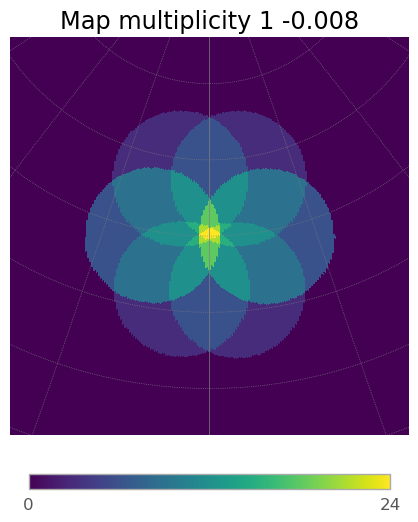

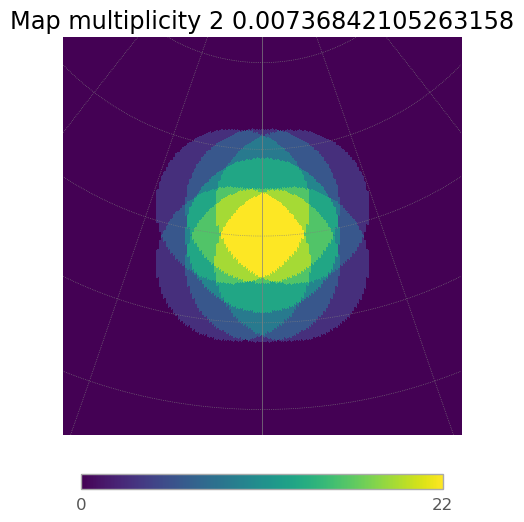

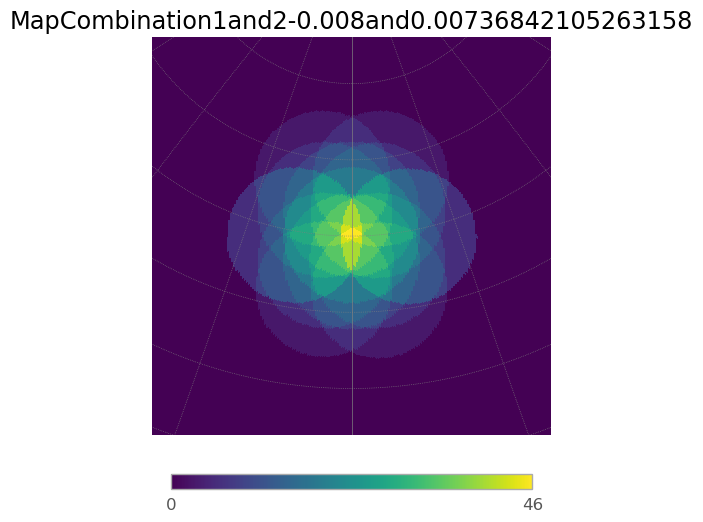

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.25it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.59it/s]
7it [00:01,  5.97it/s]
6it [00:00,  6.08it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.83it/s]


13.07274650697345


7it [00:01,  5.93it/s]


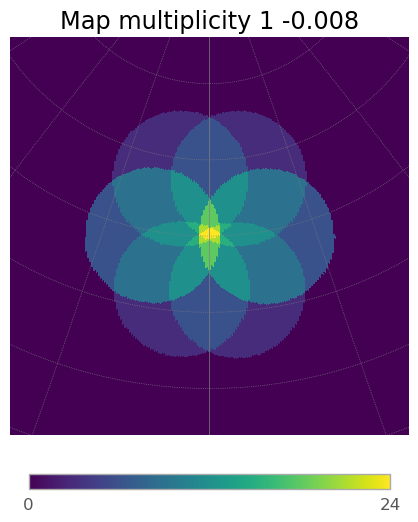

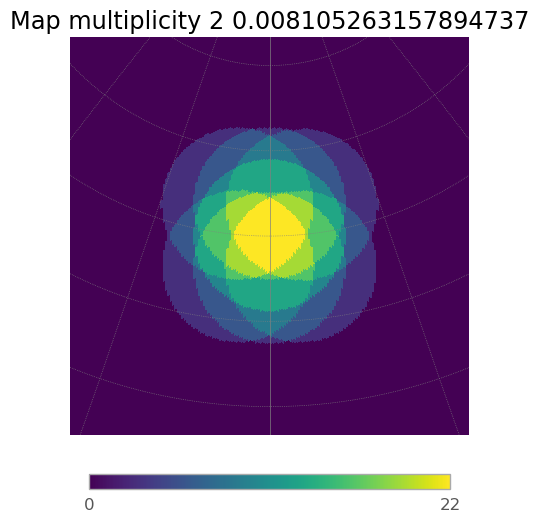

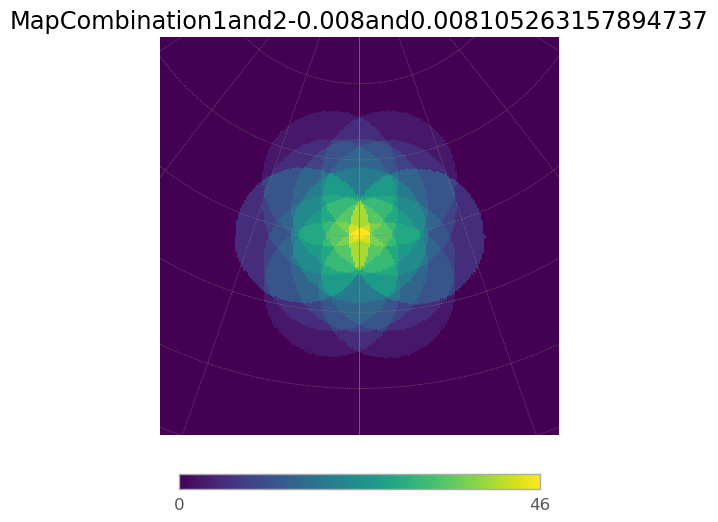

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.66it/s]
7it [00:01,  5.97it/s]
6it [00:01,  5.88it/s]
7it [00:01,  5.79it/s]
6it [00:00,  6.04it/s]
7it [00:01,  5.98it/s]
6it [00:01,  5.77it/s]


13.07274650697345


7it [00:01,  6.10it/s]


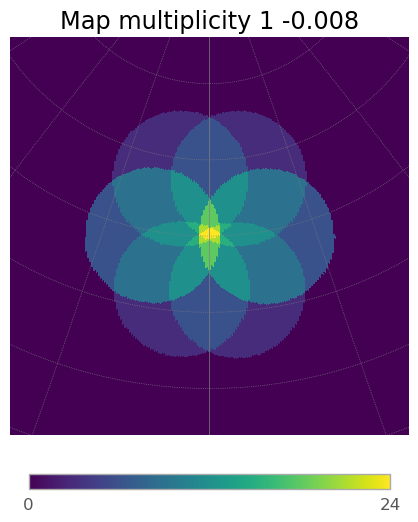

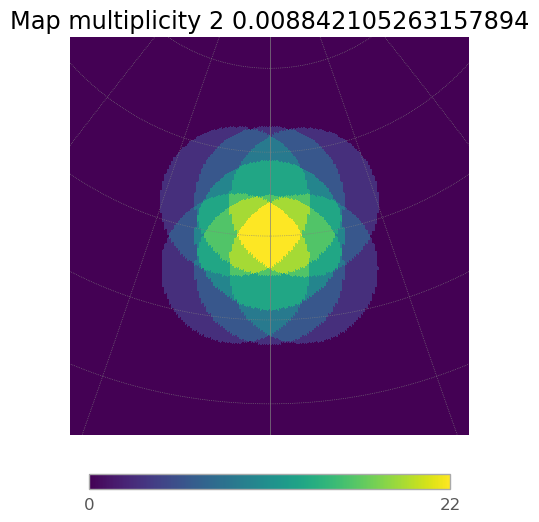

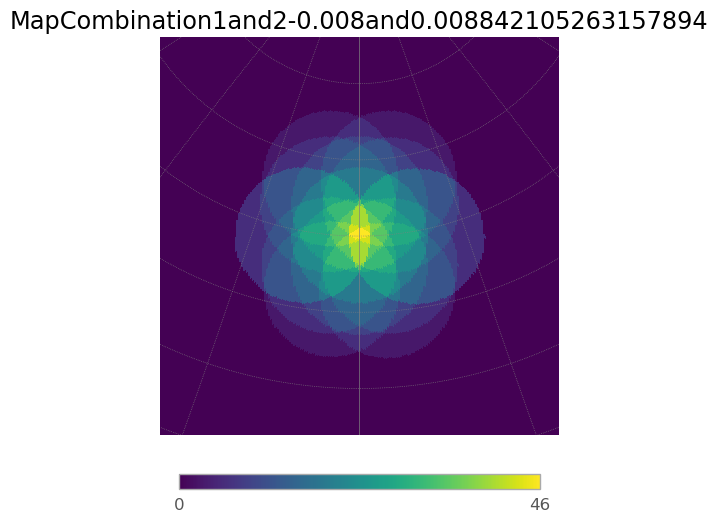

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.66it/s]
7it [00:01,  6.12it/s]
6it [00:01,  5.67it/s]
7it [00:01,  5.86it/s]
6it [00:00,  6.16it/s]
7it [00:01,  6.18it/s]
6it [00:01,  5.44it/s]


13.07274650697345


7it [00:01,  5.66it/s]


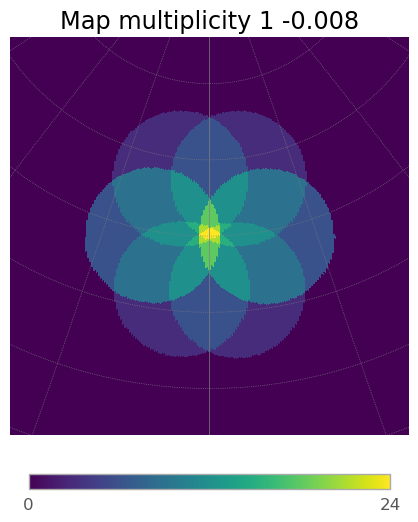

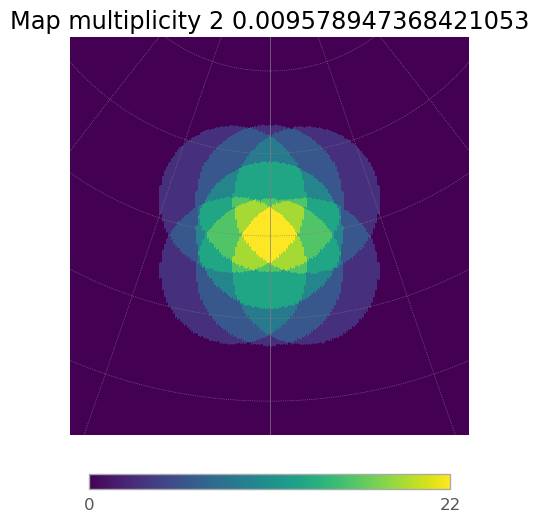

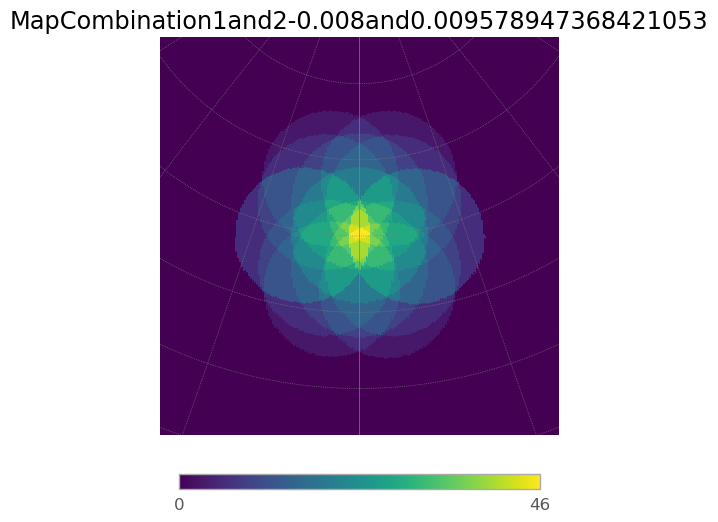

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.69it/s]
7it [00:01,  5.56it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.36it/s]
6it [00:01,  5.99it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.72it/s]


13.07274650697345


7it [00:01,  6.02it/s]


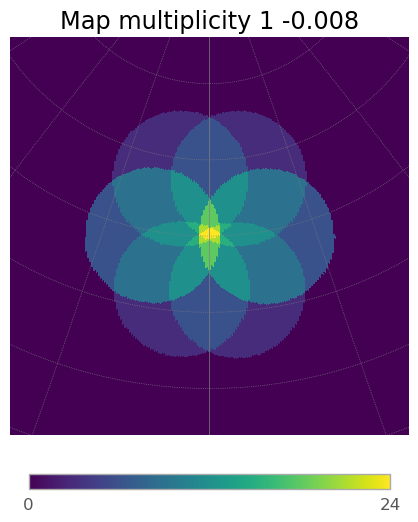

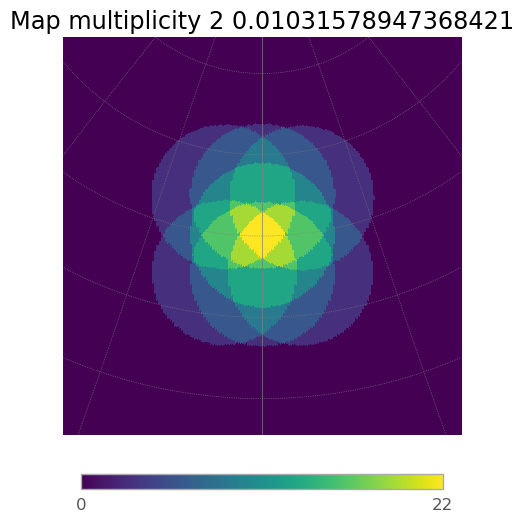

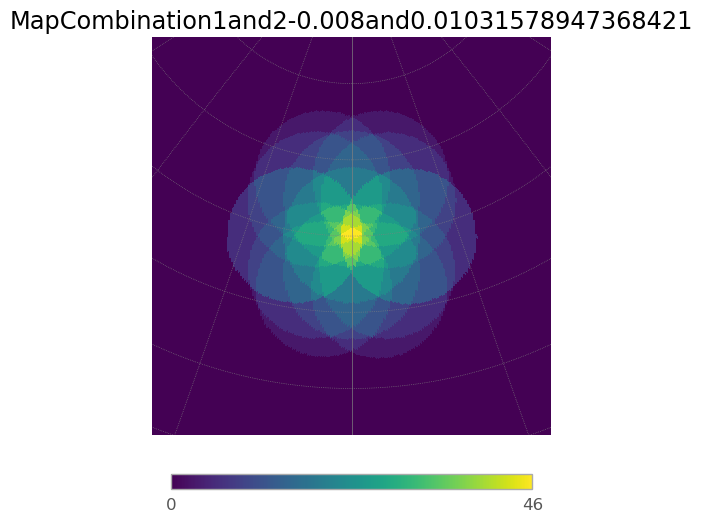

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.63it/s]
7it [00:01,  5.57it/s]
6it [00:01,  5.48it/s]
7it [00:01,  5.66it/s]
6it [00:00,  6.10it/s]
7it [00:01,  5.65it/s]
6it [00:01,  5.26it/s]


13.07274650697345


7it [00:01,  5.58it/s]


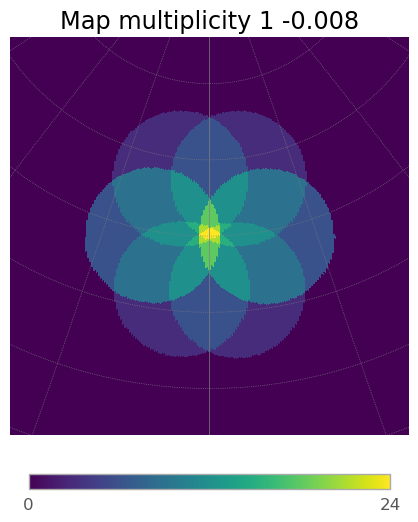

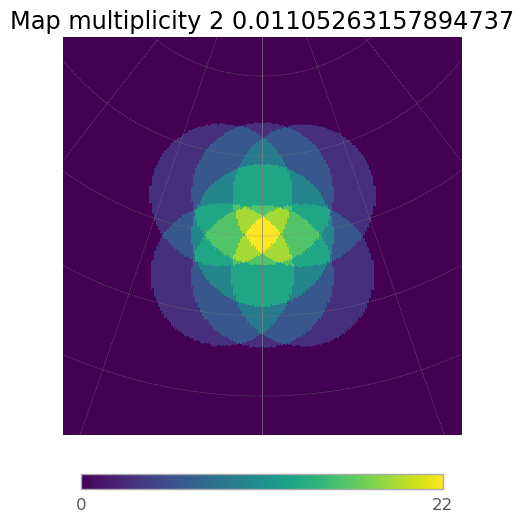

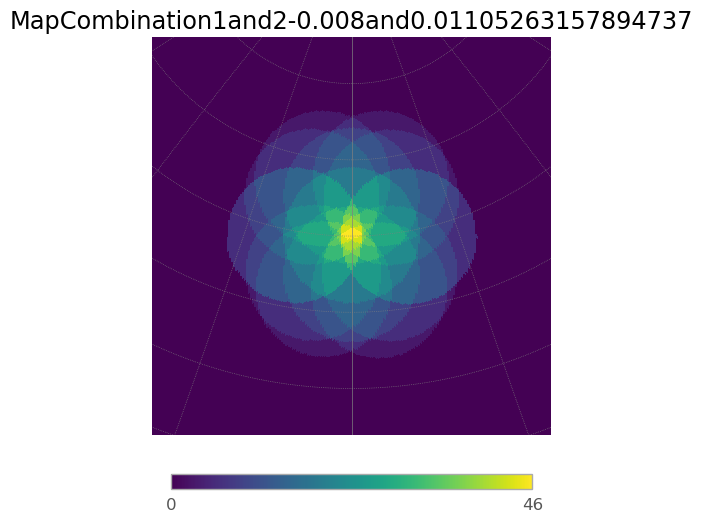

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.78it/s]
7it [00:01,  6.60it/s]
6it [00:00,  6.59it/s]
7it [00:01,  5.92it/s]
6it [00:00,  6.75it/s]
7it [00:01,  6.64it/s]
6it [00:00,  6.65it/s]


13.07274650697345


7it [00:01,  6.71it/s]


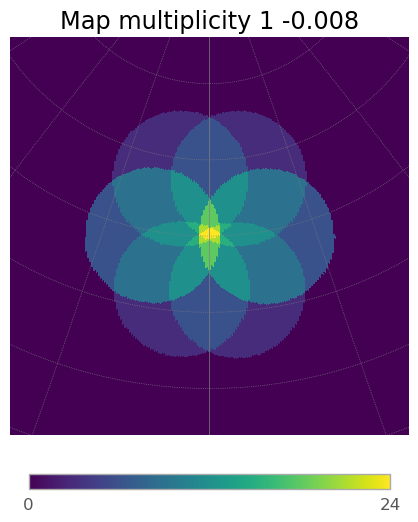

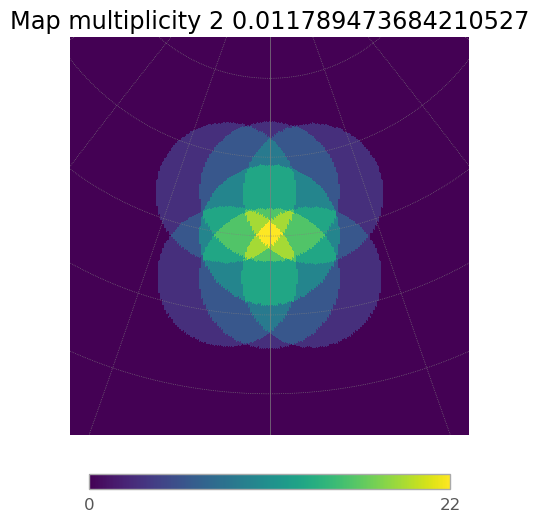

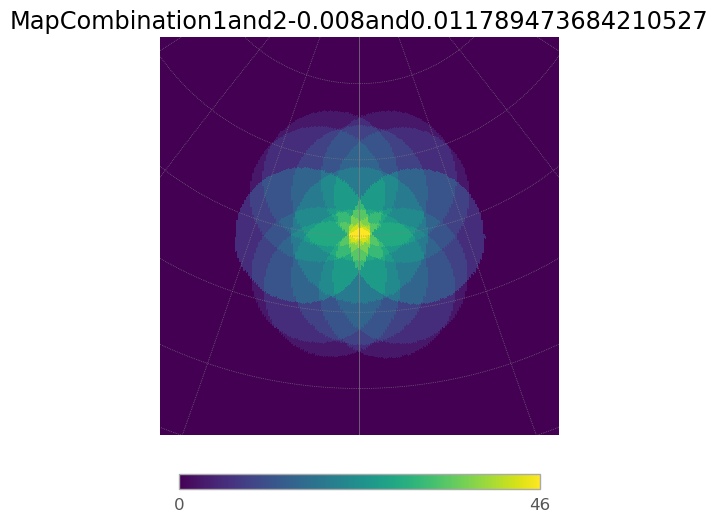

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.63it/s]
7it [00:01,  6.72it/s]
6it [00:00,  6.54it/s]
7it [00:01,  6.75it/s]
6it [00:00,  7.05it/s]
7it [00:01,  6.85it/s]
6it [00:00,  6.81it/s]


13.07274650697345


7it [00:01,  6.86it/s]


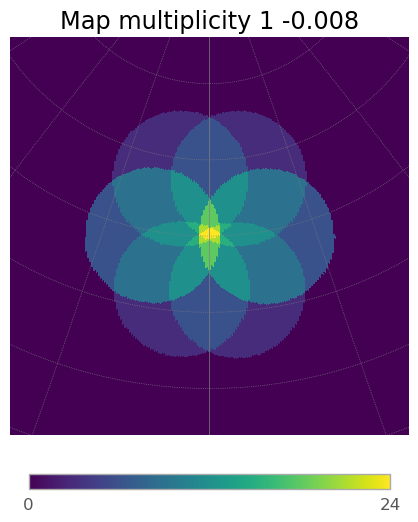

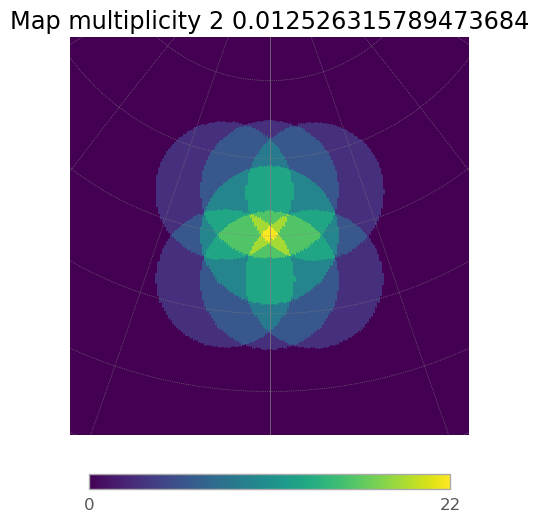

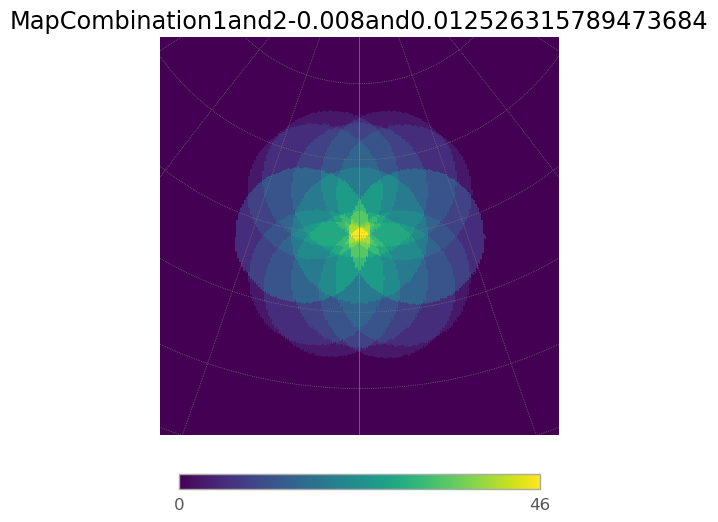

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.47it/s]
7it [00:01,  6.77it/s]
6it [00:00,  6.71it/s]
7it [00:01,  6.88it/s]
6it [00:00,  7.00it/s]
7it [00:01,  6.78it/s]
6it [00:00,  6.63it/s]


13.07274650697345


7it [00:01,  6.87it/s]


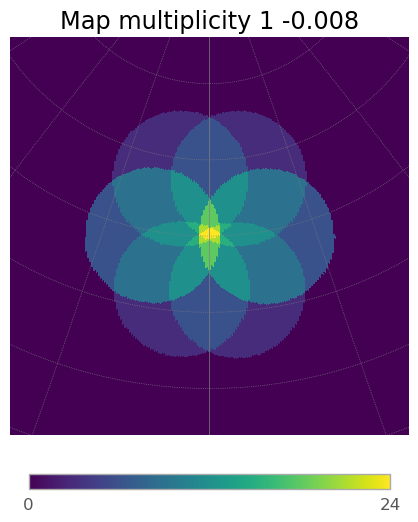

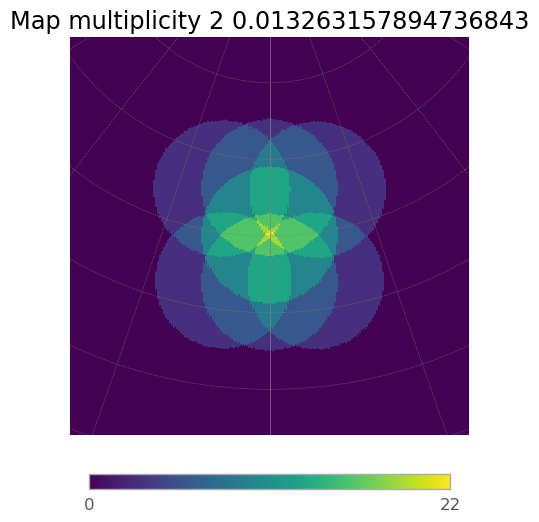

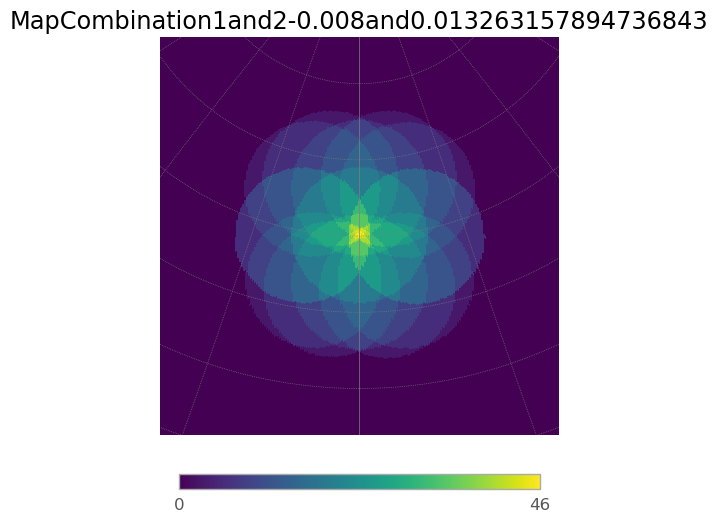

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.89it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.45it/s]
7it [00:00,  7.38it/s]
6it [00:00,  6.87it/s]
7it [00:01,  6.95it/s]
6it [00:00,  6.90it/s]


13.07274650697345


7it [00:00,  7.19it/s]


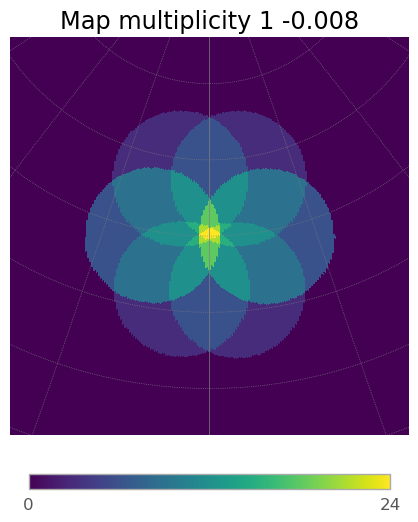

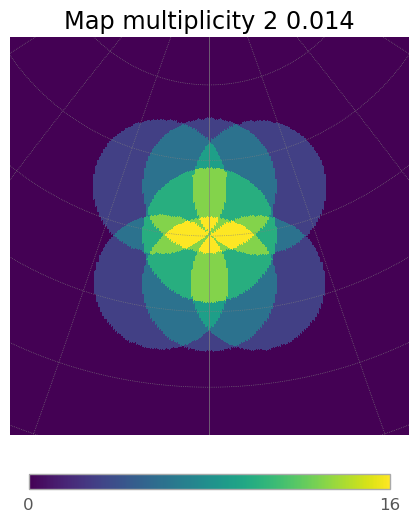

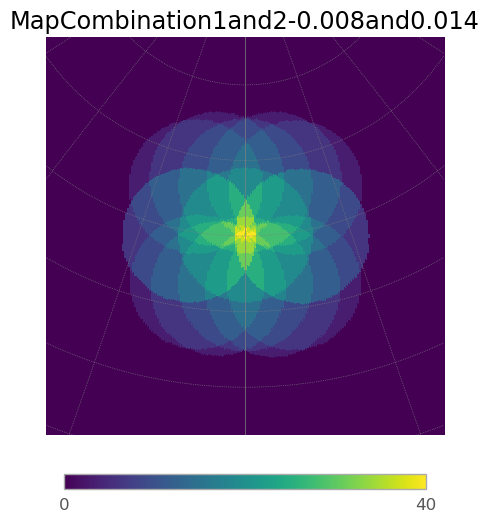

6it [00:00,  6.88it/s]
7it [00:01,  6.93it/s]
6it [00:00,  6.89it/s]
7it [00:00,  7.22it/s]
6it [00:00,  7.10it/s]
7it [00:00,  7.09it/s]
6it [00:00,  6.99it/s]


9.450044810959682


7it [00:00,  7.15it/s]


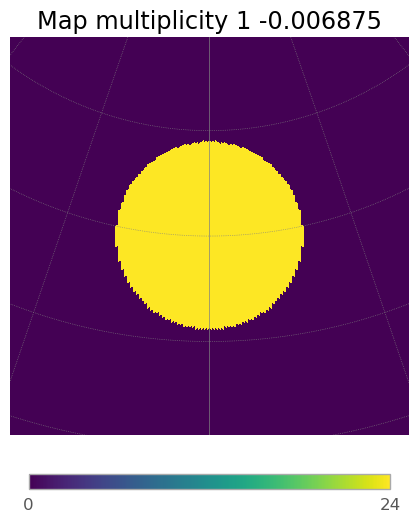

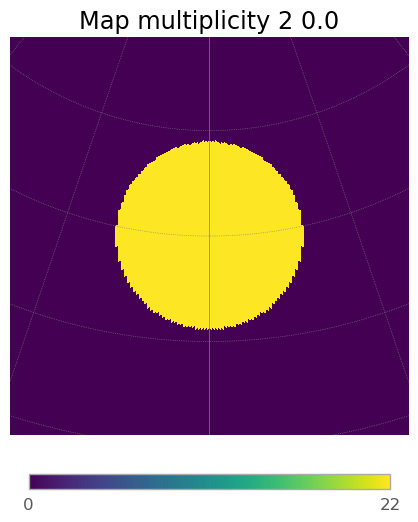

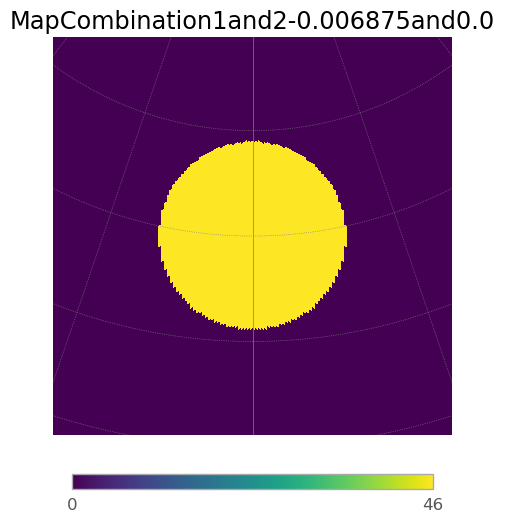

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.19it/s]
7it [00:00,  7.17it/s]
6it [00:00,  6.80it/s]
7it [00:00,  7.01it/s]
6it [00:00,  7.25it/s]
7it [00:00,  7.11it/s]
6it [00:00,  7.06it/s]


12.581567644489812


7it [00:00,  7.09it/s]


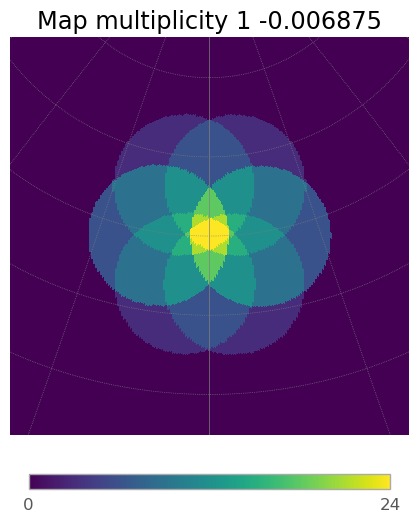

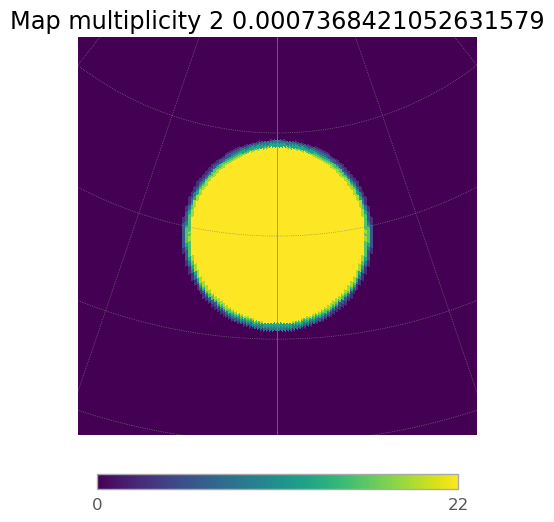

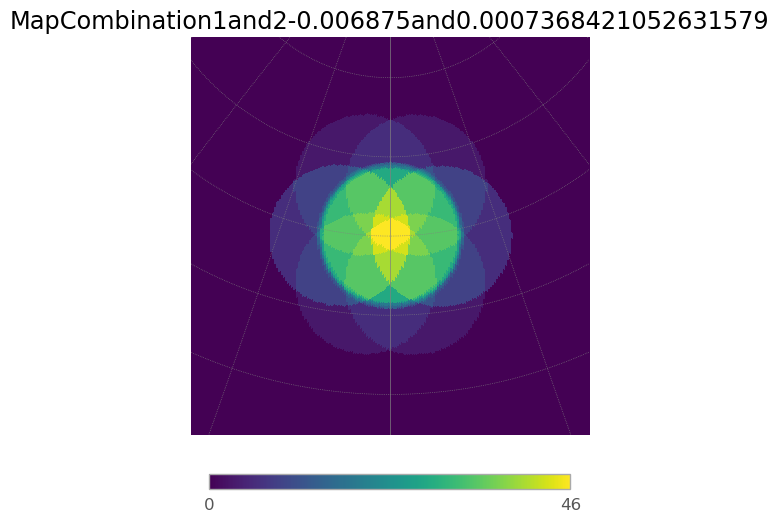

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.59it/s]
7it [00:01,  6.92it/s]
6it [00:00,  7.17it/s]
7it [00:01,  6.82it/s]
6it [00:00,  7.25it/s]
7it [00:00,  7.19it/s]
6it [00:00,  6.90it/s]


12.581567644489812


7it [00:00,  7.23it/s]


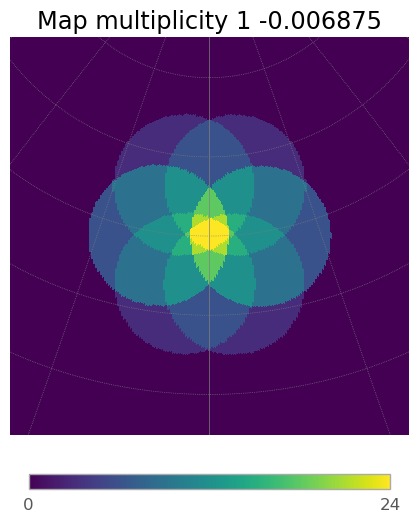

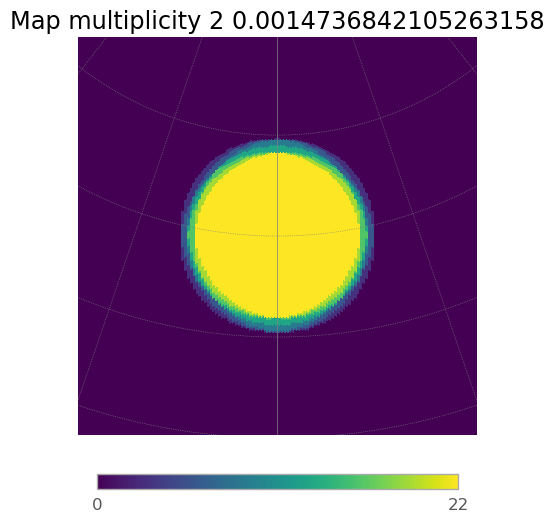

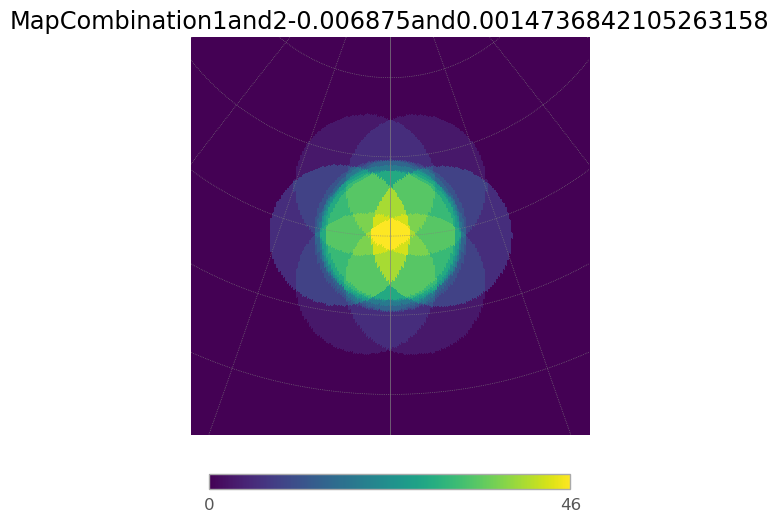

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.26it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.18it/s]
7it [00:00,  7.33it/s]
6it [00:00,  7.35it/s]
7it [00:00,  7.29it/s]
6it [00:00,  6.56it/s]


12.581567644489812


7it [00:00,  7.35it/s]


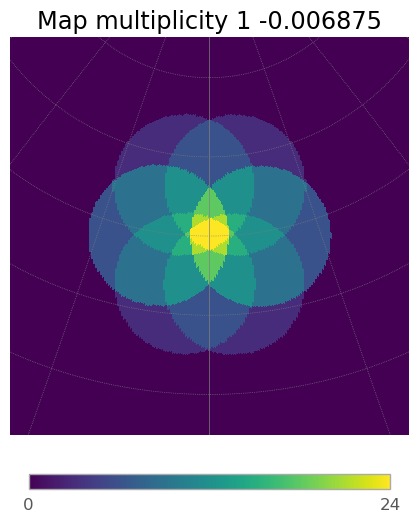

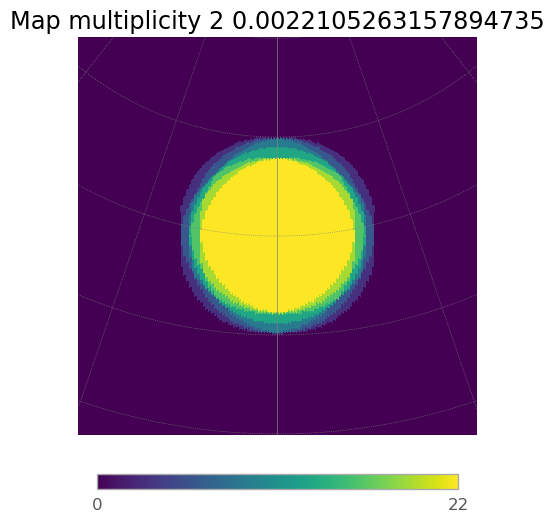

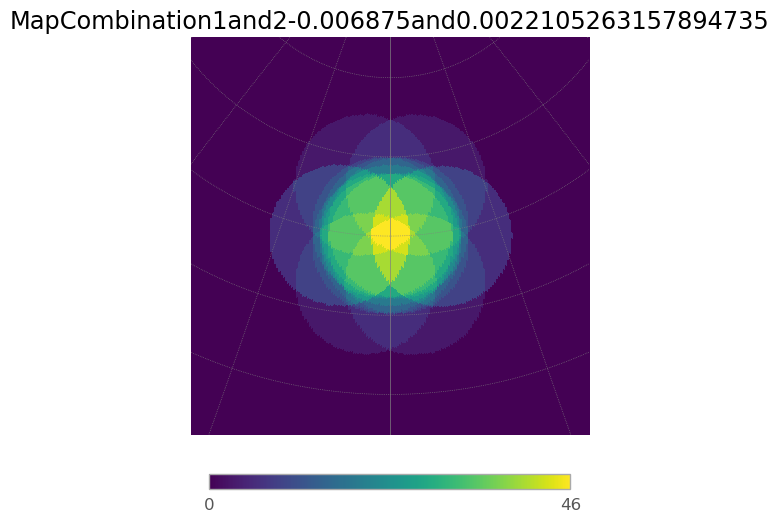

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.27it/s]
7it [00:00,  7.43it/s]
6it [00:00,  7.06it/s]
7it [00:00,  7.28it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.11it/s]


12.581567644489812


7it [00:00,  7.20it/s]


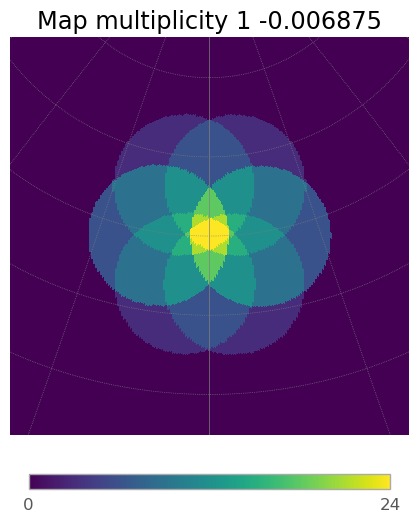

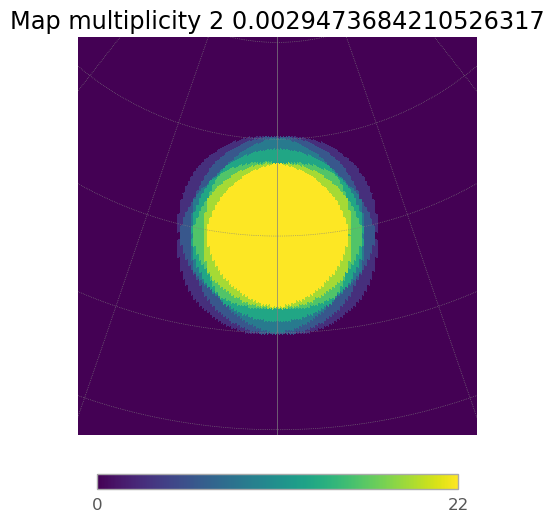

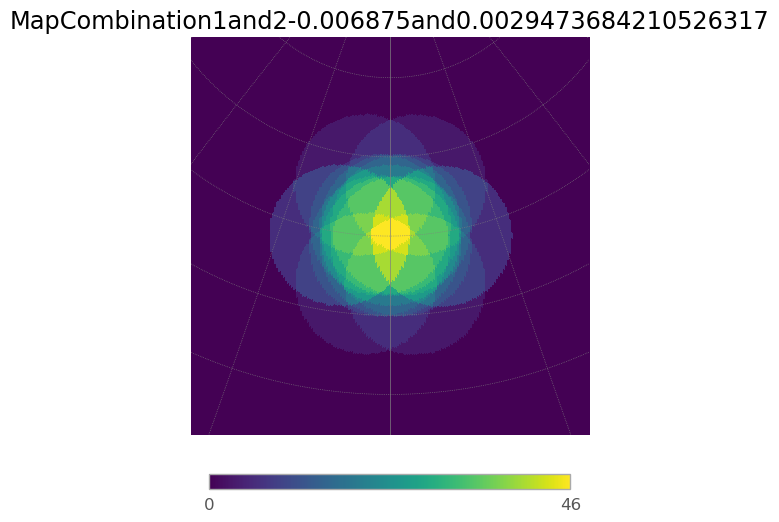

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.18it/s]
7it [00:00,  7.20it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.35it/s]
6it [00:00,  7.35it/s]
7it [00:00,  7.32it/s]
6it [00:00,  7.00it/s]


12.581567644489812


7it [00:00,  7.28it/s]


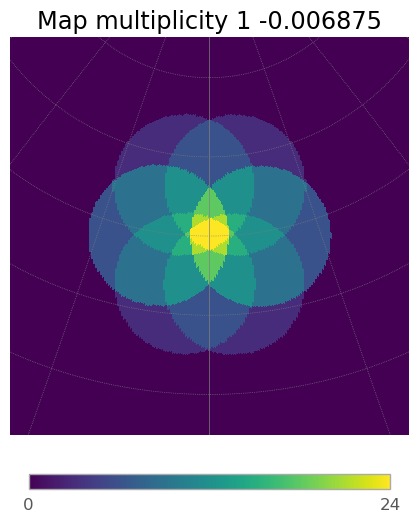

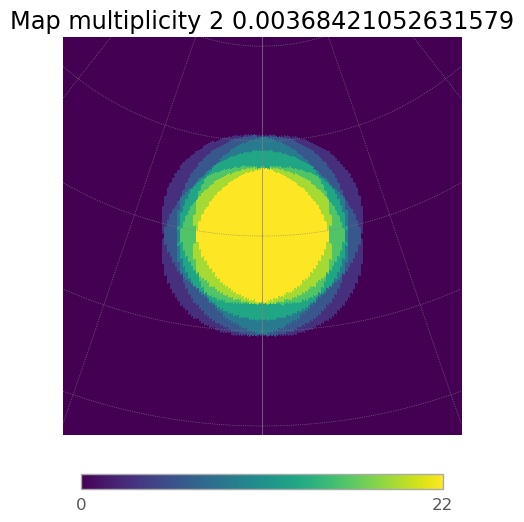

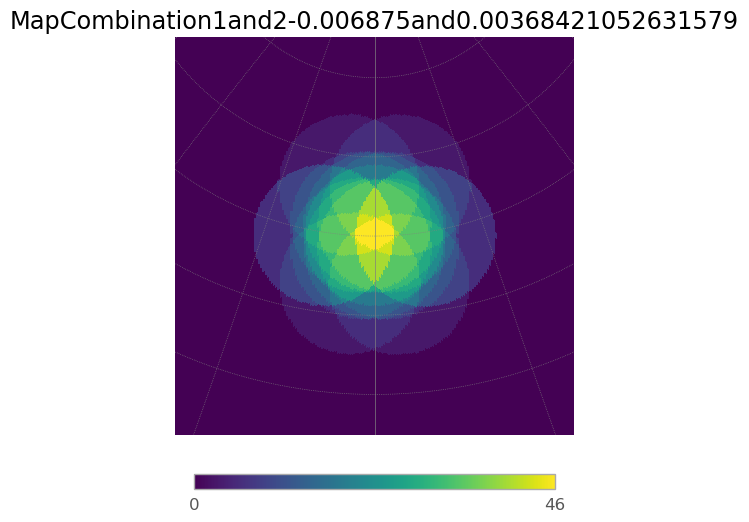

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.91it/s]
7it [00:00,  7.16it/s]
6it [00:00,  7.02it/s]
7it [00:00,  7.47it/s]
6it [00:00,  6.58it/s]
7it [00:00,  7.02it/s]
6it [00:01,  4.82it/s]


12.581567644489812


7it [00:01,  6.71it/s]


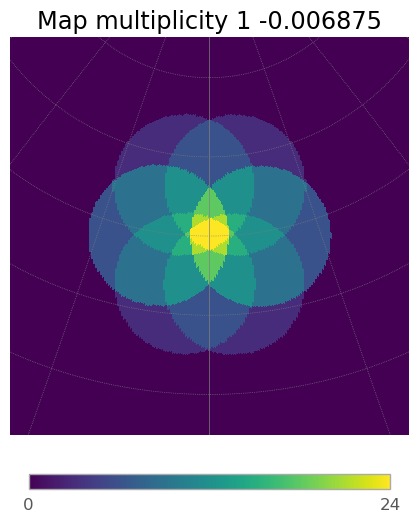

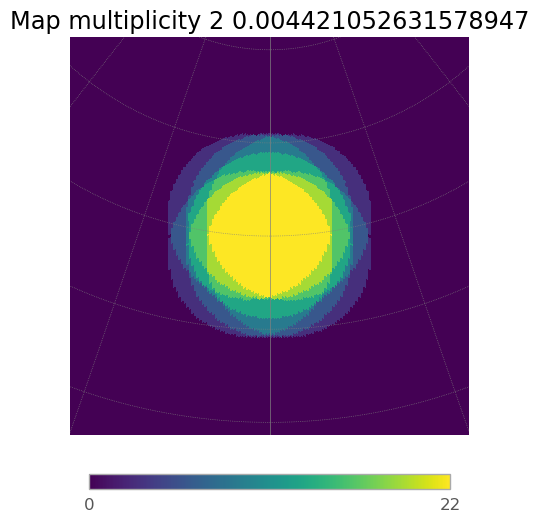

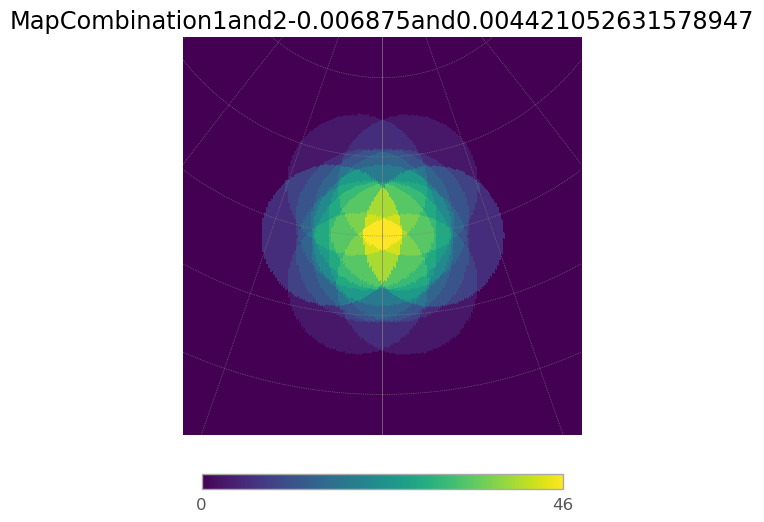

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.79it/s]
7it [00:00,  7.07it/s]
6it [00:01,  5.90it/s]
7it [00:01,  6.92it/s]
6it [00:00,  7.16it/s]
7it [00:00,  7.14it/s]
6it [00:00,  6.55it/s]


12.581567644489812


7it [00:00,  7.07it/s]


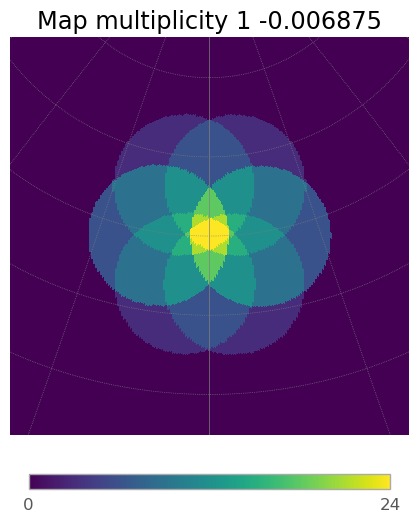

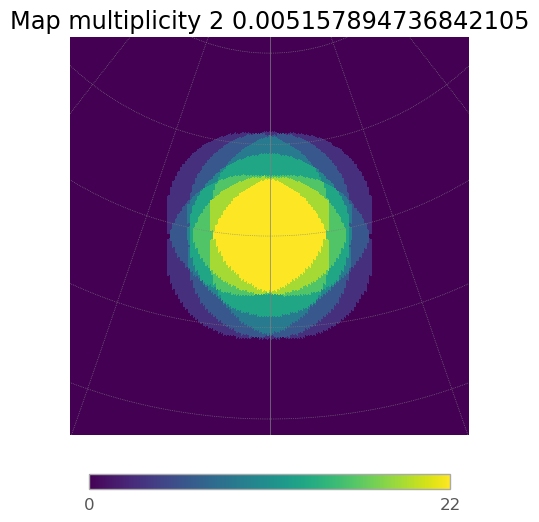

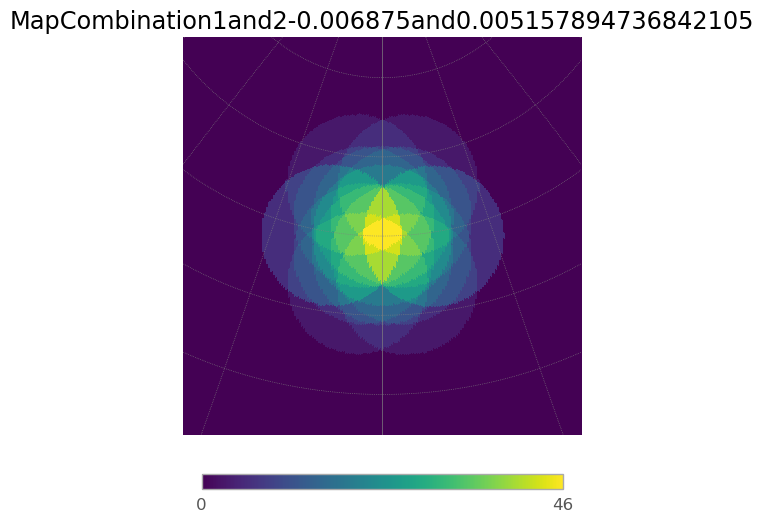

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.89it/s]
7it [00:01,  6.74it/s]
6it [00:00,  6.89it/s]
7it [00:01,  7.00it/s]
6it [00:00,  7.01it/s]
7it [00:01,  6.96it/s]
6it [00:00,  6.83it/s]


12.581567644489812


7it [00:00,  7.03it/s]


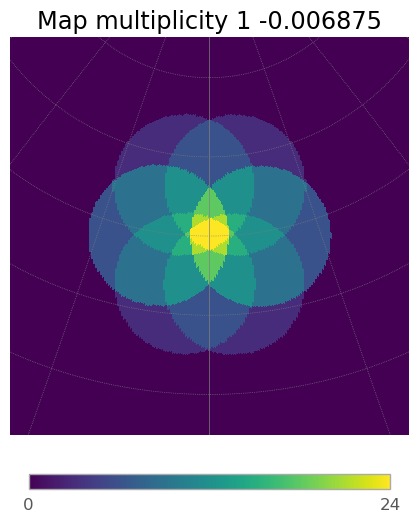

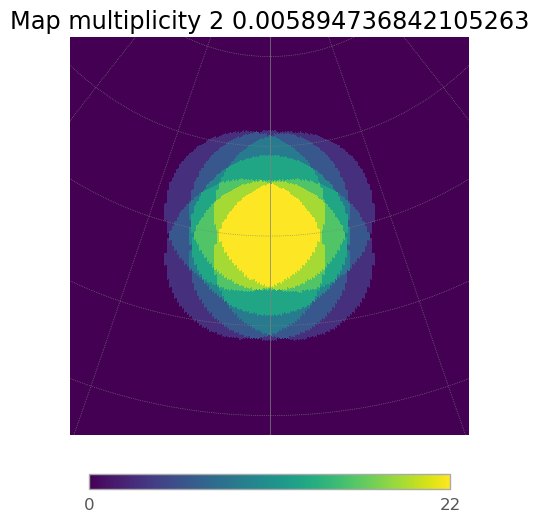

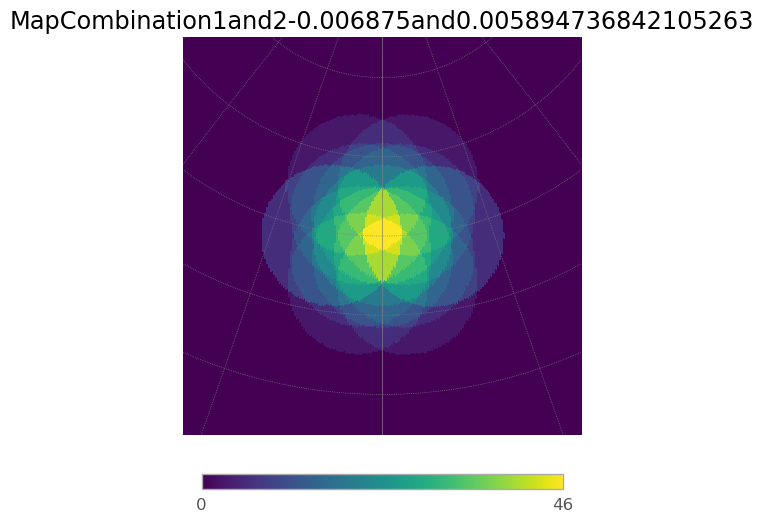

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.70it/s]
7it [00:00,  7.05it/s]
6it [00:00,  6.54it/s]
7it [00:00,  7.03it/s]
6it [00:00,  7.20it/s]
7it [00:00,  7.24it/s]
6it [00:00,  7.07it/s]


12.581567644489812


7it [00:00,  7.17it/s]


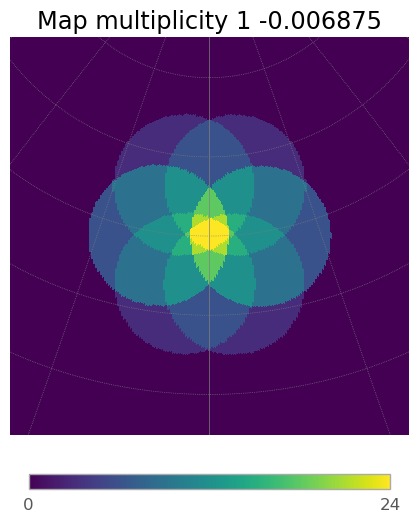

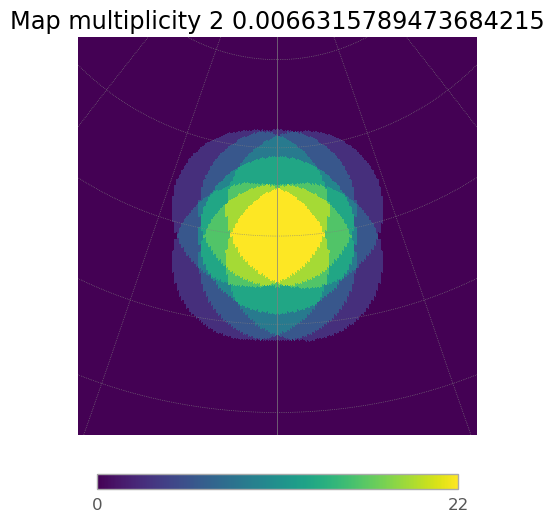

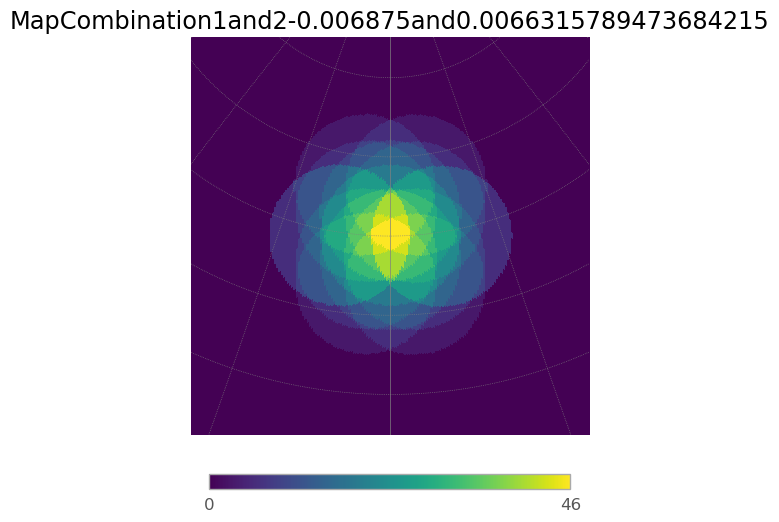

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.17it/s]
7it [00:00,  7.17it/s]
6it [00:00,  7.17it/s]
7it [00:00,  7.42it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.21it/s]
6it [00:00,  6.99it/s]


12.581567644489812


7it [00:00,  7.33it/s]


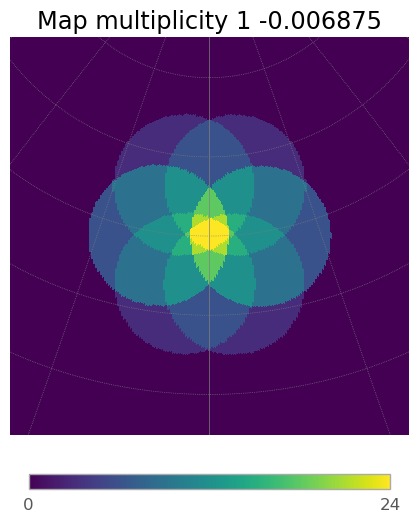

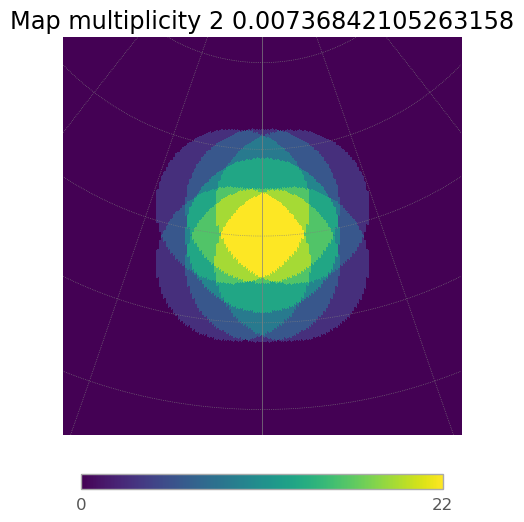

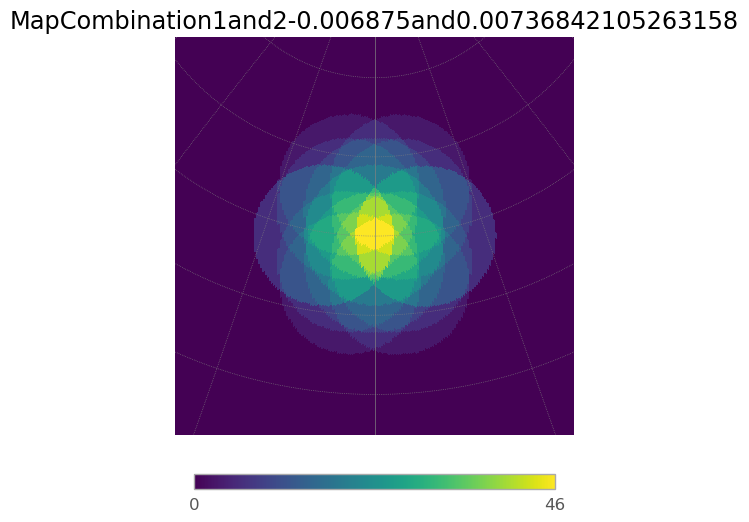

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.09it/s]
7it [00:00,  7.26it/s]
6it [00:00,  7.06it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.41it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.09it/s]


12.581567644489812


7it [00:00,  7.29it/s]


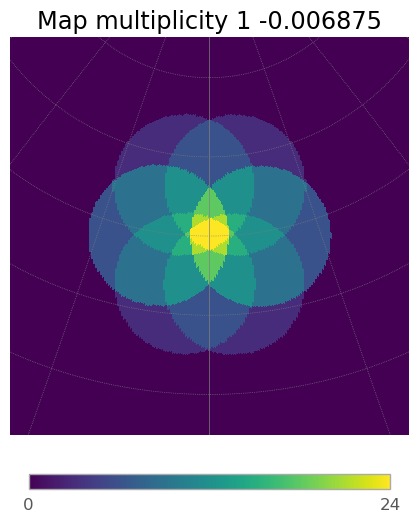

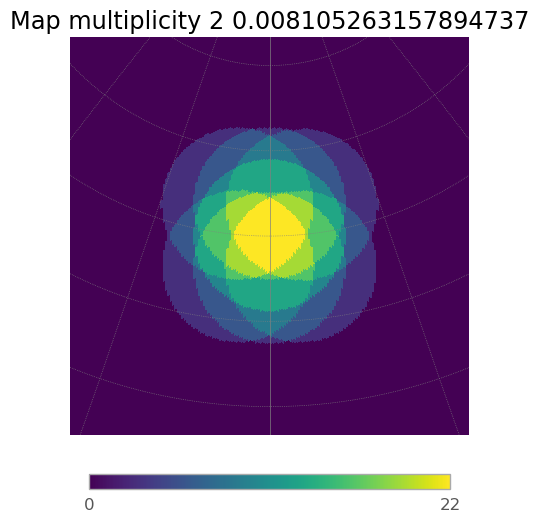

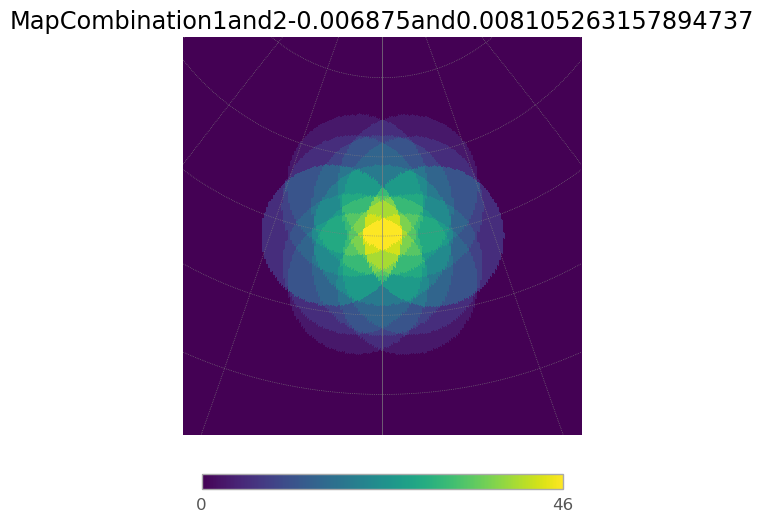

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.72it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.79it/s]
7it [00:01,  6.95it/s]
6it [00:00,  7.28it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.96it/s]


12.581567644489812


7it [00:00,  7.09it/s]


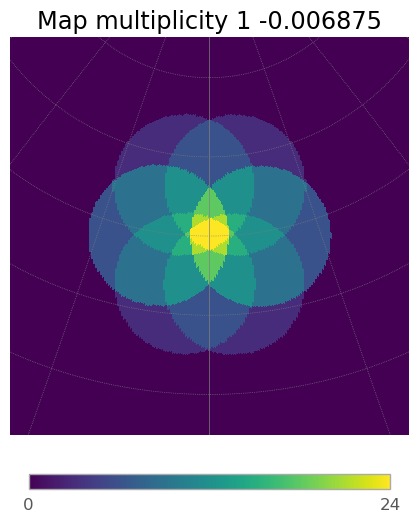

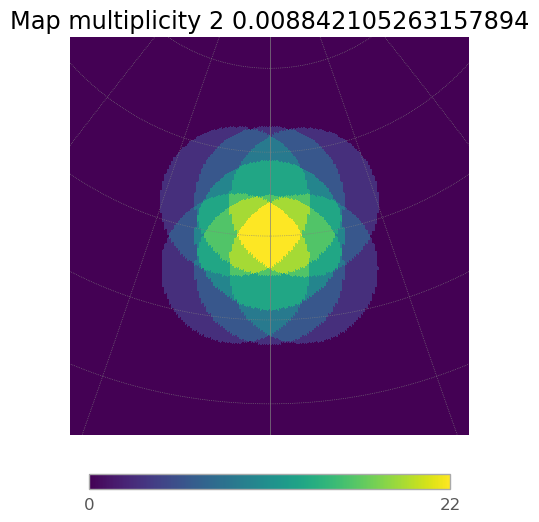

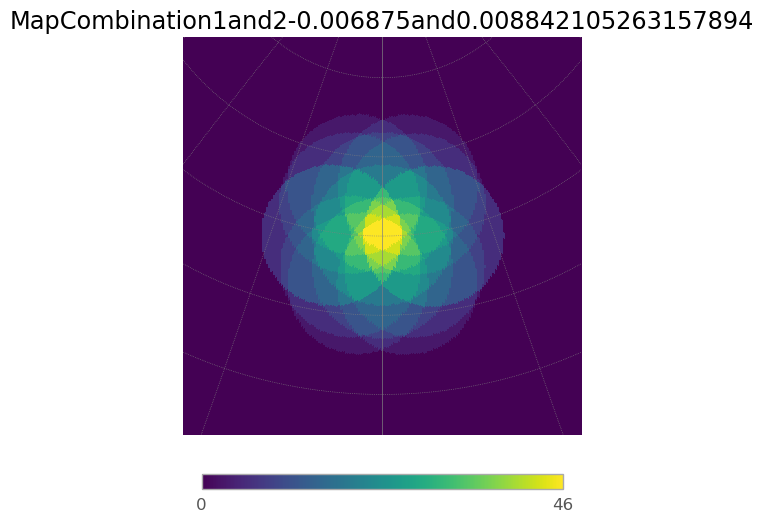

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.70it/s]
7it [00:00,  7.08it/s]
6it [00:00,  6.72it/s]
7it [00:01,  6.92it/s]
6it [00:00,  7.05it/s]
7it [00:00,  7.12it/s]
6it [00:00,  6.76it/s]


12.581567644489812


7it [00:00,  7.06it/s]


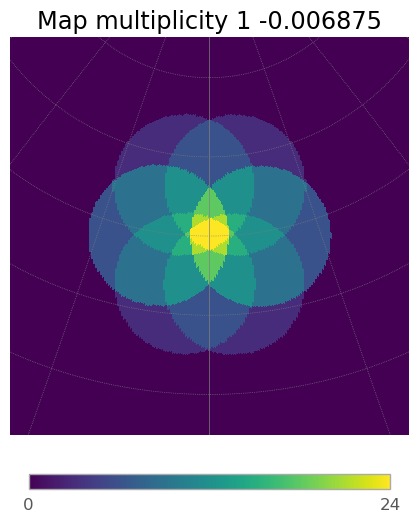

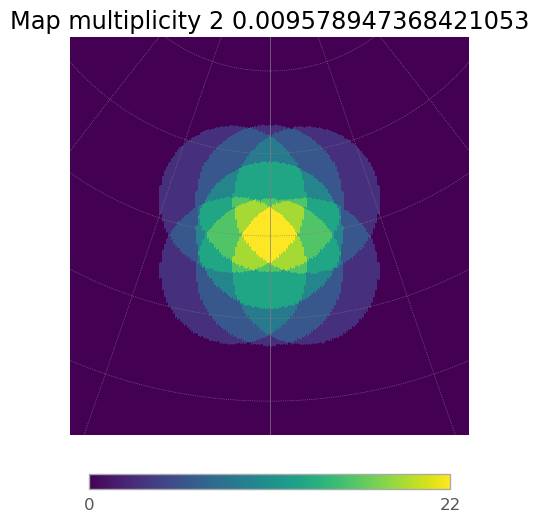

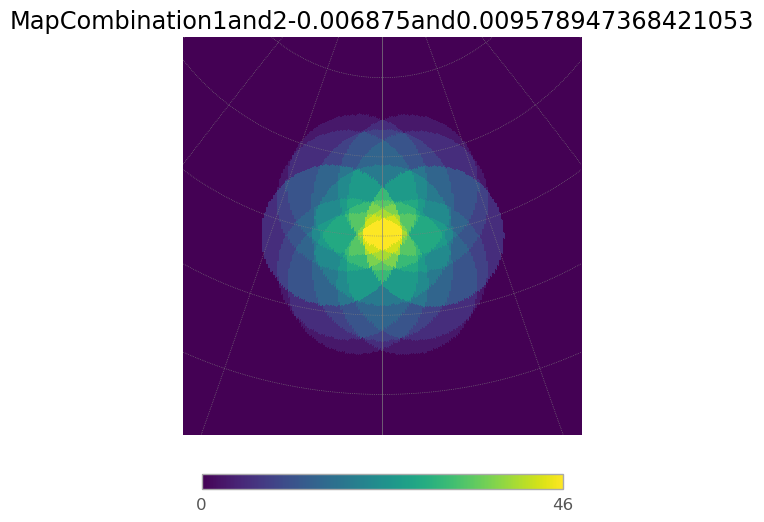

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.41it/s]
7it [00:01,  6.65it/s]
6it [00:00,  6.34it/s]
7it [00:00,  7.08it/s]
6it [00:01,  5.97it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.62it/s]


12.581567644489812


7it [00:01,  6.56it/s]


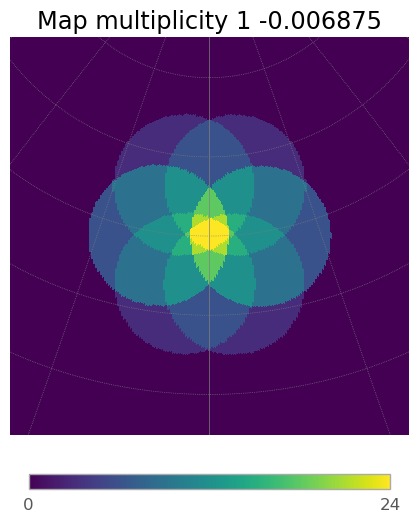

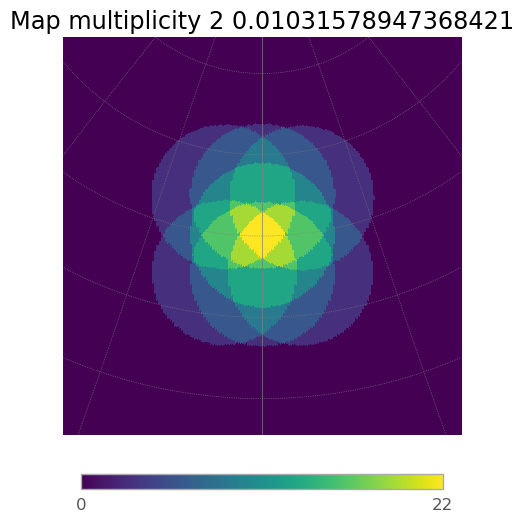

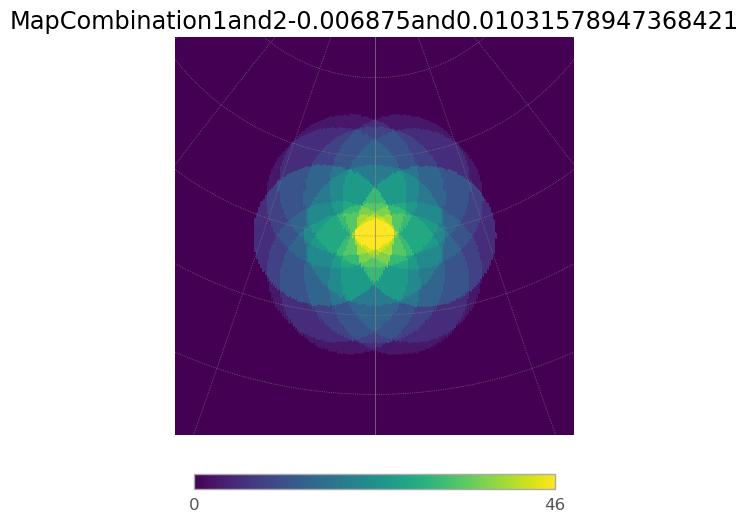

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.94it/s]
7it [00:00,  7.17it/s]
6it [00:00,  6.95it/s]
7it [00:01,  6.94it/s]
6it [00:00,  6.98it/s]
7it [00:00,  7.05it/s]
6it [00:00,  6.53it/s]


12.581567644489812


7it [00:01,  6.91it/s]


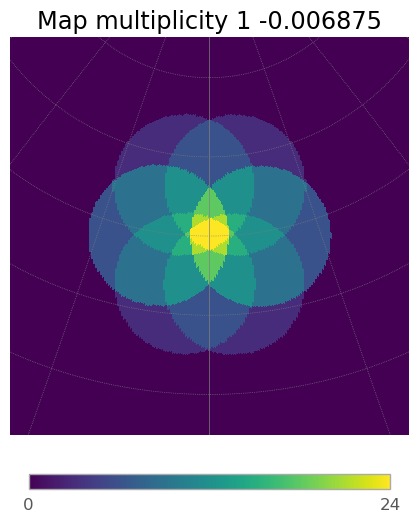

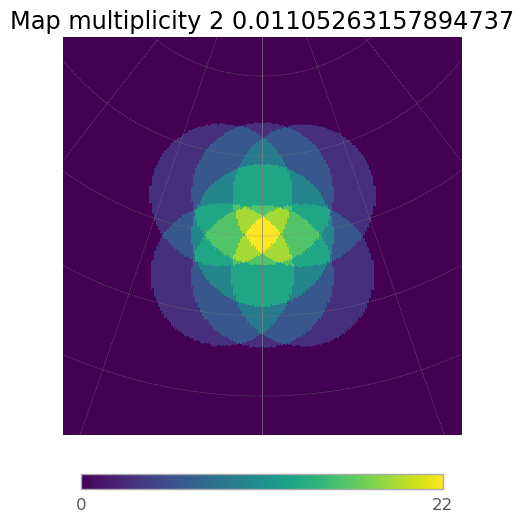

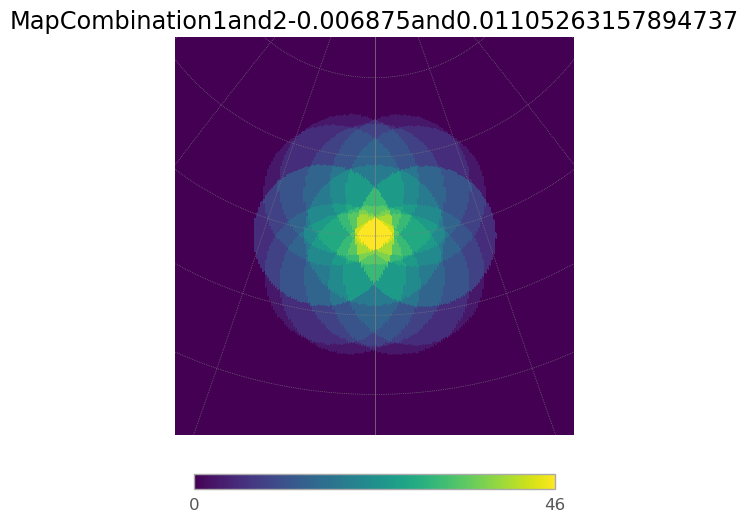

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.65it/s]
7it [00:01,  6.94it/s]
6it [00:00,  6.90it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.27it/s]
7it [00:01,  6.76it/s]
6it [00:00,  6.71it/s]


12.581567644489812


7it [00:01,  6.84it/s]


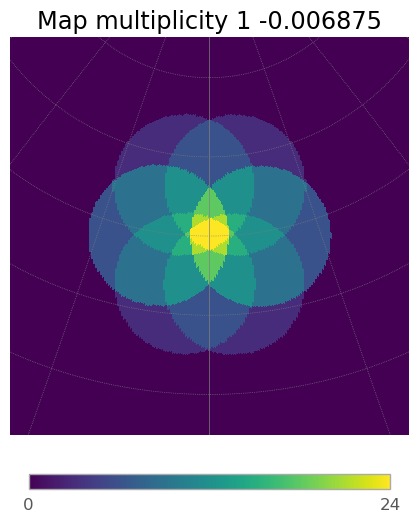

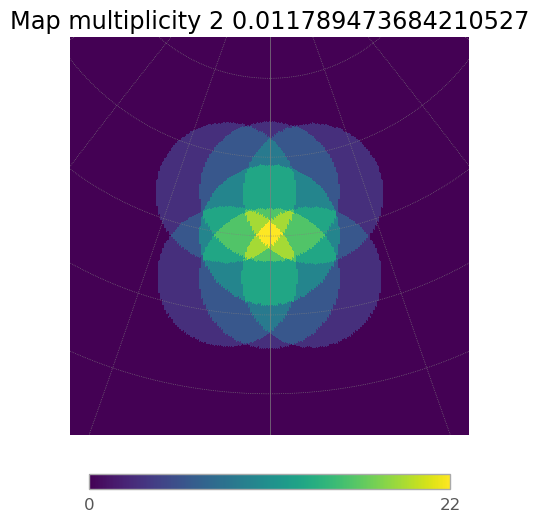

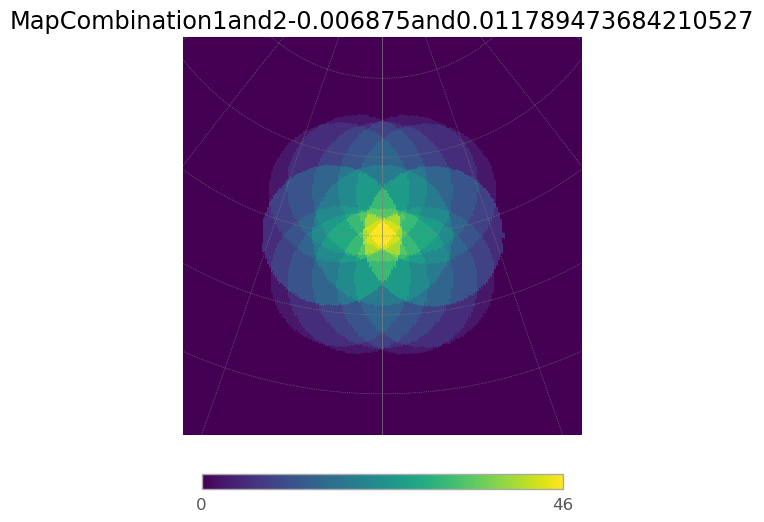

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.96it/s]
7it [00:01,  6.84it/s]
6it [00:00,  6.84it/s]
7it [00:01,  6.37it/s]
6it [00:00,  7.11it/s]
7it [00:01,  6.85it/s]
6it [00:00,  6.66it/s]


12.581567644489812


7it [00:01,  6.88it/s]


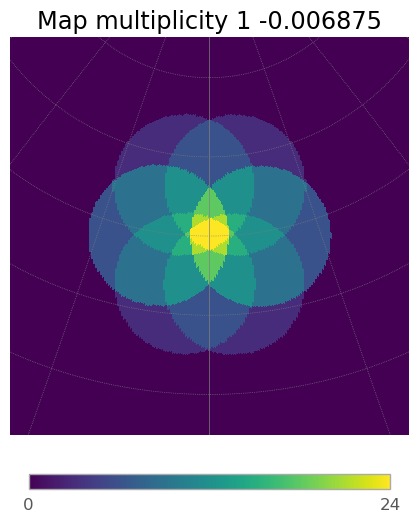

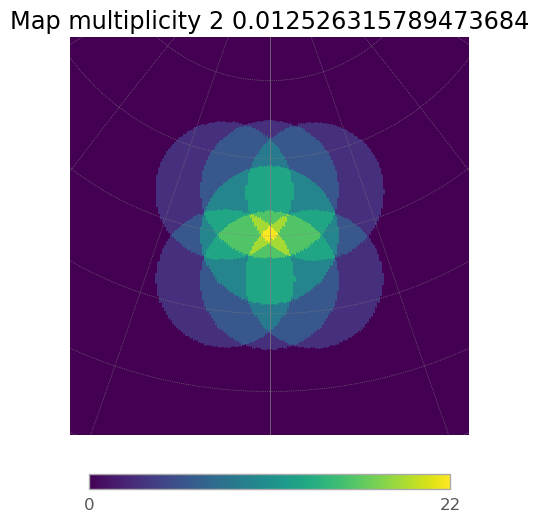

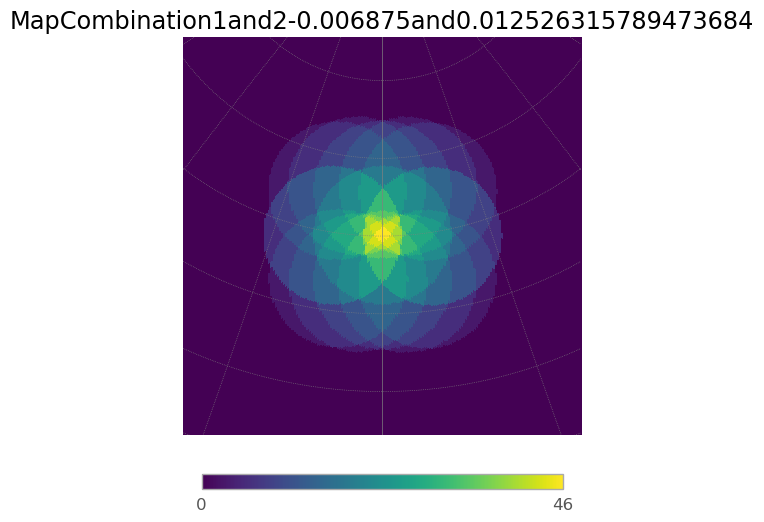

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.72it/s]
7it [00:00,  7.15it/s]
6it [00:00,  6.59it/s]
7it [00:01,  6.94it/s]
6it [00:00,  7.00it/s]
7it [00:00,  7.26it/s]
6it [00:00,  6.73it/s]


12.581567644489812


7it [00:01,  7.00it/s]


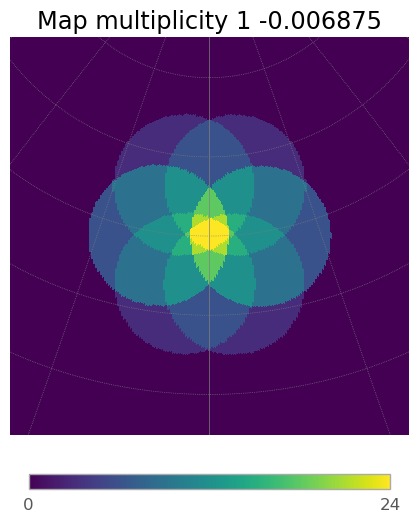

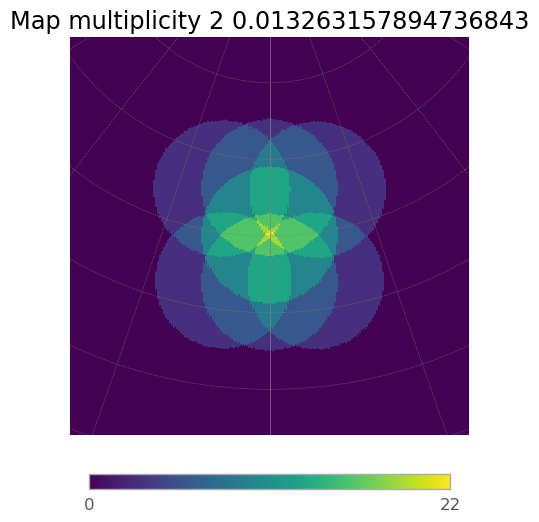

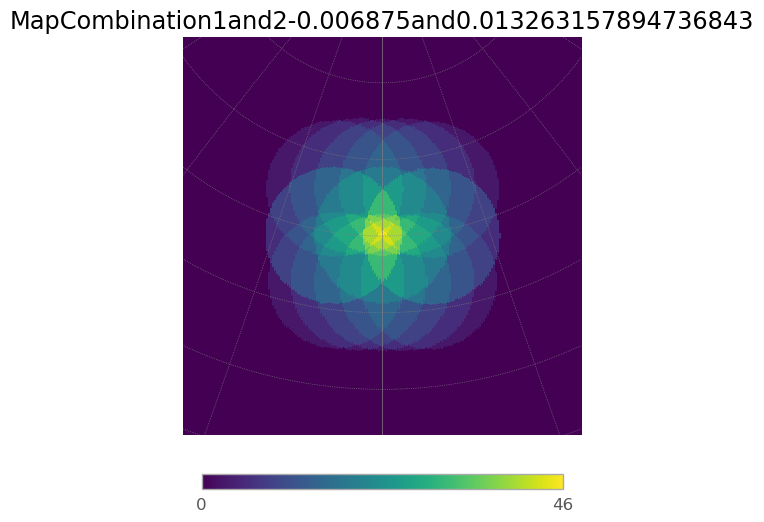

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.65it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.89it/s]
7it [00:00,  7.16it/s]
6it [00:00,  7.25it/s]
7it [00:00,  7.04it/s]
6it [00:00,  6.53it/s]


12.581567644489812


7it [00:01,  6.92it/s]


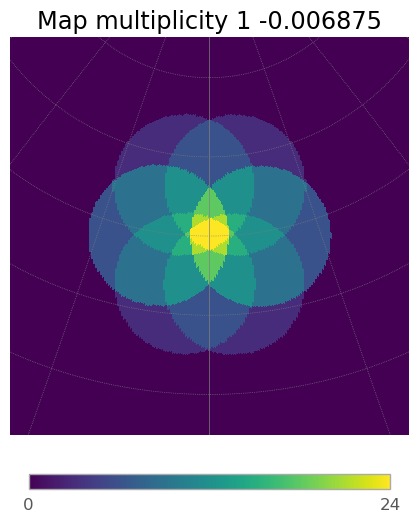

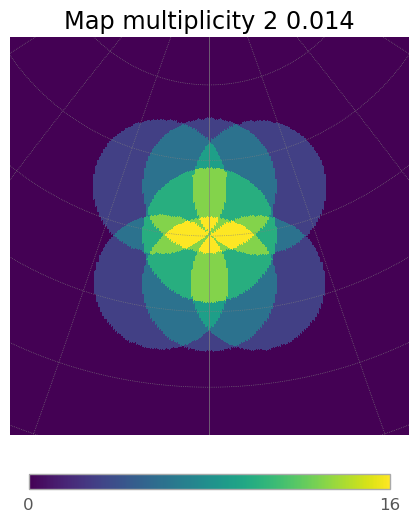

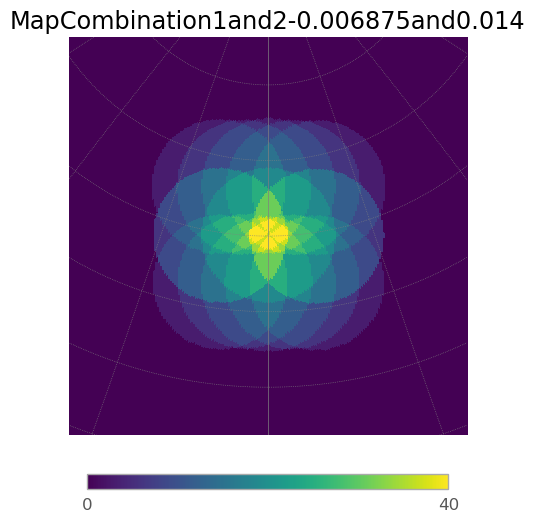

6it [00:00,  6.95it/s]
7it [00:00,  7.11it/s]
6it [00:00,  6.85it/s]
7it [00:01,  6.83it/s]
6it [00:00,  7.13it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.52it/s]


9.450044810959682


7it [00:01,  6.76it/s]


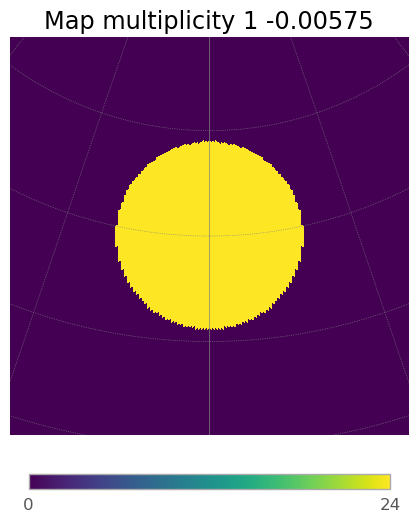

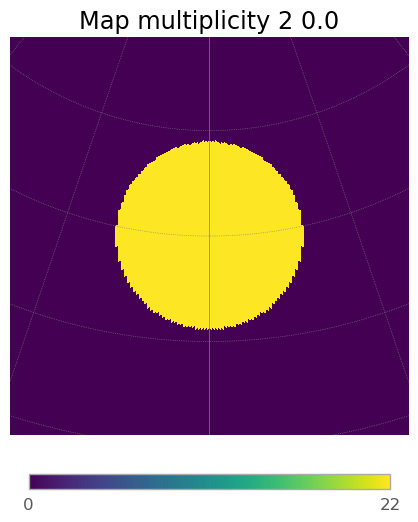

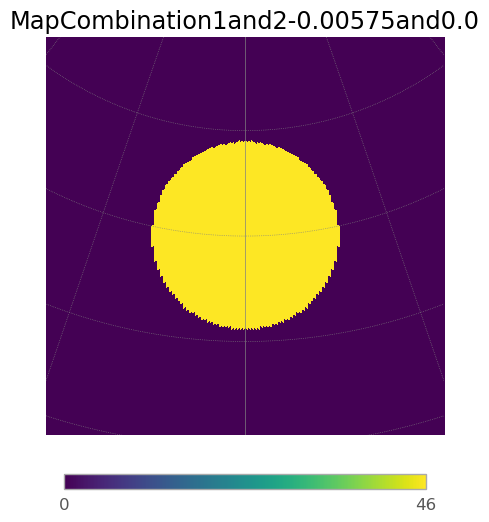

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.81it/s]
7it [00:00,  7.10it/s]
6it [00:00,  6.71it/s]
7it [00:00,  7.04it/s]
6it [00:00,  7.20it/s]
7it [00:01,  6.94it/s]
6it [00:00,  6.88it/s]


12.084619462407312


7it [00:01,  6.83it/s]


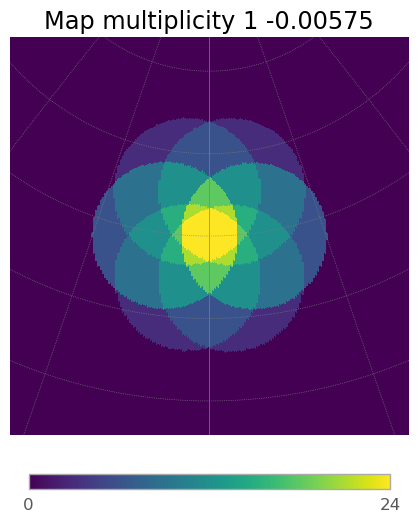

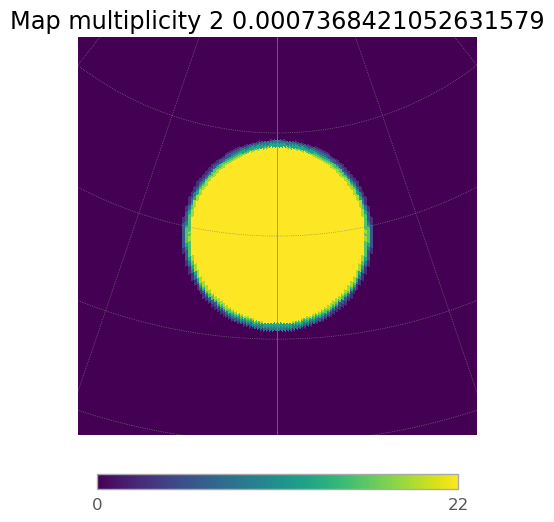

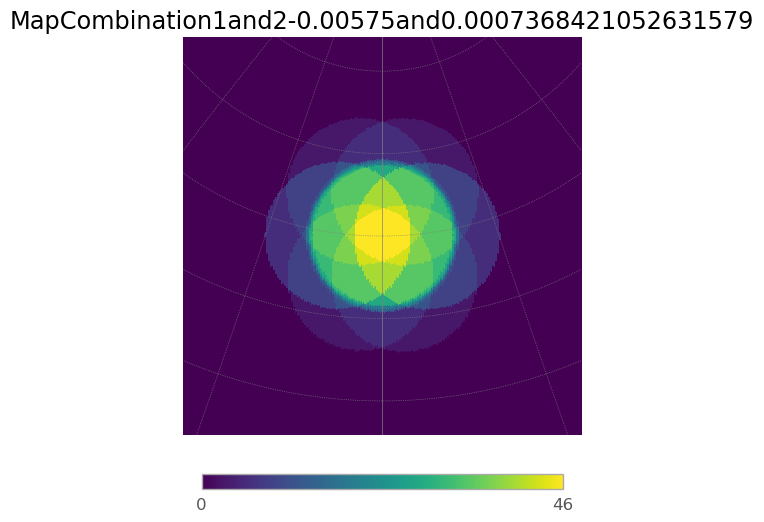

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.60it/s]
7it [00:01,  6.99it/s]
6it [00:00,  7.03it/s]
7it [00:01,  6.73it/s]
6it [00:00,  7.04it/s]
7it [00:00,  7.28it/s]
6it [00:00,  6.89it/s]


12.084619462407312


7it [00:00,  7.26it/s]


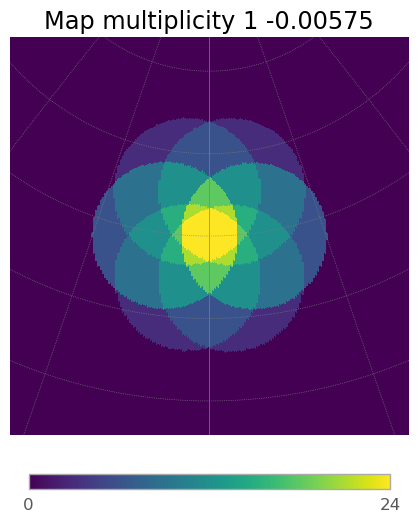

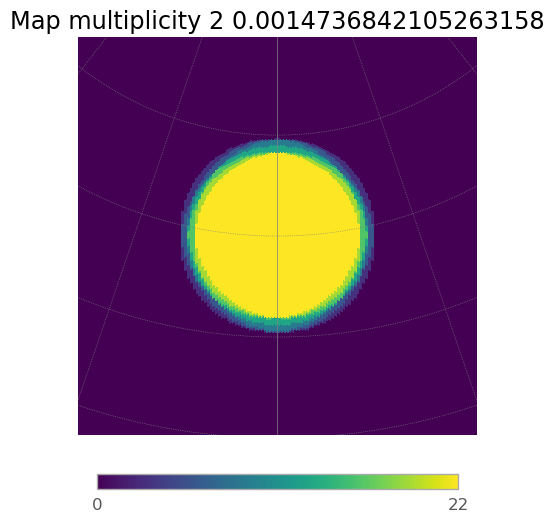

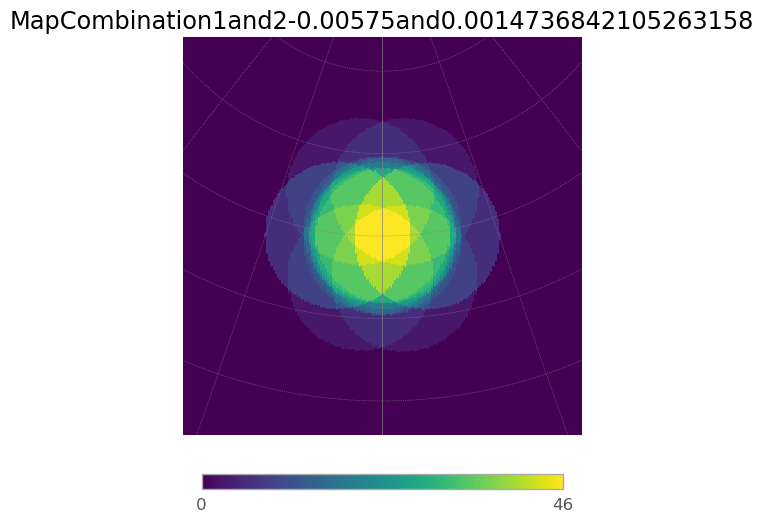

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.18it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.14it/s]
7it [00:00,  7.18it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.40it/s]
6it [00:00,  7.09it/s]


12.084619462407312


7it [00:00,  7.43it/s]


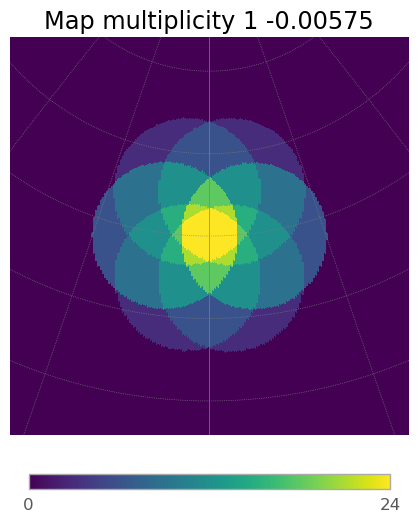

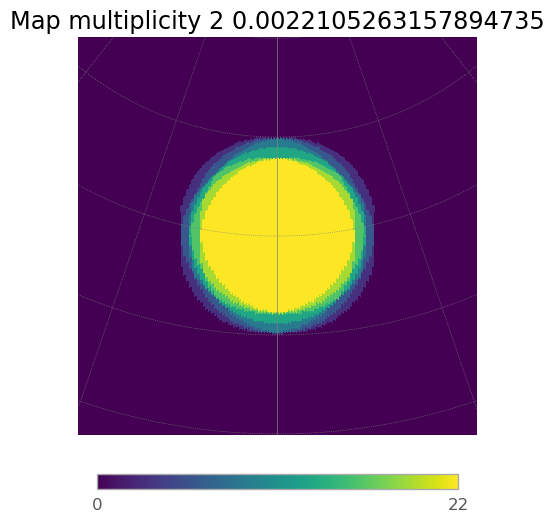

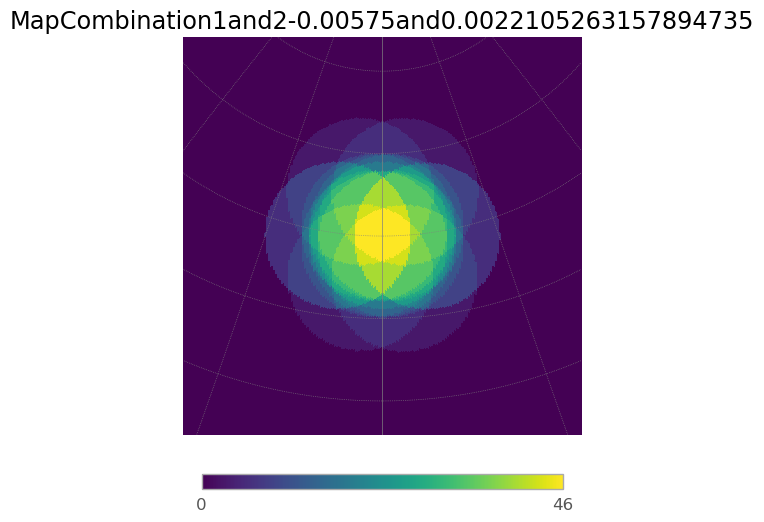

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.15it/s]
7it [00:00,  7.23it/s]
6it [00:00,  7.01it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.04it/s]
7it [00:00,  7.09it/s]
6it [00:00,  7.01it/s]


12.084619462407312


7it [00:00,  7.09it/s]


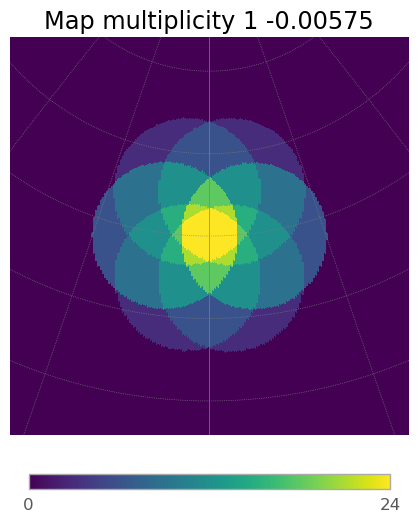

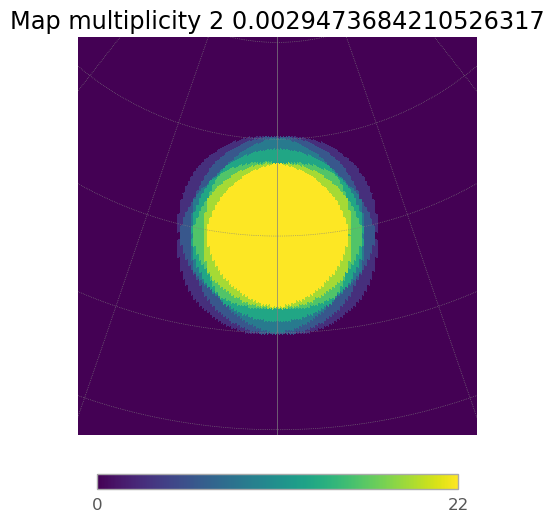

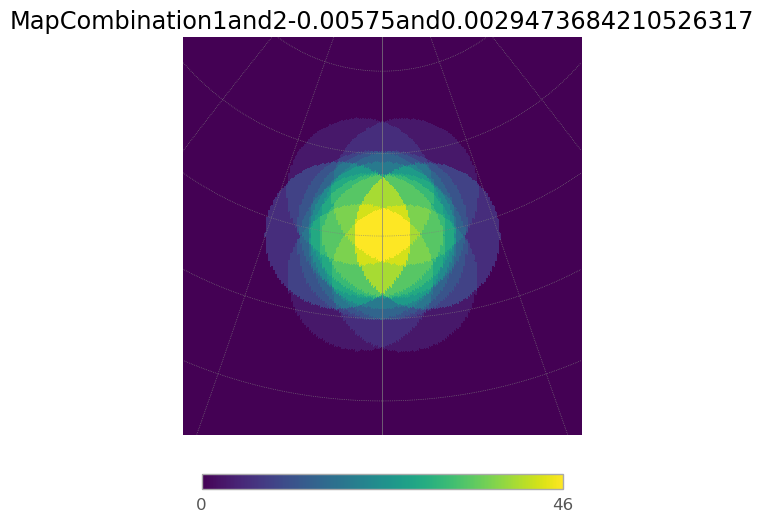

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.02it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.14it/s]
7it [00:00,  7.06it/s]
6it [00:00,  7.04it/s]
7it [00:00,  7.06it/s]
6it [00:00,  6.67it/s]


12.084619462407312


7it [00:00,  7.10it/s]


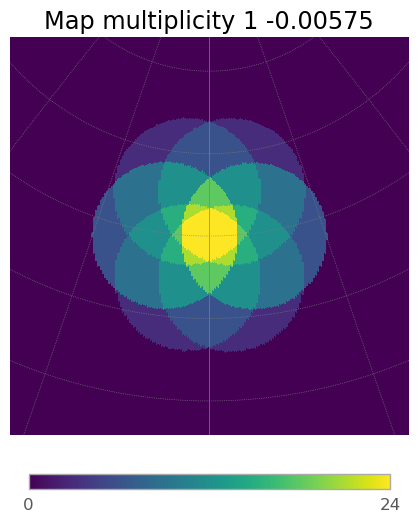

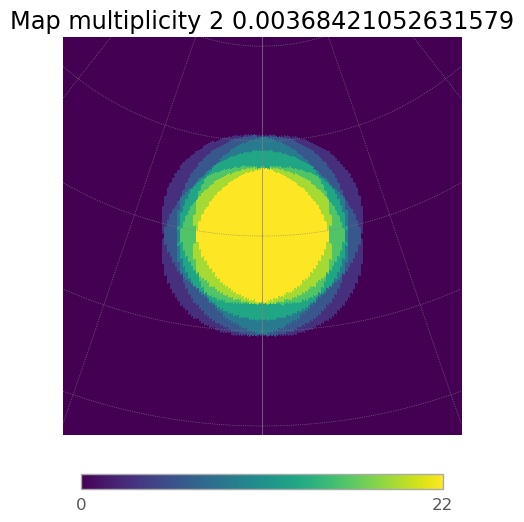

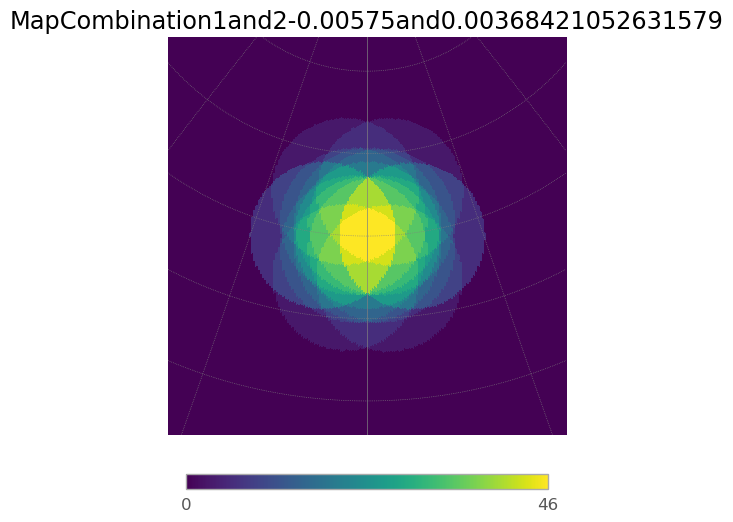

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.89it/s]
7it [00:01,  6.97it/s]
6it [00:00,  6.90it/s]
7it [00:01,  6.90it/s]
6it [00:00,  7.06it/s]
7it [00:00,  7.16it/s]
6it [00:00,  6.83it/s]


12.084619462407312


7it [00:00,  7.15it/s]


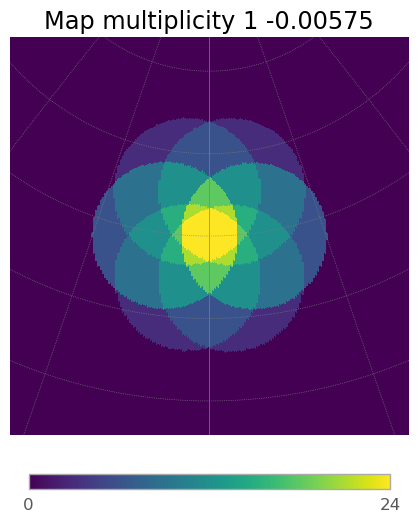

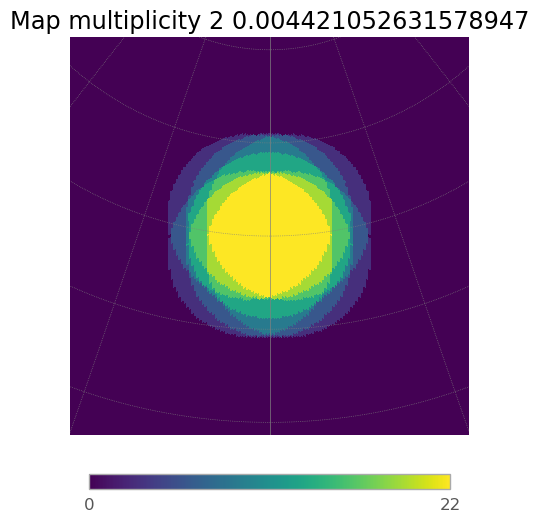

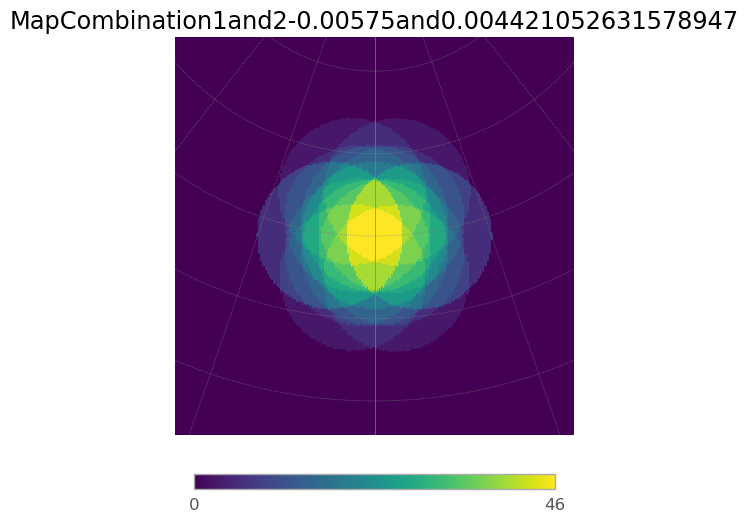

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.84it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.72it/s]
7it [00:01,  6.97it/s]
6it [00:00,  7.01it/s]
7it [00:00,  7.23it/s]
6it [00:00,  6.80it/s]


12.084619462407312


7it [00:01,  6.71it/s]


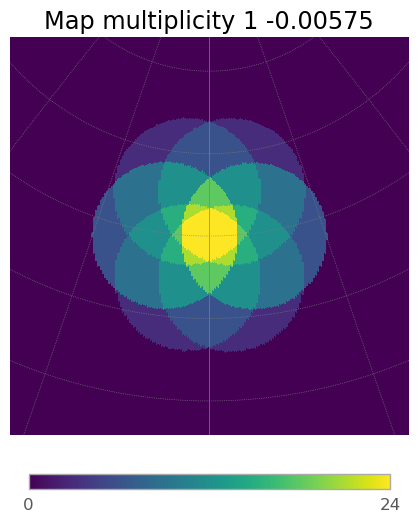

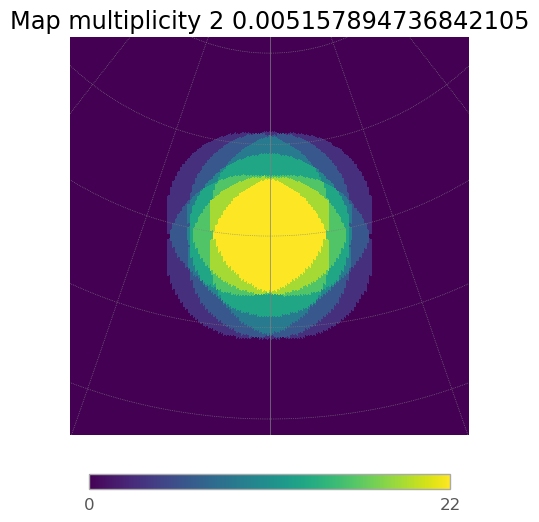

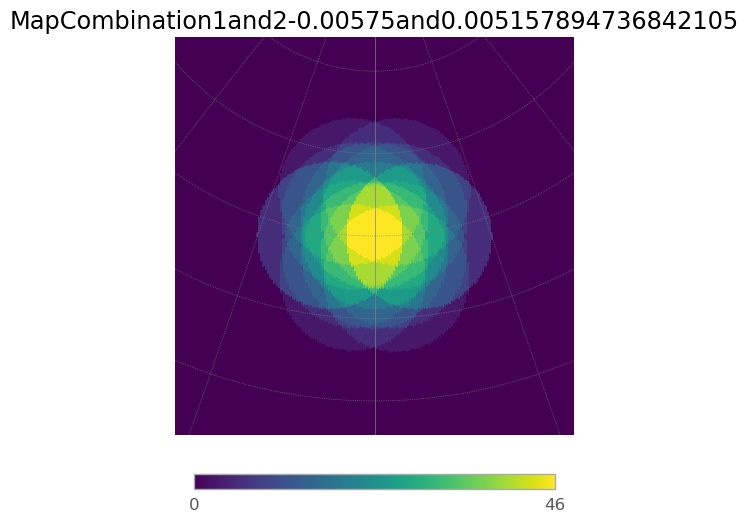

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.67it/s]
7it [00:00,  7.09it/s]
6it [00:00,  6.73it/s]
7it [00:01,  6.81it/s]
6it [00:00,  6.99it/s]
7it [00:01,  6.92it/s]
6it [00:00,  6.71it/s]


12.084619462407312


7it [00:01,  6.89it/s]


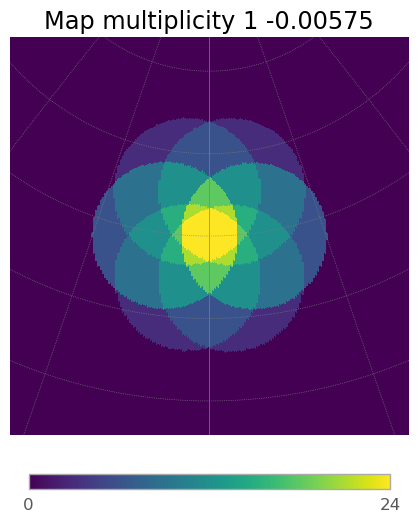

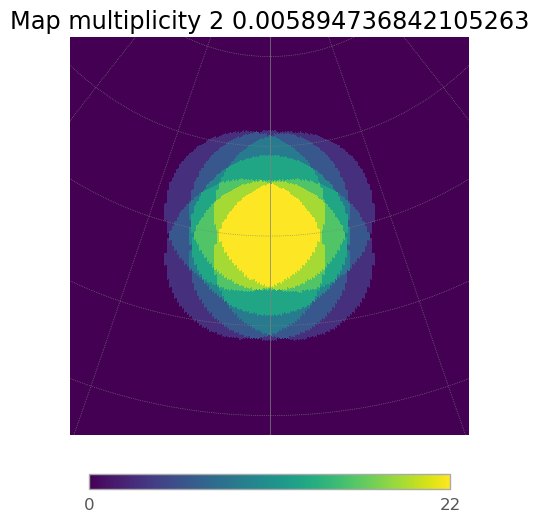

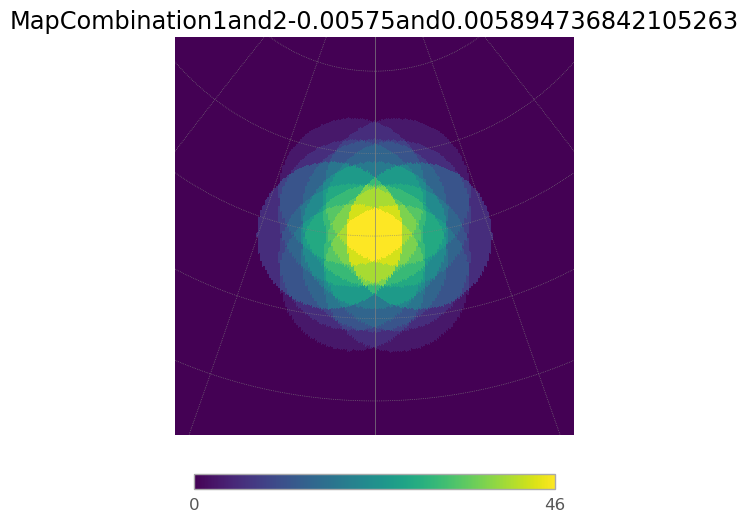

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.52it/s]
7it [00:00,  7.25it/s]
6it [00:00,  6.81it/s]
7it [00:00,  7.03it/s]
6it [00:00,  7.18it/s]
7it [00:00,  7.22it/s]
6it [00:00,  6.72it/s]


12.084619462407312


7it [00:00,  7.28it/s]


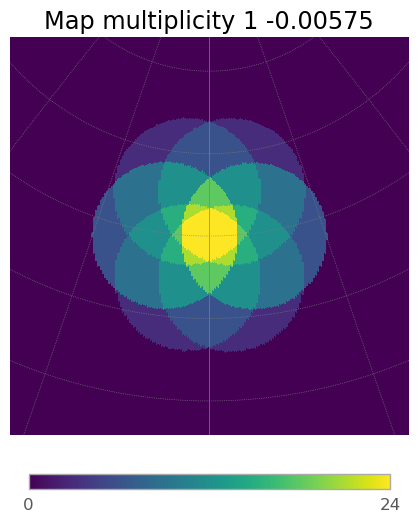

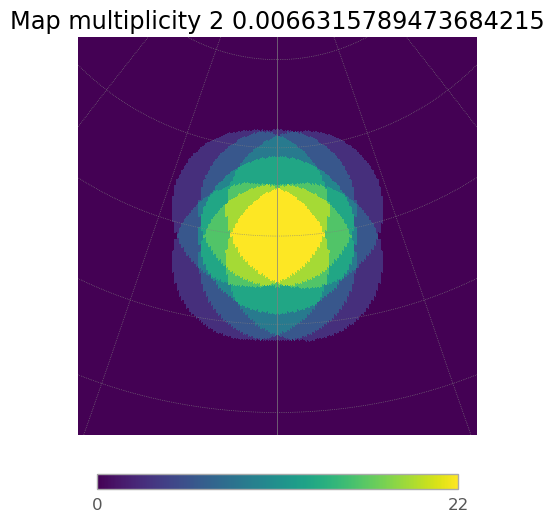

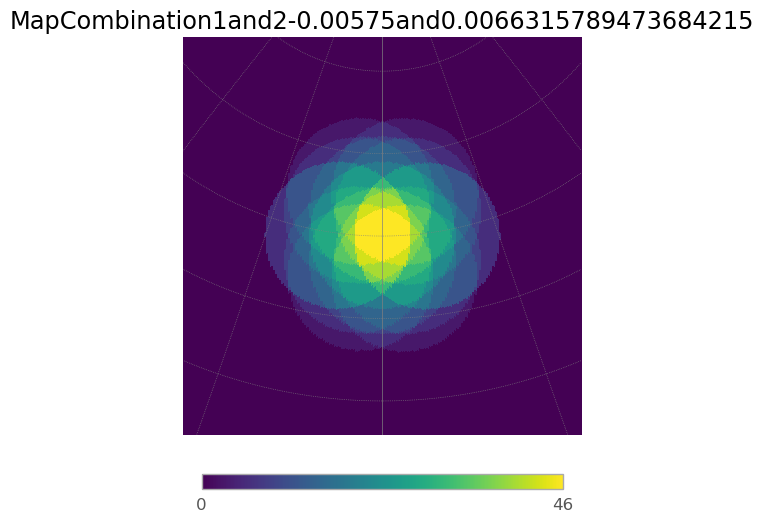

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.01it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.65it/s]
7it [00:00,  7.13it/s]
6it [00:00,  7.08it/s]
7it [00:00,  7.14it/s]
6it [00:00,  6.98it/s]


12.084619462407312


7it [00:01,  6.81it/s]


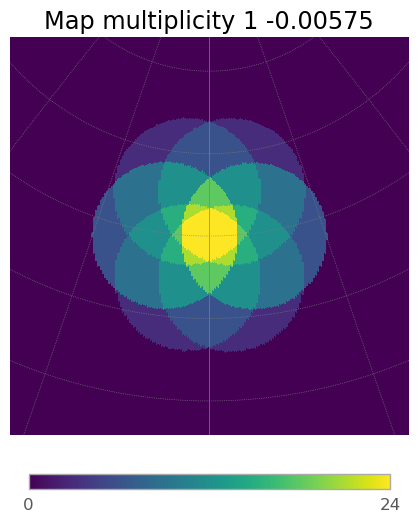

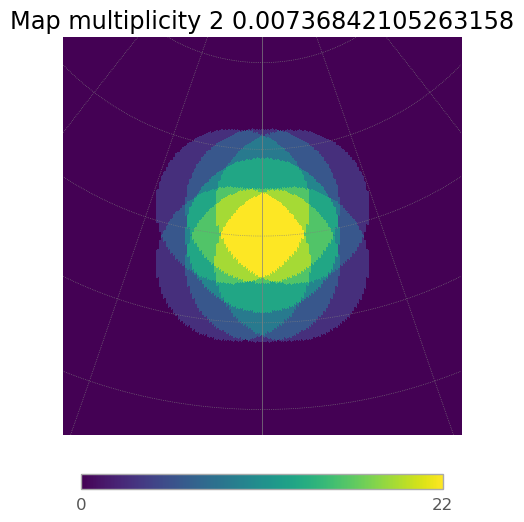

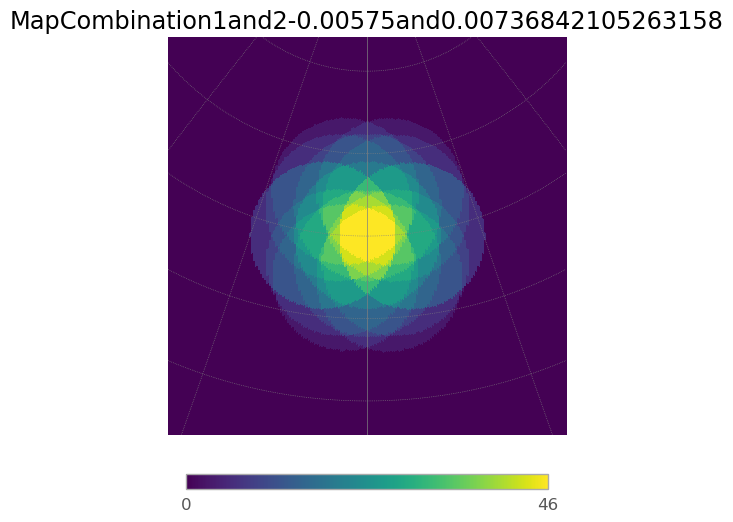

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.74it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.77it/s]
7it [00:00,  7.25it/s]
6it [00:00,  7.35it/s]
7it [00:00,  7.10it/s]
6it [00:00,  6.66it/s]


12.084619462407312


7it [00:01,  6.61it/s]


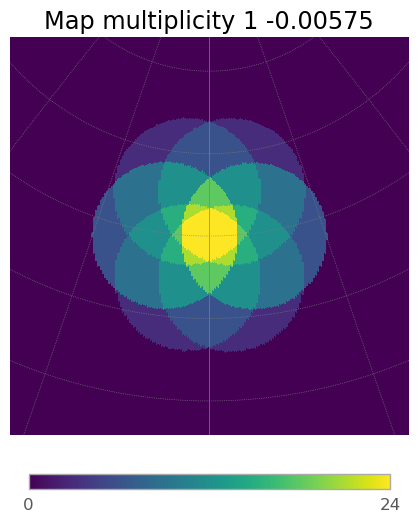

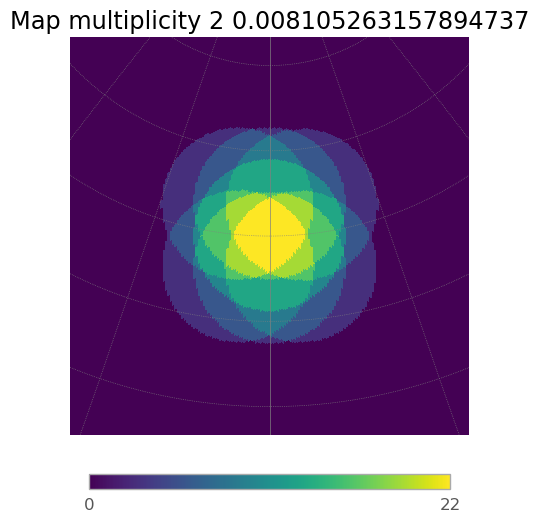

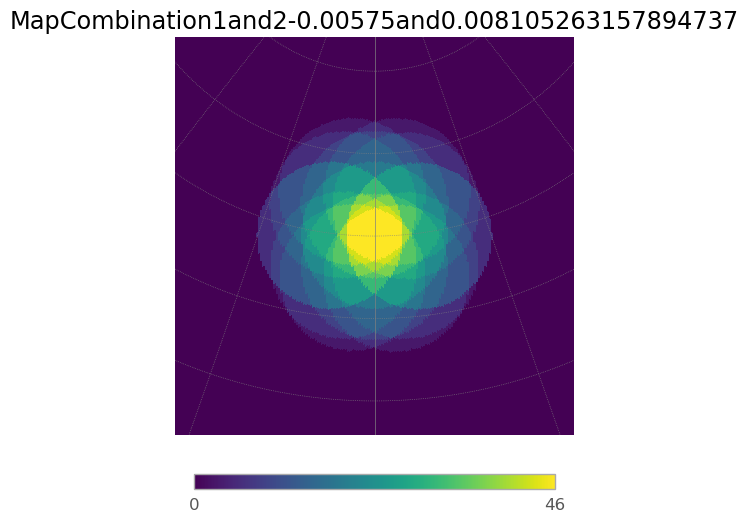

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.58it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.87it/s]
7it [00:01,  6.95it/s]
6it [00:00,  6.98it/s]
7it [00:01,  6.92it/s]
6it [00:00,  6.13it/s]


12.084619462407312


7it [00:01,  6.71it/s]


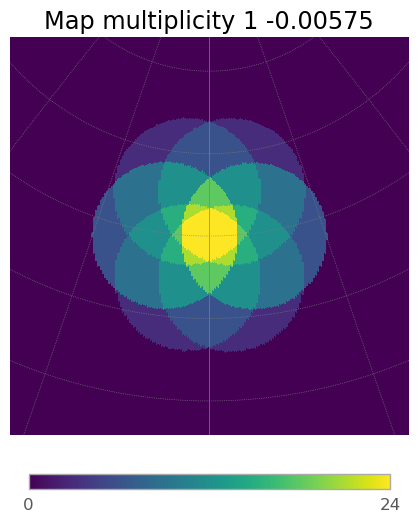

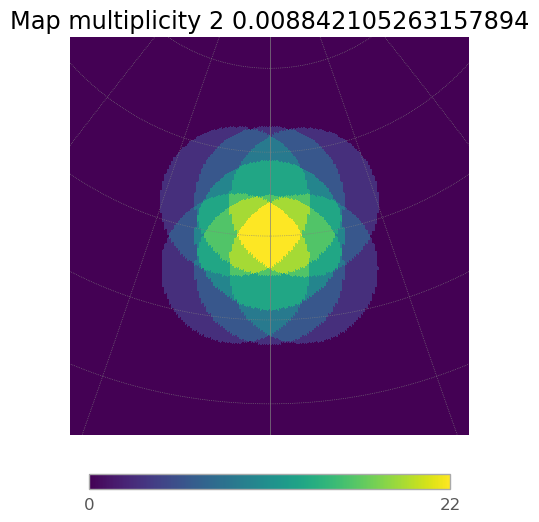

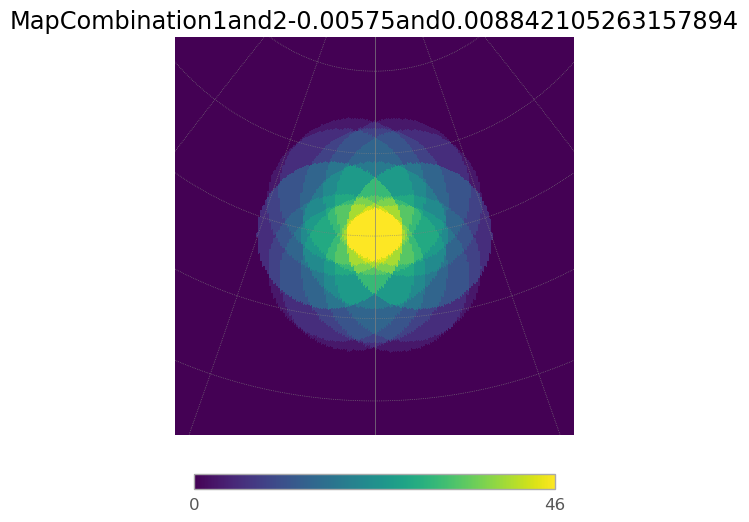

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.87it/s]
7it [00:01,  6.73it/s]
6it [00:00,  6.65it/s]
7it [00:01,  6.81it/s]
6it [00:00,  6.85it/s]
7it [00:01,  6.96it/s]
6it [00:00,  6.73it/s]


12.084619462407312


7it [00:01,  6.89it/s]


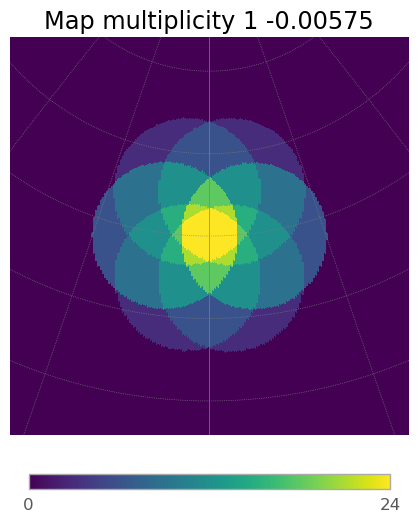

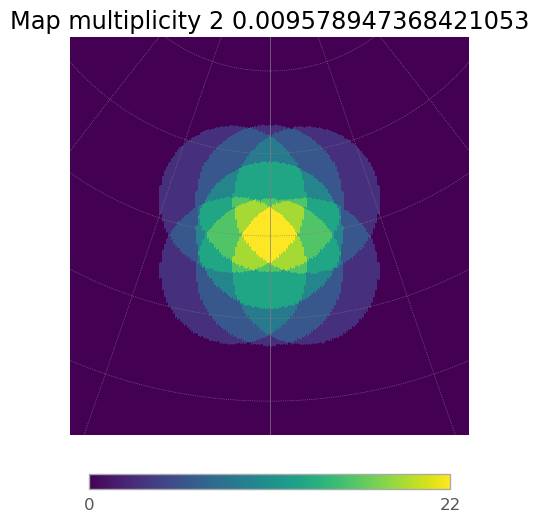

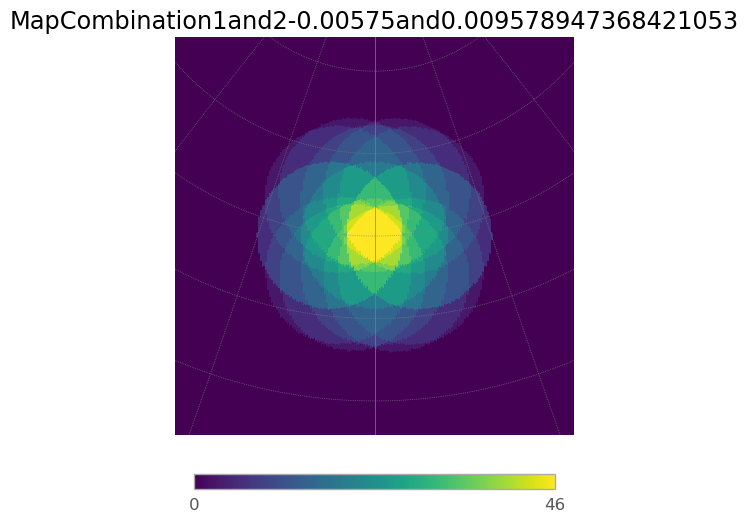

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.72it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.63it/s]
7it [00:00,  7.06it/s]
6it [00:00,  7.13it/s]
7it [00:00,  7.15it/s]
6it [00:00,  6.73it/s]


12.084619462407312


7it [00:01,  6.18it/s]


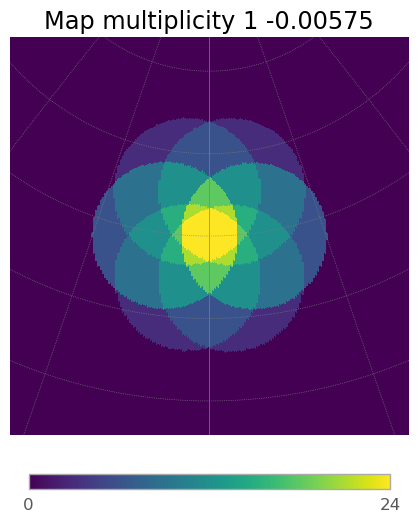

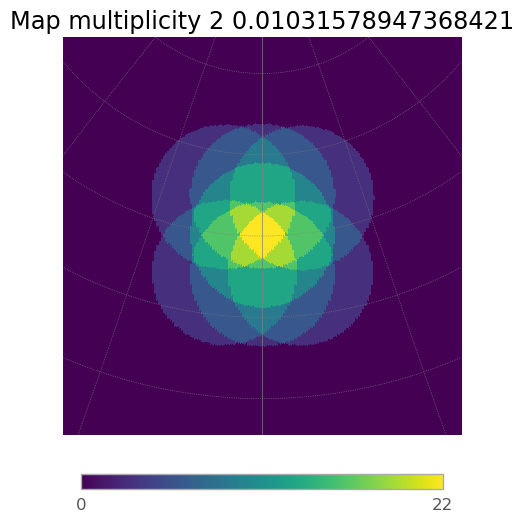

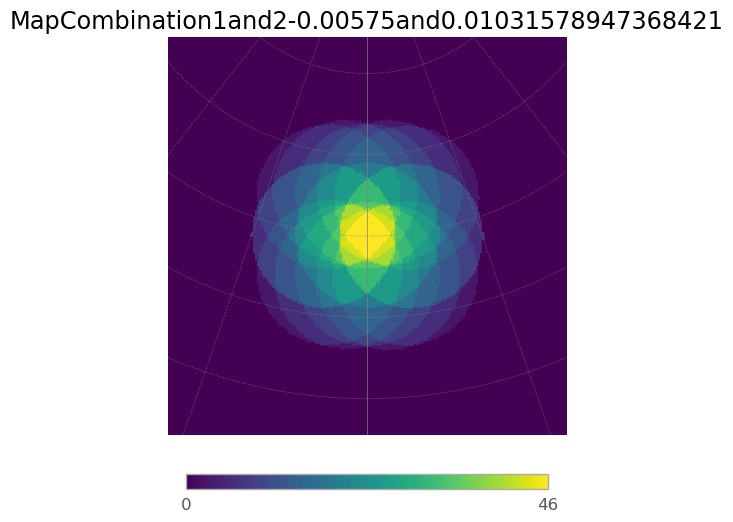

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.59it/s]
7it [00:01,  6.74it/s]
6it [00:00,  6.69it/s]
7it [00:00,  7.15it/s]
6it [00:00,  7.30it/s]
7it [00:00,  7.09it/s]
6it [00:00,  7.01it/s]


12.084619462407312


7it [00:00,  7.26it/s]


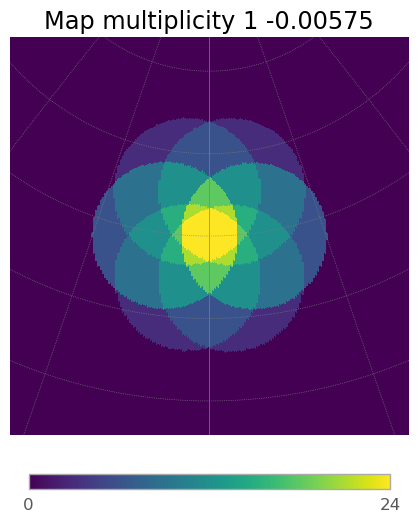

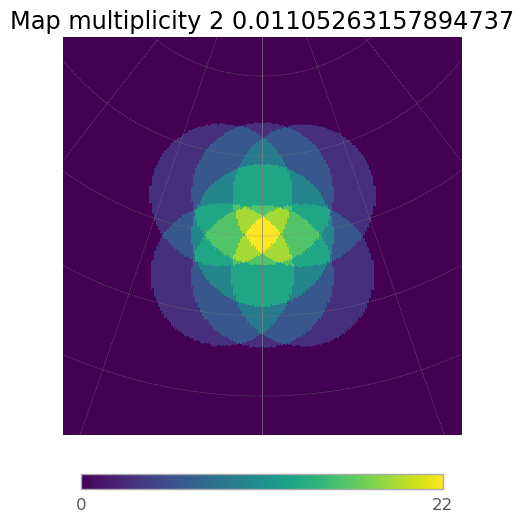

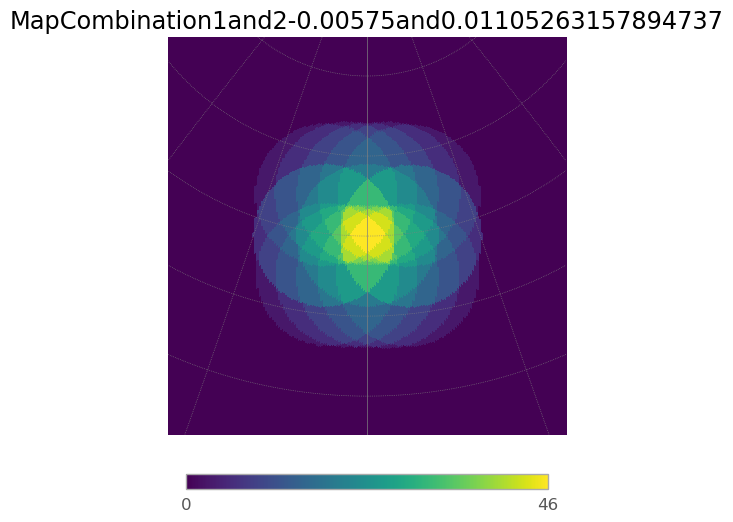

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.03it/s]
7it [00:00,  7.32it/s]
6it [00:00,  6.92it/s]
7it [00:00,  7.19it/s]
6it [00:00,  7.11it/s]
7it [00:00,  7.17it/s]
6it [00:00,  6.87it/s]


12.084619462407312


7it [00:00,  7.22it/s]


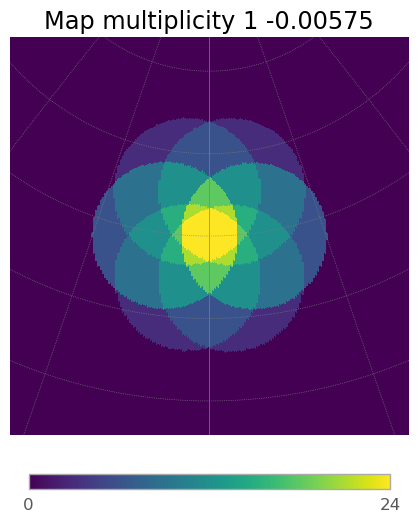

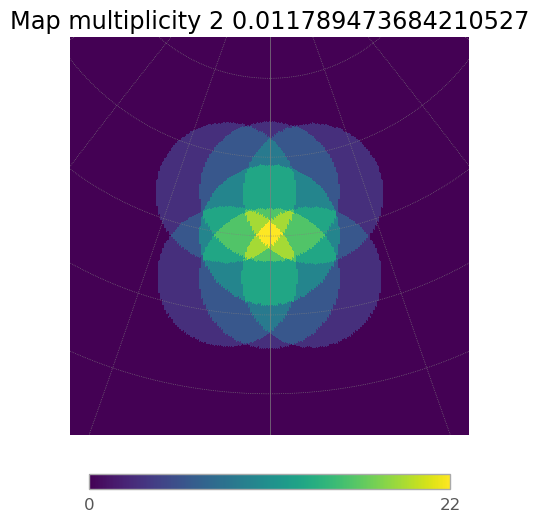

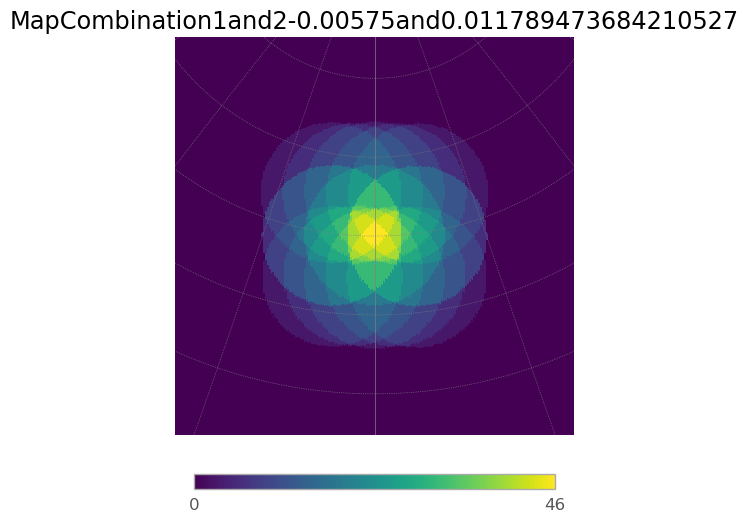

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.09it/s]
7it [00:00,  7.23it/s]
6it [00:00,  7.02it/s]
7it [00:00,  7.16it/s]
6it [00:00,  6.83it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.74it/s]


12.084619462407312


7it [00:00,  7.28it/s]


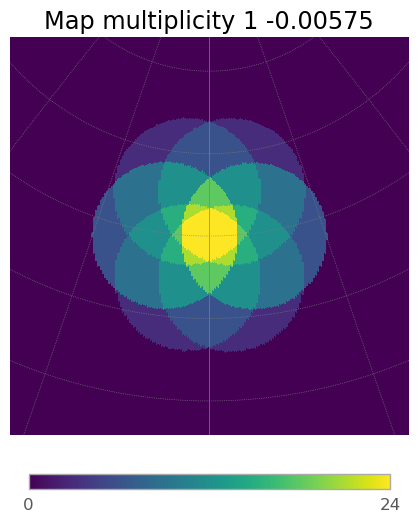

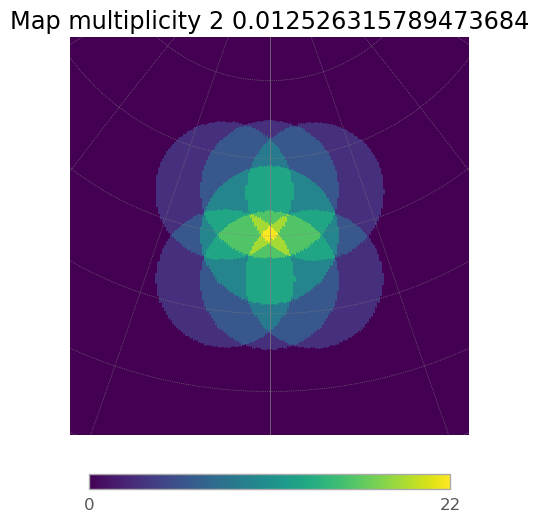

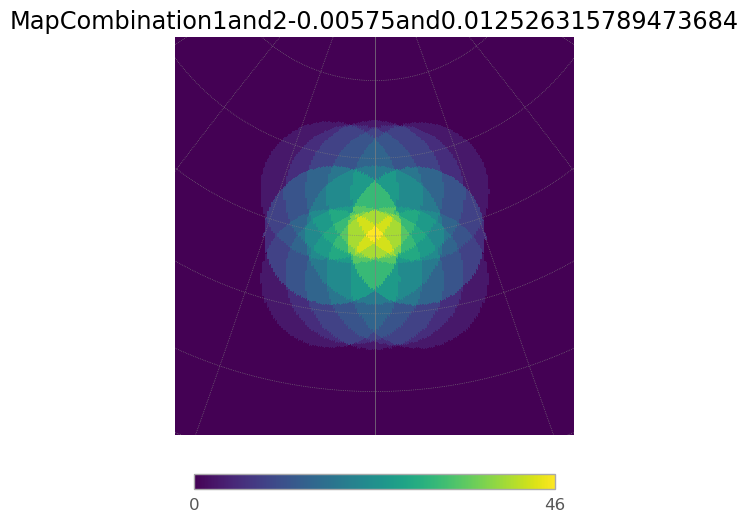

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.87it/s]
7it [00:00,  7.03it/s]
6it [00:00,  6.71it/s]
7it [00:00,  7.27it/s]
6it [00:00,  7.31it/s]
7it [00:00,  7.03it/s]
6it [00:00,  7.04it/s]


12.084619462407312


7it [00:00,  7.18it/s]


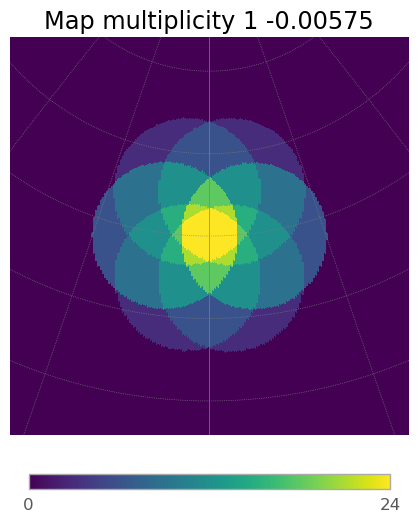

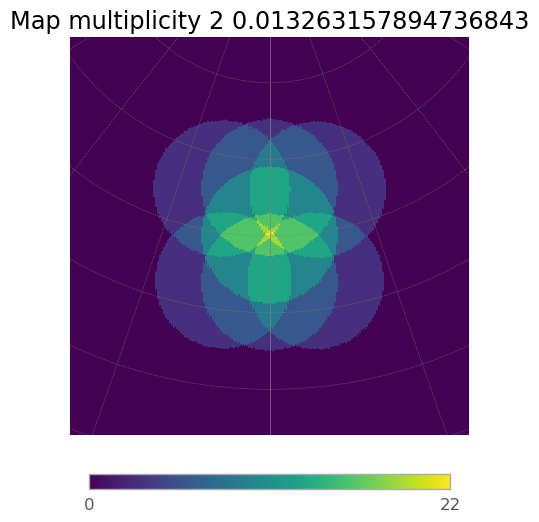

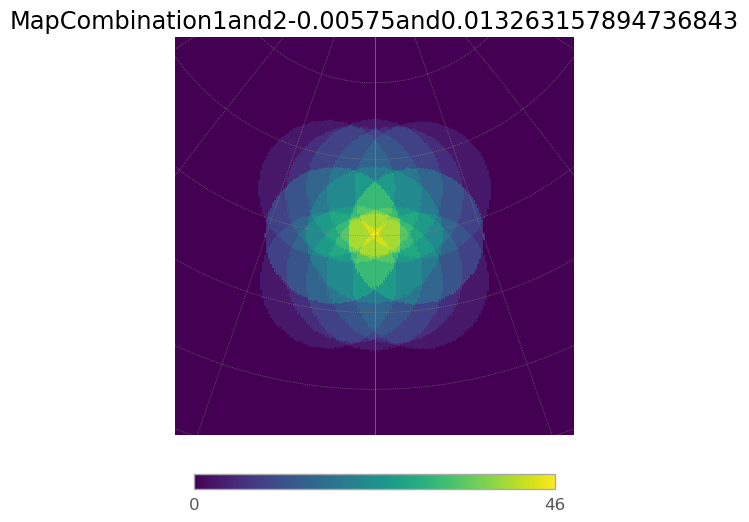

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.07it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.02it/s]
7it [00:00,  7.10it/s]
6it [00:00,  6.89it/s]
7it [00:01,  6.81it/s]
6it [00:00,  6.90it/s]


12.084619462407312


7it [00:00,  7.39it/s]


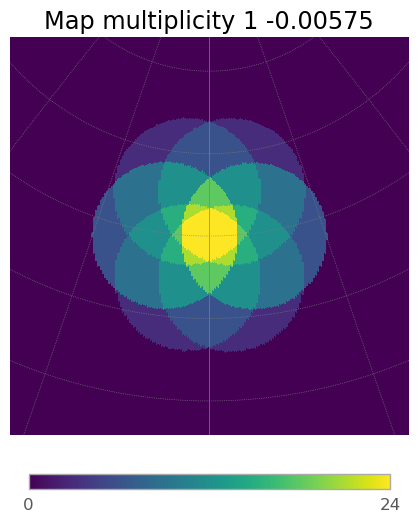

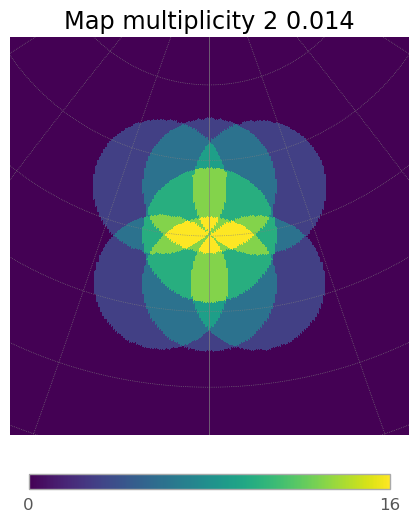

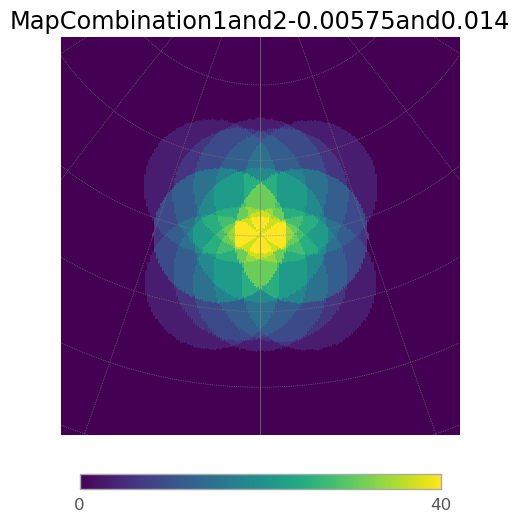

6it [00:00,  6.86it/s]
7it [00:00,  7.12it/s]
6it [00:00,  7.05it/s]
7it [00:00,  7.32it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.23it/s]
6it [00:00,  6.71it/s]


9.450044810959682


7it [00:00,  7.13it/s]


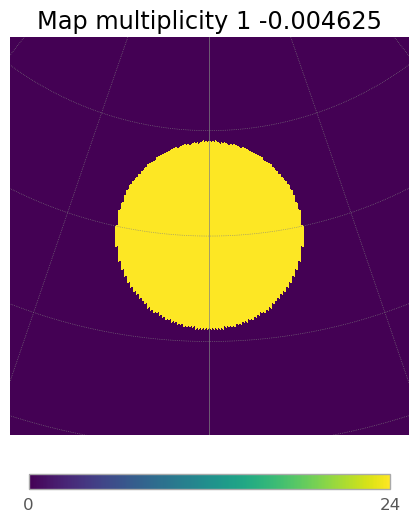

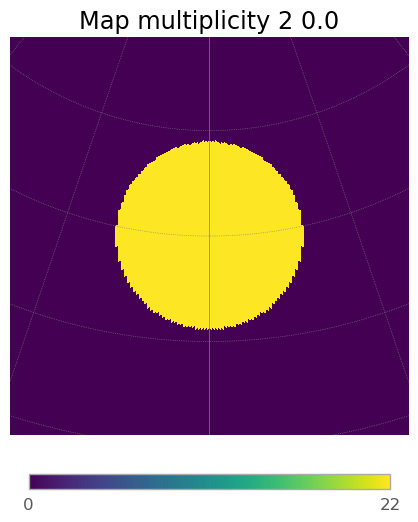

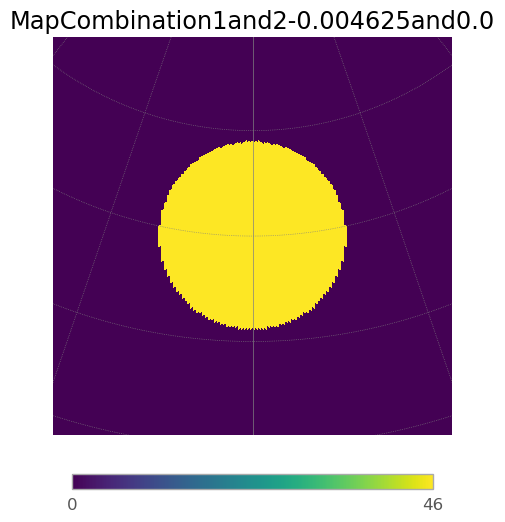

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.10it/s]
7it [00:00,  7.06it/s]
6it [00:00,  6.80it/s]
7it [00:00,  7.02it/s]
6it [00:00,  6.92it/s]
7it [00:00,  7.12it/s]
6it [00:00,  6.72it/s]


11.585350838438595


7it [00:00,  7.28it/s]


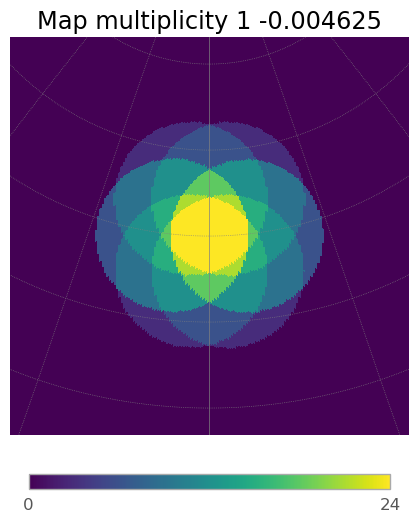

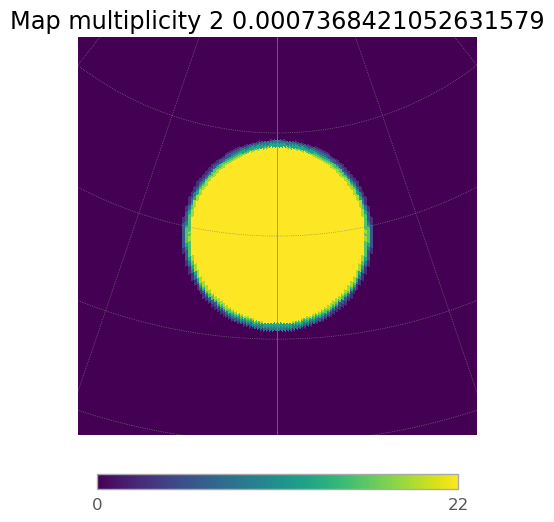

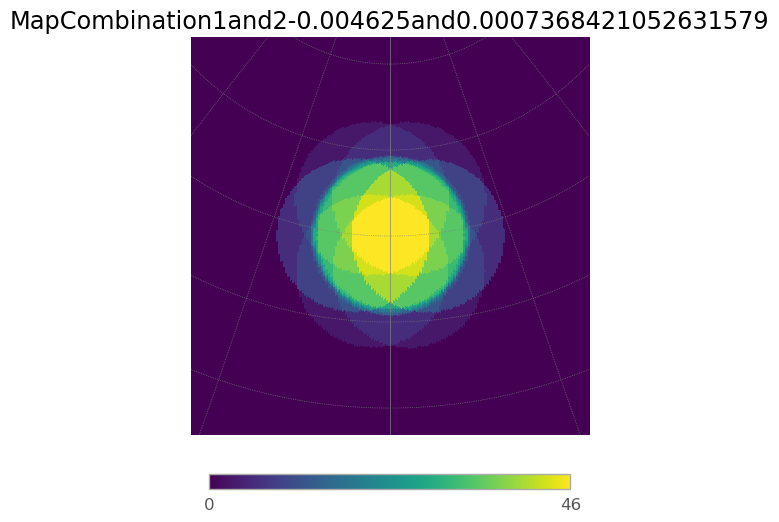

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.49it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.83it/s]
7it [00:00,  7.05it/s]
6it [00:00,  6.97it/s]
7it [00:00,  7.03it/s]
6it [00:00,  6.51it/s]


11.585350838438595


7it [00:01,  6.64it/s]


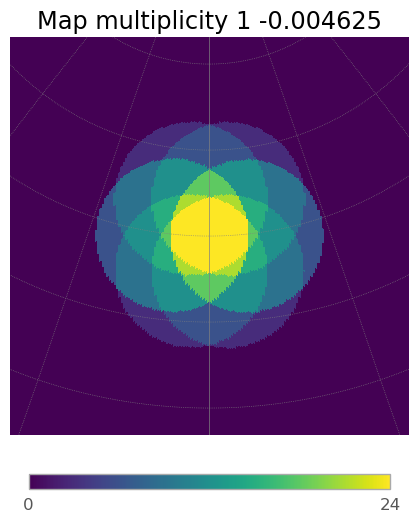

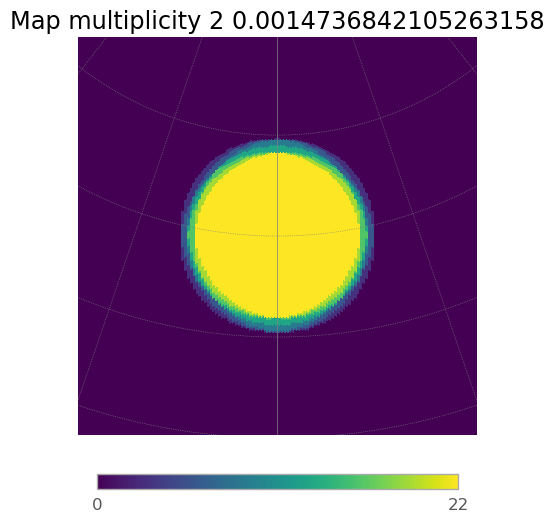

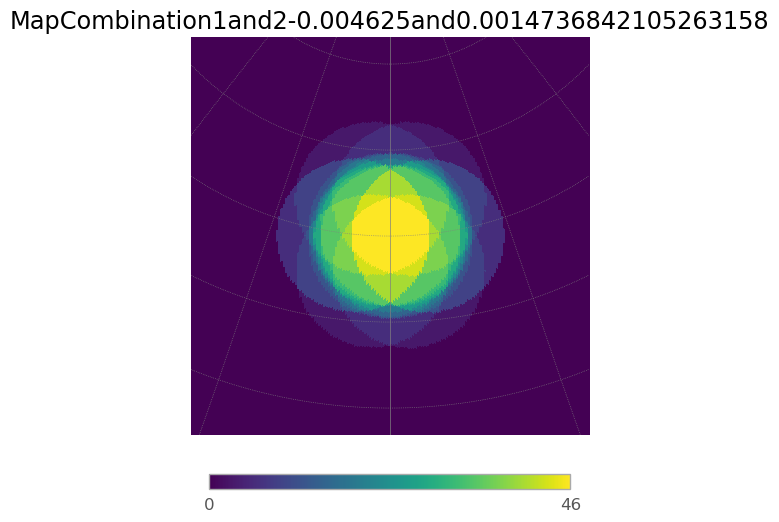

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.78it/s]
7it [00:01,  6.64it/s]
6it [00:00,  6.75it/s]
7it [00:00,  7.07it/s]
6it [00:00,  7.36it/s]
7it [00:01,  6.44it/s]
6it [00:00,  6.88it/s]


11.585350838438595


7it [00:00,  7.15it/s]


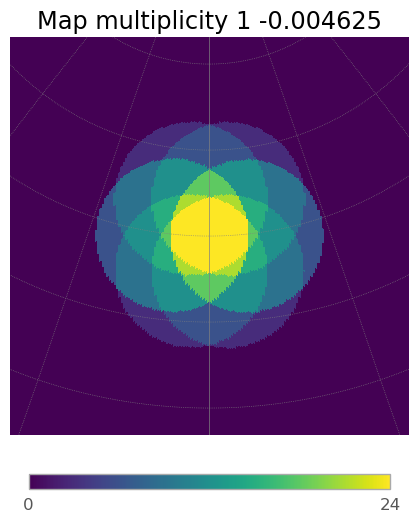

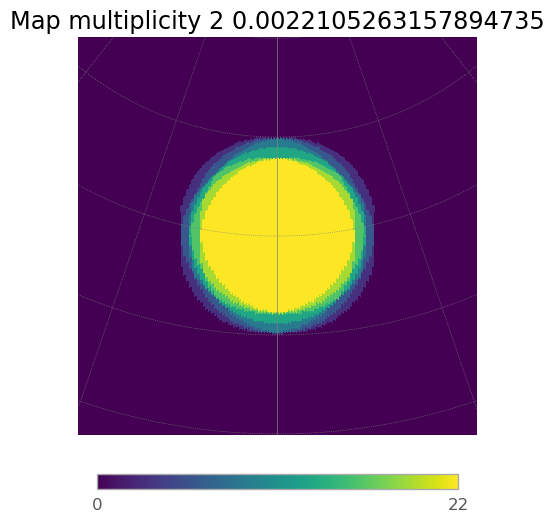

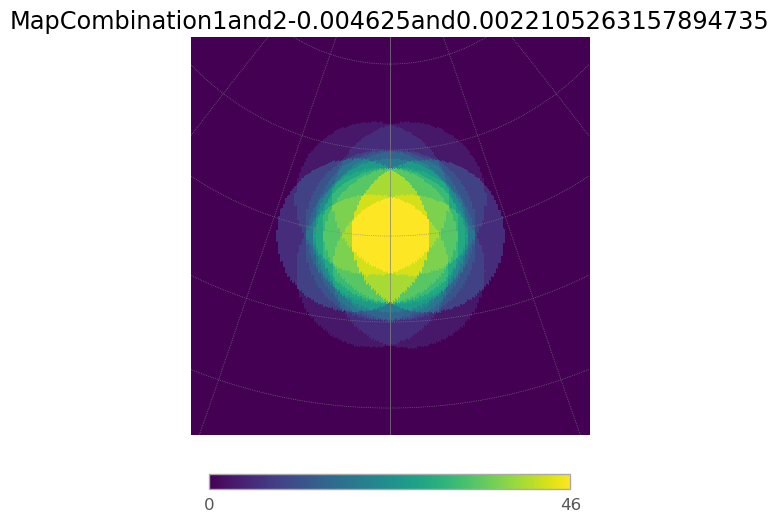

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.70it/s]
7it [00:01,  6.82it/s]
6it [00:00,  6.53it/s]
7it [00:00,  7.13it/s]
6it [00:00,  7.02it/s]
7it [00:01,  7.00it/s]
6it [00:00,  6.63it/s]


11.585350838438595


7it [00:01,  6.85it/s]


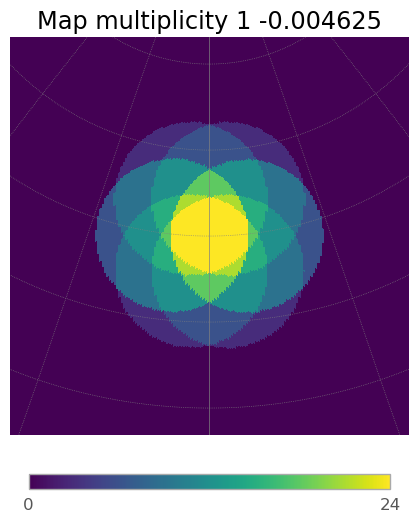

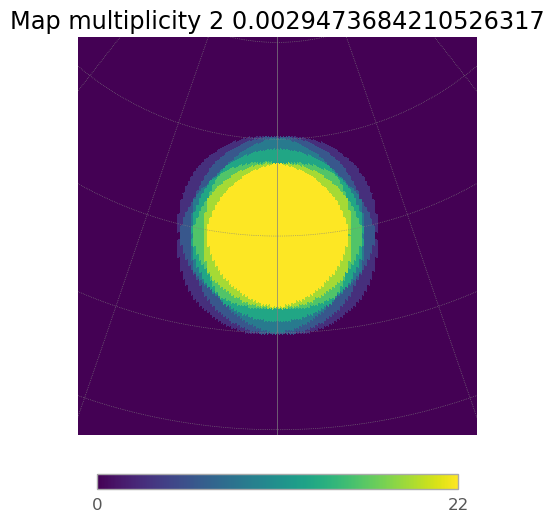

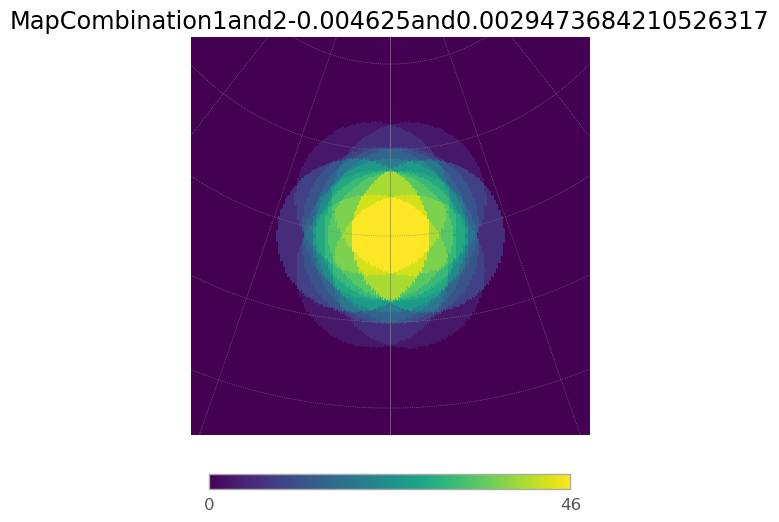

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.65it/s]
7it [00:01,  6.82it/s]
6it [00:00,  6.65it/s]
7it [00:01,  6.74it/s]
6it [00:00,  7.15it/s]
7it [00:00,  7.03it/s]
6it [00:00,  6.92it/s]


11.585350838438595


7it [00:01,  6.98it/s]


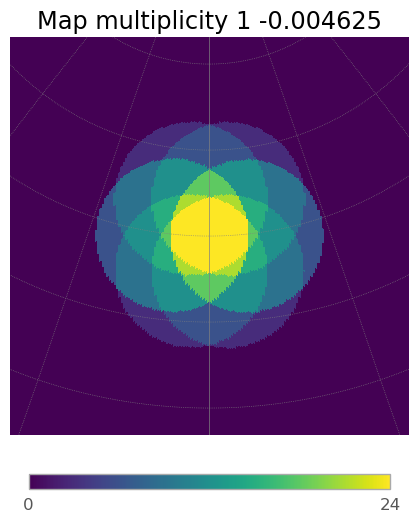

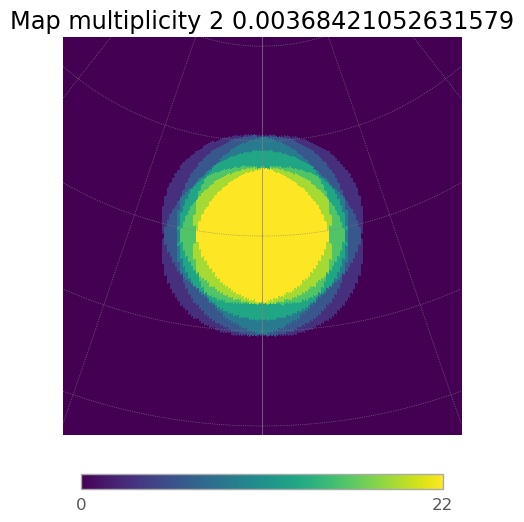

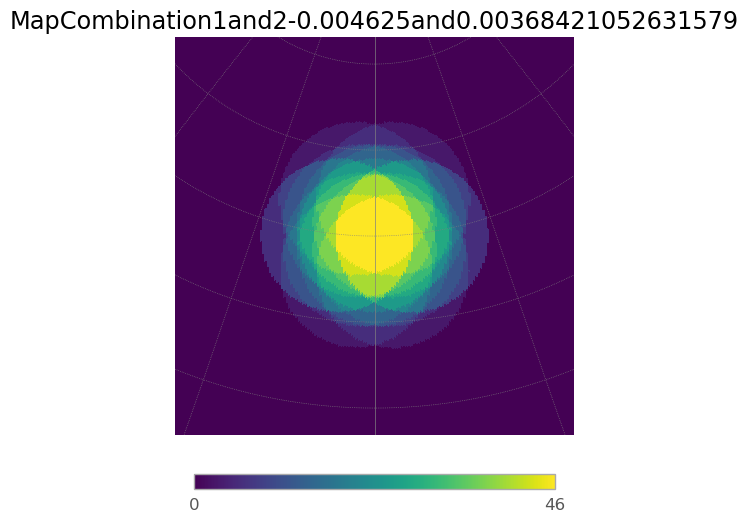

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.84it/s]
7it [00:00,  7.13it/s]
6it [00:00,  6.95it/s]
7it [00:00,  7.25it/s]
6it [00:00,  7.13it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.62it/s]


11.585350838438595


7it [00:01,  6.95it/s]


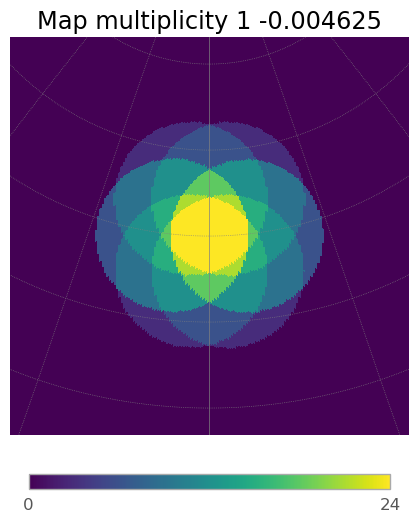

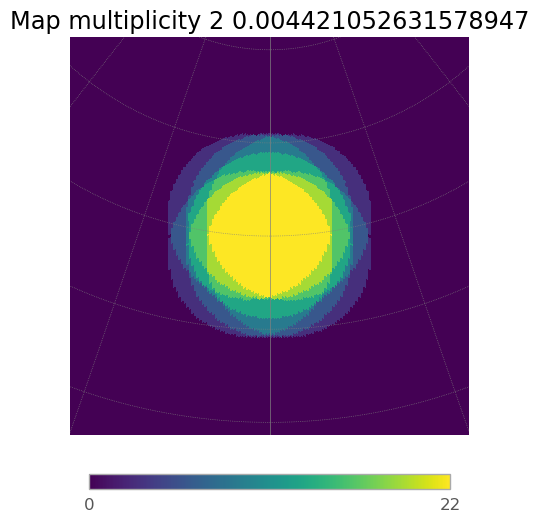

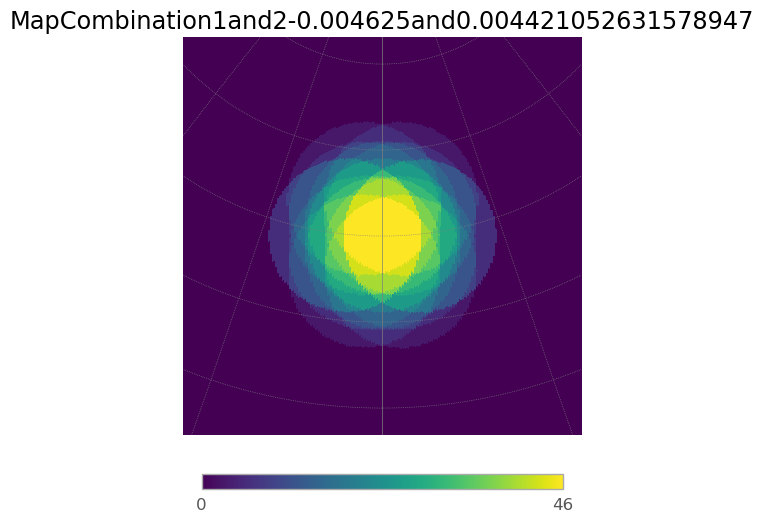

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.96it/s]
7it [00:01,  6.92it/s]
6it [00:00,  6.44it/s]
7it [00:00,  7.02it/s]
6it [00:00,  6.70it/s]
7it [00:01,  6.82it/s]
6it [00:00,  6.37it/s]


11.585350838438595


7it [00:01,  6.60it/s]


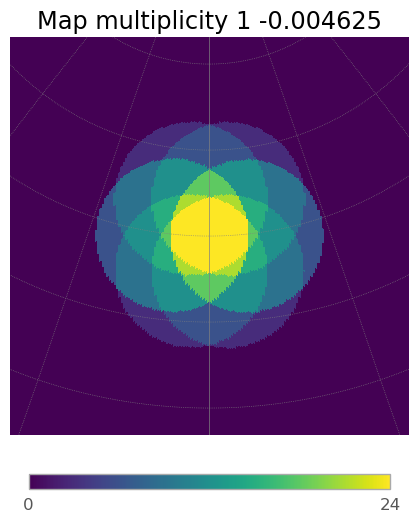

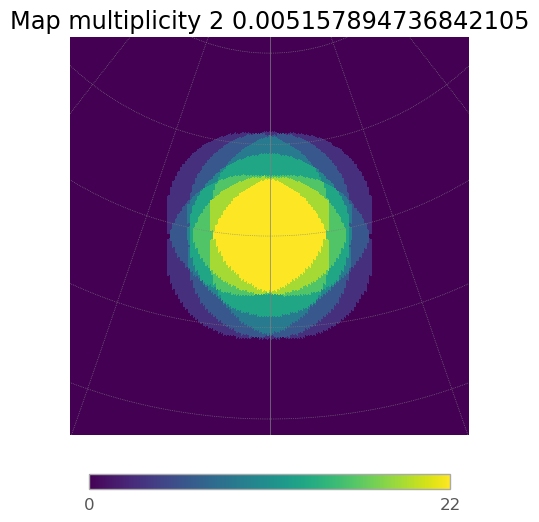

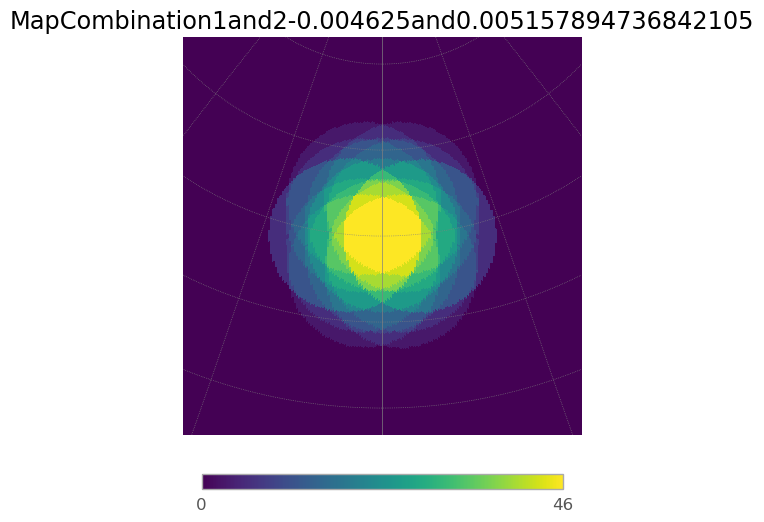

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.83it/s]
7it [00:01,  6.95it/s]
6it [00:00,  6.57it/s]
7it [00:00,  7.31it/s]
6it [00:00,  7.18it/s]
7it [00:00,  7.13it/s]
6it [00:00,  6.89it/s]


11.585350838438595


7it [00:01,  6.94it/s]


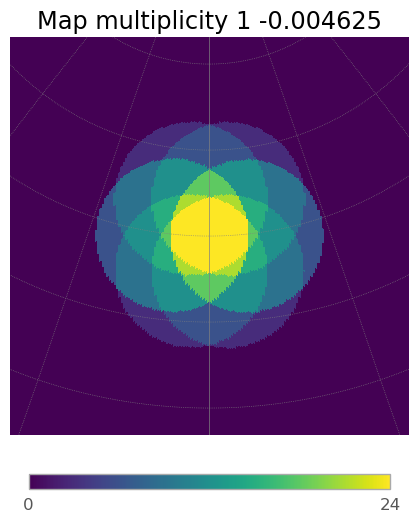

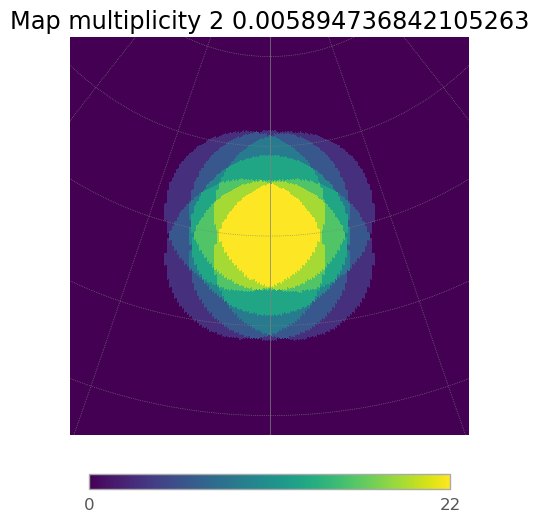

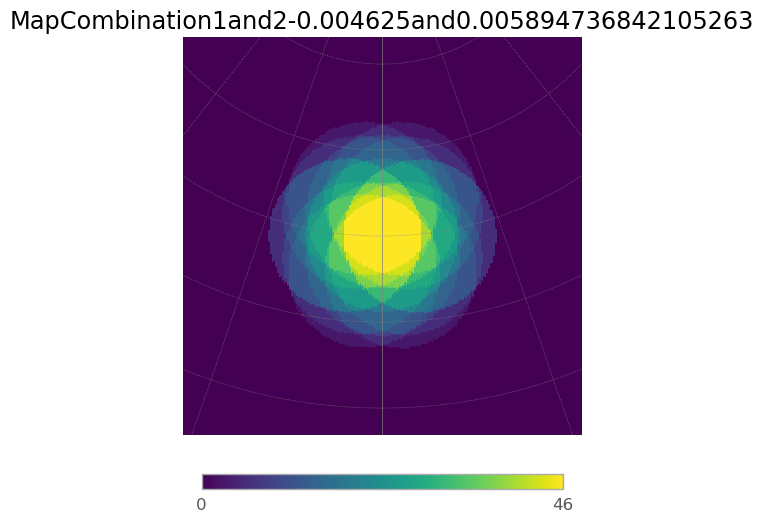

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.07it/s]
7it [00:00,  7.13it/s]
6it [00:00,  6.99it/s]
7it [00:00,  7.06it/s]
6it [00:00,  7.09it/s]
7it [00:01,  6.84it/s]
6it [00:00,  6.78it/s]


11.585350838438595


7it [00:01,  6.96it/s]


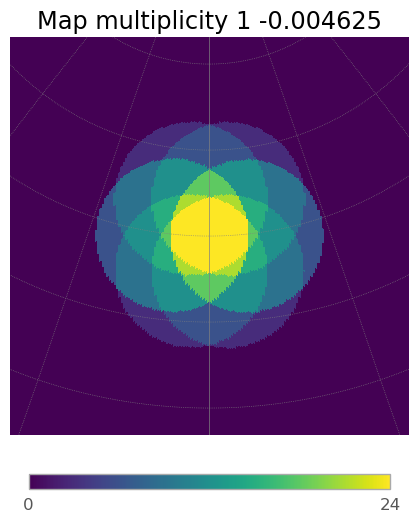

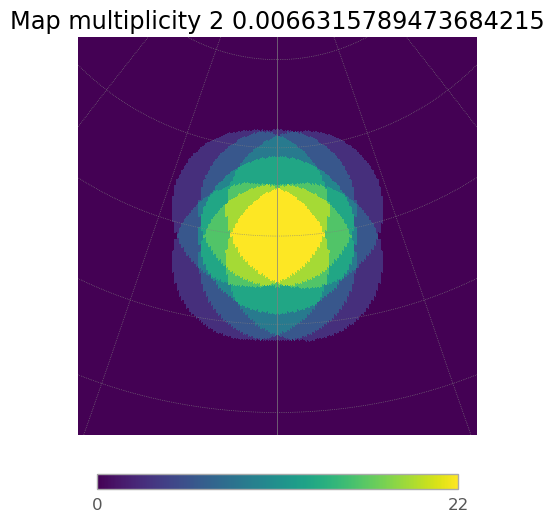

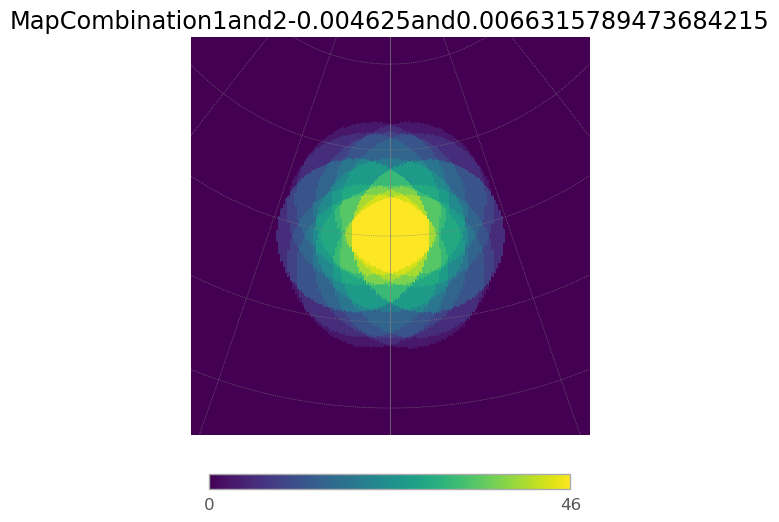

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.00it/s]
7it [00:00,  7.26it/s]
6it [00:00,  6.94it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.14it/s]
7it [00:00,  7.27it/s]
6it [00:00,  6.86it/s]


11.585350838438595


7it [00:00,  7.36it/s]


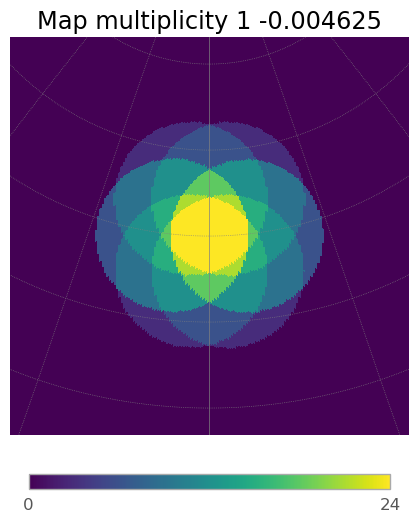

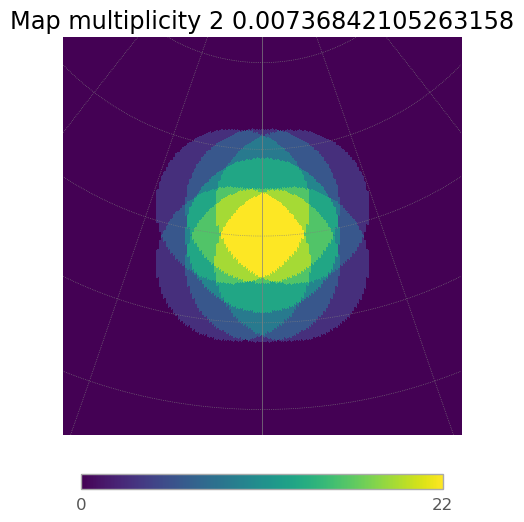

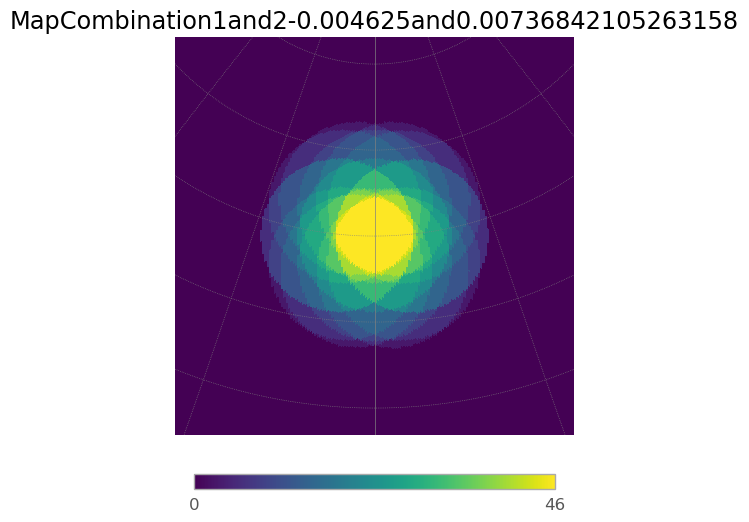

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.10it/s]
7it [00:01,  6.96it/s]
6it [00:00,  6.98it/s]
7it [00:00,  7.22it/s]
6it [00:00,  7.11it/s]
7it [00:00,  7.11it/s]
6it [00:00,  6.93it/s]


11.585350838438595


7it [00:00,  7.08it/s]


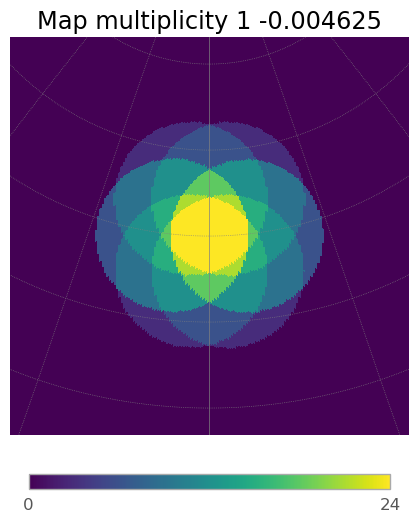

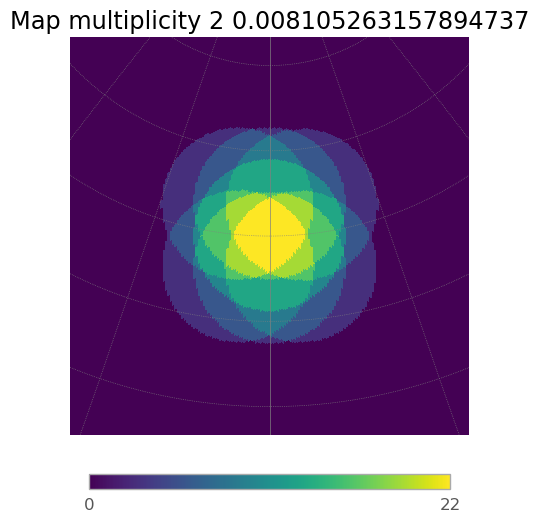

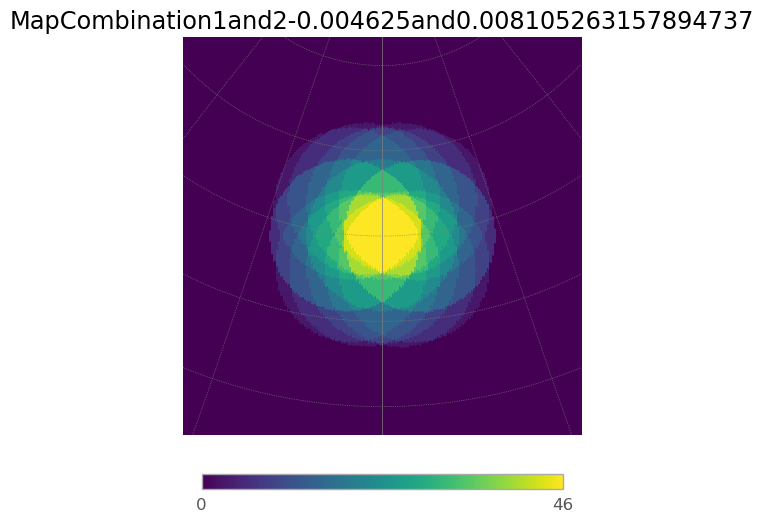

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.11it/s]
7it [00:00,  7.40it/s]
6it [00:00,  7.13it/s]
7it [00:00,  7.44it/s]
6it [00:00,  7.20it/s]
7it [00:00,  7.21it/s]
6it [00:00,  6.70it/s]


11.585350838438595


7it [00:00,  7.35it/s]


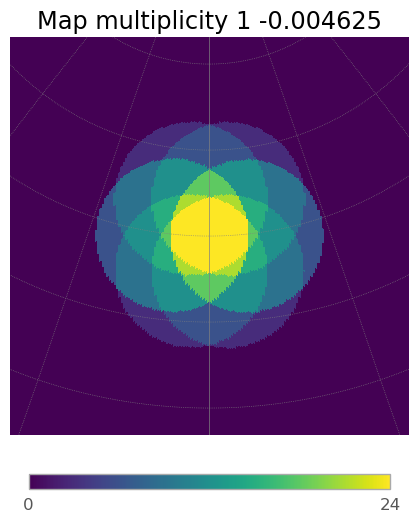

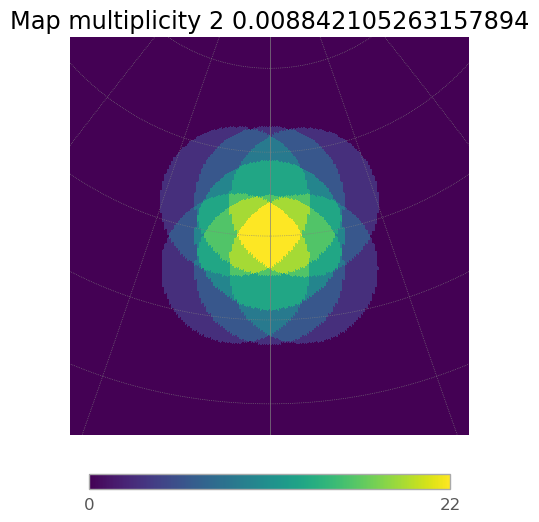

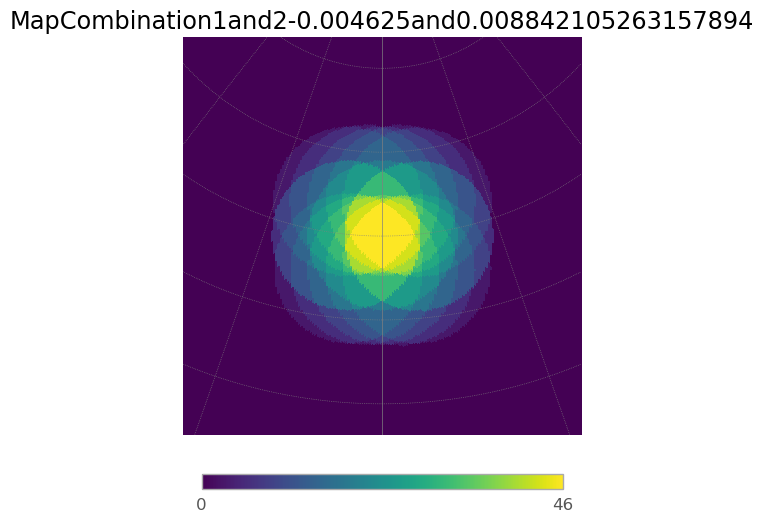

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.97it/s]
7it [00:00,  7.32it/s]
6it [00:00,  6.93it/s]
7it [00:00,  7.16it/s]
6it [00:00,  7.30it/s]
7it [00:00,  7.26it/s]
6it [00:00,  6.96it/s]


11.585350838438595


7it [00:00,  7.28it/s]


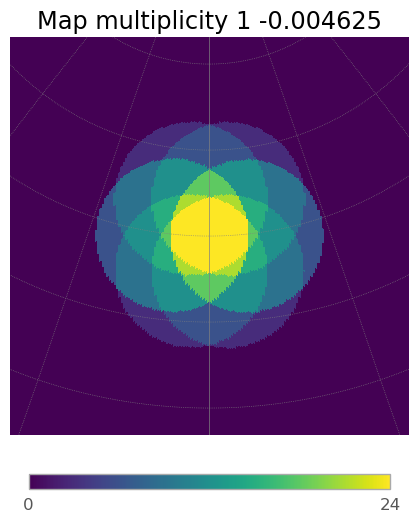

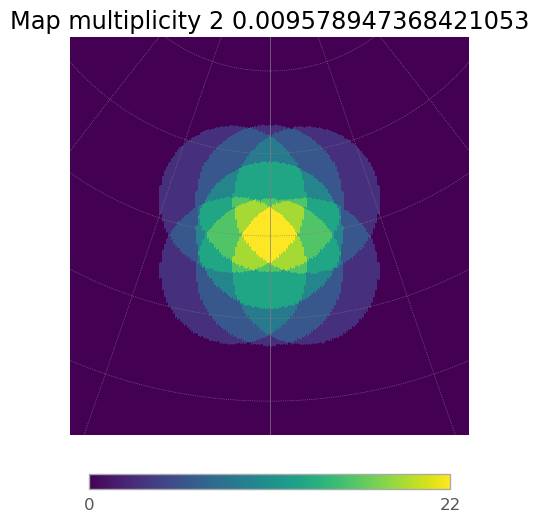

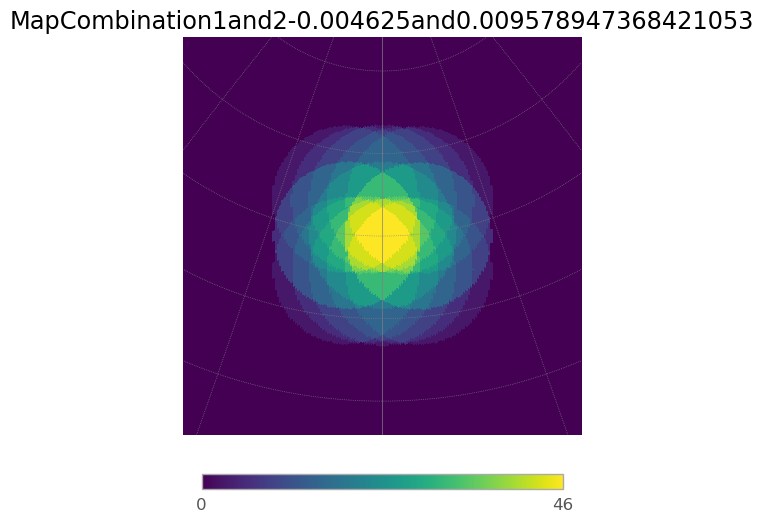

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.98it/s]
7it [00:00,  7.32it/s]
6it [00:00,  7.12it/s]
7it [00:00,  7.24it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.23it/s]
6it [00:00,  6.95it/s]


11.585350838438595


7it [00:00,  7.29it/s]


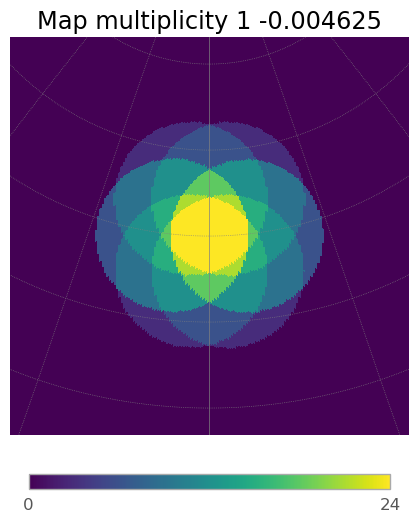

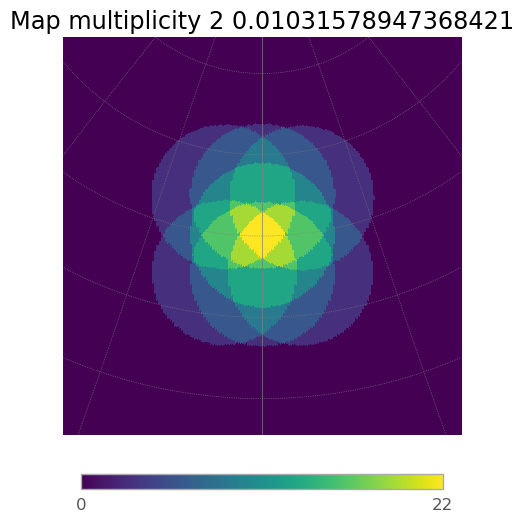

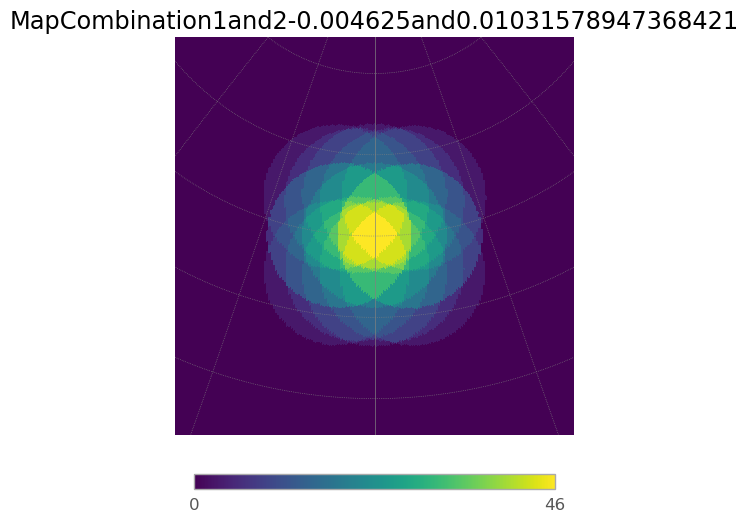

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.10it/s]
7it [00:00,  7.34it/s]
6it [00:00,  7.28it/s]
7it [00:00,  7.39it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.24it/s]
6it [00:00,  7.10it/s]


11.585350838438595


7it [00:00,  7.37it/s]


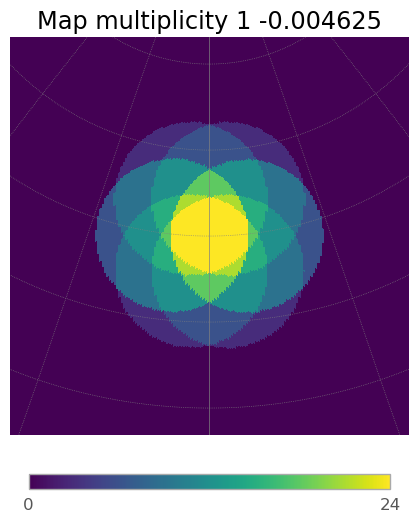

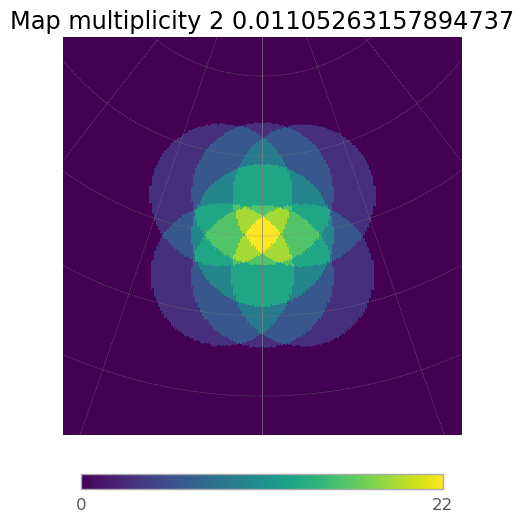

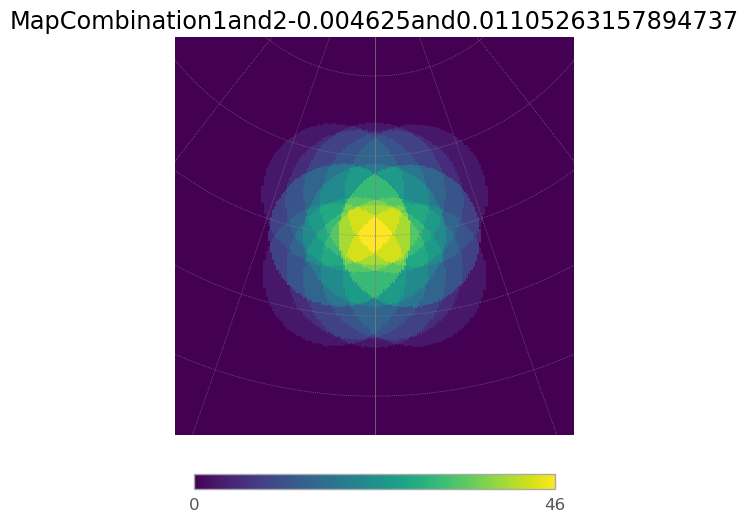

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.03it/s]
7it [00:00,  7.30it/s]
6it [00:00,  6.87it/s]
7it [00:00,  7.16it/s]
6it [00:00,  7.38it/s]
7it [00:00,  7.17it/s]
6it [00:00,  7.05it/s]


11.585350838438595


7it [00:00,  7.14it/s]


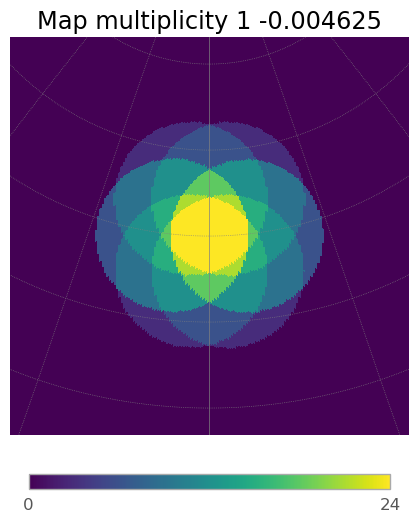

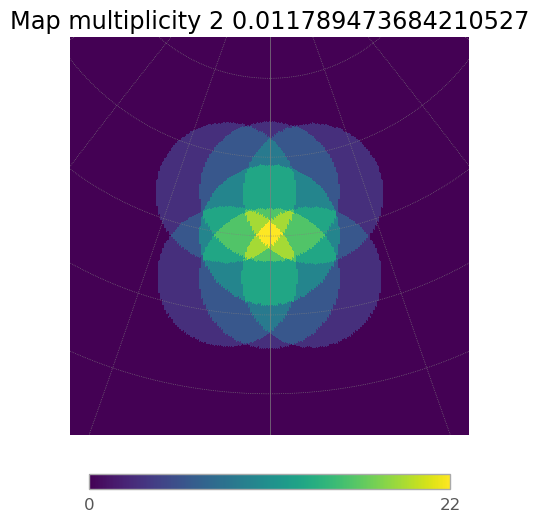

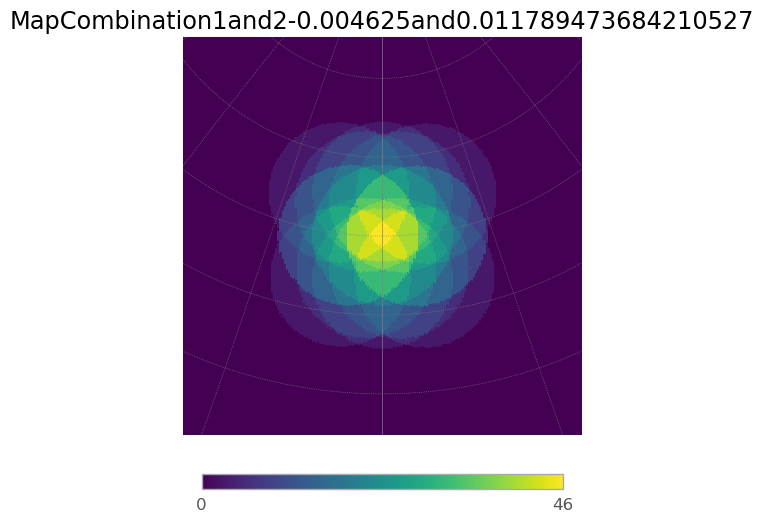

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.15it/s]
7it [00:00,  7.08it/s]
6it [00:00,  7.11it/s]
7it [00:01,  6.20it/s]
6it [00:00,  6.31it/s]
7it [00:01,  6.36it/s]
6it [00:01,  5.94it/s]


11.585350838438595


7it [00:01,  6.18it/s]


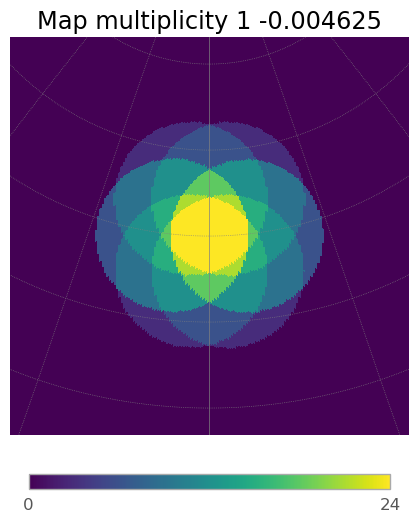

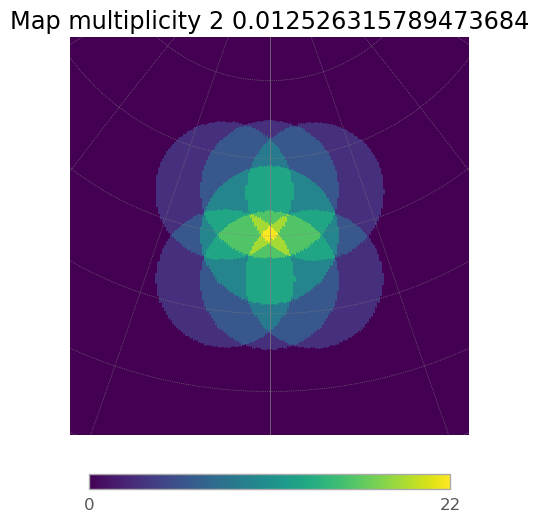

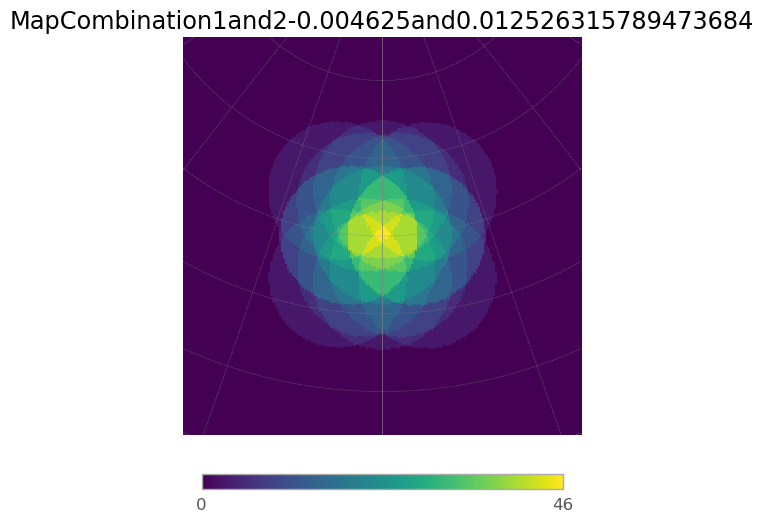

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.18it/s]
7it [00:01,  6.24it/s]
6it [00:00,  6.22it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.74it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.74it/s]


11.585350838438595


7it [00:01,  5.73it/s]


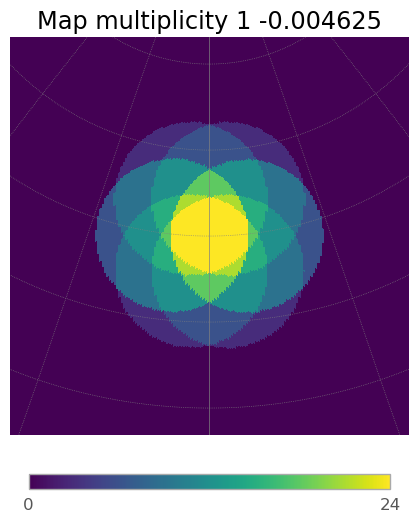

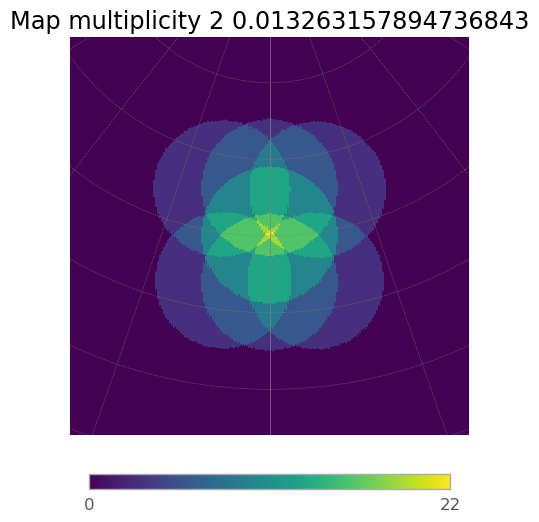

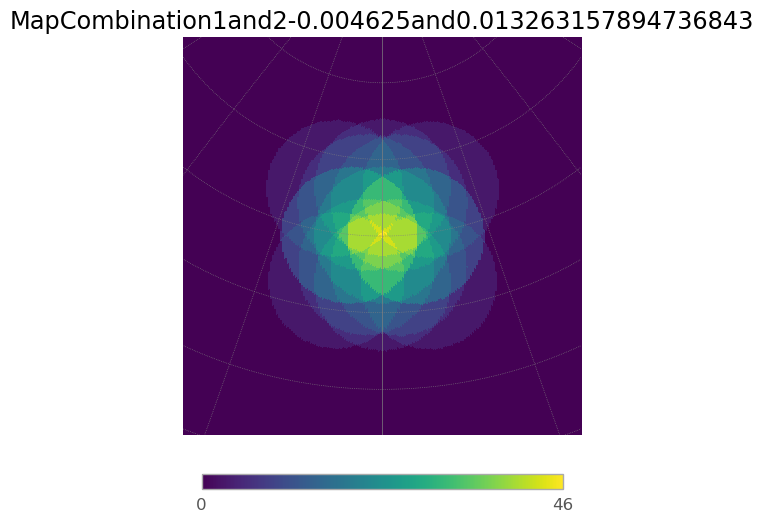

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.77it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.74it/s]
7it [00:01,  5.96it/s]
6it [00:01,  5.13it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.42it/s]


11.585350838438595


7it [00:01,  5.95it/s]


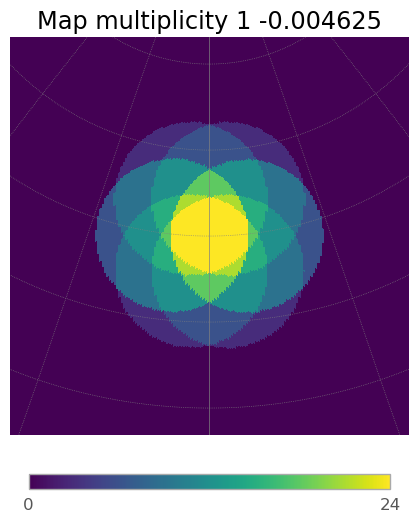

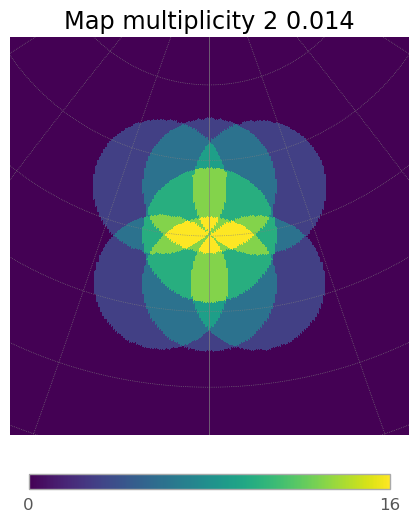

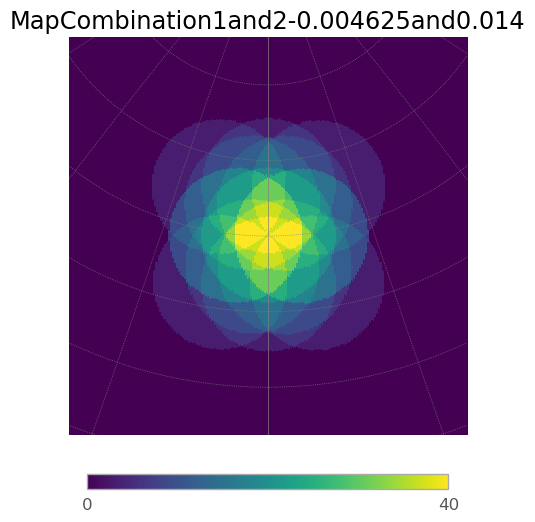

6it [00:00,  6.31it/s]
7it [00:01,  6.50it/s]
6it [00:00,  6.48it/s]
7it [00:01,  6.86it/s]
6it [00:01,  5.96it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.64it/s]


9.450044810959682


7it [00:01,  5.89it/s]


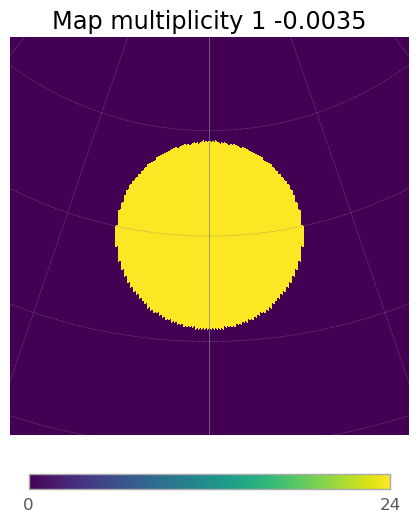

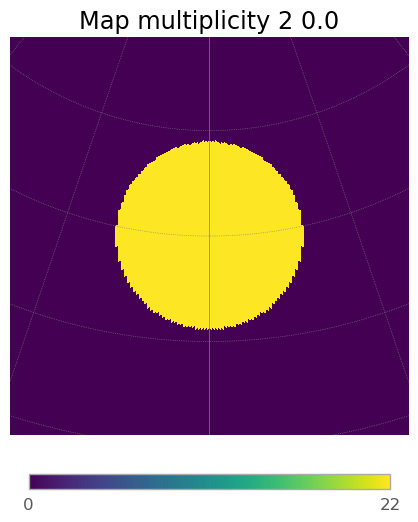

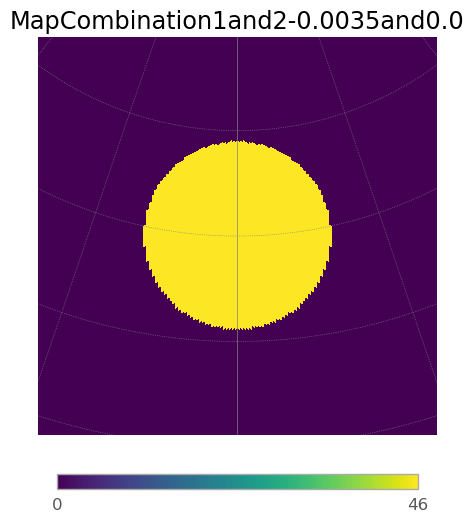

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.55it/s]
7it [00:01,  5.62it/s]
6it [00:01,  5.76it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.85it/s]
7it [00:01,  5.93it/s]
6it [00:01,  5.66it/s]


11.07872850264112


7it [00:01,  5.91it/s]


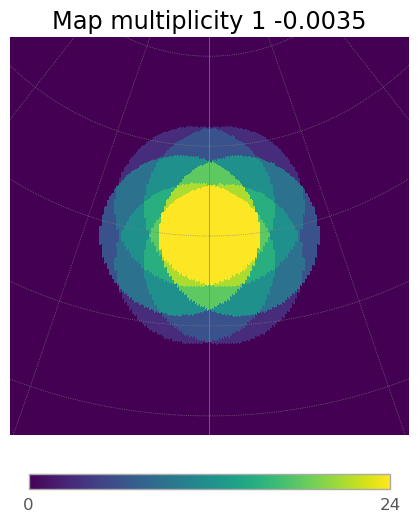

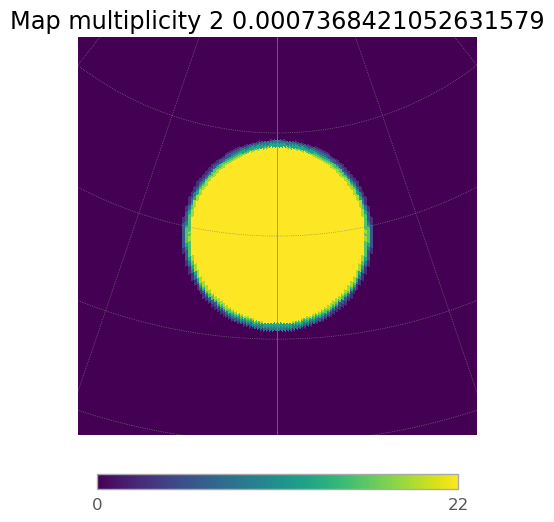

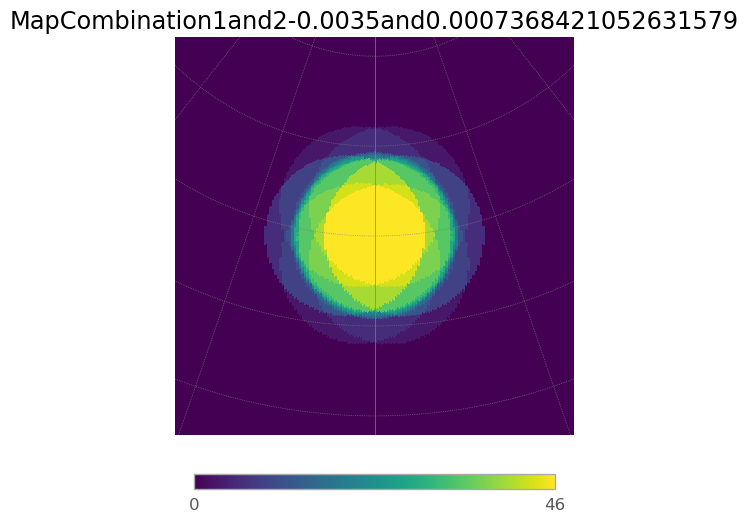

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.78it/s]
7it [00:01,  5.99it/s]
6it [00:01,  5.63it/s]
7it [00:01,  5.77it/s]
6it [00:01,  5.70it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.21it/s]


11.07872850264112


7it [00:01,  5.54it/s]


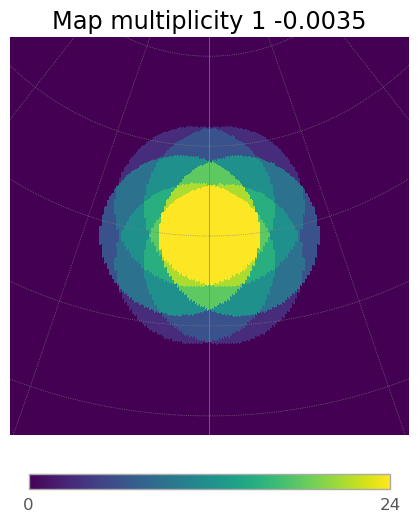

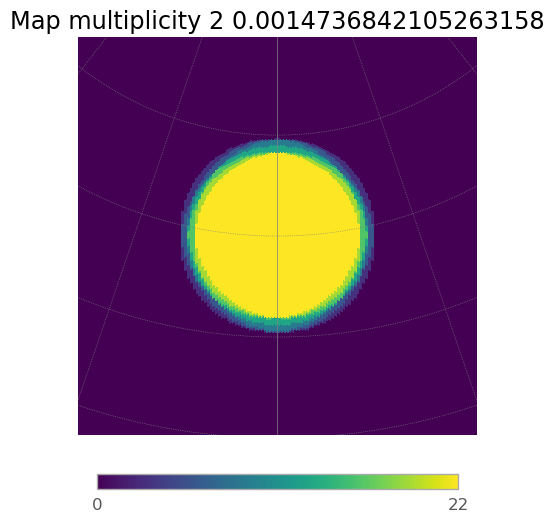

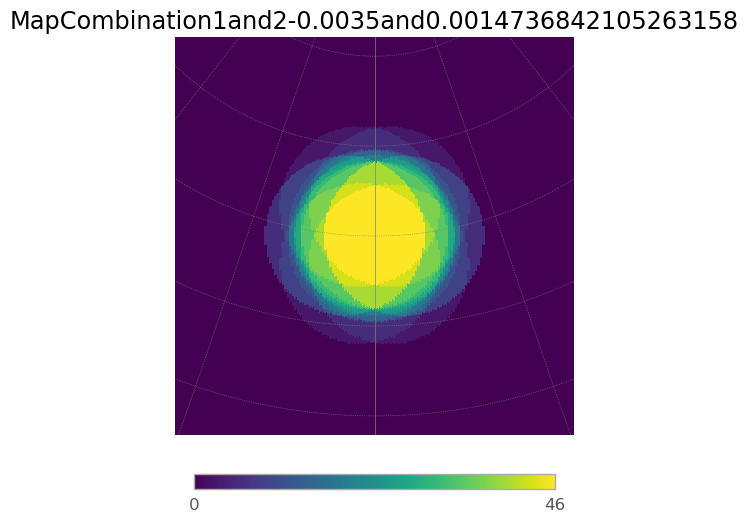

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.42it/s]
7it [00:01,  5.12it/s]
6it [00:01,  5.61it/s]
7it [00:01,  6.10it/s]
6it [00:01,  5.89it/s]
7it [00:01,  5.46it/s]
6it [00:01,  5.16it/s]


11.07872850264112


7it [00:01,  5.36it/s]


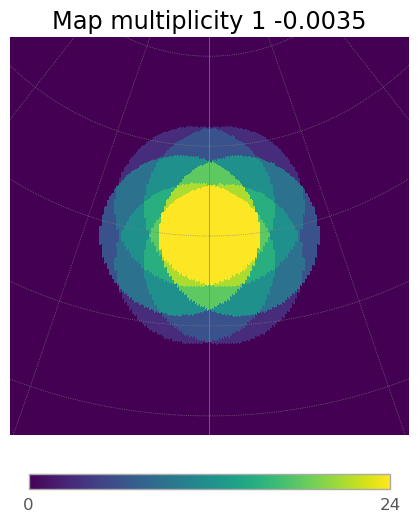

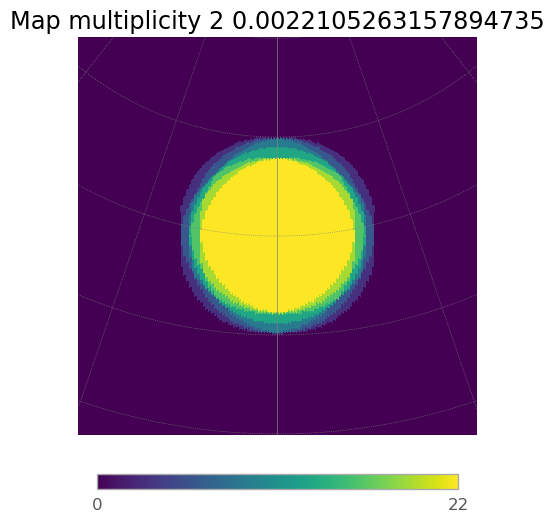

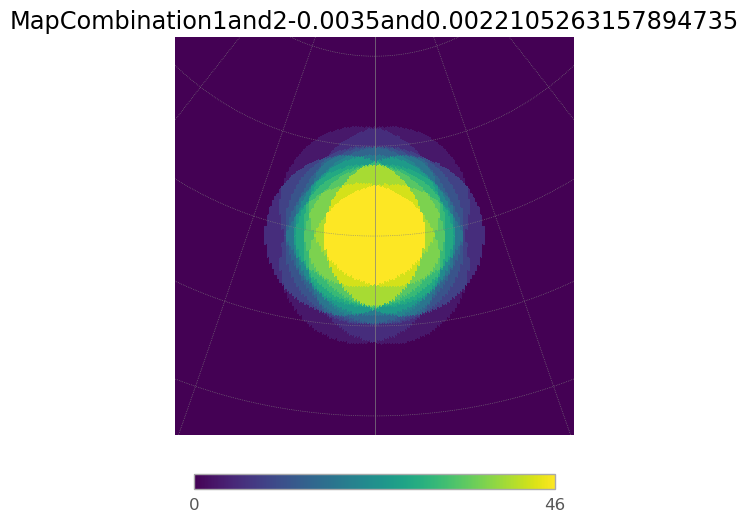

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.40it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.71it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.27it/s]


11.07872850264112


7it [00:01,  5.80it/s]


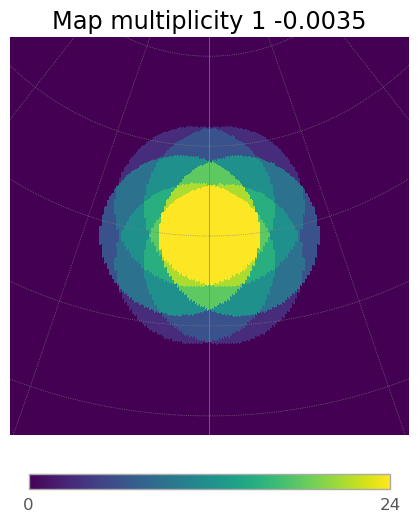

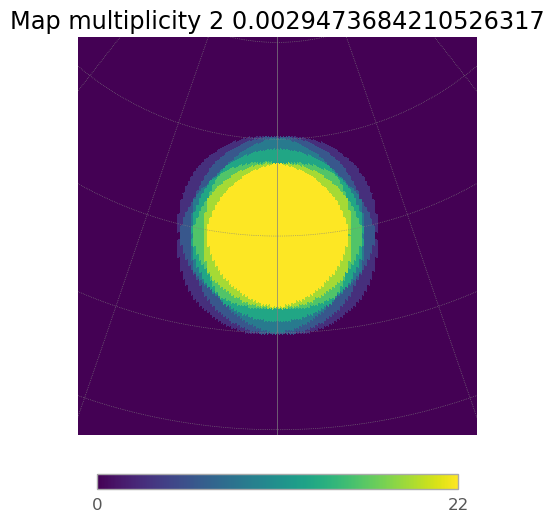

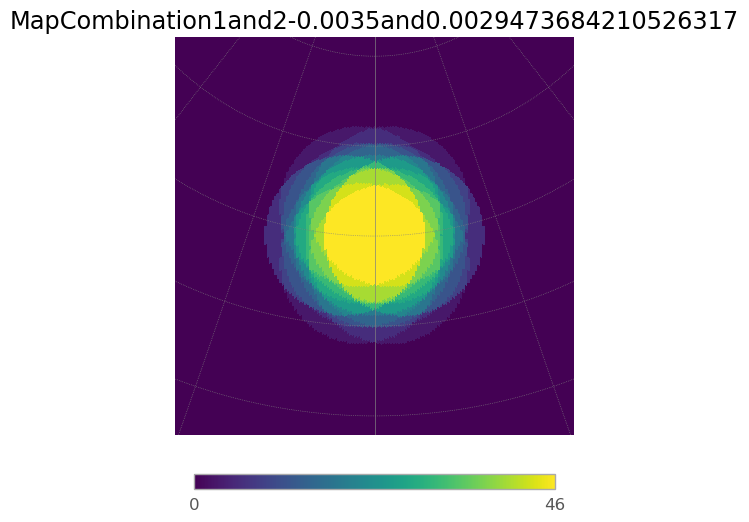

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.38it/s]
7it [00:01,  5.63it/s]
6it [00:01,  5.72it/s]
7it [00:01,  5.58it/s]
6it [00:00,  6.01it/s]
7it [00:01,  5.97it/s]
6it [00:01,  5.35it/s]


11.07872850264112


7it [00:01,  5.89it/s]


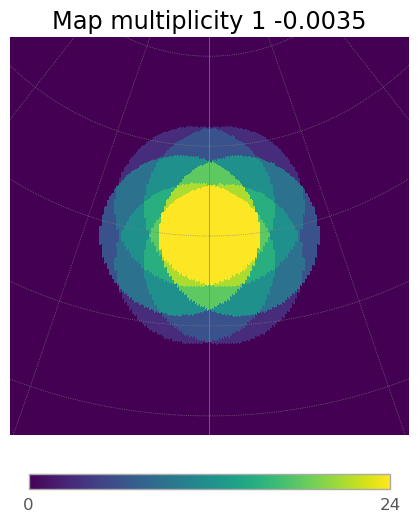

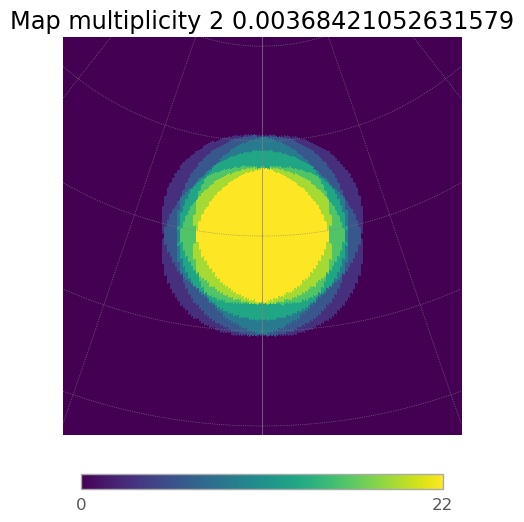

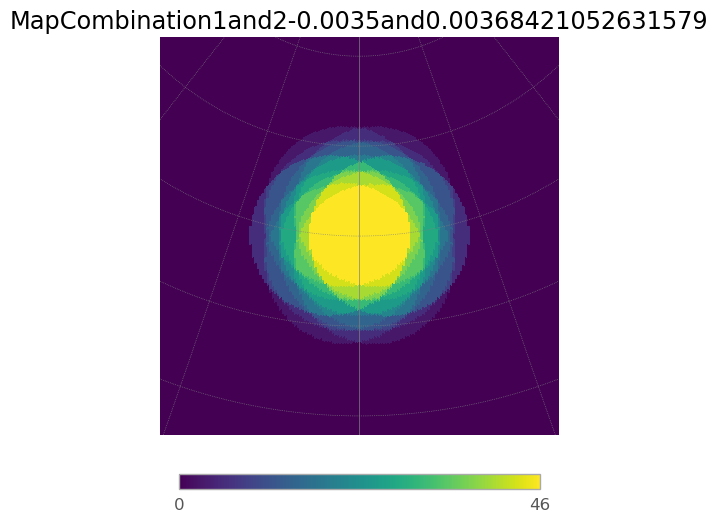

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.32it/s]
7it [00:01,  5.86it/s]
6it [00:01,  5.61it/s]
7it [00:01,  5.86it/s]
6it [00:01,  5.75it/s]
7it [00:01,  5.95it/s]
6it [00:01,  5.20it/s]


11.07872850264112


7it [00:01,  5.60it/s]


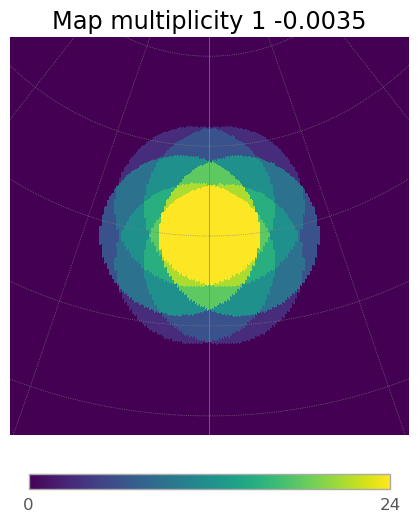

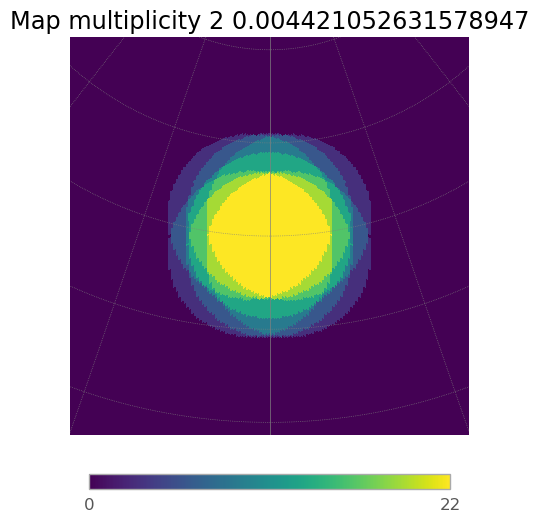

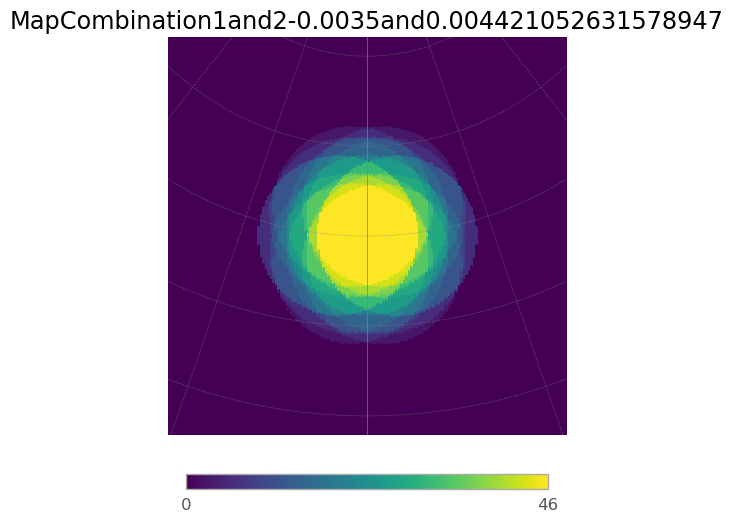

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.64it/s]
7it [00:01,  5.72it/s]
6it [00:01,  5.81it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.94it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.69it/s]


11.07872850264112


7it [00:01,  5.74it/s]


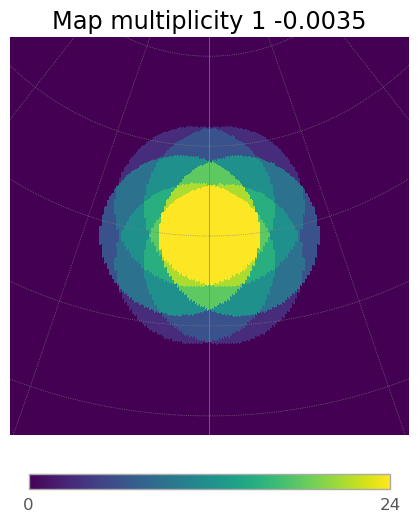

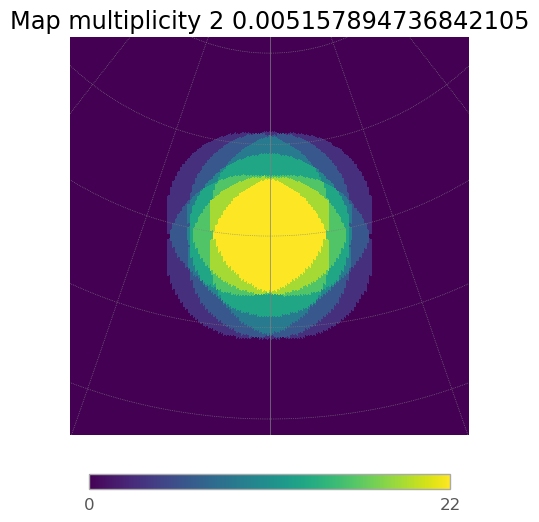

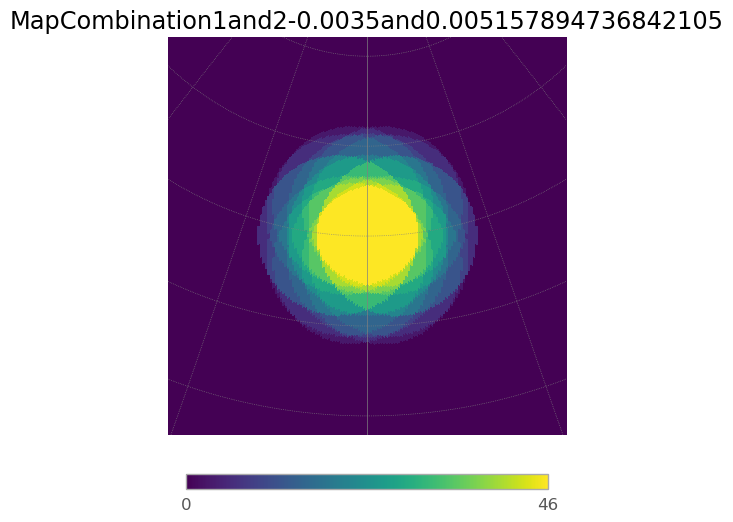

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.62it/s]
7it [00:01,  5.80it/s]
6it [00:01,  5.43it/s]
7it [00:01,  5.62it/s]
6it [00:01,  5.56it/s]
7it [00:01,  5.37it/s]
6it [00:01,  4.97it/s]


11.07872850264112


7it [00:01,  5.91it/s]


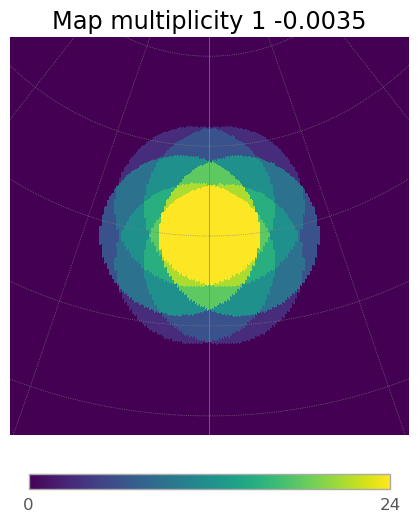

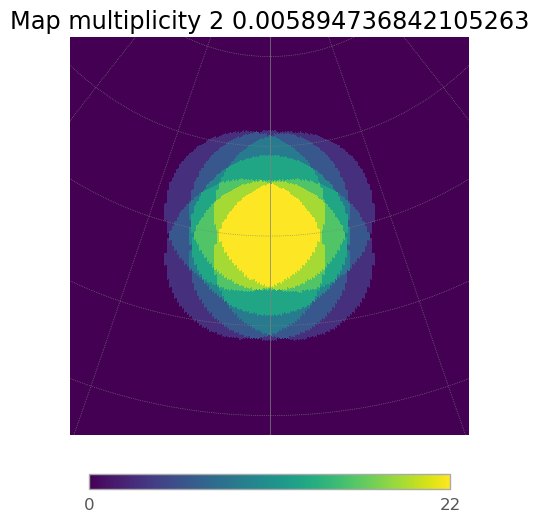

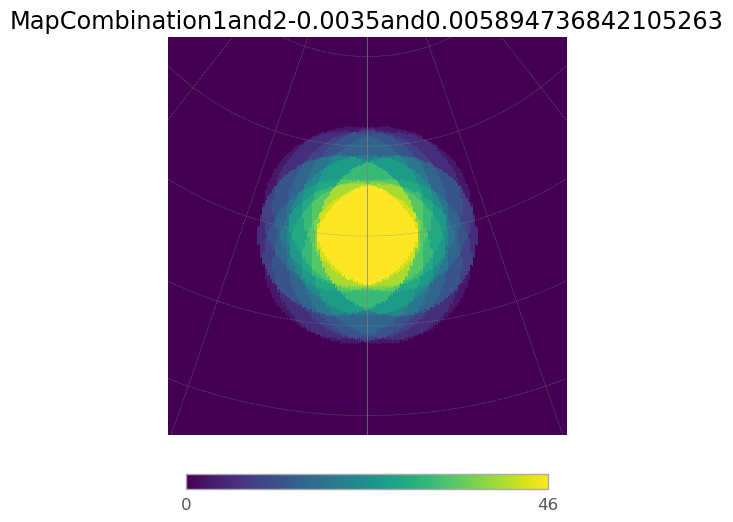

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.66it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.47it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.89it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.51it/s]


11.07872850264112


7it [00:01,  5.24it/s]


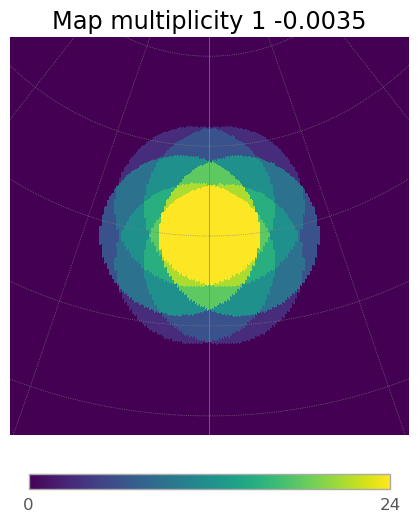

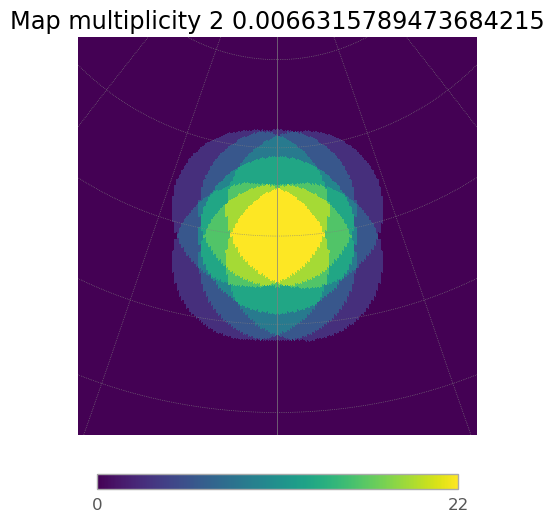

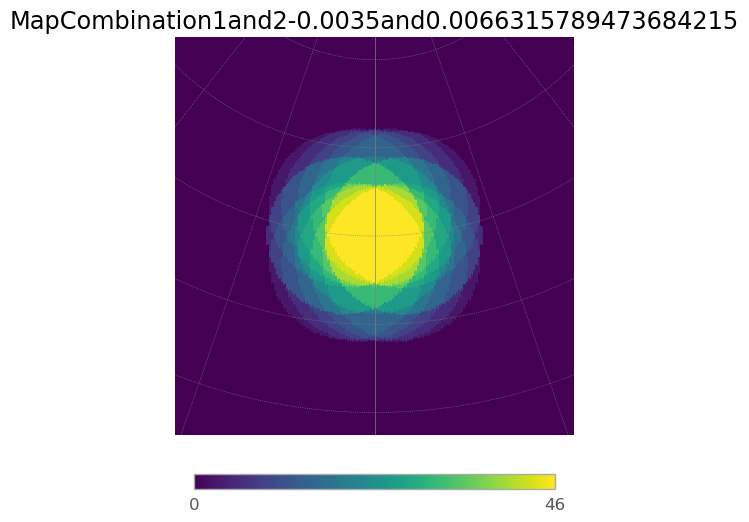

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.65it/s]
7it [00:01,  5.73it/s]
6it [00:01,  5.68it/s]
7it [00:01,  5.97it/s]
6it [00:01,  5.76it/s]
7it [00:01,  5.73it/s]
6it [00:01,  5.49it/s]


11.07872850264112


7it [00:01,  5.64it/s]


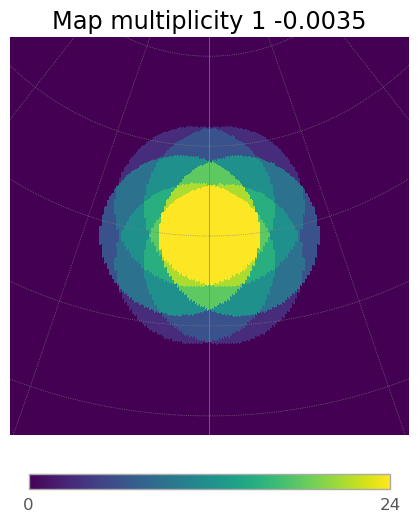

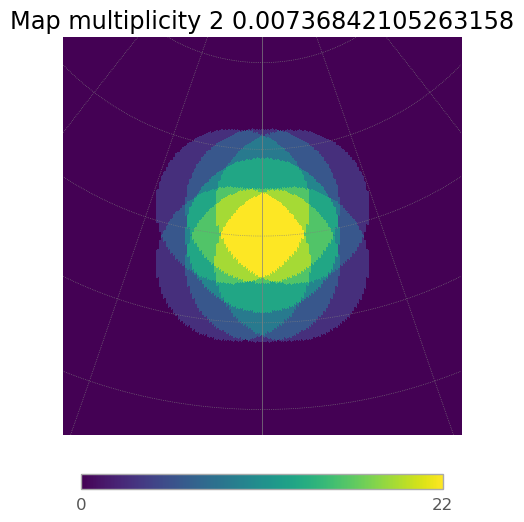

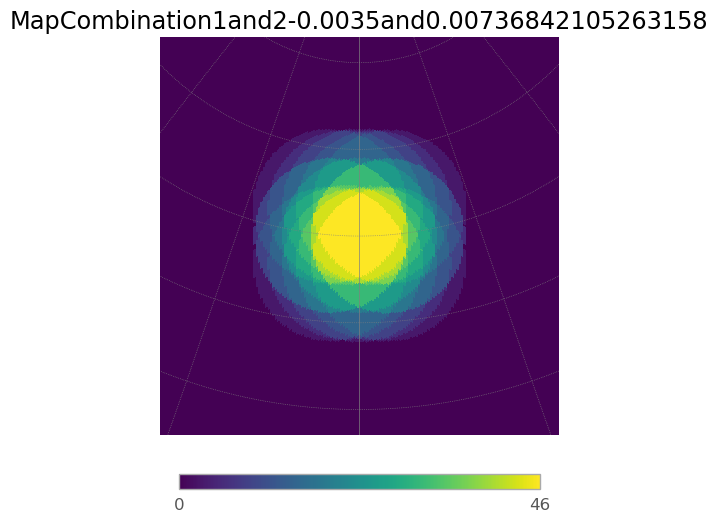

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.59it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.60it/s]
7it [00:01,  5.44it/s]
6it [00:01,  5.74it/s]
7it [00:01,  5.78it/s]
6it [00:01,  5.69it/s]


11.07872850264112


7it [00:01,  5.96it/s]


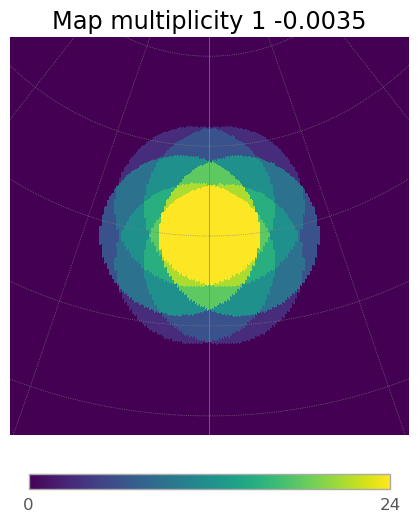

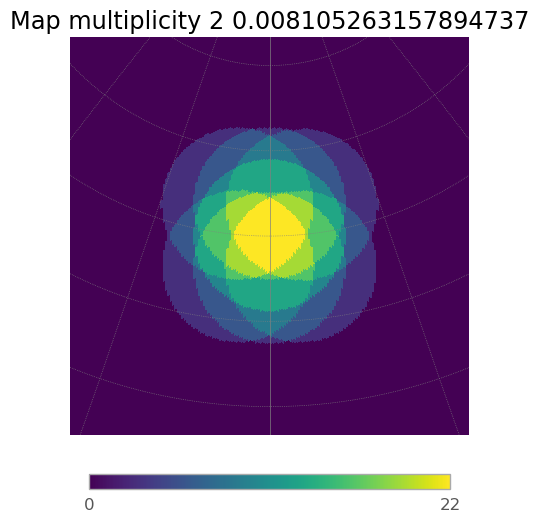

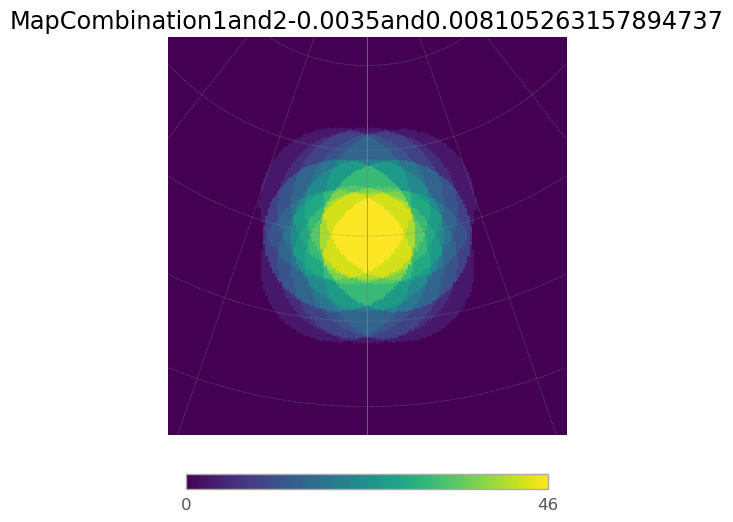

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.57it/s]
7it [00:01,  5.76it/s]
6it [00:01,  5.67it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.81it/s]
7it [00:01,  6.06it/s]
6it [00:01,  5.66it/s]


11.07872850264112


7it [00:01,  5.36it/s]


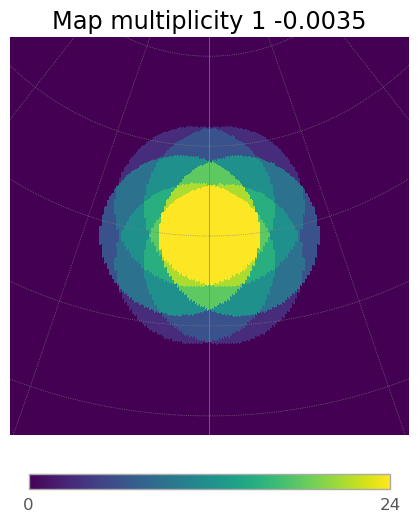

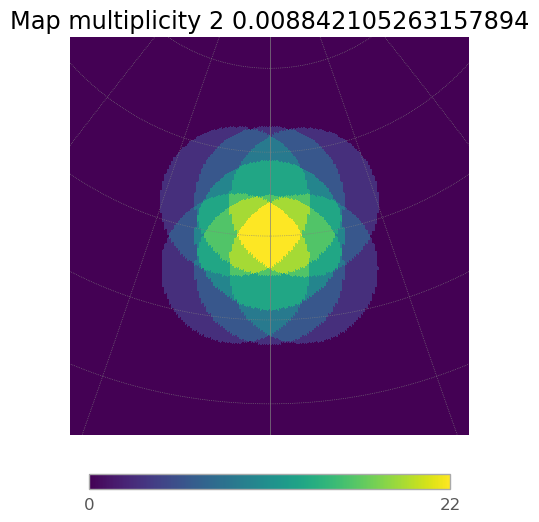

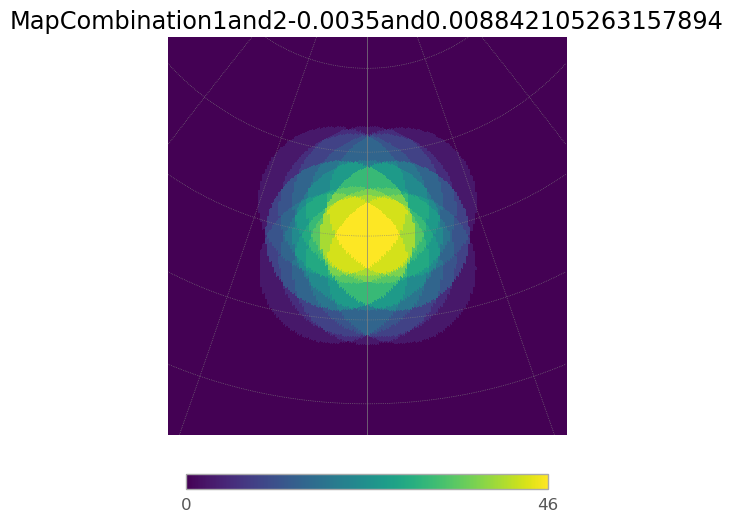

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.11it/s]
7it [00:01,  5.42it/s]
6it [00:01,  5.17it/s]
7it [00:01,  4.74it/s]
6it [00:01,  3.99it/s]
7it [00:01,  4.68it/s]
6it [00:01,  4.10it/s]


11.07872850264112


7it [00:01,  5.69it/s]


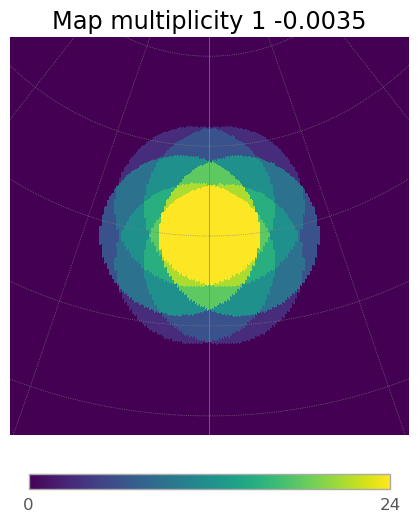

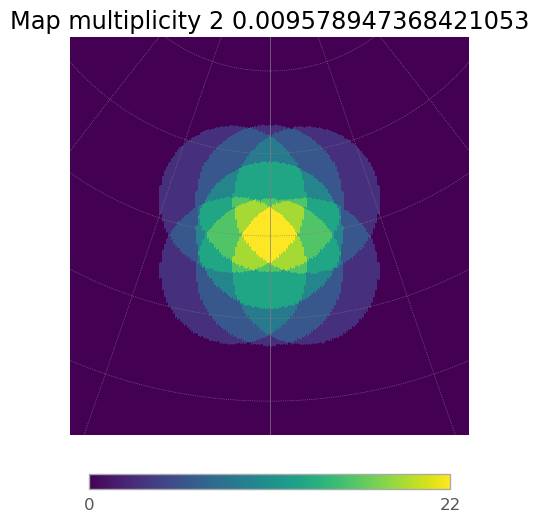

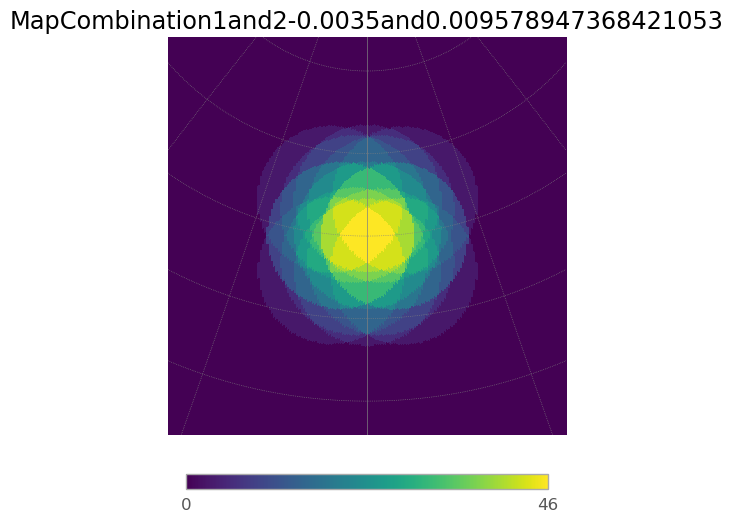

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.68it/s]
7it [00:01,  5.91it/s]
6it [00:00,  6.44it/s]
7it [00:01,  6.49it/s]
6it [00:00,  6.77it/s]
7it [00:01,  6.55it/s]
6it [00:00,  6.66it/s]


11.07872850264112


7it [00:01,  6.83it/s]


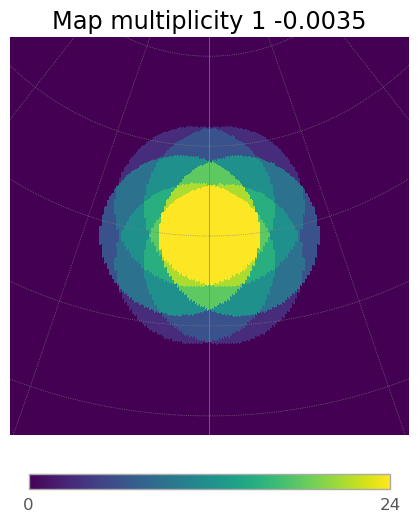

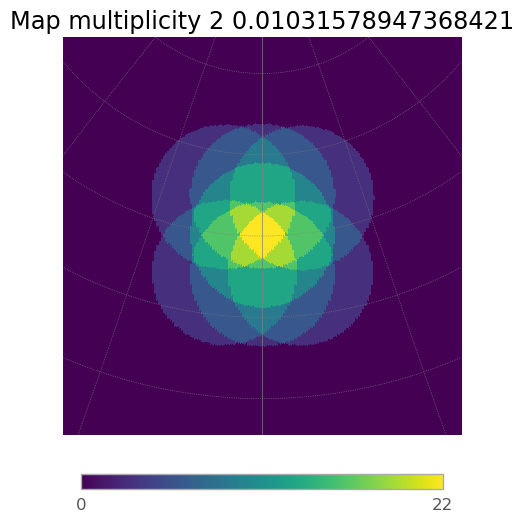

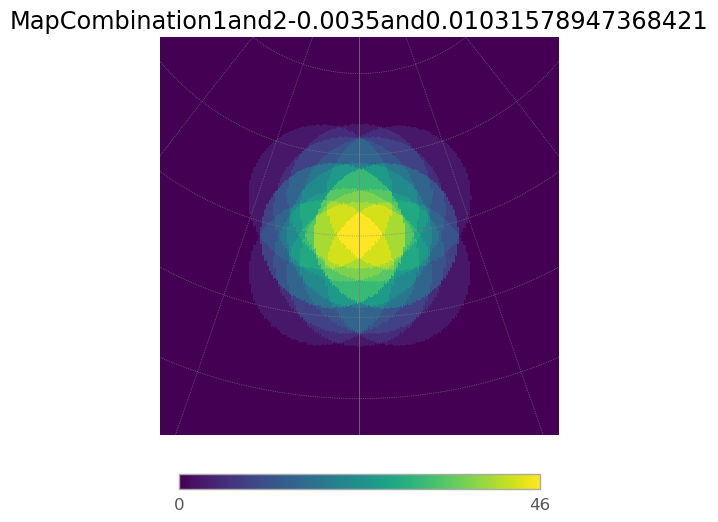

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.74it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.79it/s]
7it [00:01,  6.99it/s]
6it [00:00,  6.86it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.70it/s]


11.07872850264112


7it [00:00,  7.05it/s]


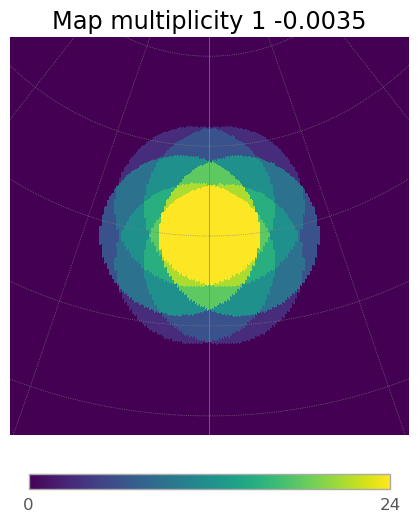

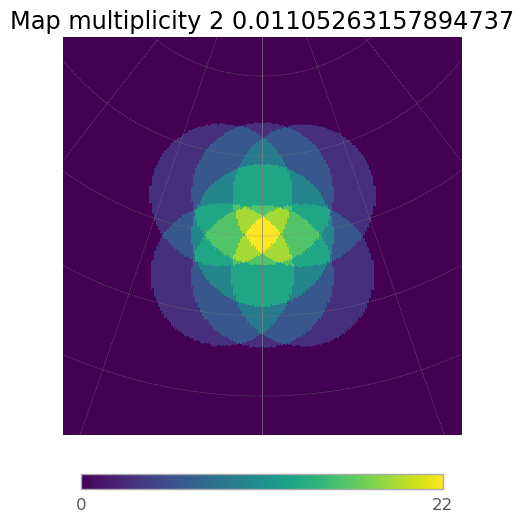

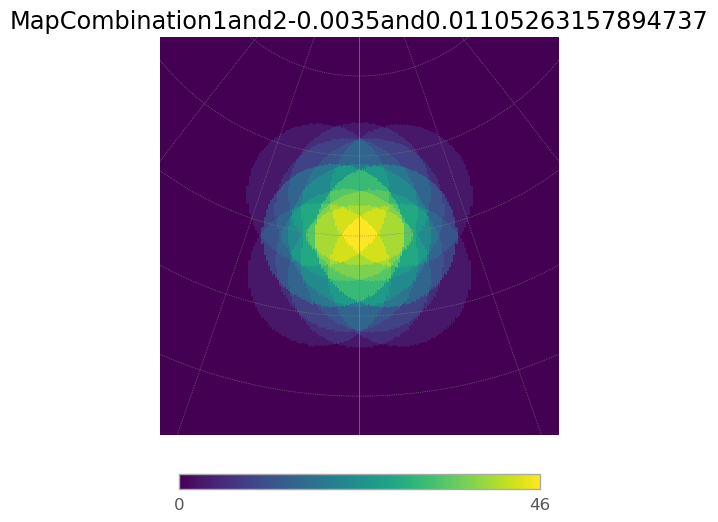

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.70it/s]
7it [00:01,  6.86it/s]
6it [00:00,  6.85it/s]
7it [00:01,  6.72it/s]
6it [00:00,  6.85it/s]
7it [00:01,  6.57it/s]
6it [00:00,  6.67it/s]


11.07872850264112


7it [00:01,  6.76it/s]


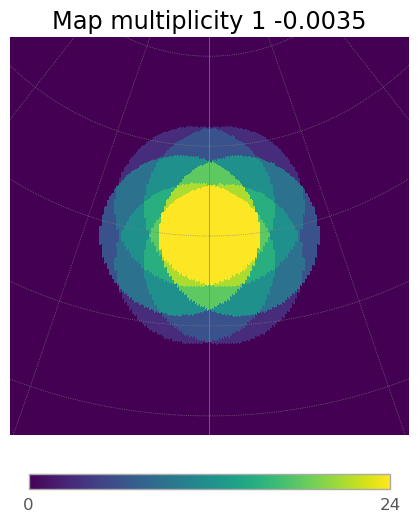

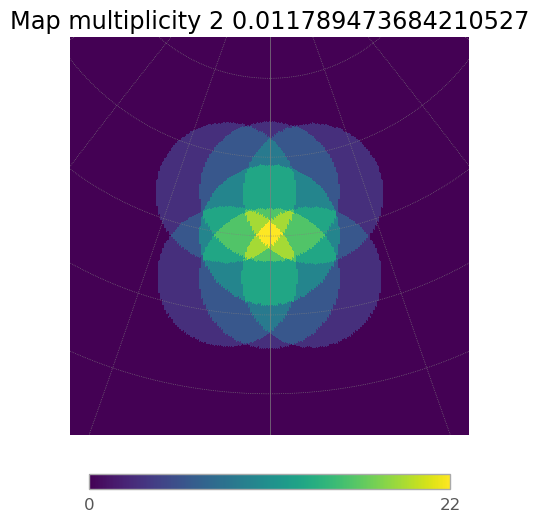

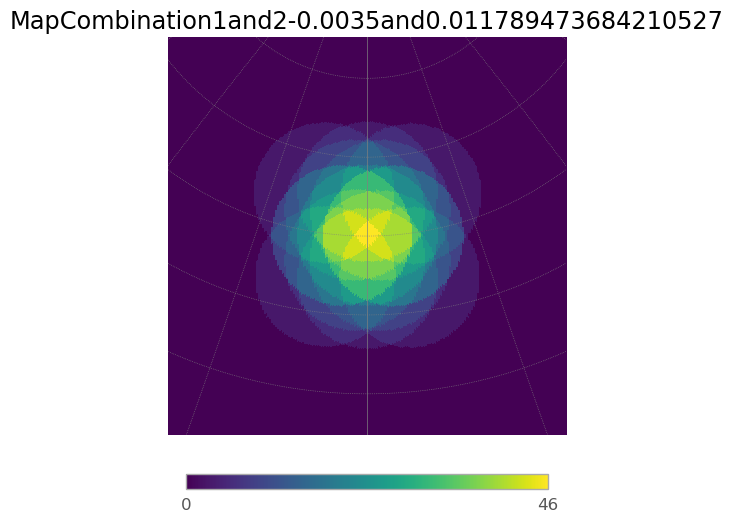

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.78it/s]
7it [00:01,  6.42it/s]
6it [00:00,  6.80it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.83it/s]
7it [00:01,  6.73it/s]
6it [00:00,  6.55it/s]


11.07872850264112


7it [00:01,  6.88it/s]


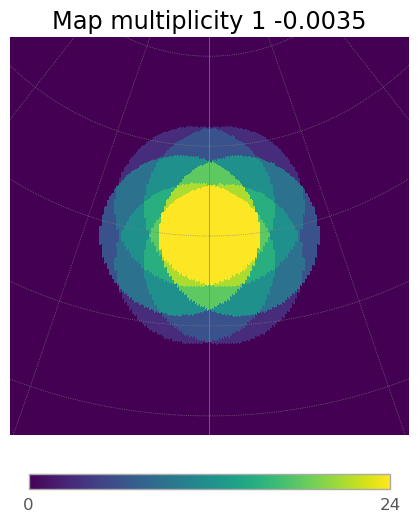

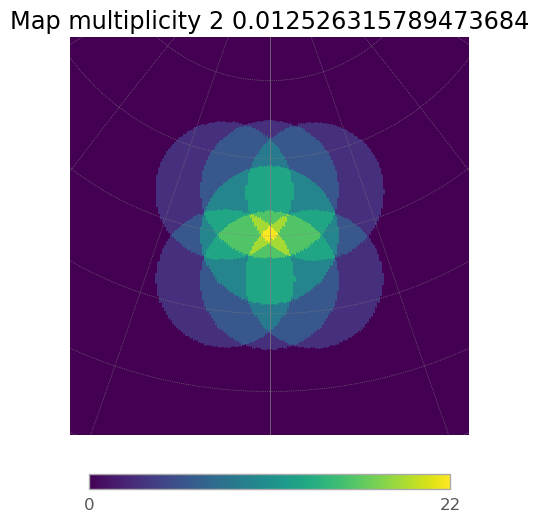

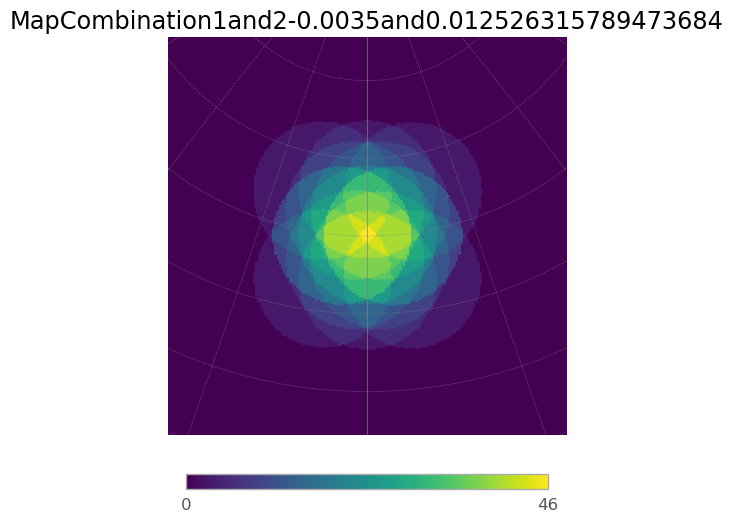

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.92it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.83it/s]
7it [00:01,  6.98it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.05it/s]
6it [00:00,  6.69it/s]


11.07872850264112


7it [00:00,  7.03it/s]


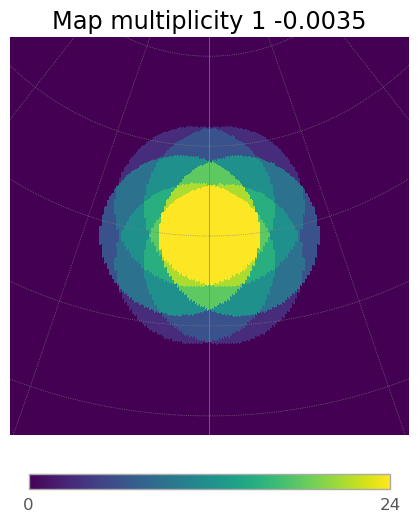

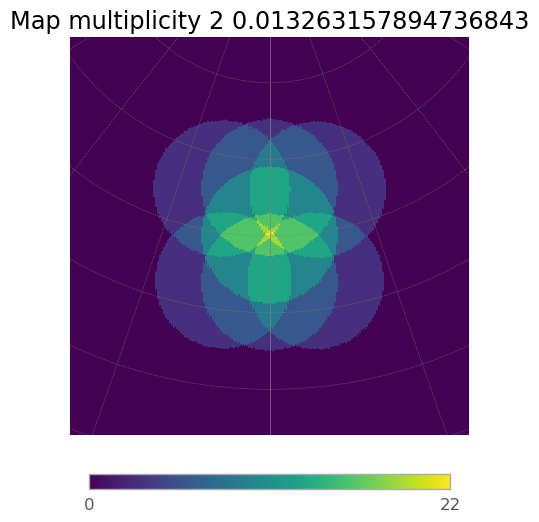

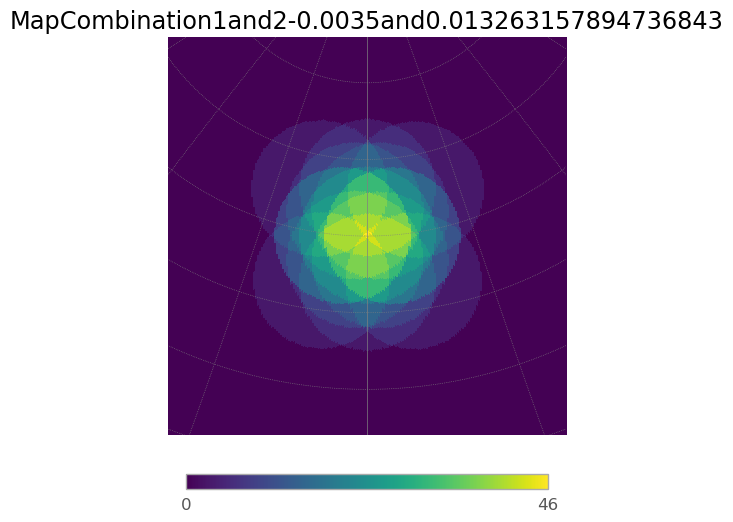

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.81it/s]
7it [00:01,  6.90it/s]
6it [00:00,  6.61it/s]
7it [00:01,  6.89it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.02it/s]
6it [00:00,  6.93it/s]


11.07872850264112


7it [00:01,  6.93it/s]


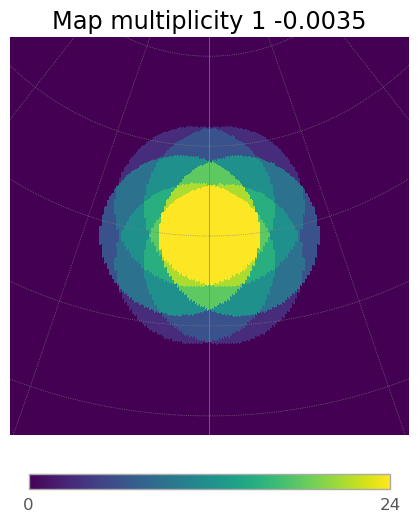

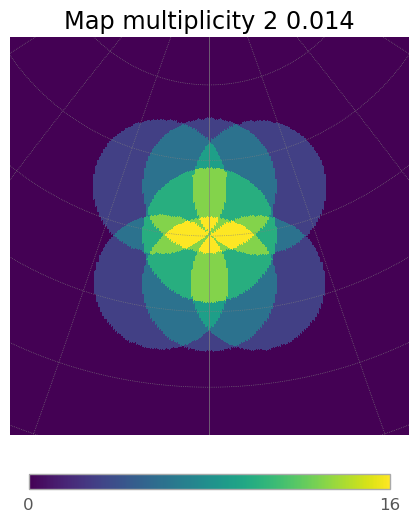

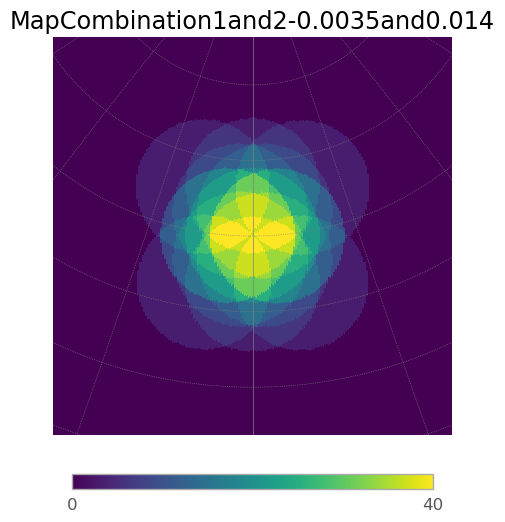

In [55]:
#sstart with -0.009 until -0.006 with 30 steps so we do a new linspace
#see what div but aswell arrive to 0.0143 but as well 30 of them
#It would be a good idea to change the name of 
div=np.linspace(0,0.014, 20) #Diverges 
div_2=np.linspace(-0.0080,-0.0035,5) #Converges
FoV_array=[]
sum_div=[]
multiplicity_array=[]
for divergence_2 in div_2:# This is the one of convergence
    for divergence in div:  #This is the one that diverges        
        array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=divergence_2, div2=divergence, az=0, alt=70)
        FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
        multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
        if FoV > 63:
            FoV_array.append(FoV)
            multiplicity_array.append(multiplicity)
        array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)
           
        #sum_div.append(_sum) THIS WAS AN IDEA TO PUT BOTH DIVERGENCES TOGETHER BUT MEH
        
   

In [57]:
best_one_div=0.007
best_one_conv=-0.0575
second_best_div=0.0105
second_best_conv=-0.06875
not_enough_conv=-0.008
not_enough_div=0.0035
too_conv=-0.008
too_div=0.0035

6it [00:00,  7.06it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.87it/s]
7it [00:00,  7.21it/s]
6it [00:00,  7.27it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.72it/s]


9.450044810959682


7it [00:01,  6.74it/s]


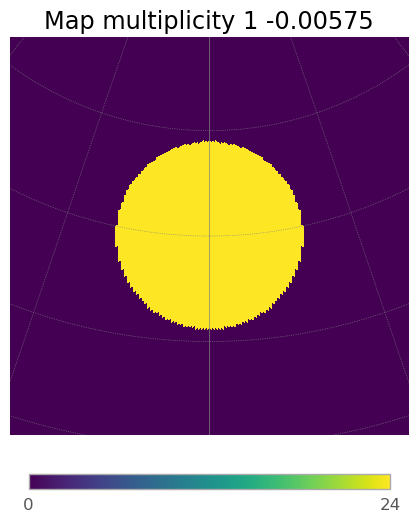

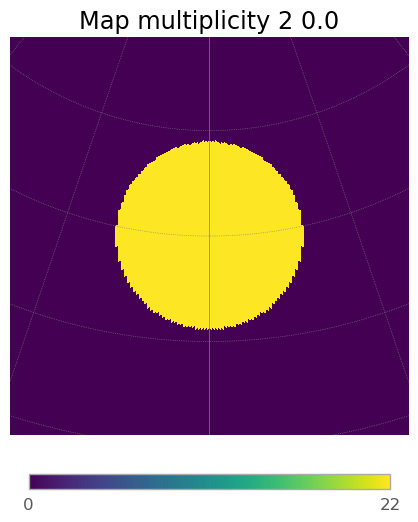

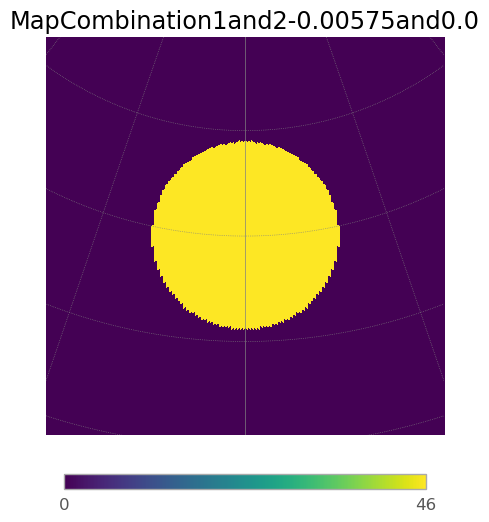

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.97it/s]
7it [00:00,  7.08it/s]
6it [00:00,  6.86it/s]
7it [00:00,  7.05it/s]
6it [00:00,  7.16it/s]
7it [00:00,  7.25it/s]
6it [00:00,  6.92it/s]


12.084619462407312


7it [00:00,  7.20it/s]


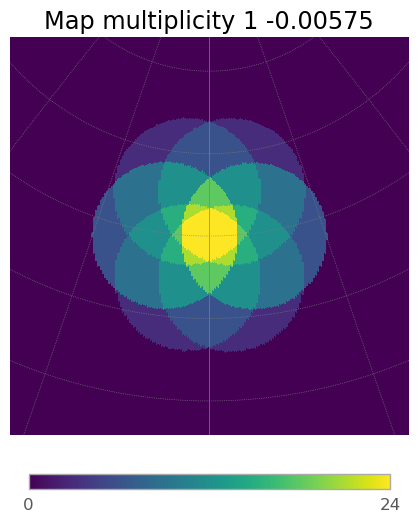

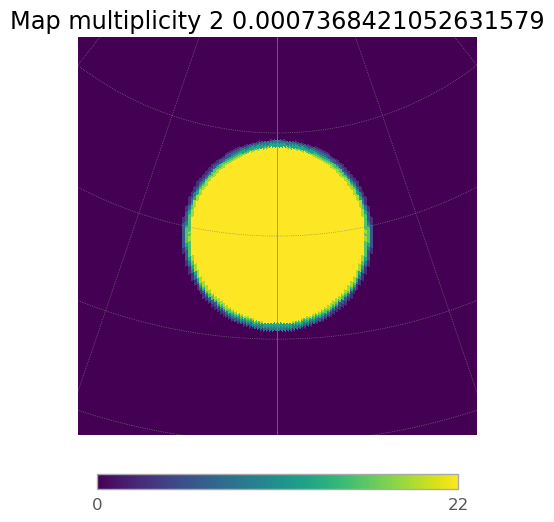

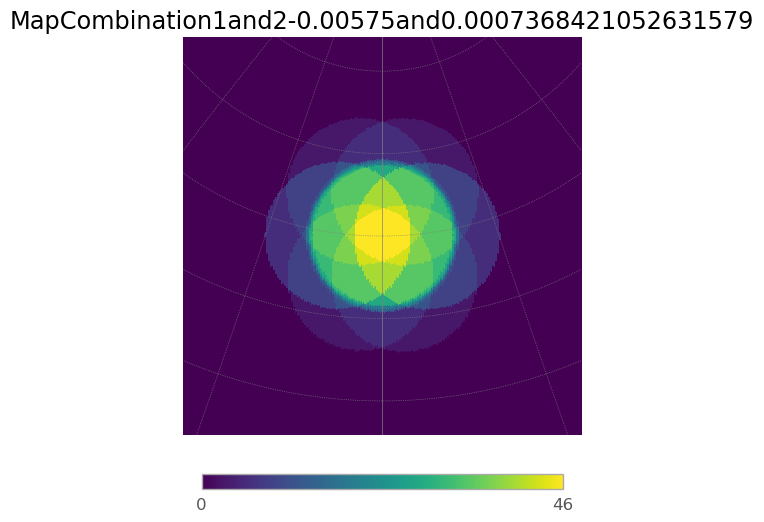

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.99it/s]
7it [00:00,  7.09it/s]
6it [00:00,  6.63it/s]
7it [00:00,  7.09it/s]
6it [00:00,  6.71it/s]
7it [00:01,  6.56it/s]
6it [00:00,  6.77it/s]


12.084619462407312


7it [00:00,  7.09it/s]


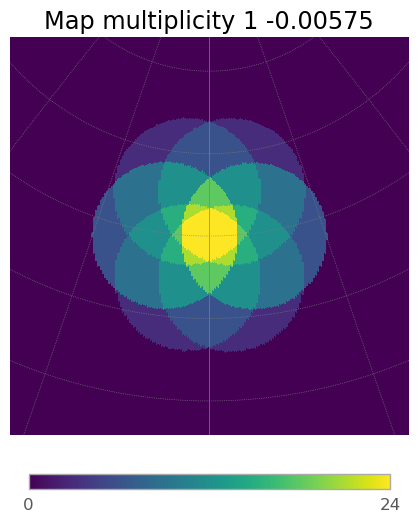

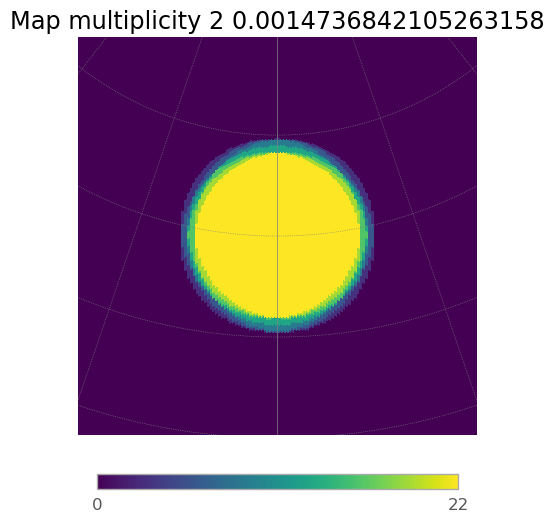

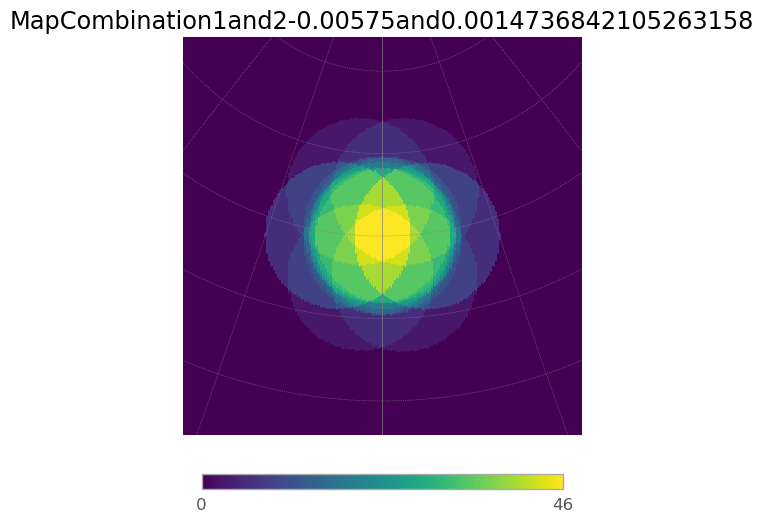

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.87it/s]
7it [00:00,  7.14it/s]
6it [00:00,  7.04it/s]
7it [00:00,  7.25it/s]
6it [00:00,  7.26it/s]
7it [00:00,  7.18it/s]
6it [00:00,  6.95it/s]


12.084619462407312


7it [00:00,  7.28it/s]


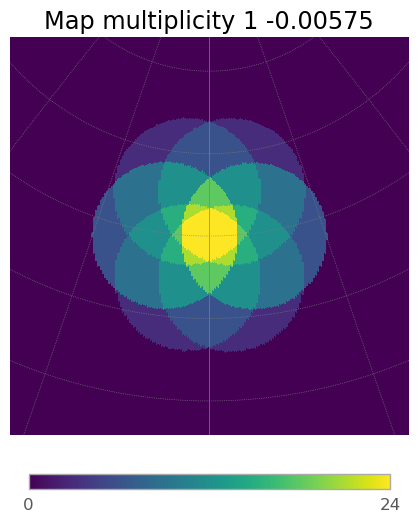

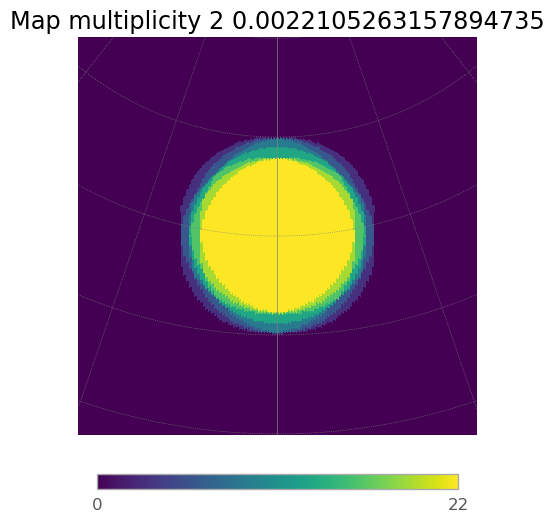

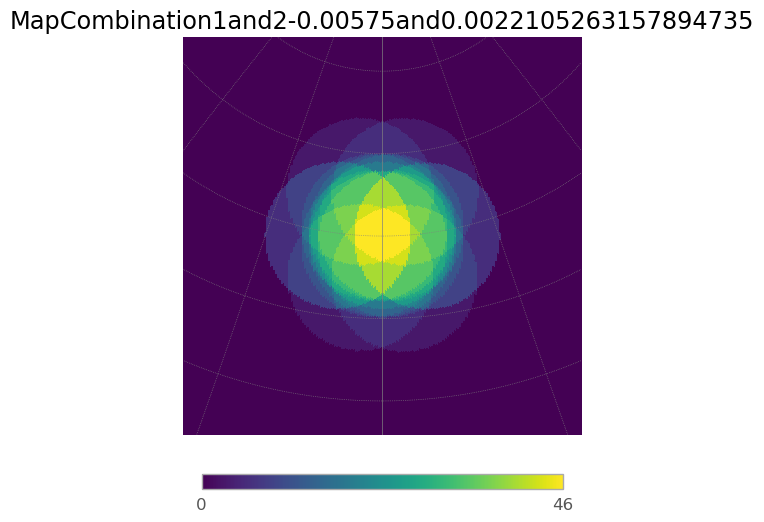

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.87it/s]
7it [00:00,  7.13it/s]
6it [00:00,  6.64it/s]
7it [00:00,  7.01it/s]
6it [00:00,  7.06it/s]
7it [00:00,  7.23it/s]
6it [00:00,  6.89it/s]


12.084619462407312


7it [00:00,  7.20it/s]


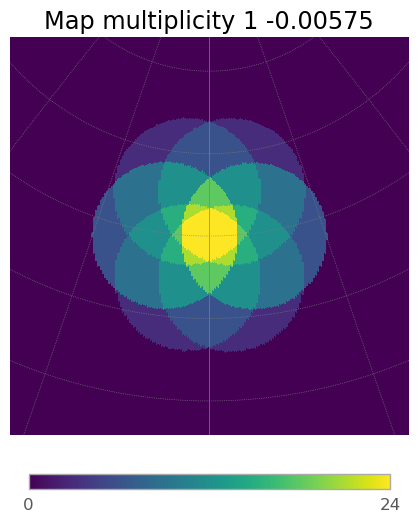

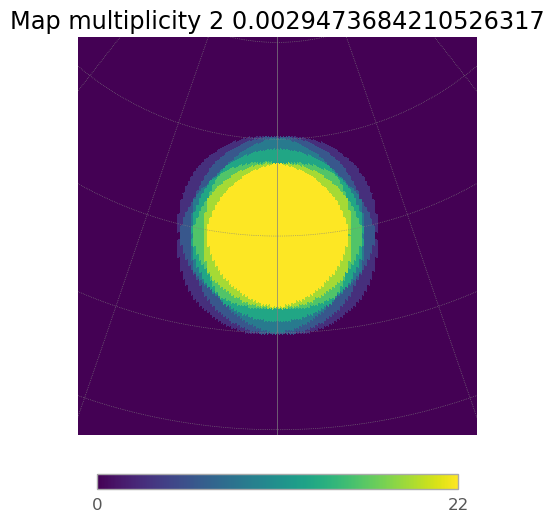

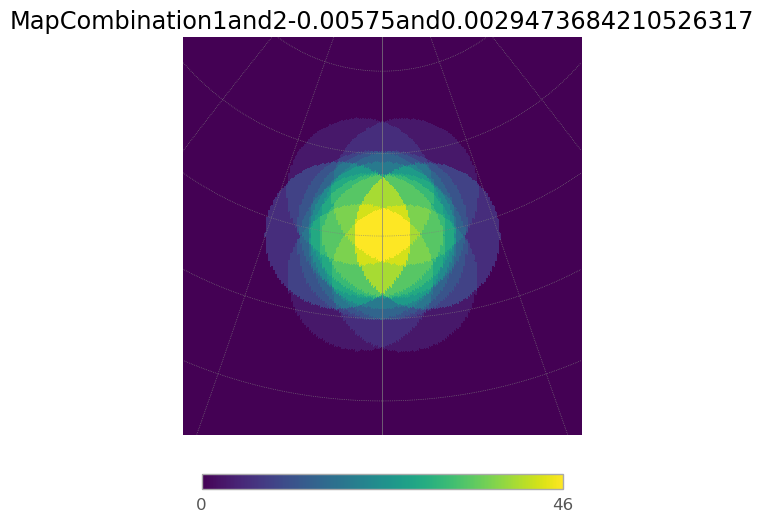

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.09it/s]
7it [00:00,  7.04it/s]
6it [00:00,  6.93it/s]
7it [00:01,  6.95it/s]
6it [00:00,  7.08it/s]
7it [00:01,  6.90it/s]
6it [00:00,  6.78it/s]


12.084619462407312


7it [00:01,  6.78it/s]


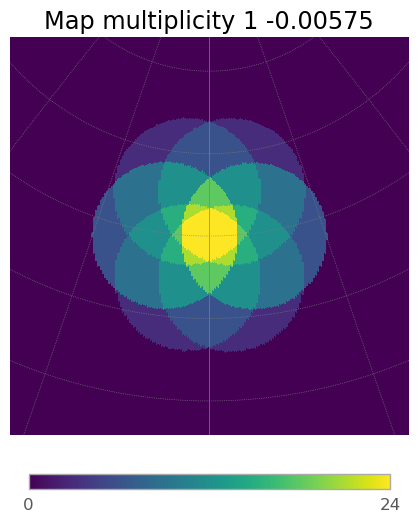

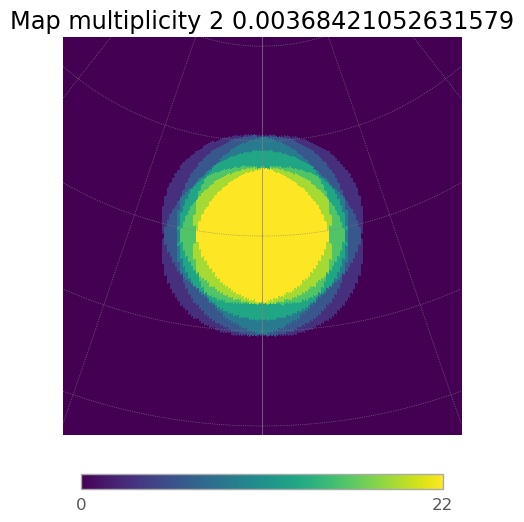

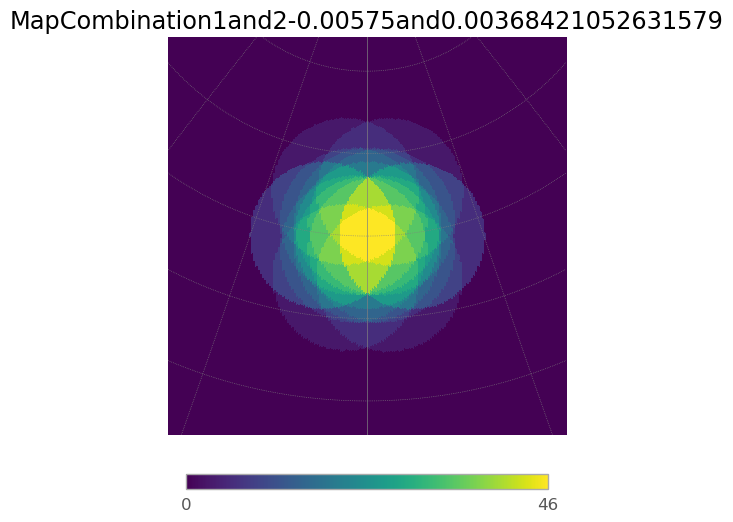

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.03it/s]
7it [00:00,  7.21it/s]
6it [00:00,  7.01it/s]
7it [00:00,  7.14it/s]
6it [00:00,  7.17it/s]
7it [00:00,  7.16it/s]
6it [00:00,  6.84it/s]


12.084619462407312


7it [00:00,  7.13it/s]


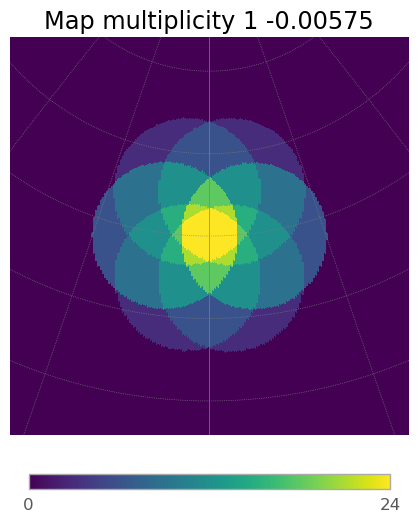

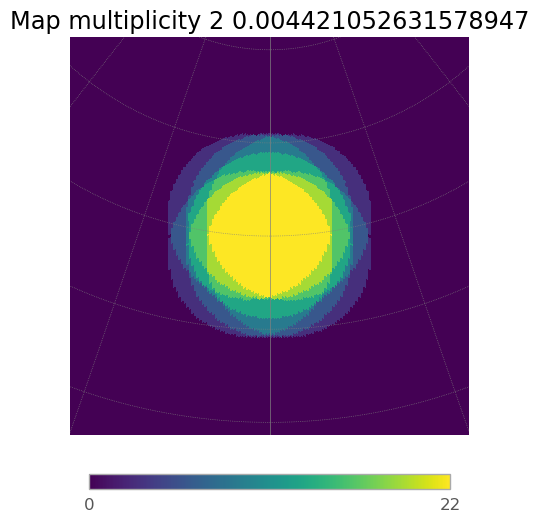

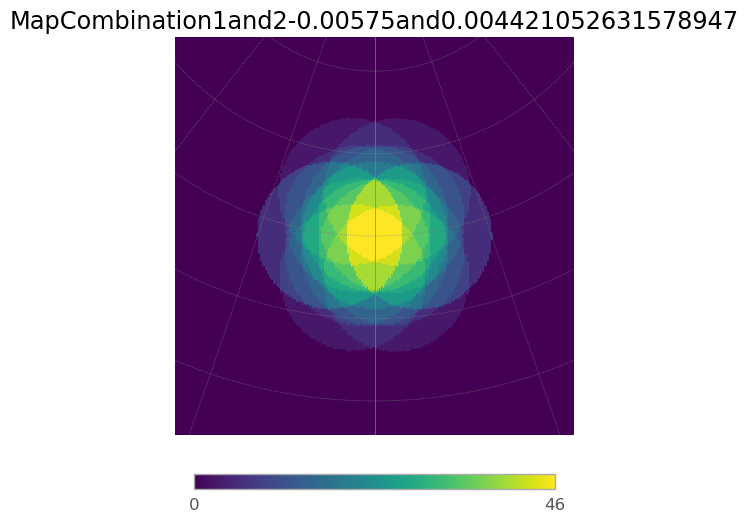

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.03it/s]
7it [00:00,  7.18it/s]
6it [00:00,  6.87it/s]
7it [00:00,  7.19it/s]
6it [00:00,  7.34it/s]
7it [00:00,  7.36it/s]
6it [00:00,  6.72it/s]


12.084619462407312


7it [00:00,  7.39it/s]


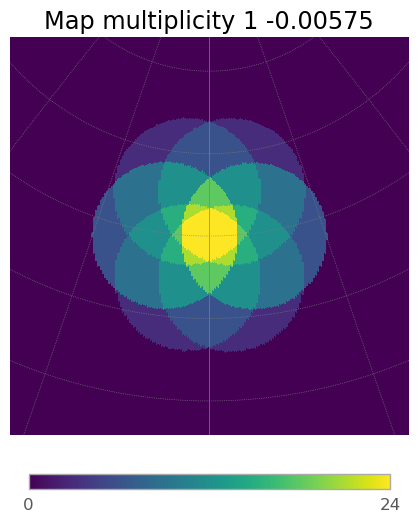

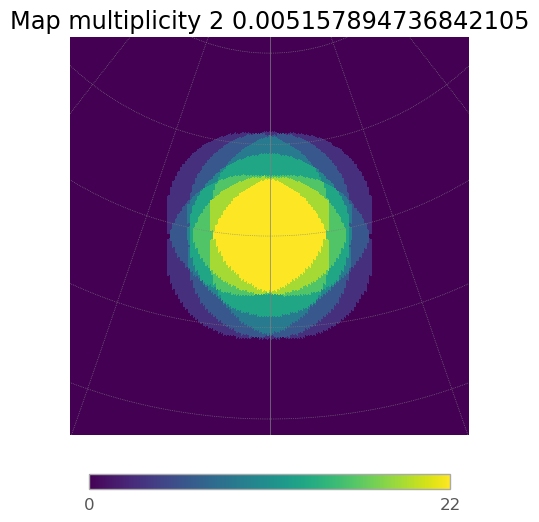

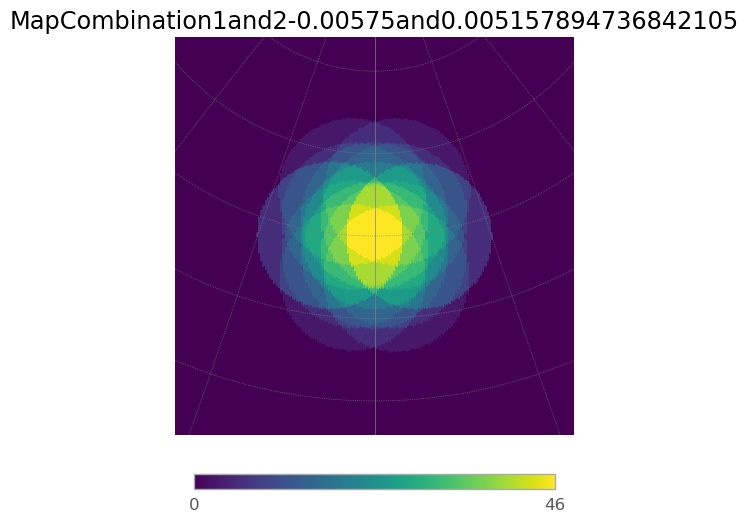

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.15it/s]
7it [00:00,  7.32it/s]
6it [00:00,  7.11it/s]
7it [00:00,  7.17it/s]
6it [00:00,  7.15it/s]
7it [00:00,  7.36it/s]
6it [00:00,  6.64it/s]


12.084619462407312


7it [00:00,  7.20it/s]


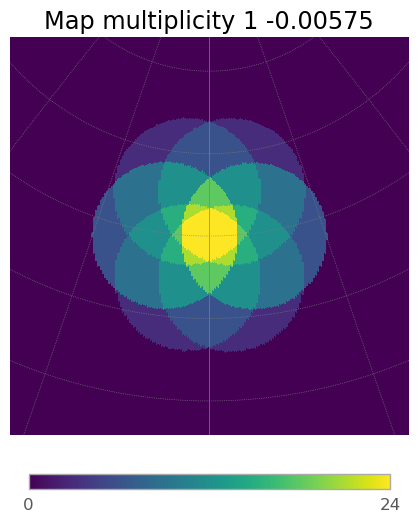

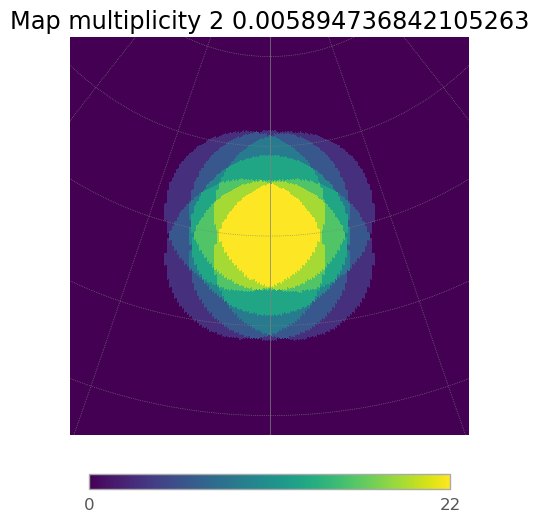

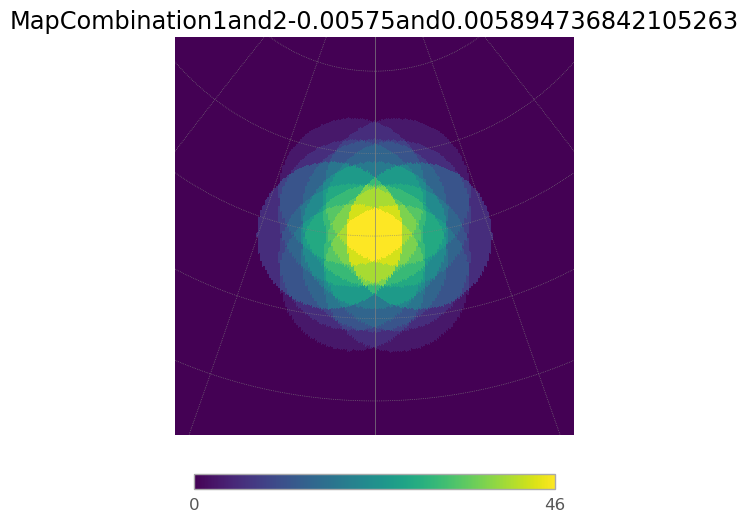

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.82it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.95it/s]
7it [00:00,  7.04it/s]
6it [00:00,  7.30it/s]
7it [00:00,  7.37it/s]
6it [00:00,  6.89it/s]


12.084619462407312


7it [00:00,  7.25it/s]


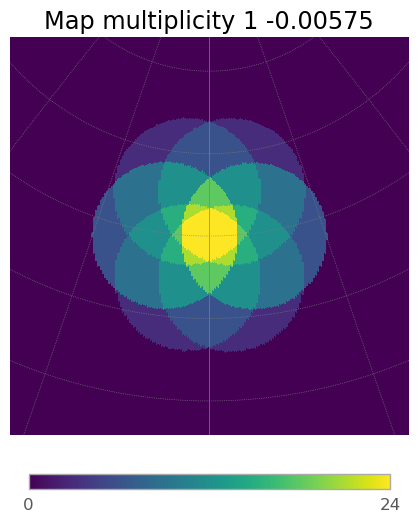

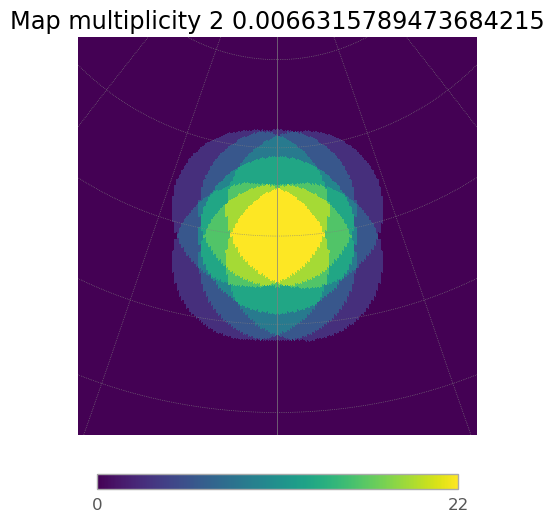

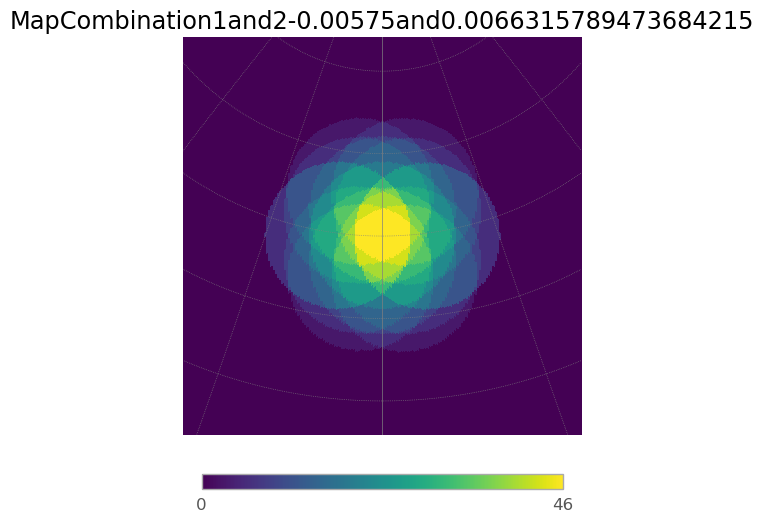

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.84it/s]
7it [00:00,  7.06it/s]
6it [00:00,  6.84it/s]
7it [00:00,  7.03it/s]
6it [00:00,  7.29it/s]
7it [00:00,  7.19it/s]
6it [00:00,  6.82it/s]


12.084619462407312


7it [00:00,  7.36it/s]


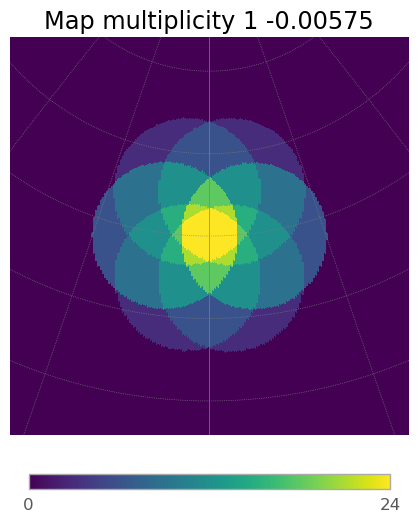

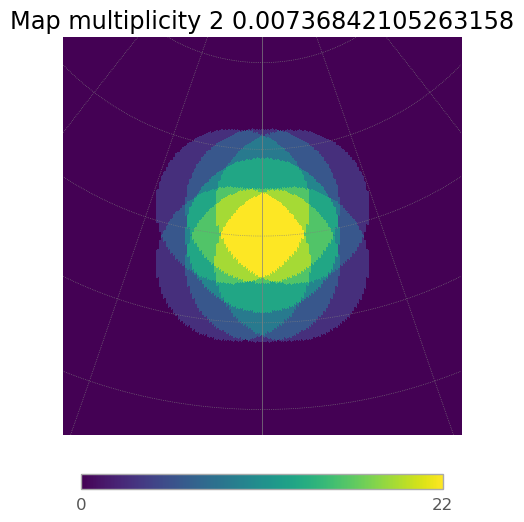

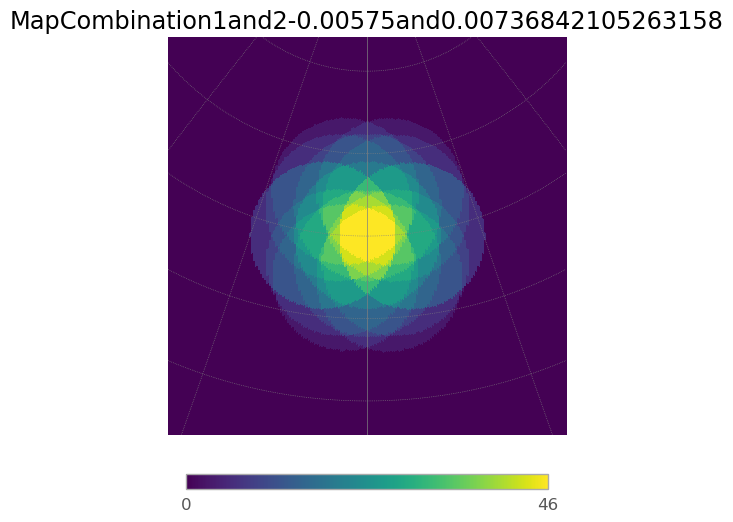

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.12it/s]
7it [00:01,  6.97it/s]
6it [00:00,  7.09it/s]
7it [00:00,  7.30it/s]
6it [00:00,  7.34it/s]
7it [00:00,  7.22it/s]
6it [00:00,  7.00it/s]


12.084619462407312


7it [00:00,  7.41it/s]


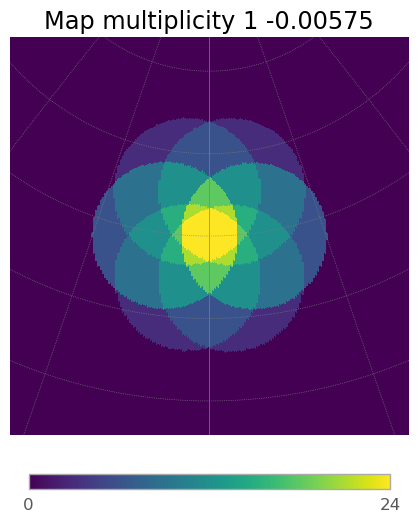

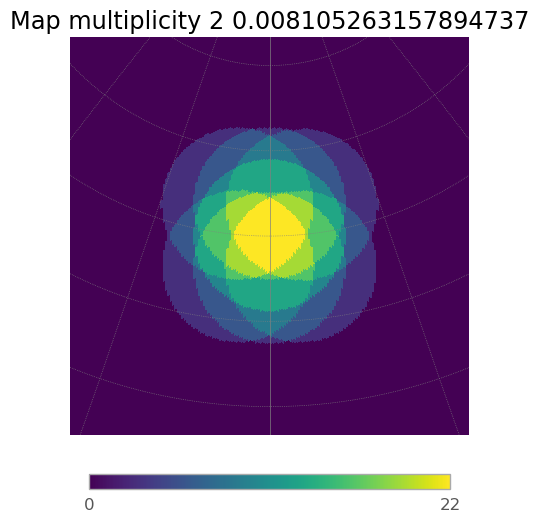

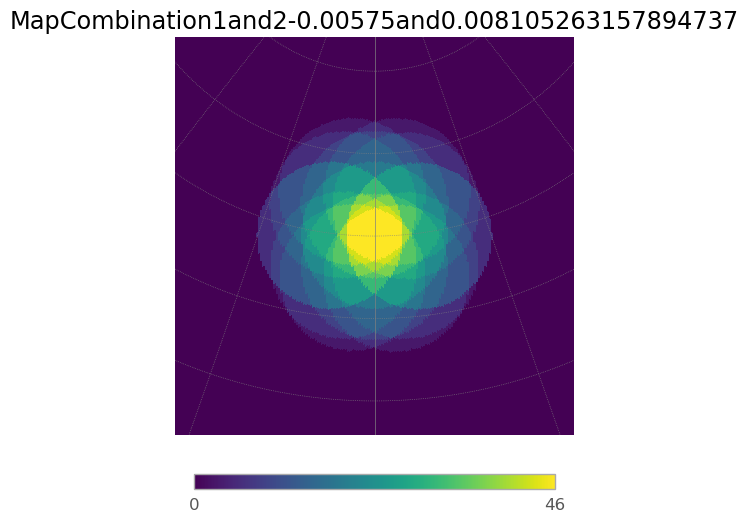

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.14it/s]
7it [00:00,  7.20it/s]
6it [00:00,  7.06it/s]
7it [00:01,  6.89it/s]
6it [00:00,  7.34it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.03it/s]


12.084619462407312


7it [00:01,  6.93it/s]


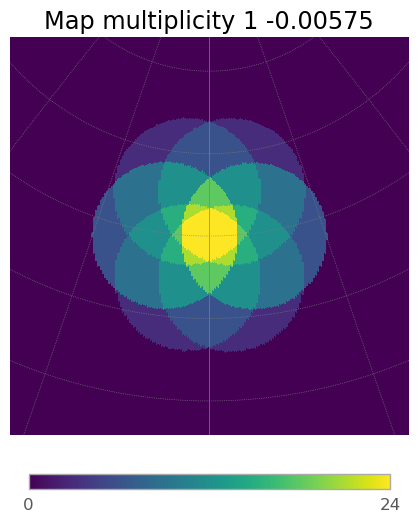

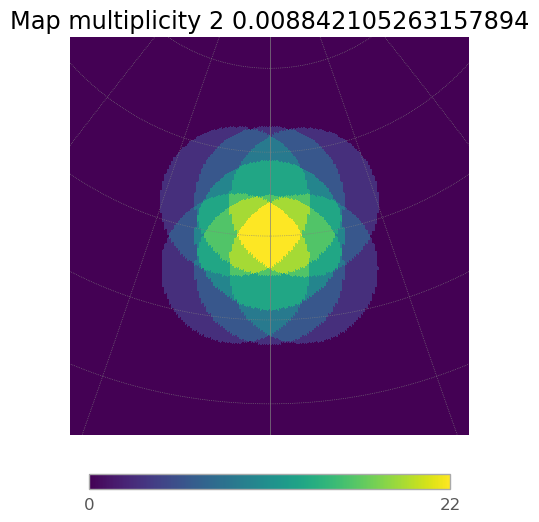

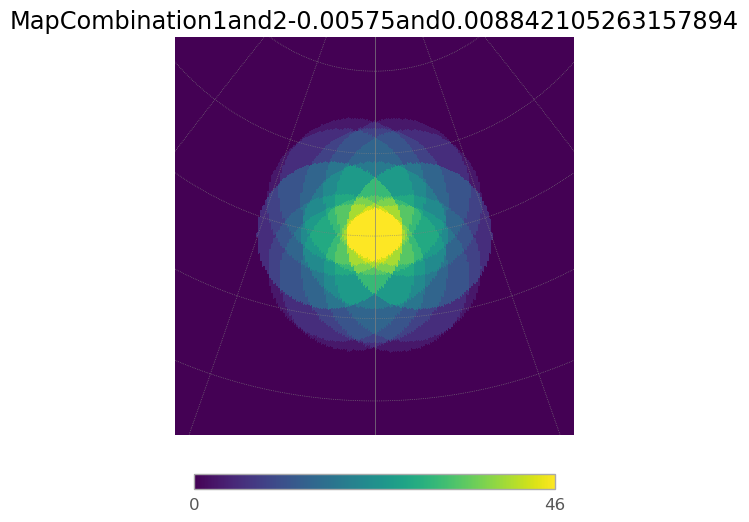

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.05it/s]
7it [00:00,  7.29it/s]
6it [00:00,  6.74it/s]
7it [00:00,  7.11it/s]
6it [00:00,  7.11it/s]
7it [00:00,  7.24it/s]
6it [00:00,  6.85it/s]


12.084619462407312


7it [00:00,  7.28it/s]


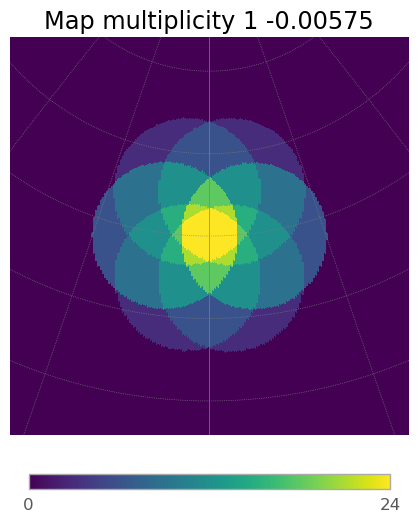

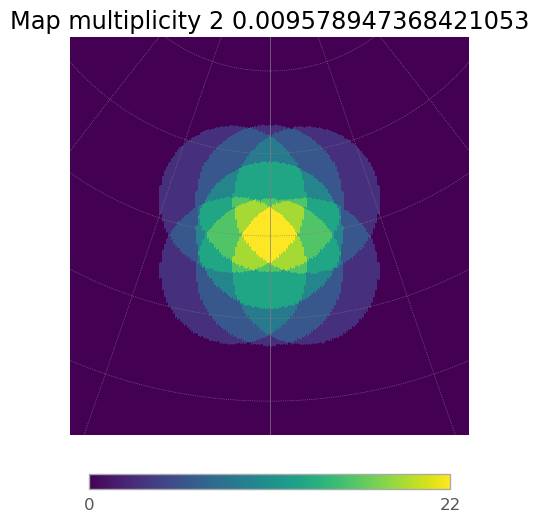

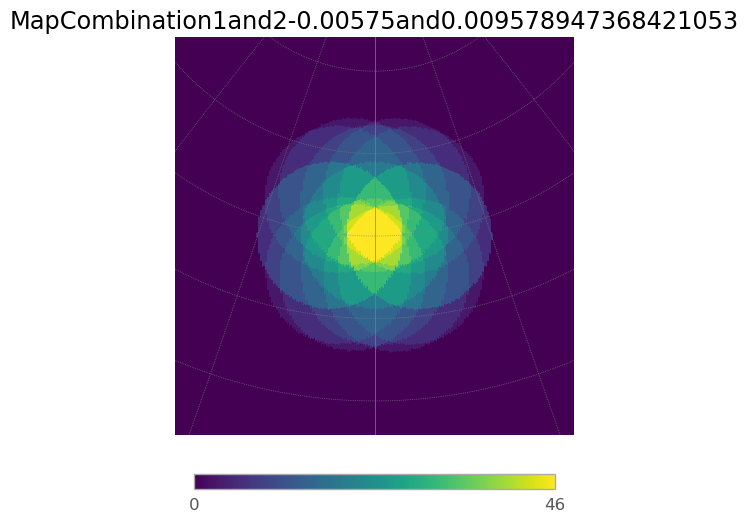

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.23it/s]
7it [00:00,  7.26it/s]
6it [00:00,  6.96it/s]
7it [00:00,  7.05it/s]
6it [00:00,  7.38it/s]
7it [00:00,  7.28it/s]
6it [00:00,  6.81it/s]


12.084619462407312


7it [00:00,  7.37it/s]


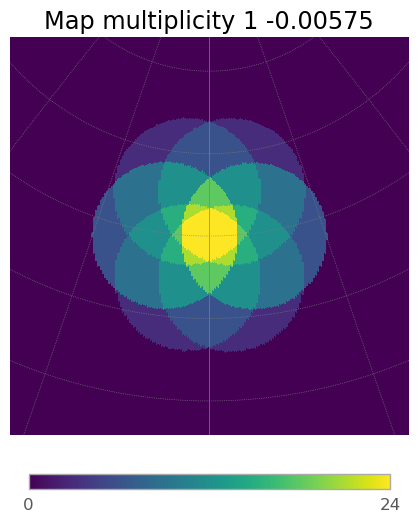

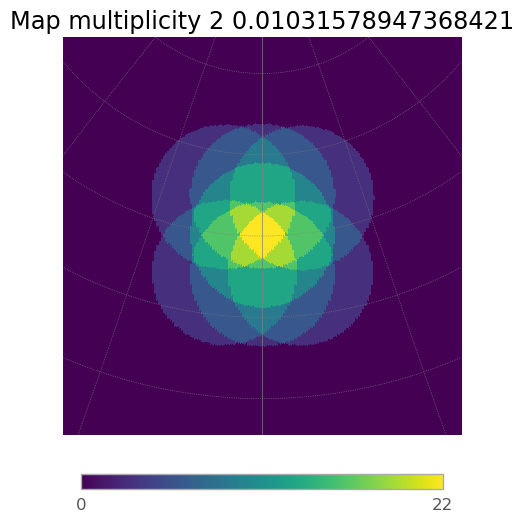

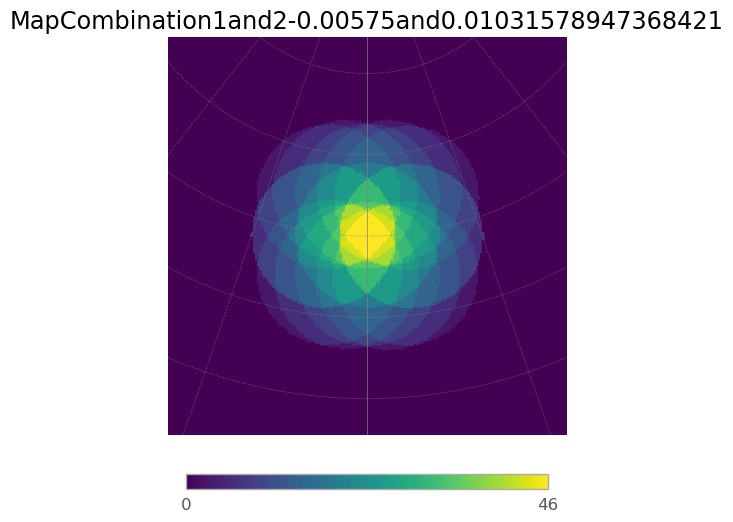

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.19it/s]
7it [00:00,  7.39it/s]
6it [00:00,  7.27it/s]
7it [00:00,  7.29it/s]
6it [00:00,  7.36it/s]
7it [00:00,  7.40it/s]
6it [00:00,  6.59it/s]


12.084619462407312


7it [00:00,  7.36it/s]


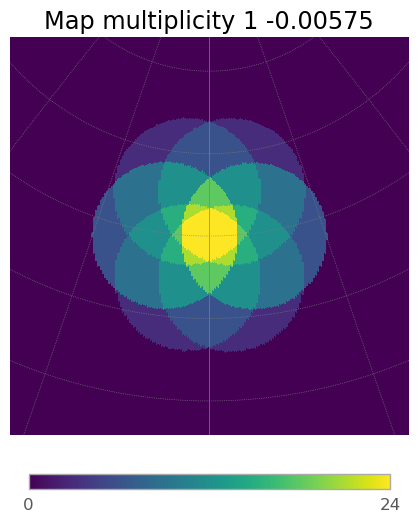

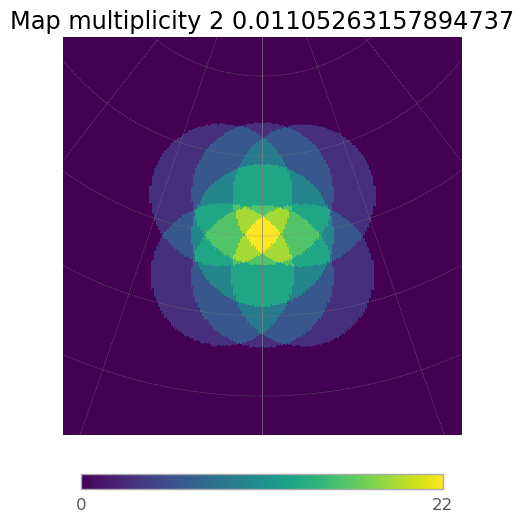

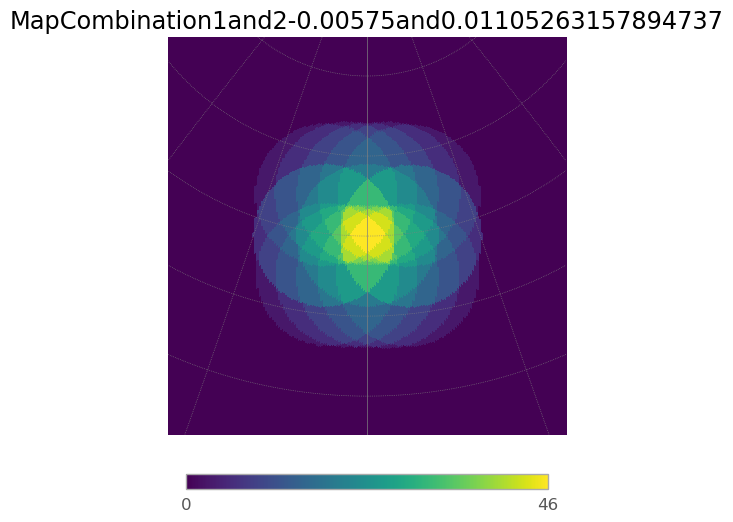

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.98it/s]
7it [00:01,  6.71it/s]
6it [00:00,  6.89it/s]
7it [00:00,  7.05it/s]
6it [00:00,  7.22it/s]
7it [00:00,  7.30it/s]
6it [00:00,  6.95it/s]


12.084619462407312


7it [00:00,  7.32it/s]


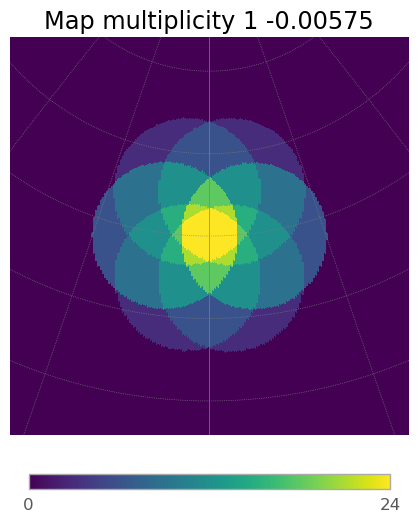

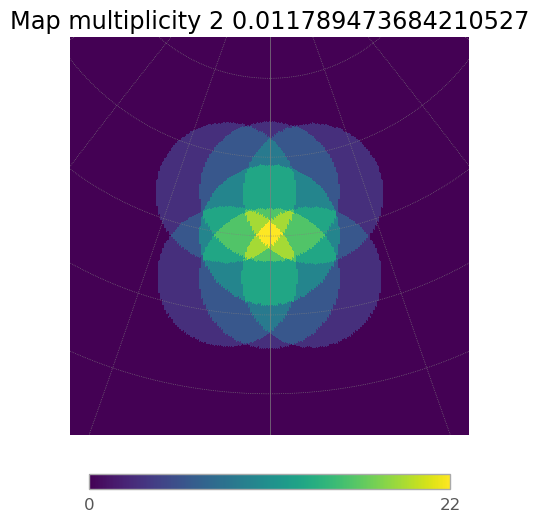

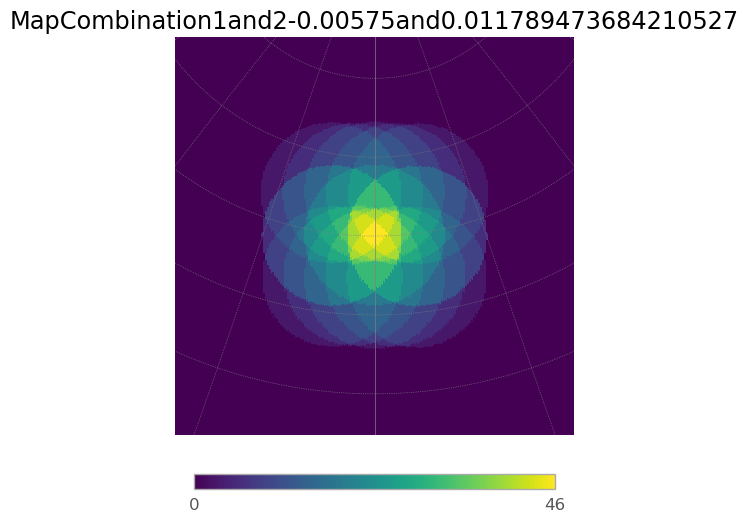

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.28it/s]
7it [00:00,  7.02it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.30it/s]
6it [00:00,  7.03it/s]
7it [00:00,  7.17it/s]
6it [00:00,  6.53it/s]


12.084619462407312


7it [00:00,  7.24it/s]


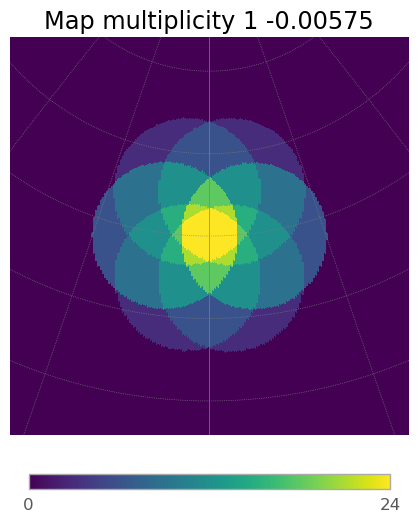

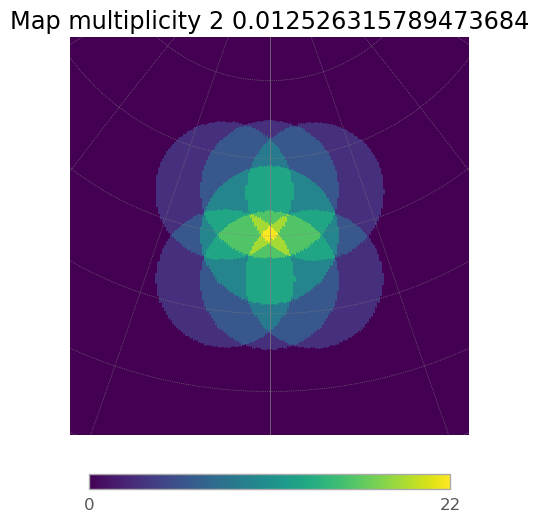

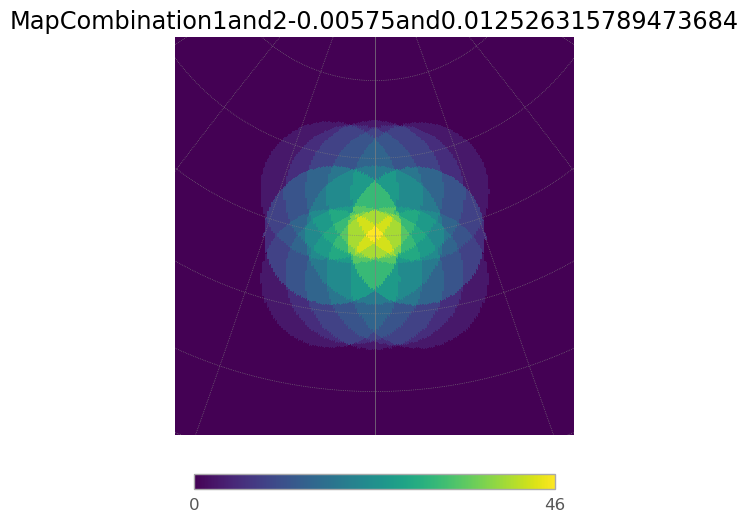

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.04it/s]
7it [00:00,  7.43it/s]
6it [00:00,  6.92it/s]
7it [00:00,  7.20it/s]
6it [00:00,  7.33it/s]
7it [00:00,  7.31it/s]
6it [00:00,  7.07it/s]


12.084619462407312


7it [00:00,  7.36it/s]


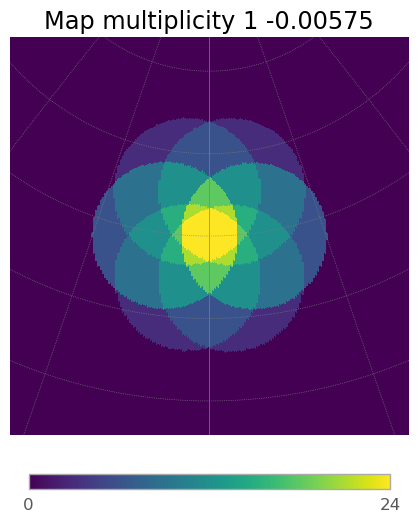

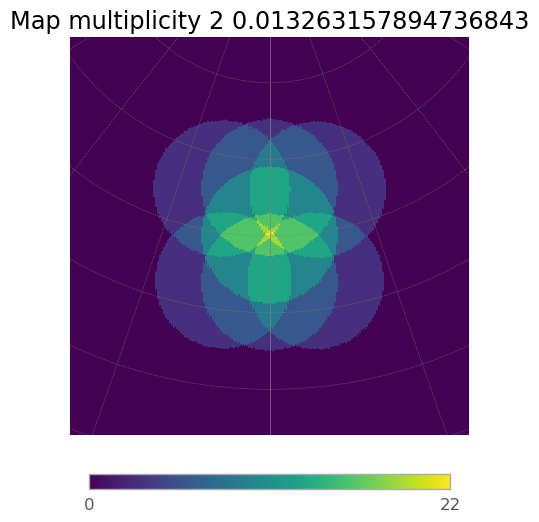

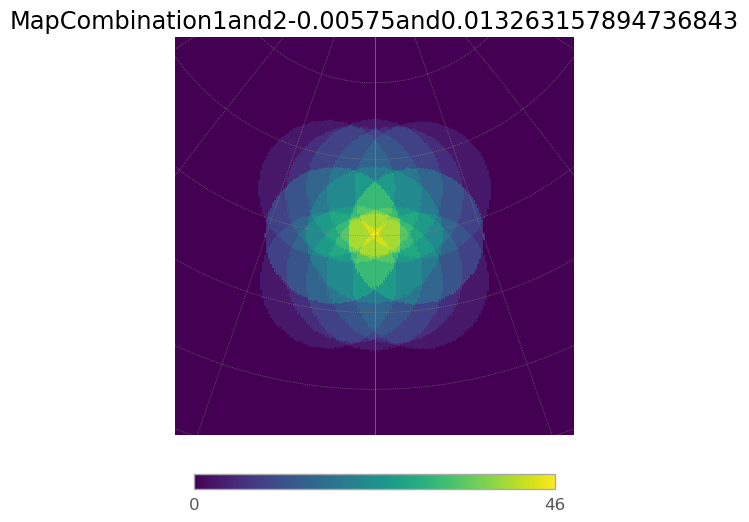

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.74it/s]
7it [00:00,  7.17it/s]
6it [00:00,  7.10it/s]
7it [00:00,  7.31it/s]
6it [00:00,  7.36it/s]
7it [00:00,  7.36it/s]
6it [00:00,  7.10it/s]


12.084619462407312


7it [00:00,  7.08it/s]


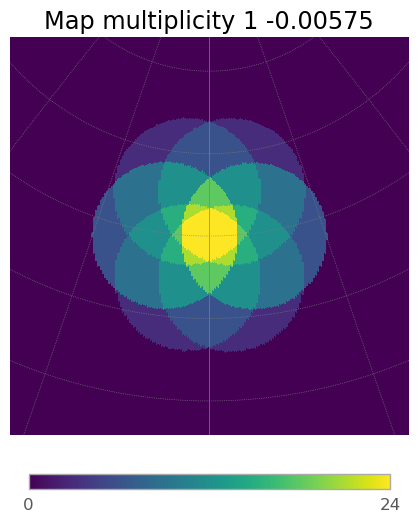

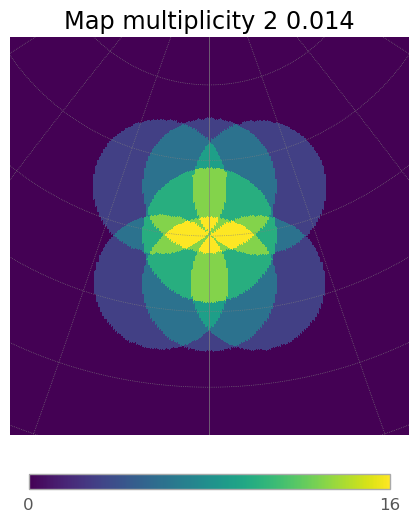

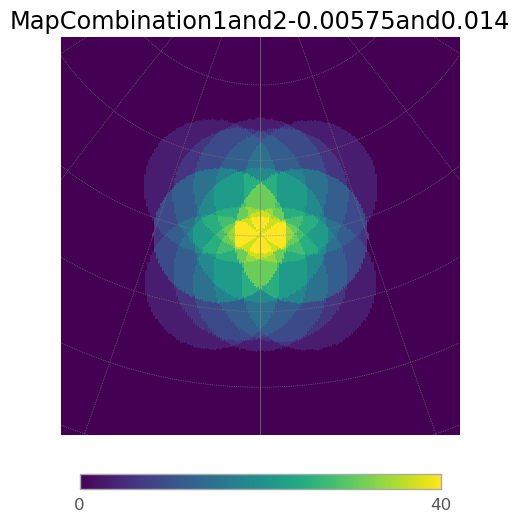

In [58]:
#BEST_ONE_CONV
FoV_array_best=[]
multiplicity_array_best=[]
for divergence in div:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=-0.00575, div2=divergence, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_array_best.append(FoV)
    multiplicity_array_best.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


6it [00:00,  7.16it/s]
7it [00:00,  7.17it/s]
6it [00:00,  7.14it/s]
7it [00:00,  7.30it/s]
6it [00:00,  7.37it/s]
7it [00:00,  7.26it/s]
6it [00:00,  6.76it/s]


9.450044810959682


7it [00:00,  7.15it/s]


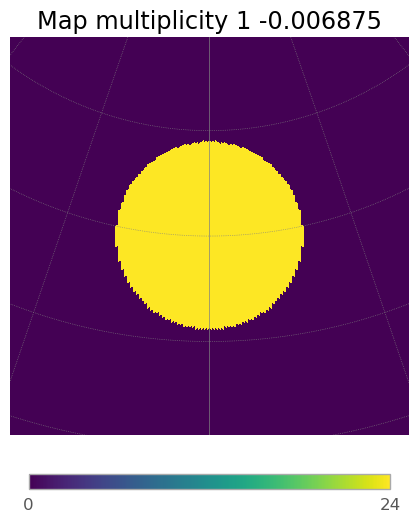

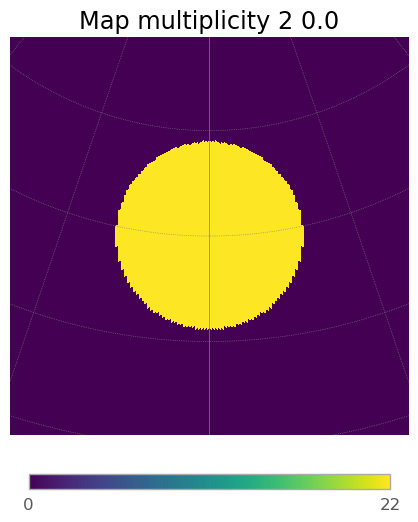

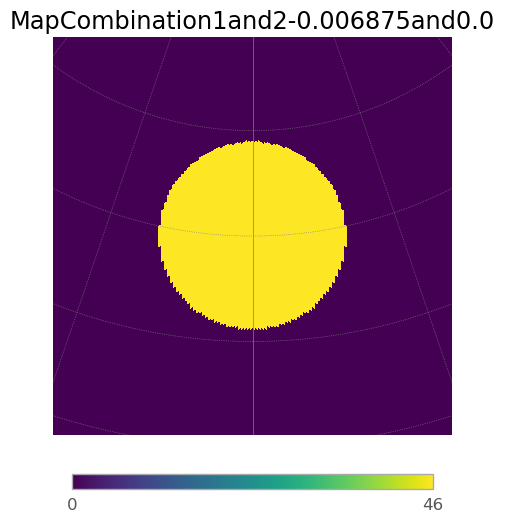

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.87it/s]
7it [00:00,  7.32it/s]
6it [00:00,  6.99it/s]
7it [00:00,  7.11it/s]
6it [00:00,  7.38it/s]
7it [00:01,  6.91it/s]
6it [00:01,  5.76it/s]


12.581567644489812


7it [00:00,  7.18it/s]


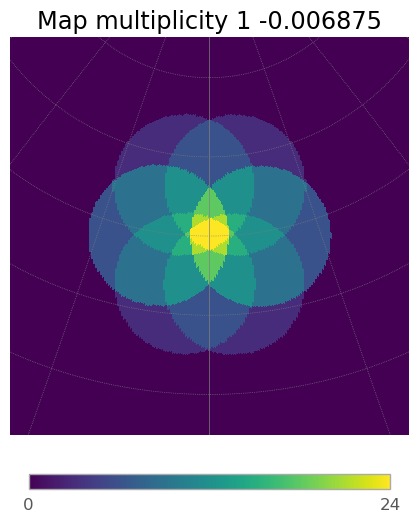

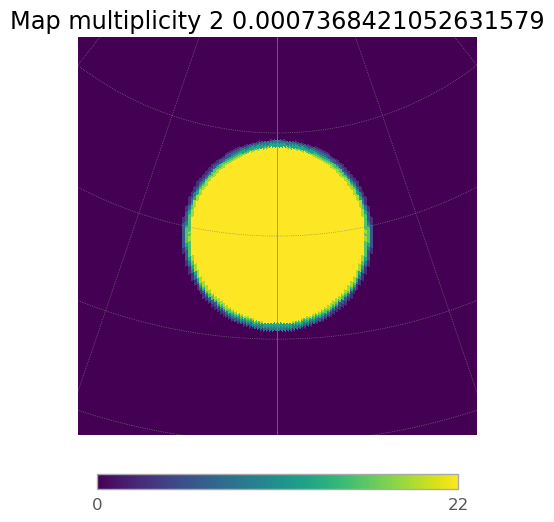

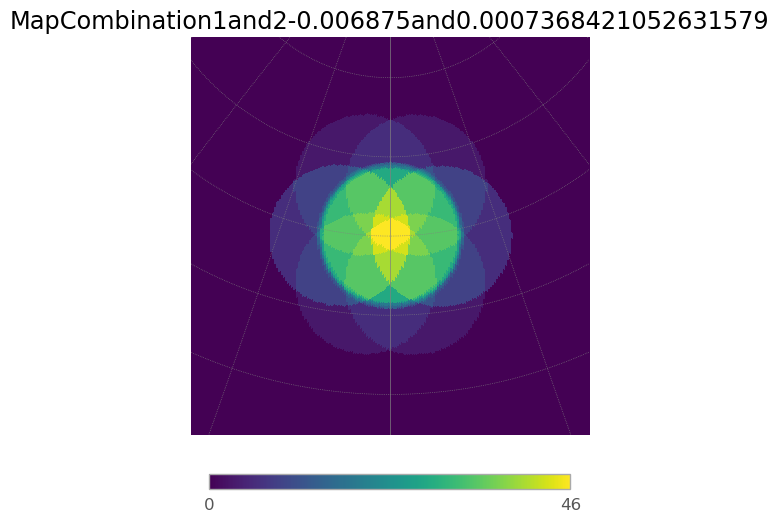

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.03it/s]
7it [00:00,  7.20it/s]
6it [00:00,  6.70it/s]
7it [00:00,  7.13it/s]
6it [00:00,  7.30it/s]
7it [00:00,  7.27it/s]
6it [00:00,  6.79it/s]


12.581567644489812


7it [00:01,  6.69it/s]


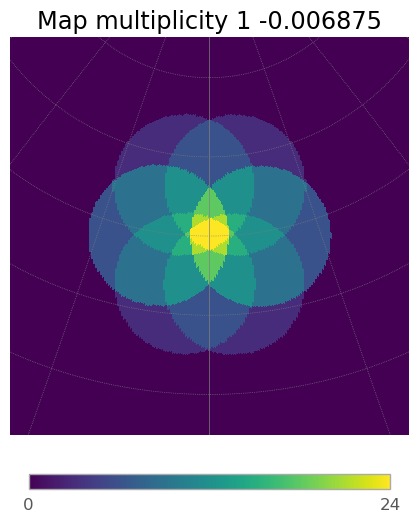

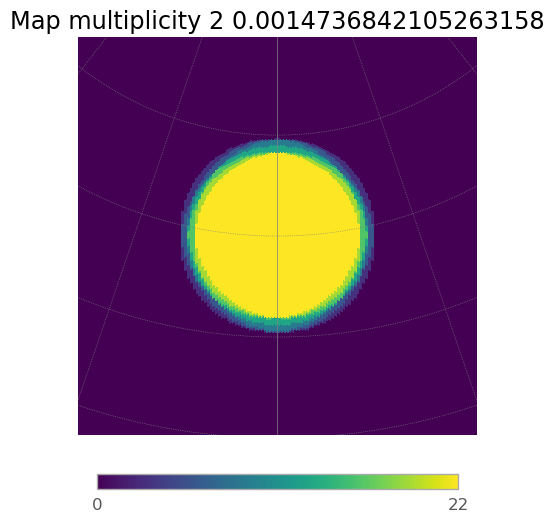

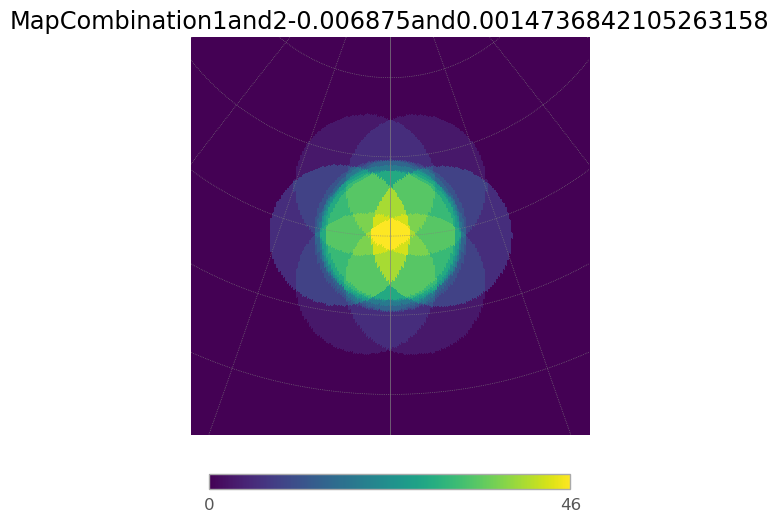

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.48it/s]
7it [00:01,  6.71it/s]
6it [00:00,  6.68it/s]
7it [00:01,  6.69it/s]
6it [00:00,  6.72it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.56it/s]


12.581567644489812


7it [00:00,  7.02it/s]


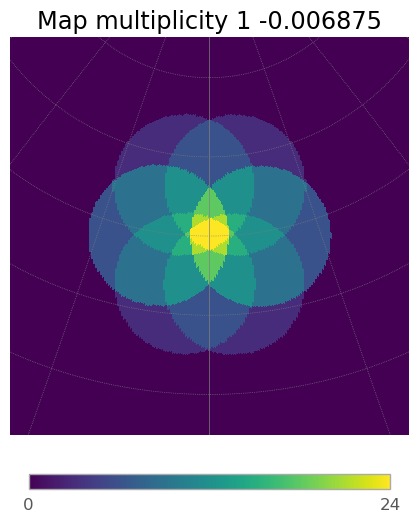

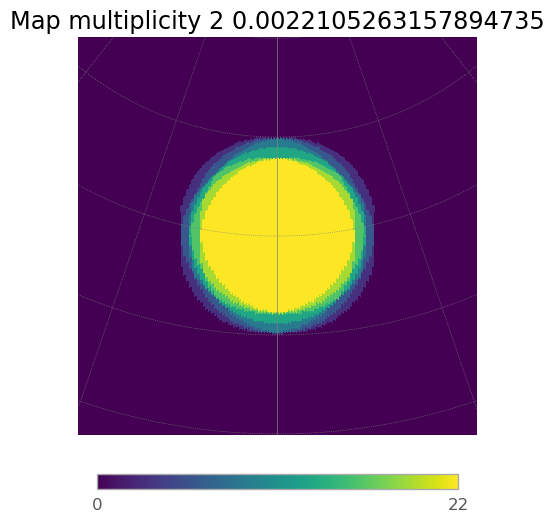

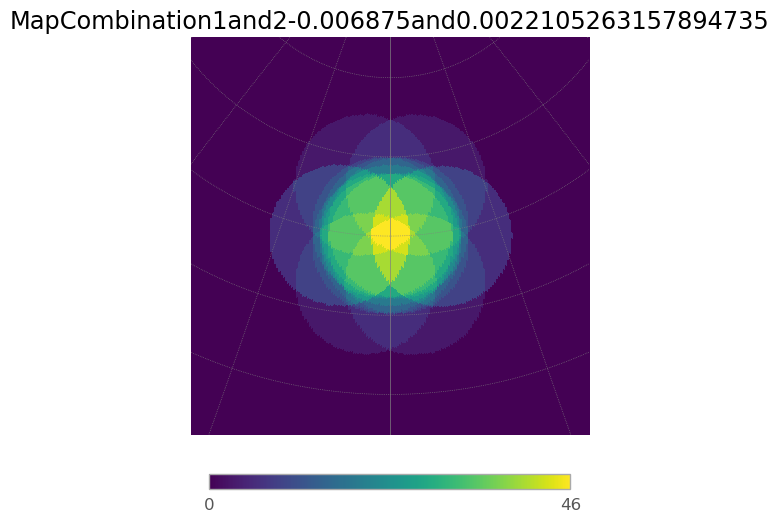

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.79it/s]
7it [00:01,  6.98it/s]
6it [00:00,  6.83it/s]
7it [00:00,  7.06it/s]
6it [00:00,  6.91it/s]
7it [00:01,  6.88it/s]
6it [00:00,  6.81it/s]


12.581567644489812


7it [00:00,  7.01it/s]


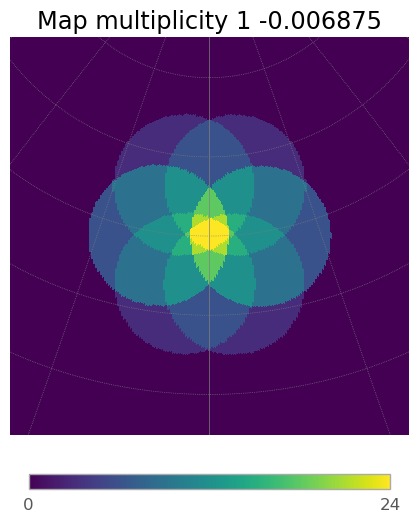

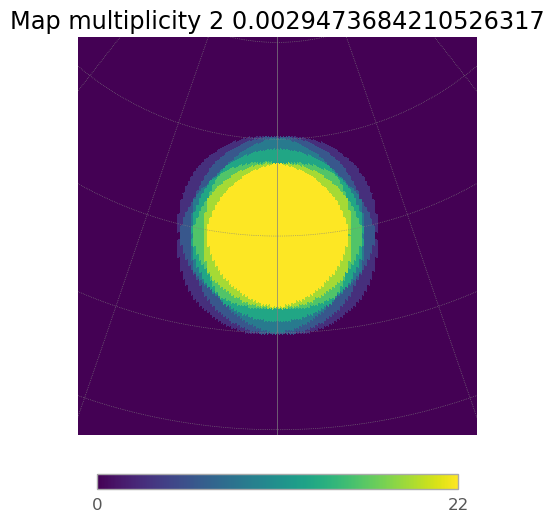

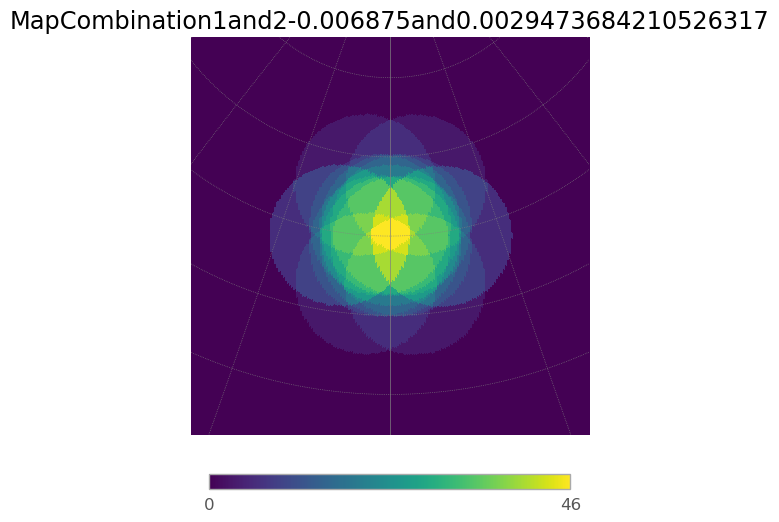

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.43it/s]
7it [00:01,  6.74it/s]
6it [00:00,  6.62it/s]
7it [00:01,  6.81it/s]
6it [00:00,  6.94it/s]
7it [00:00,  7.09it/s]
6it [00:00,  6.55it/s]


12.581567644489812


7it [00:01,  6.94it/s]


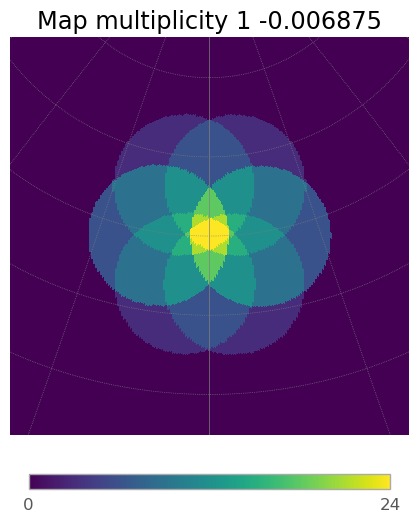

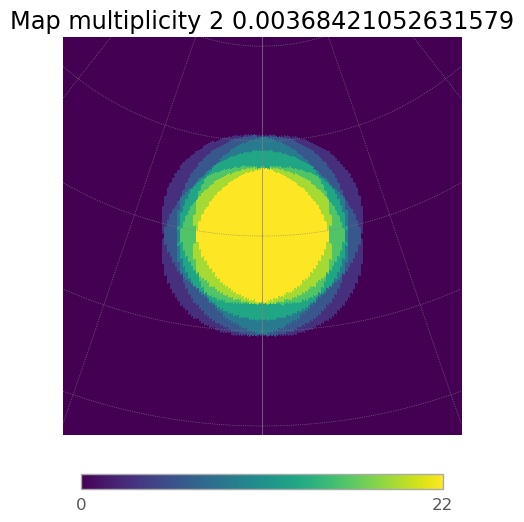

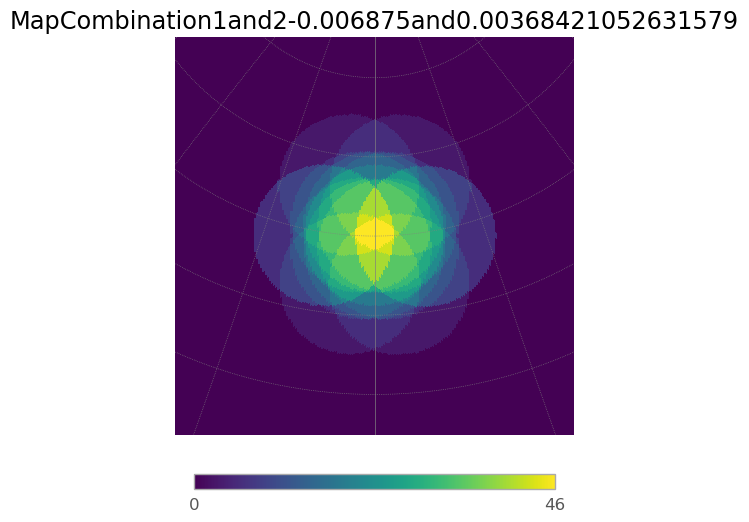

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.52it/s]
7it [00:01,  6.50it/s]
6it [00:00,  6.60it/s]
7it [00:00,  7.02it/s]
6it [00:00,  6.73it/s]
7it [00:01,  6.84it/s]
6it [00:00,  6.45it/s]


12.581567644489812


7it [00:01,  6.77it/s]


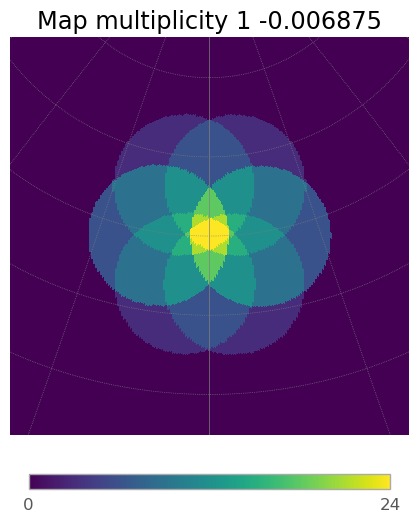

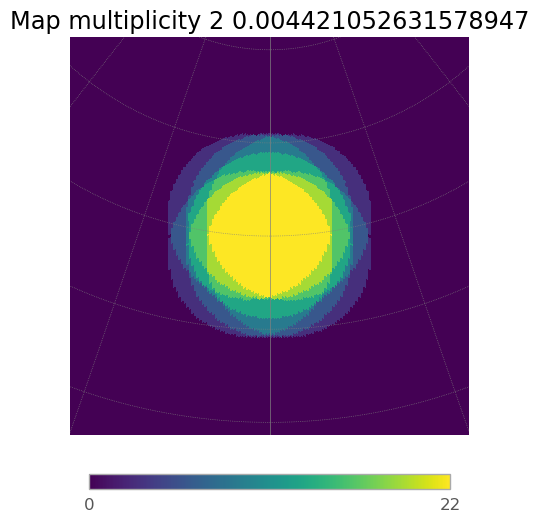

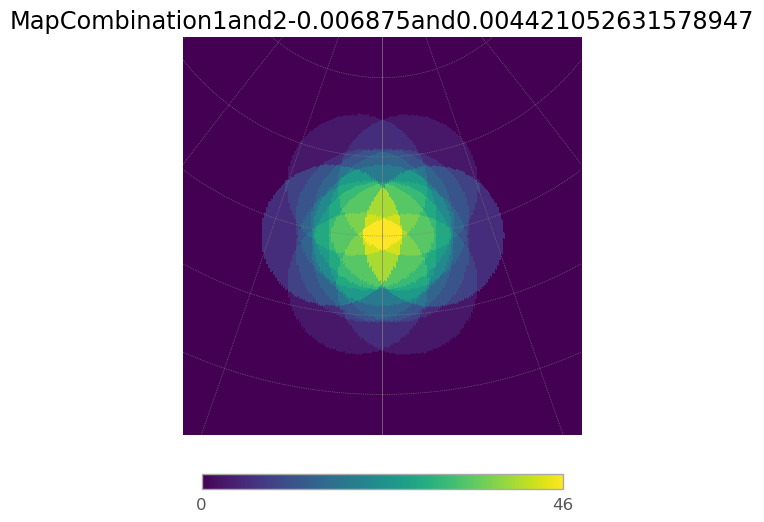

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.51it/s]
7it [00:01,  6.78it/s]
6it [00:00,  6.98it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.99it/s]
7it [00:01,  6.93it/s]
6it [00:00,  6.62it/s]


12.581567644489812


7it [00:01,  6.12it/s]


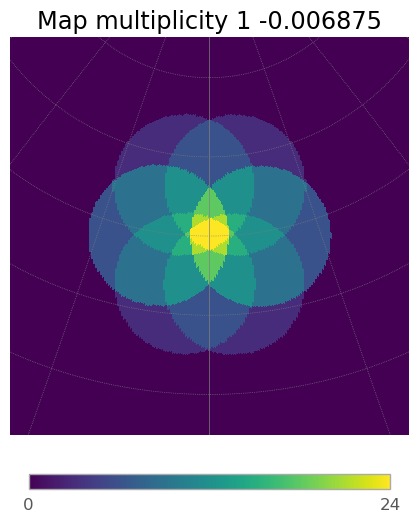

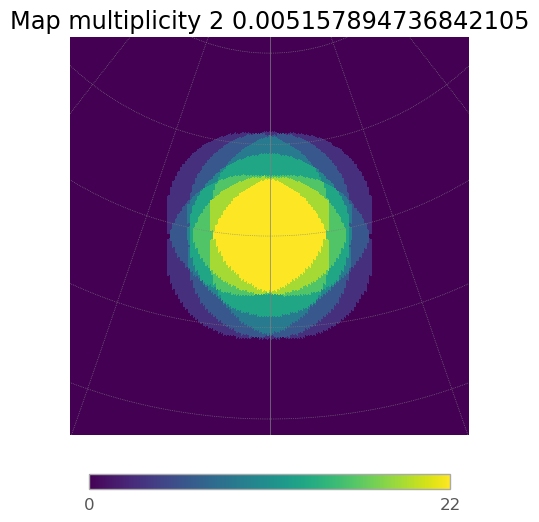

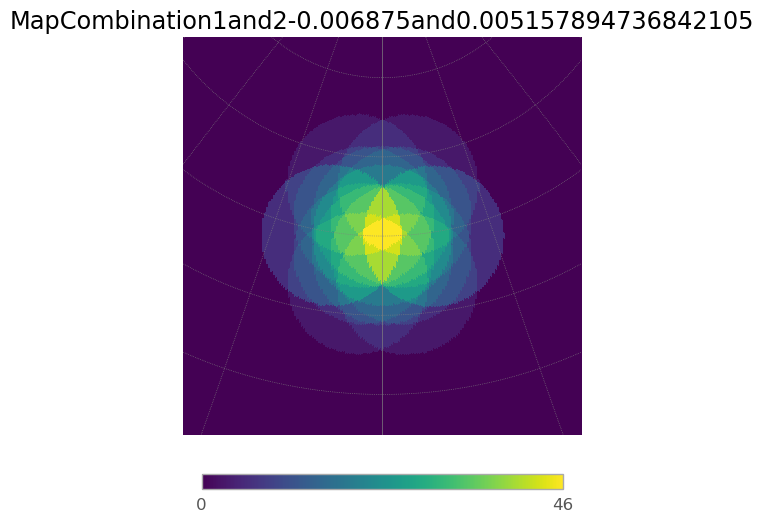

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.84it/s]
7it [00:01,  6.63it/s]
6it [00:00,  6.73it/s]
7it [00:01,  6.86it/s]
6it [00:00,  6.44it/s]
7it [00:01,  6.63it/s]
6it [00:00,  6.46it/s]


12.581567644489812


7it [00:01,  6.82it/s]


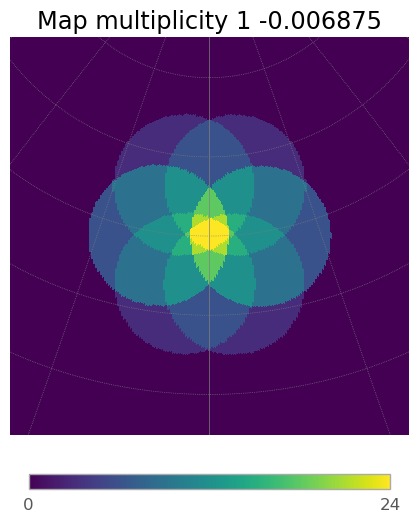

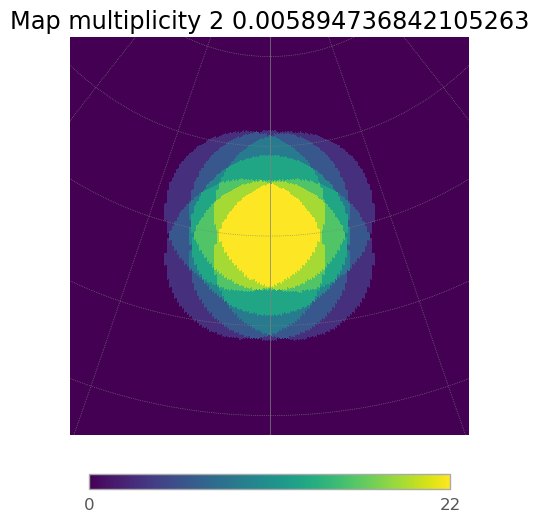

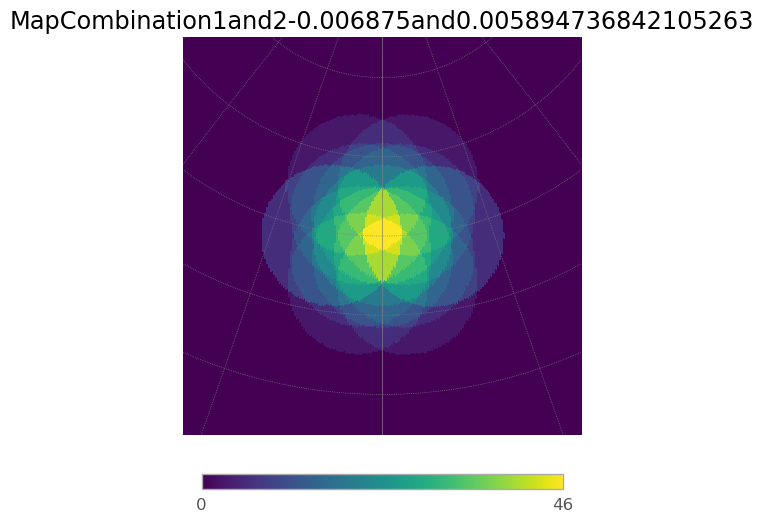

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.43it/s]
7it [00:01,  6.54it/s]
6it [00:00,  6.61it/s]
7it [00:01,  6.90it/s]
6it [00:00,  7.04it/s]
7it [00:01,  6.84it/s]
6it [00:00,  6.90it/s]


12.581567644489812


7it [00:01,  6.87it/s]


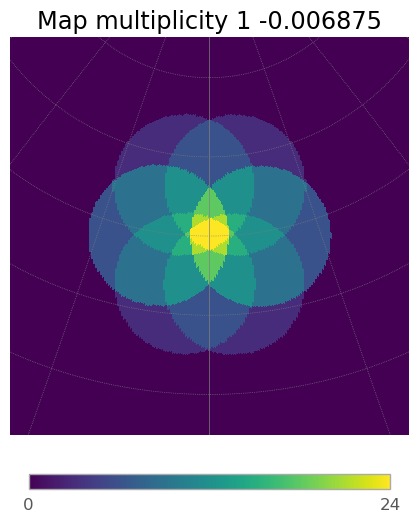

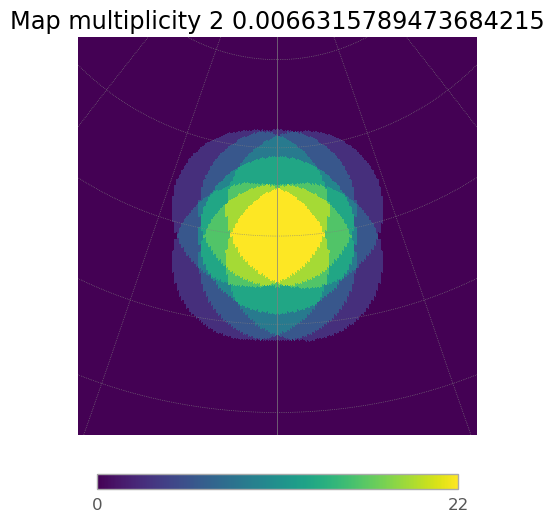

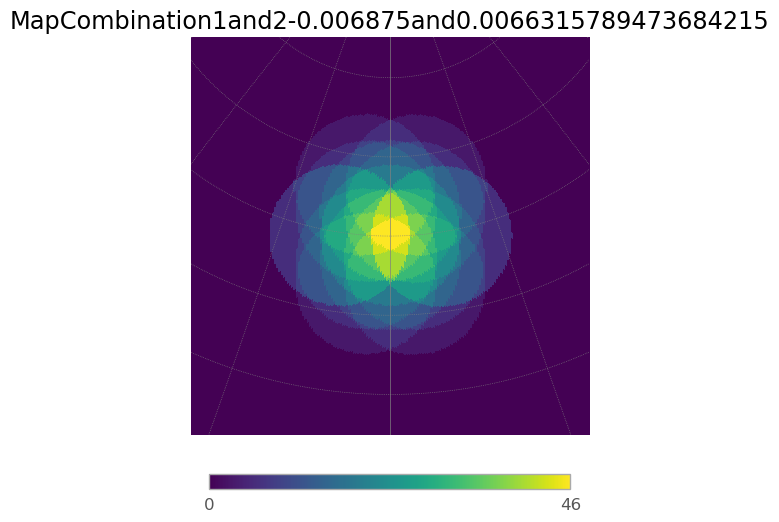

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.69it/s]
7it [00:01,  6.73it/s]
6it [00:00,  6.48it/s]
7it [00:01,  6.51it/s]
6it [00:00,  6.78it/s]
7it [00:01,  6.89it/s]
6it [00:00,  6.51it/s]


12.581567644489812


7it [00:01,  6.88it/s]


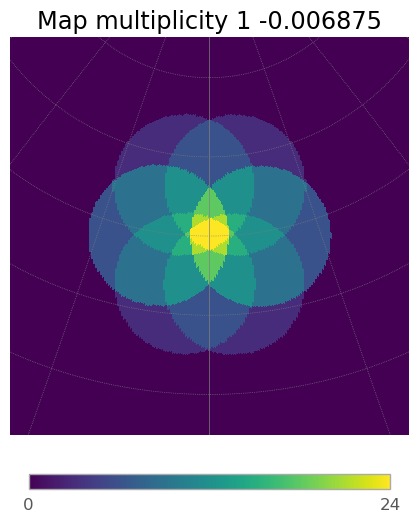

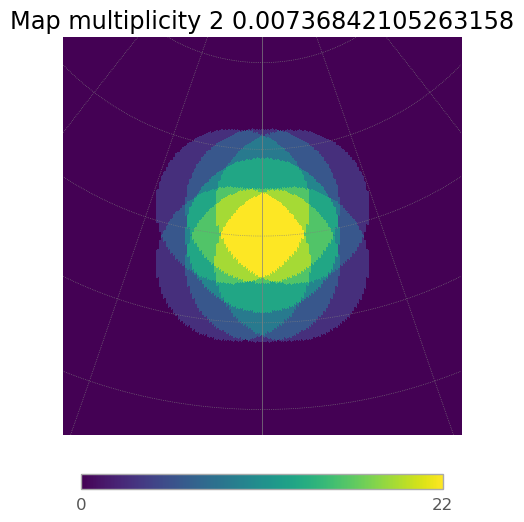

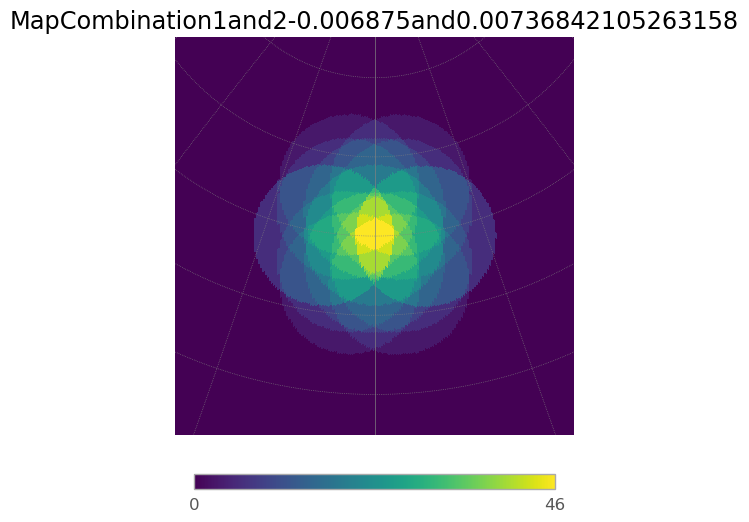

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.82it/s]
7it [00:01,  6.66it/s]
6it [00:00,  6.35it/s]
7it [00:01,  6.59it/s]
6it [00:00,  6.58it/s]
7it [00:01,  6.72it/s]
6it [00:01,  5.95it/s]


12.581567644489812


7it [00:01,  6.67it/s]


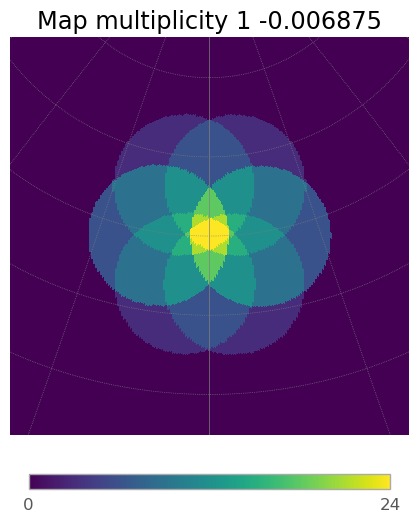

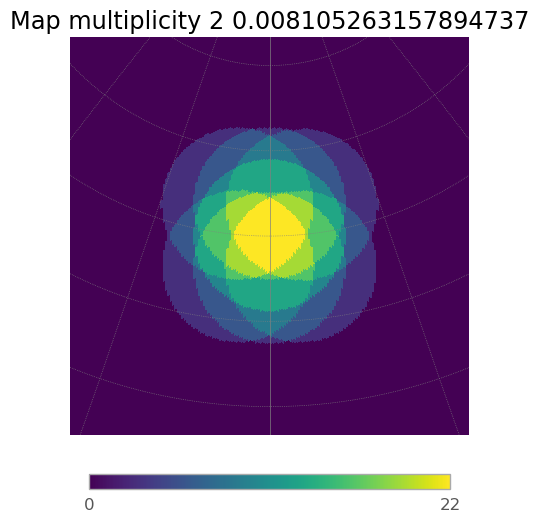

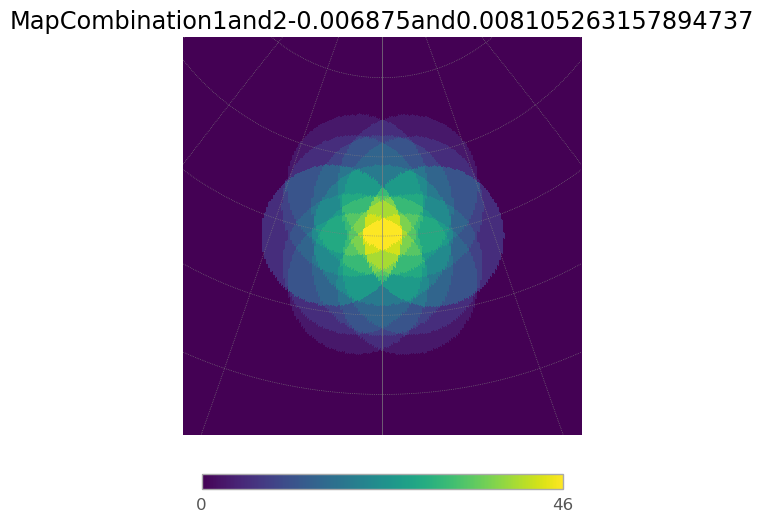

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.45it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.50it/s]
7it [00:01,  6.57it/s]
6it [00:00,  6.68it/s]
7it [00:01,  6.72it/s]
6it [00:00,  6.46it/s]


12.581567644489812


7it [00:01,  6.99it/s]


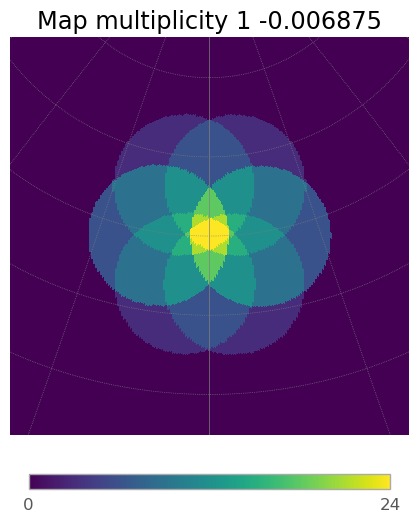

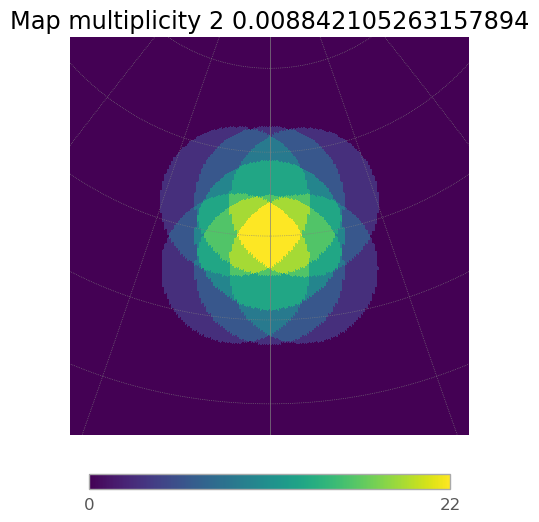

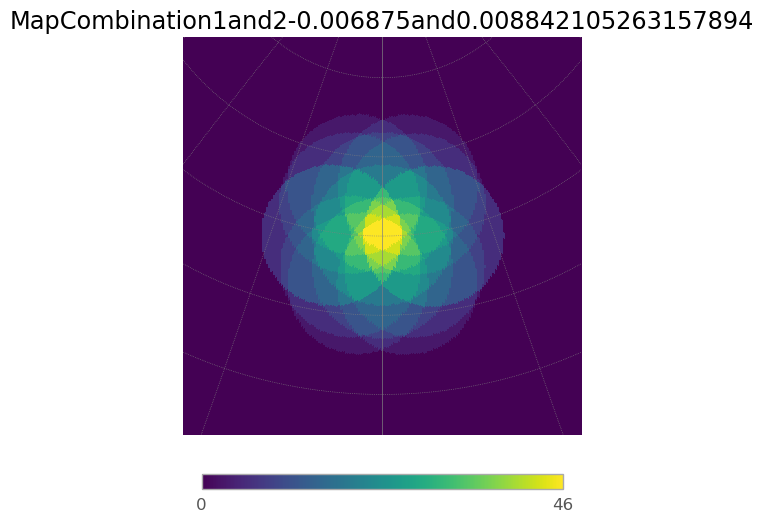

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.58it/s]
7it [00:01,  6.85it/s]
6it [00:00,  6.83it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.96it/s]
7it [00:00,  7.06it/s]
6it [00:00,  6.61it/s]


12.581567644489812


7it [00:00,  7.09it/s]


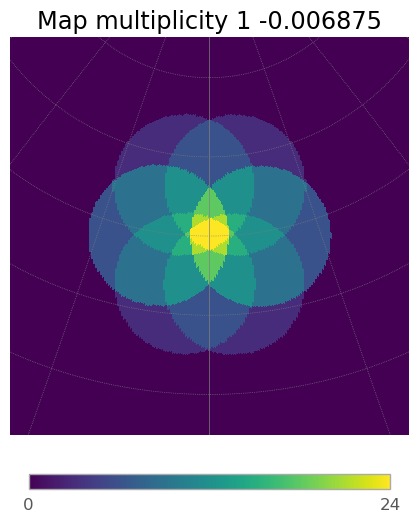

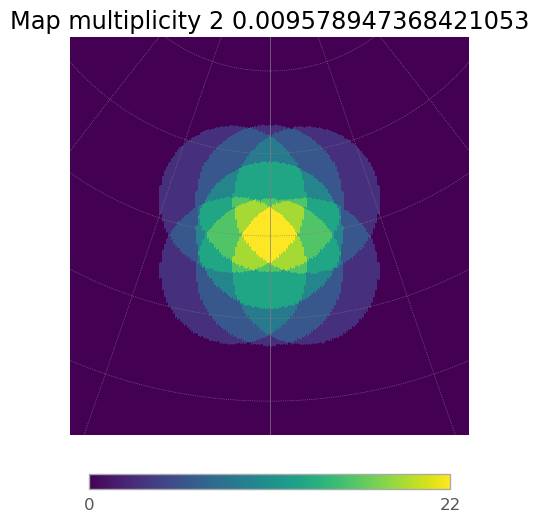

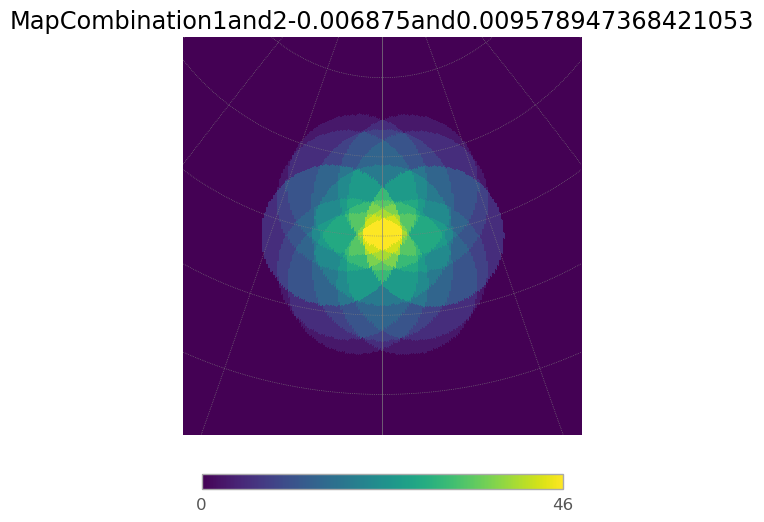

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.76it/s]
7it [00:00,  7.13it/s]
6it [00:00,  6.78it/s]
7it [00:00,  7.03it/s]
6it [00:00,  7.00it/s]
7it [00:00,  7.19it/s]
6it [00:00,  6.60it/s]


12.581567644489812


7it [00:01,  6.75it/s]


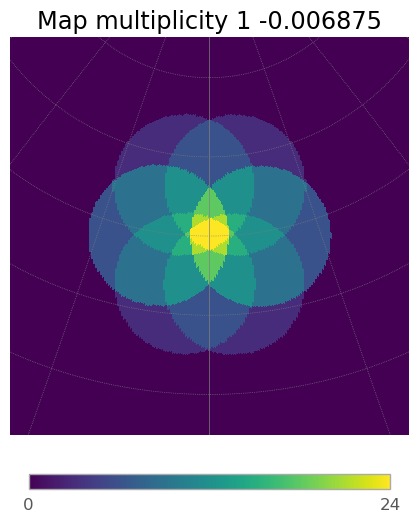

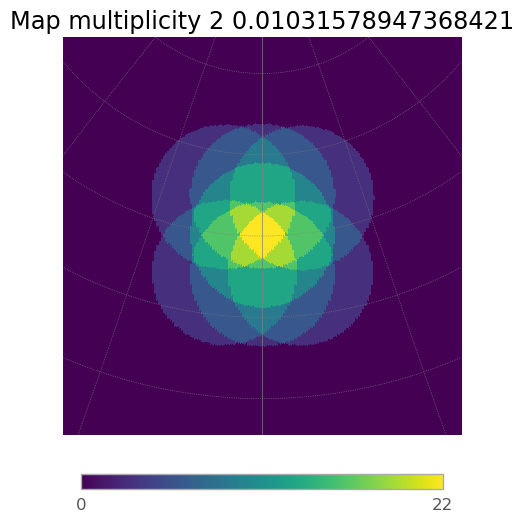

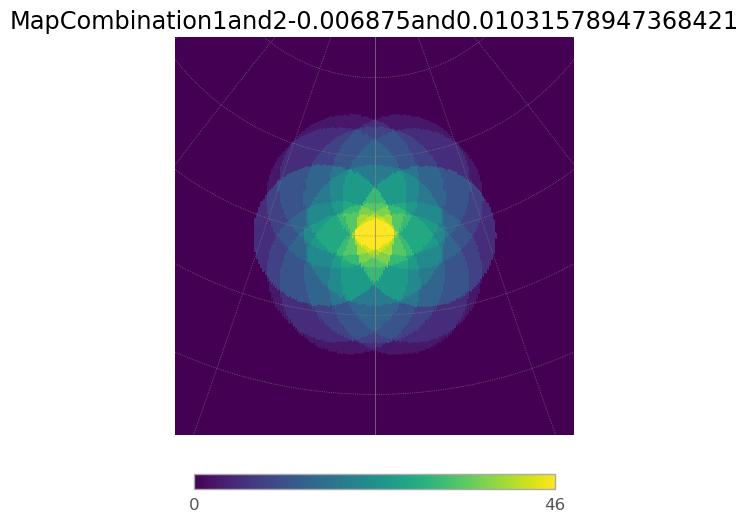

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.85it/s]
7it [00:01,  6.95it/s]
6it [00:00,  6.86it/s]
7it [00:00,  7.39it/s]
6it [00:00,  7.45it/s]
7it [00:01,  6.88it/s]
6it [00:00,  6.86it/s]


12.581567644489812


7it [00:00,  7.32it/s]


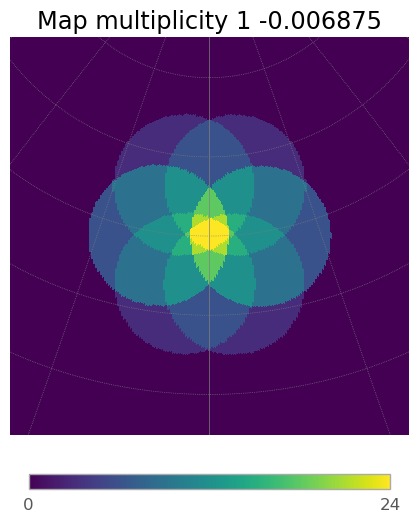

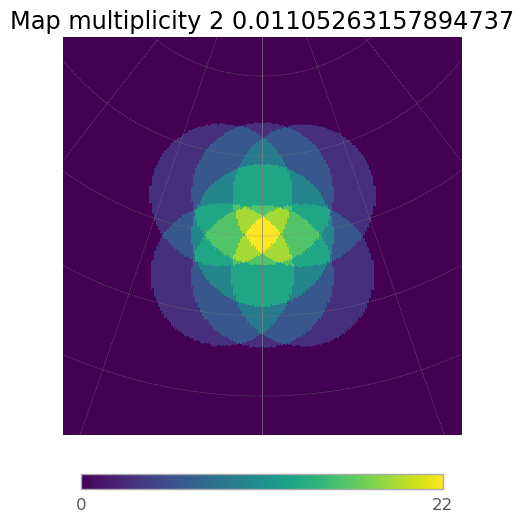

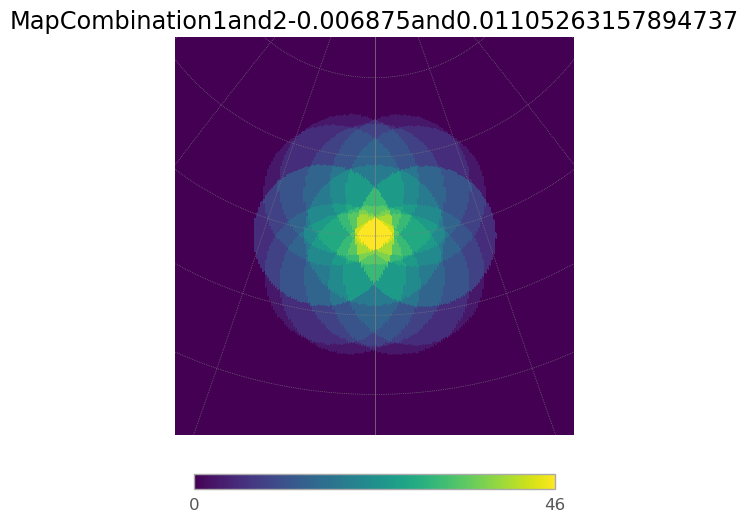

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.74it/s]
7it [00:00,  7.08it/s]
6it [00:00,  6.78it/s]
7it [00:00,  7.11it/s]
6it [00:00,  7.21it/s]
7it [00:00,  7.25it/s]
6it [00:00,  6.63it/s]


12.581567644489812


7it [00:01,  6.87it/s]


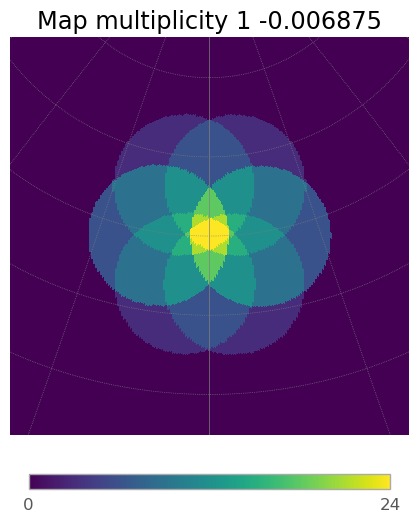

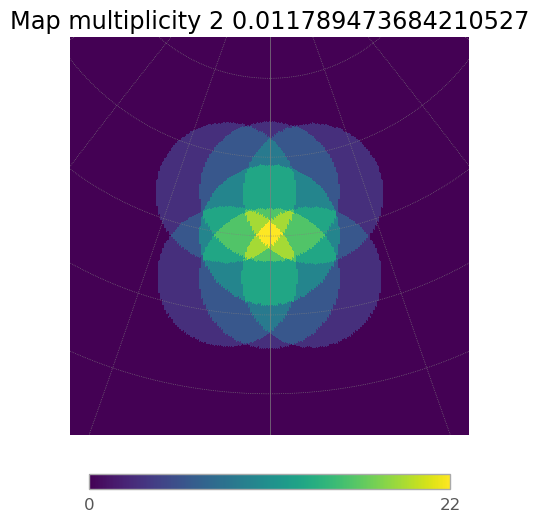

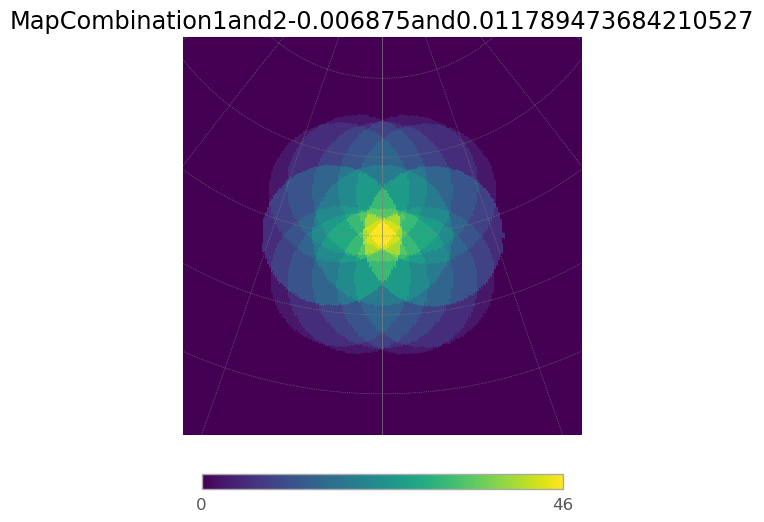

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.51it/s]
7it [00:01,  6.79it/s]
6it [00:00,  6.90it/s]
7it [00:00,  7.31it/s]
6it [00:00,  7.07it/s]
7it [00:00,  7.21it/s]
6it [00:00,  6.44it/s]


12.581567644489812


7it [00:01,  6.59it/s]


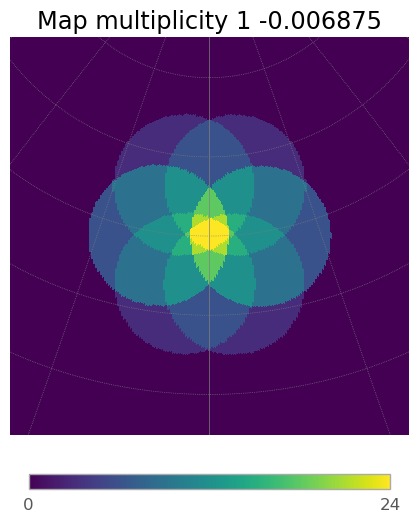

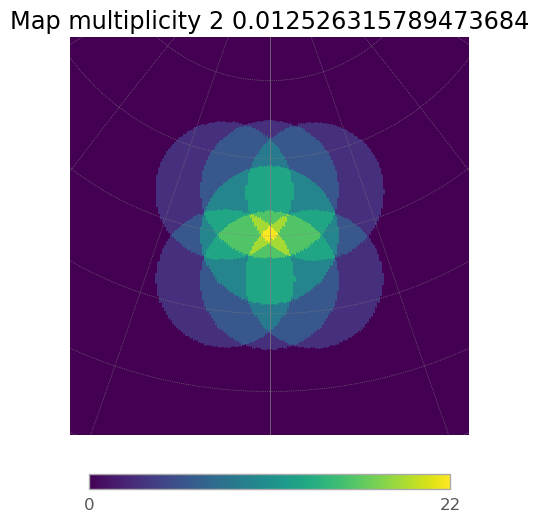

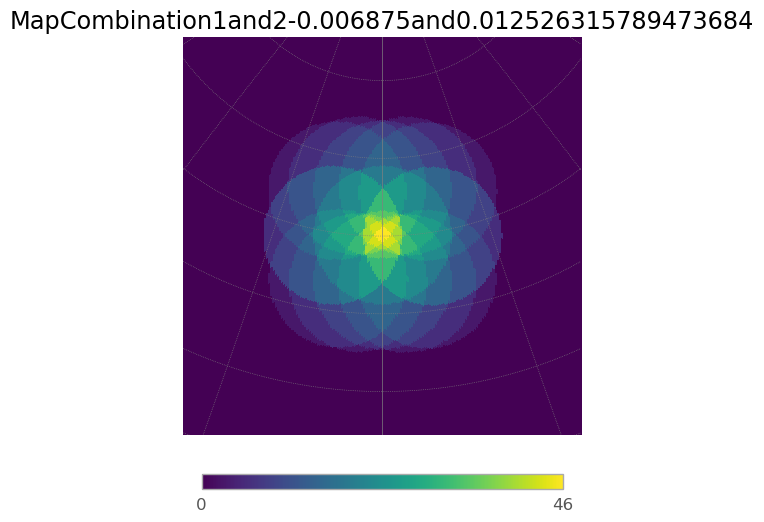

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.54it/s]
7it [00:00,  7.04it/s]
6it [00:00,  6.88it/s]
7it [00:00,  7.21it/s]
6it [00:00,  6.99it/s]
7it [00:00,  7.03it/s]
6it [00:00,  6.52it/s]


12.581567644489812


7it [00:01,  6.72it/s]


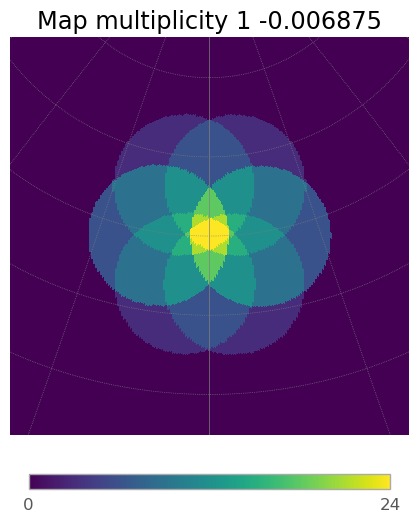

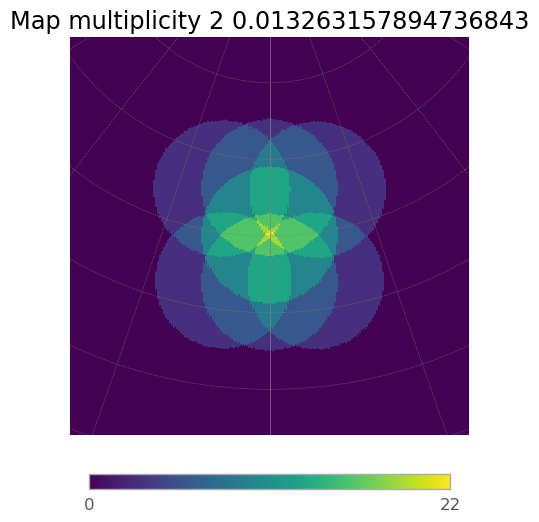

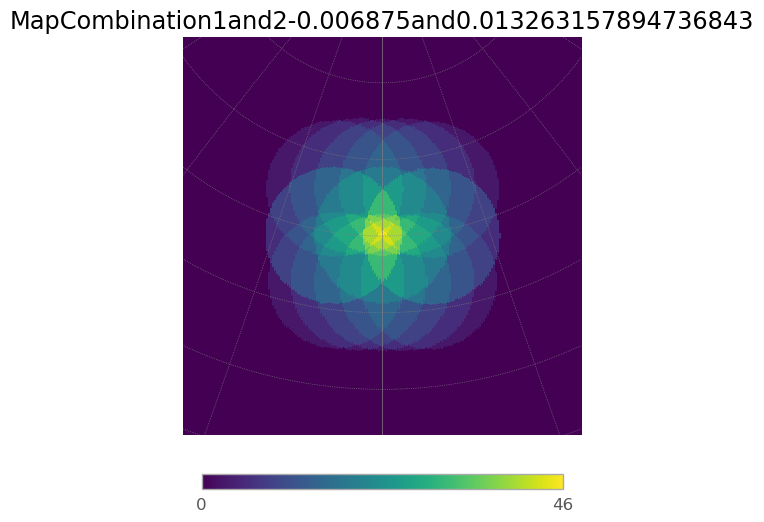

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.85it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.94it/s]
7it [00:00,  7.07it/s]
6it [00:00,  6.99it/s]
7it [00:00,  7.07it/s]
6it [00:00,  7.09it/s]


12.581567644489812


7it [00:00,  7.13it/s]


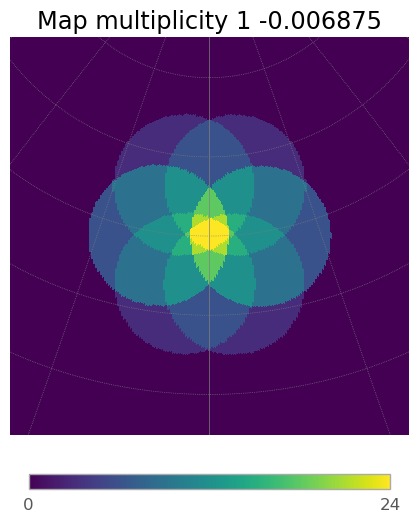

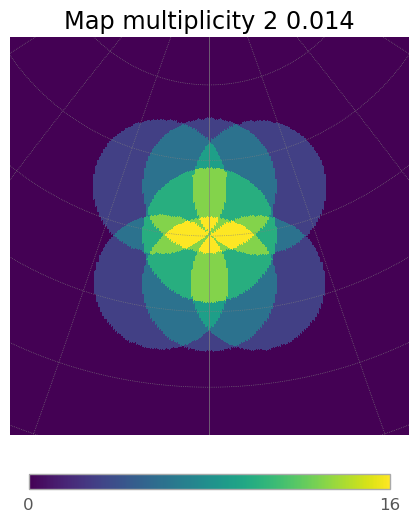

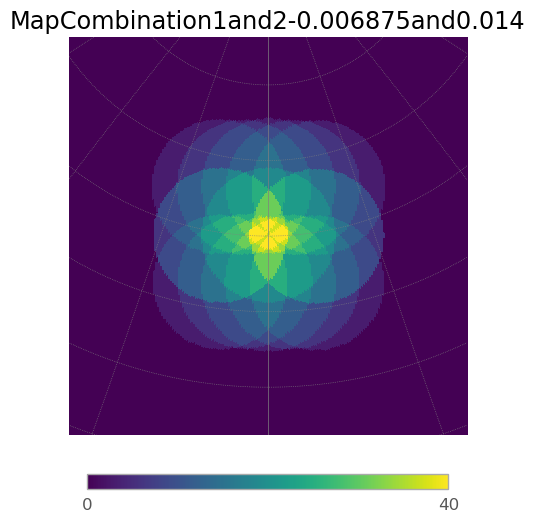

In [59]:
#second best
div=np.linspace(0,0.014, 20)
FoV_second_best=[]
multiplicity_second_best=[]
for divergence in div:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=-0.006875, div2=divergence, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_second_best.append(FoV)
    multiplicity_second_best.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


6it [00:00,  6.81it/s]
7it [00:01,  6.86it/s]
6it [00:00,  6.60it/s]
7it [00:01,  6.96it/s]
6it [00:00,  6.89it/s]
7it [00:00,  7.15it/s]
6it [00:00,  6.73it/s]


9.450044810959682


7it [00:01,  6.96it/s]


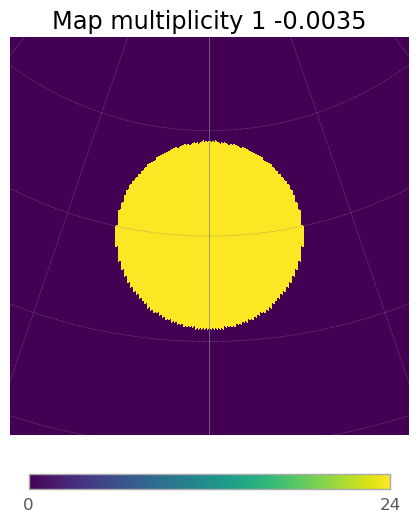

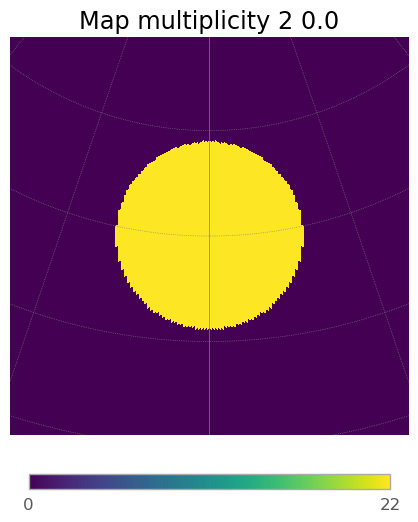

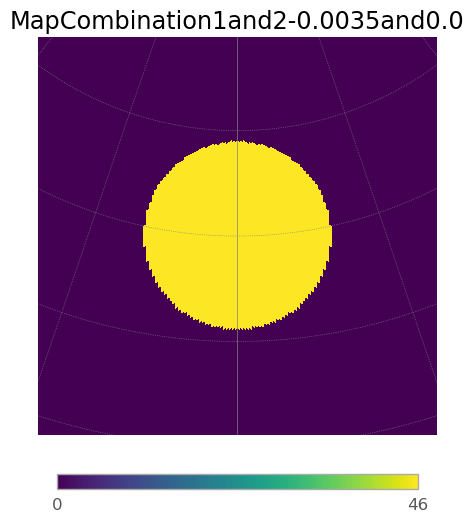

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.64it/s]
7it [00:01,  6.58it/s]
6it [00:01,  5.80it/s]
7it [00:01,  6.68it/s]
6it [00:00,  6.67it/s]
7it [00:01,  6.48it/s]
6it [00:00,  6.42it/s]


11.07872850264112


7it [00:01,  6.51it/s]


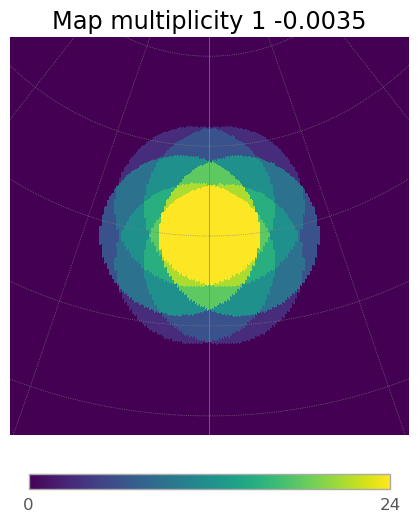

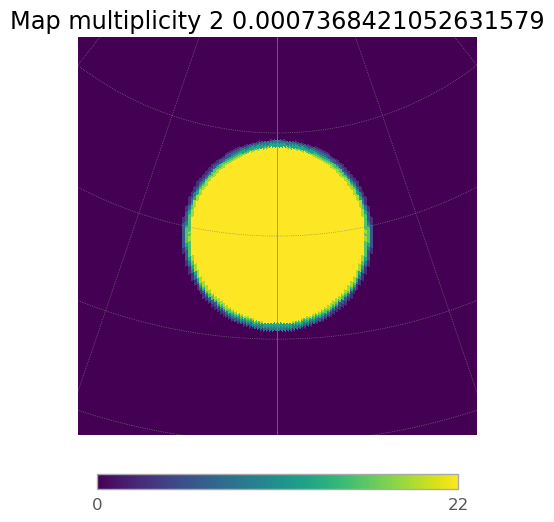

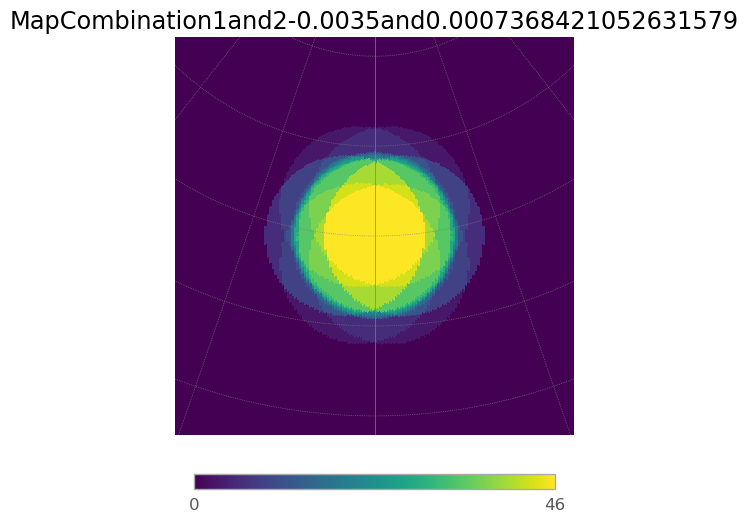

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.43it/s]
7it [00:01,  6.78it/s]
6it [00:00,  6.47it/s]
7it [00:00,  7.05it/s]
6it [00:00,  7.09it/s]
7it [00:00,  7.04it/s]
6it [00:00,  6.70it/s]


11.07872850264112


7it [00:01,  7.00it/s]


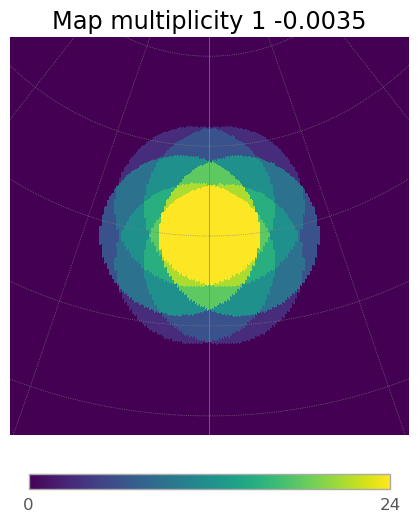

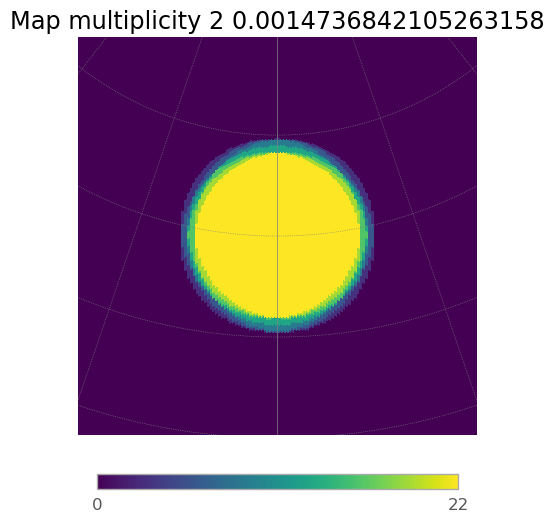

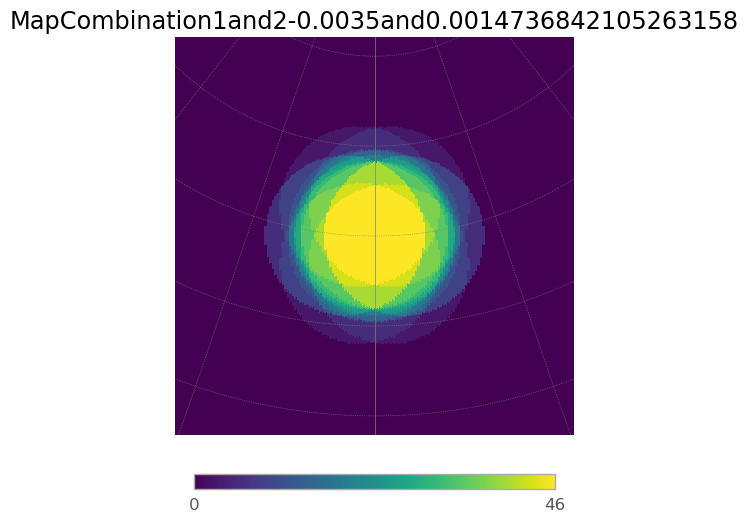

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.95it/s]
7it [00:00,  7.01it/s]
6it [00:00,  6.79it/s]
7it [00:01,  6.88it/s]
6it [00:00,  7.12it/s]
7it [00:00,  7.16it/s]
6it [00:00,  6.84it/s]


11.07872850264112


7it [00:01,  6.87it/s]


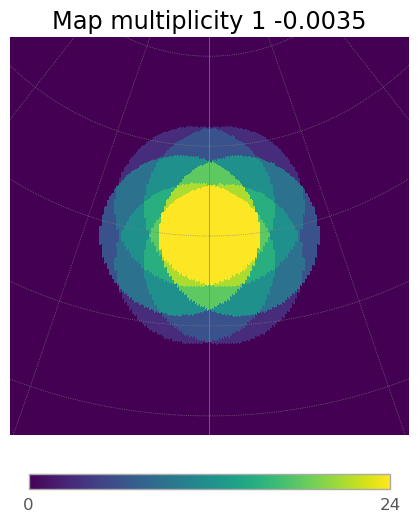

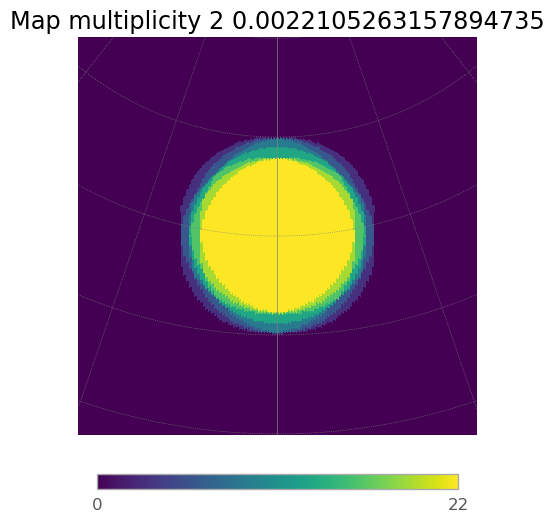

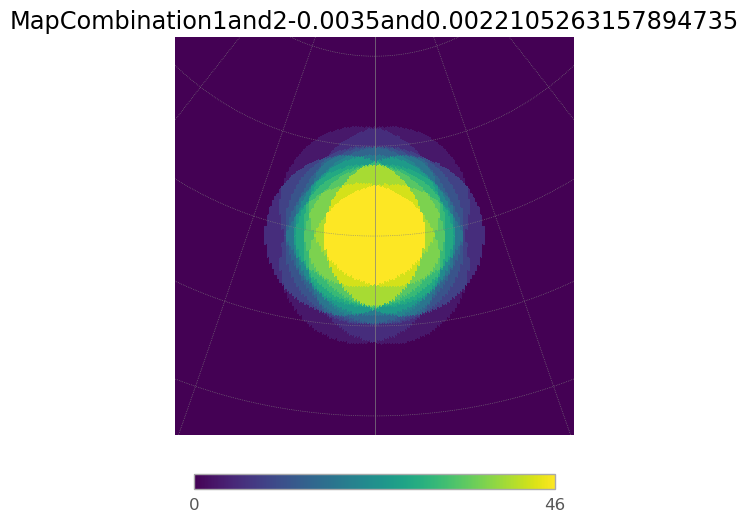

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  7.02it/s]
7it [00:00,  7.14it/s]
6it [00:00,  7.08it/s]
7it [00:01,  6.95it/s]
6it [00:00,  6.96it/s]
7it [00:01,  6.75it/s]
6it [00:00,  6.60it/s]


11.07872850264112


7it [00:01,  6.72it/s]


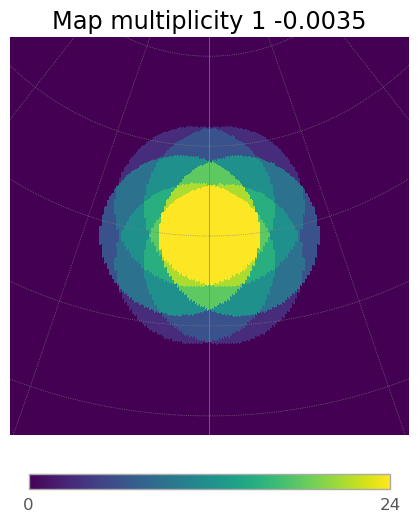

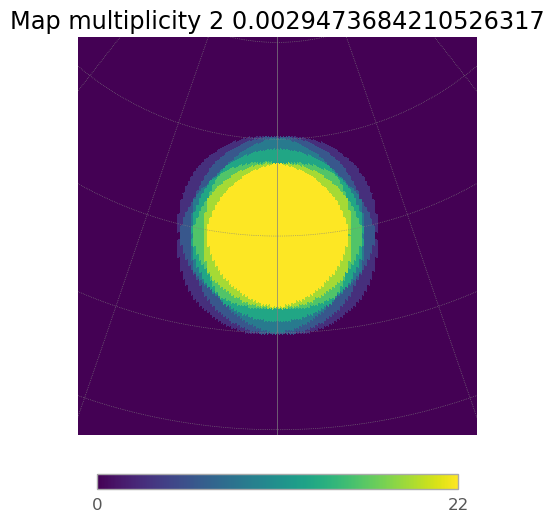

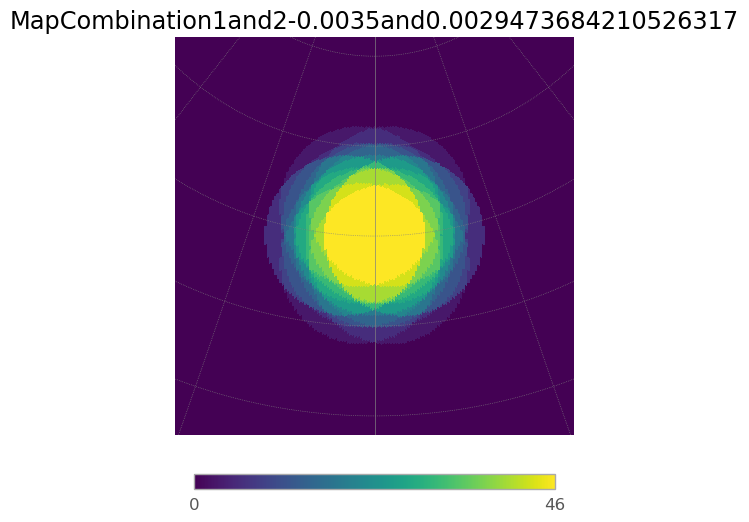

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.45it/s]
7it [00:01,  6.73it/s]
6it [00:00,  6.73it/s]
7it [00:01,  6.62it/s]
6it [00:00,  6.88it/s]
7it [00:01,  6.83it/s]
6it [00:00,  6.60it/s]


11.07872850264112


7it [00:01,  6.75it/s]


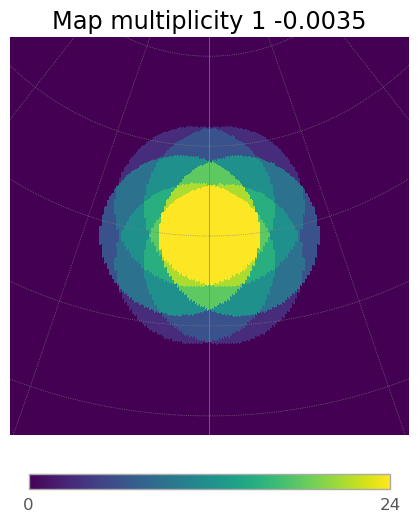

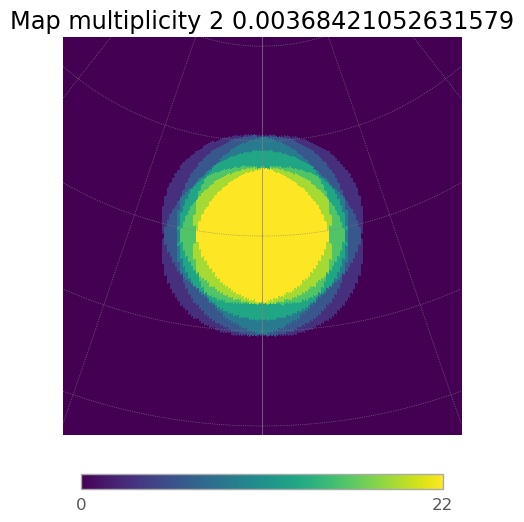

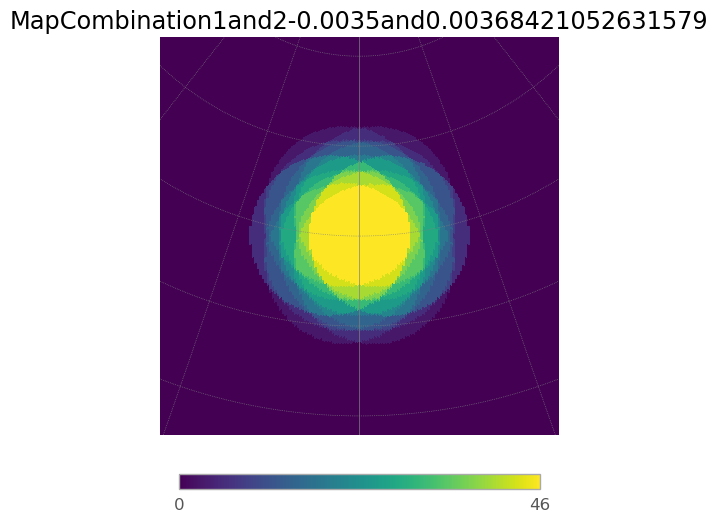

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.47it/s]
7it [00:01,  6.61it/s]
6it [00:00,  6.84it/s]
7it [00:01,  6.80it/s]
6it [00:00,  7.16it/s]
7it [00:00,  7.15it/s]
6it [00:00,  6.88it/s]


11.07872850264112


7it [00:00,  7.02it/s]


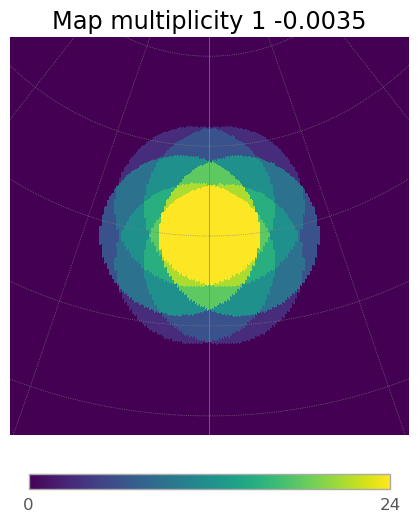

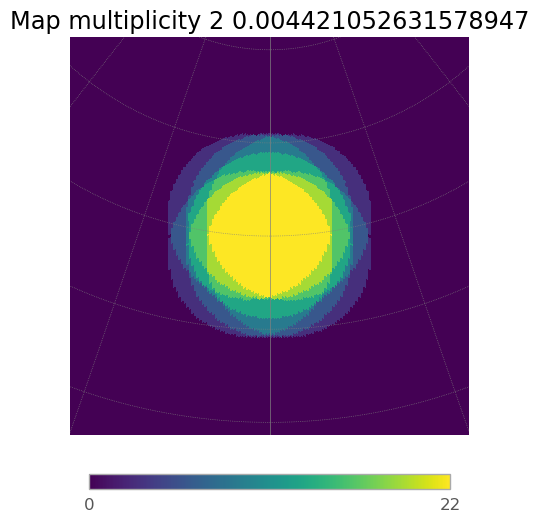

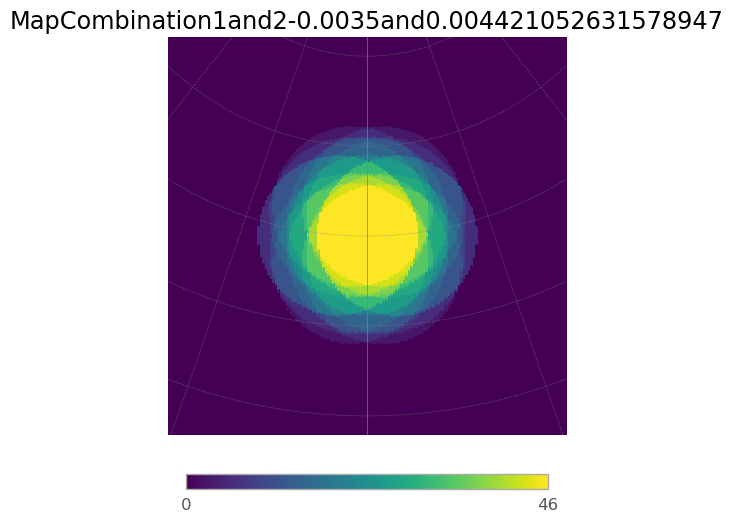

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.88it/s]
7it [00:01,  6.49it/s]
6it [00:00,  6.07it/s]
7it [00:01,  6.09it/s]
6it [00:01,  5.75it/s]
7it [00:01,  6.07it/s]
6it [00:01,  5.67it/s]


11.07872850264112


7it [00:01,  6.09it/s]


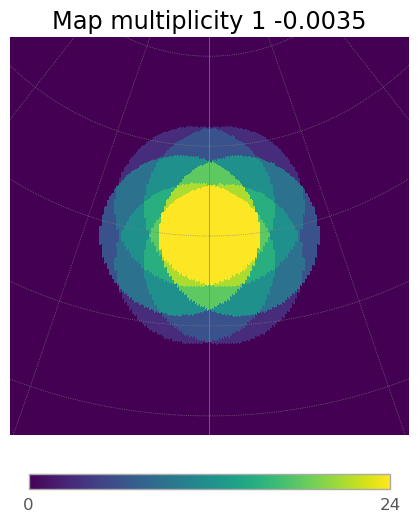

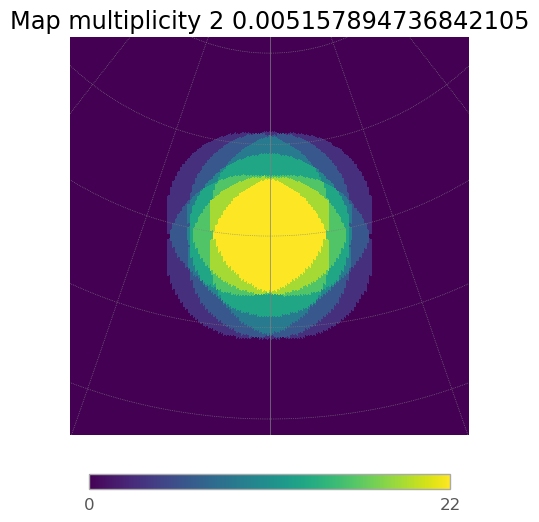

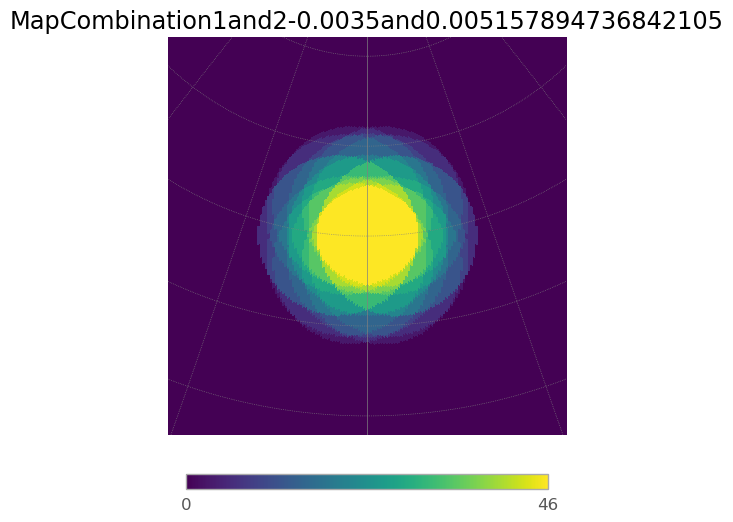

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.85it/s]
7it [00:01,  5.85it/s]
6it [00:01,  5.47it/s]
7it [00:01,  5.86it/s]
6it [00:01,  5.94it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.73it/s]


11.07872850264112


7it [00:01,  5.90it/s]


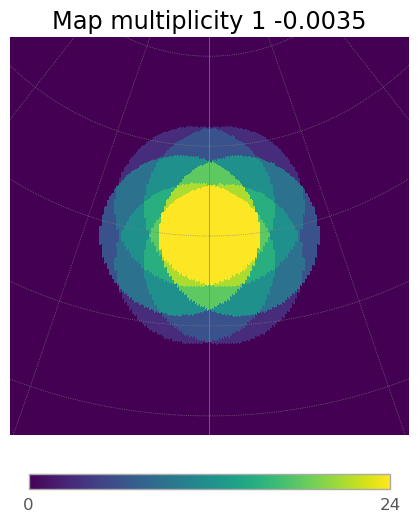

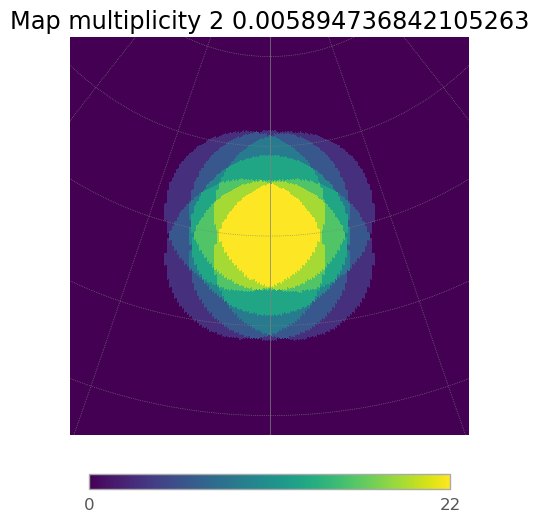

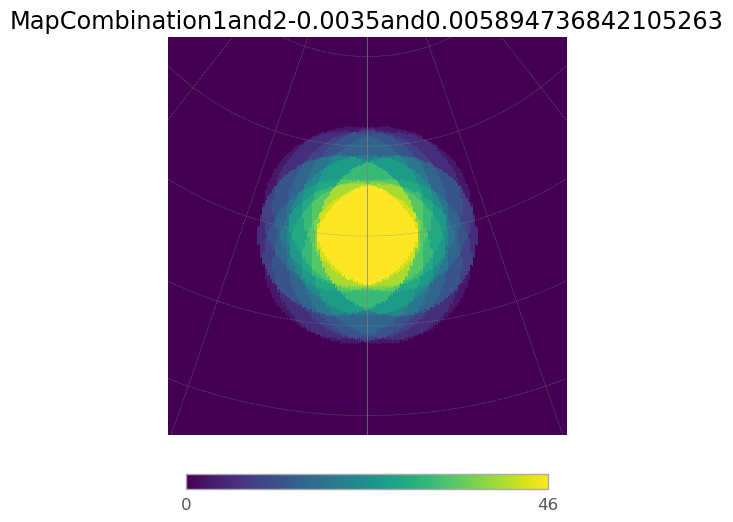

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.94it/s]
7it [00:01,  6.01it/s]
6it [00:01,  5.70it/s]
7it [00:01,  6.11it/s]
6it [00:00,  6.12it/s]
7it [00:01,  5.99it/s]
6it [00:01,  5.71it/s]


11.07872850264112


7it [00:01,  5.70it/s]


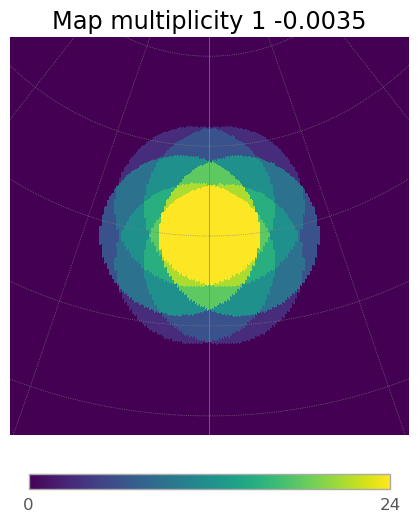

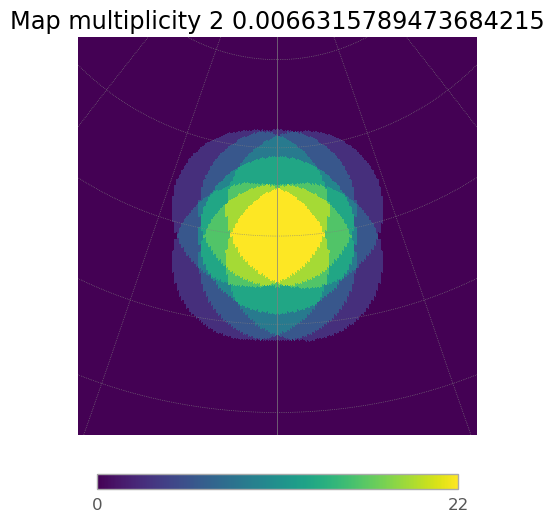

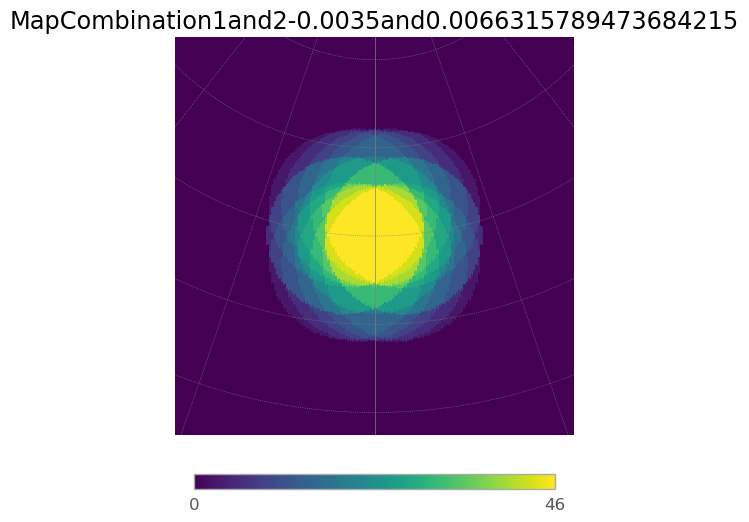

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.95it/s]
7it [00:01,  5.38it/s]
6it [00:01,  5.64it/s]
7it [00:01,  5.82it/s]
6it [00:00,  6.03it/s]
7it [00:01,  6.08it/s]
6it [00:01,  5.49it/s]


11.07872850264112


7it [00:01,  6.18it/s]


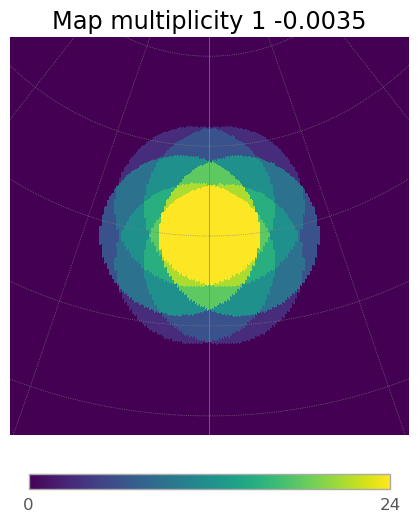

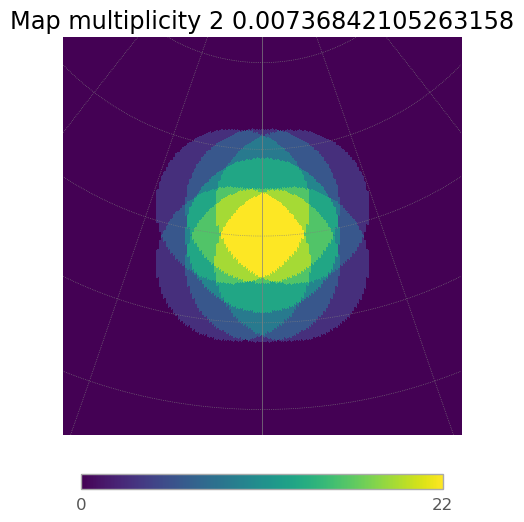

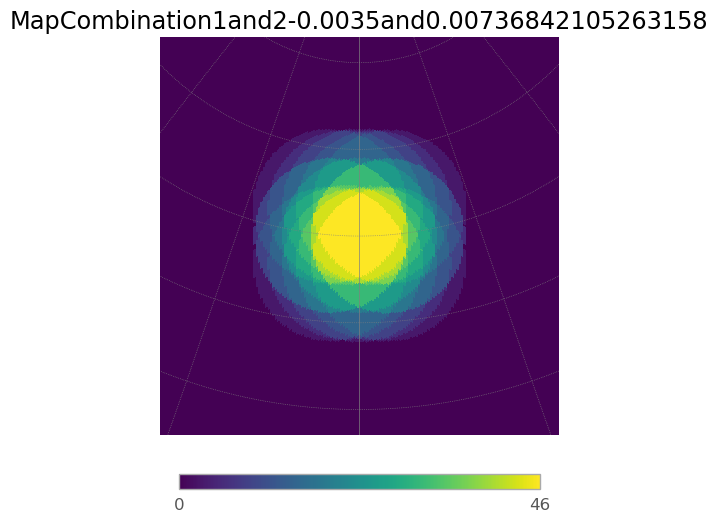

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.37it/s]
7it [00:01,  5.79it/s]
6it [00:01,  5.79it/s]
7it [00:01,  5.95it/s]
6it [00:00,  6.06it/s]
7it [00:01,  5.18it/s]
6it [00:01,  5.67it/s]


11.07872850264112


7it [00:01,  6.03it/s]


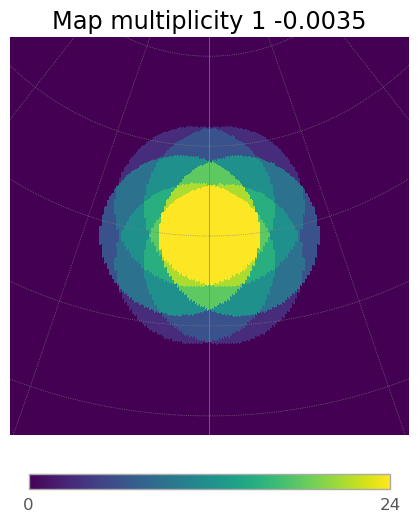

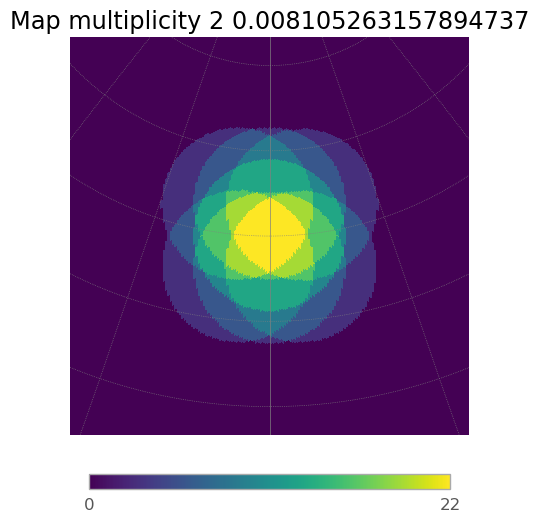

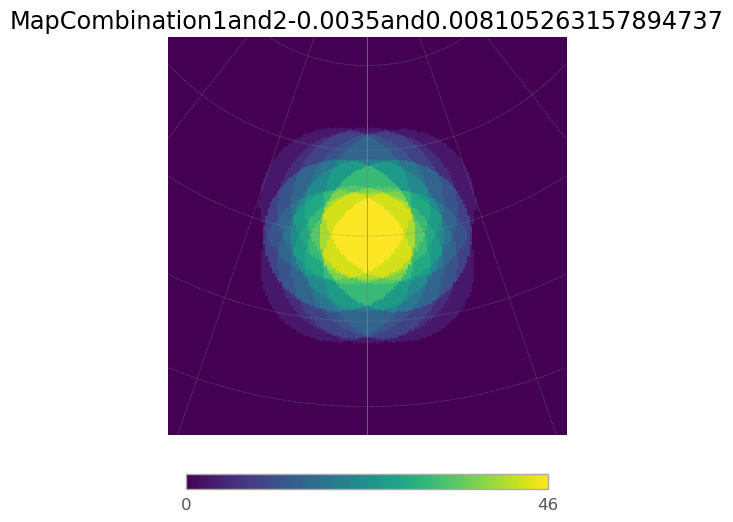

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.89it/s]
7it [00:01,  5.83it/s]
6it [00:01,  5.83it/s]
7it [00:01,  6.08it/s]
6it [00:00,  6.14it/s]
7it [00:01,  6.06it/s]
6it [00:01,  5.62it/s]


11.07872850264112


7it [00:01,  5.87it/s]


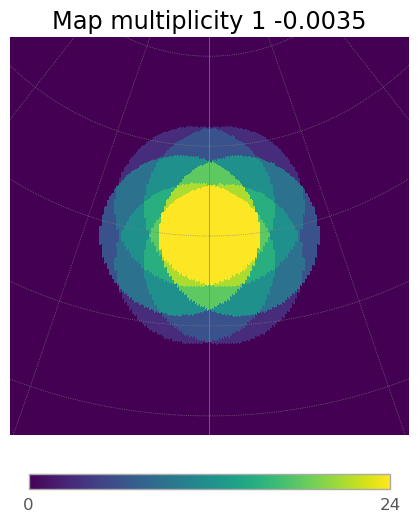

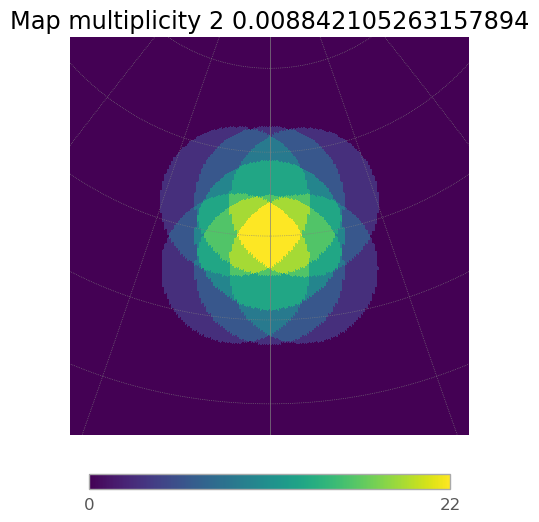

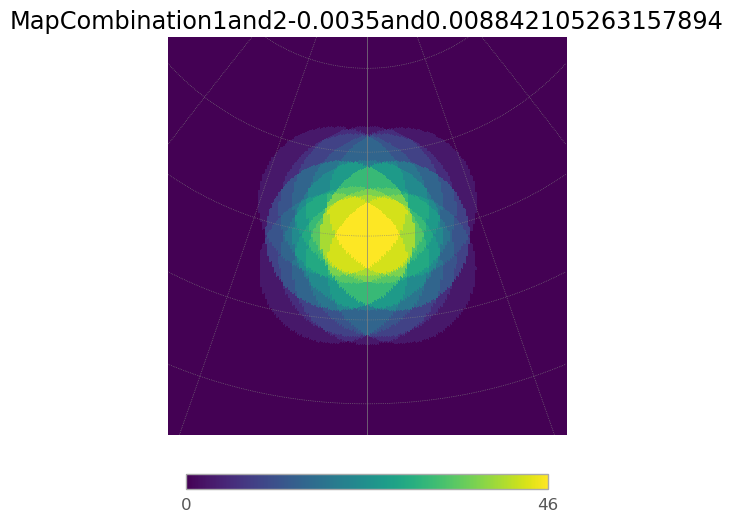

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.77it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.95it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.59it/s]
6it [00:01,  5.44it/s]


11.07872850264112


7it [00:01,  5.30it/s]


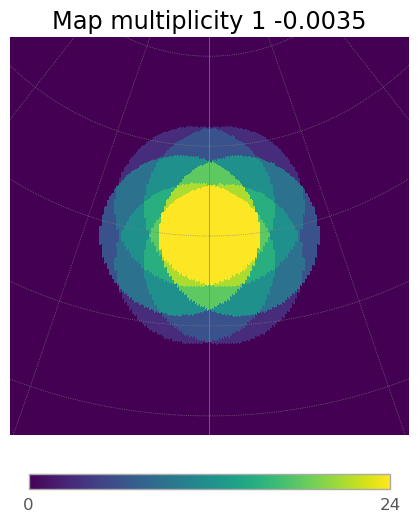

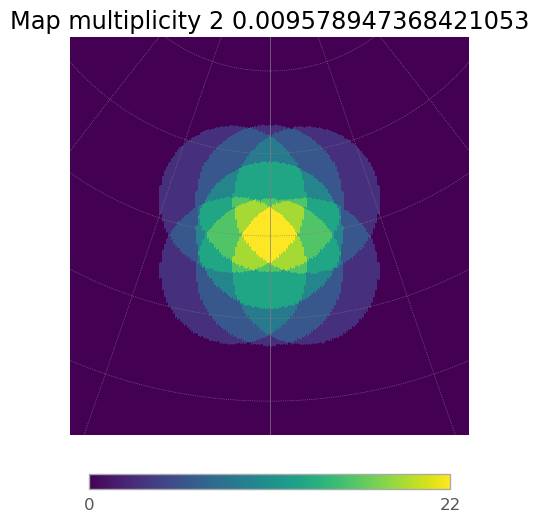

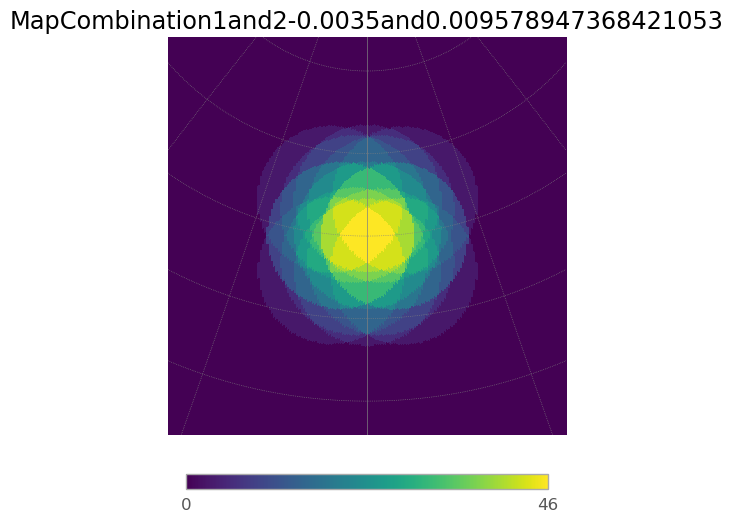

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.43it/s]
7it [00:01,  5.85it/s]
6it [00:01,  5.56it/s]
7it [00:01,  5.76it/s]
6it [00:01,  5.82it/s]
7it [00:01,  5.95it/s]
6it [00:01,  5.10it/s]


11.07872850264112


7it [00:01,  5.51it/s]


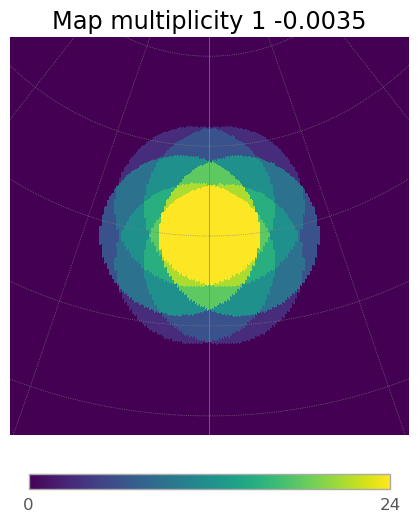

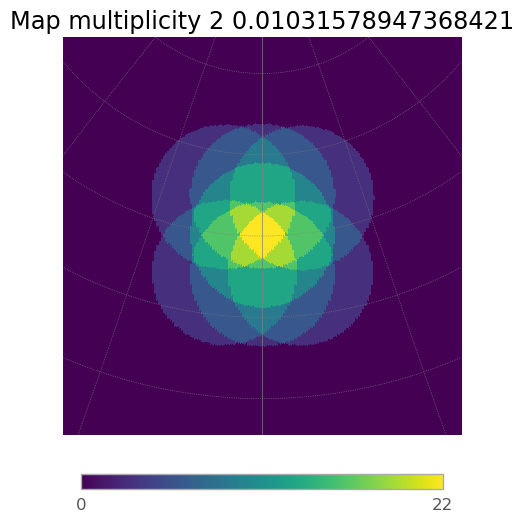

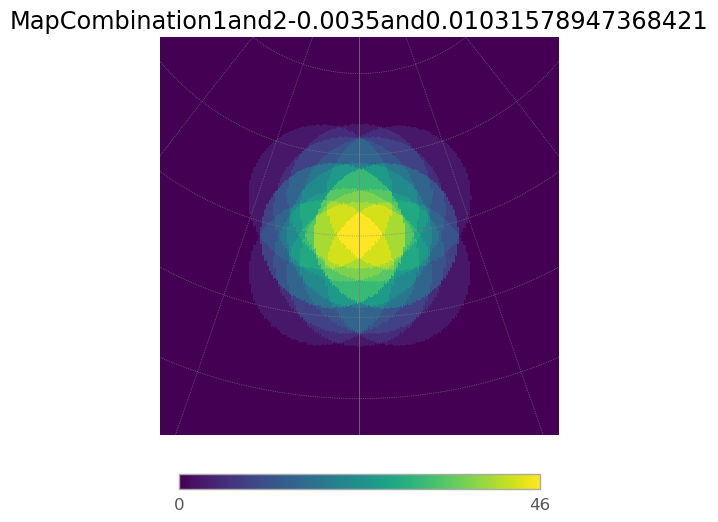

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.19it/s]
7it [00:01,  5.51it/s]
6it [00:01,  5.65it/s]
7it [00:01,  5.72it/s]
6it [00:01,  5.48it/s]
7it [00:01,  5.09it/s]
6it [00:01,  5.37it/s]


11.07872850264112


7it [00:01,  5.49it/s]


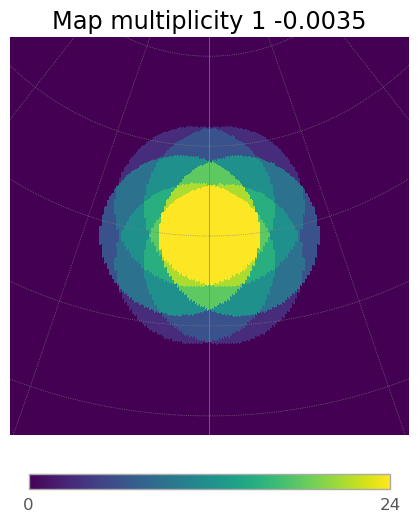

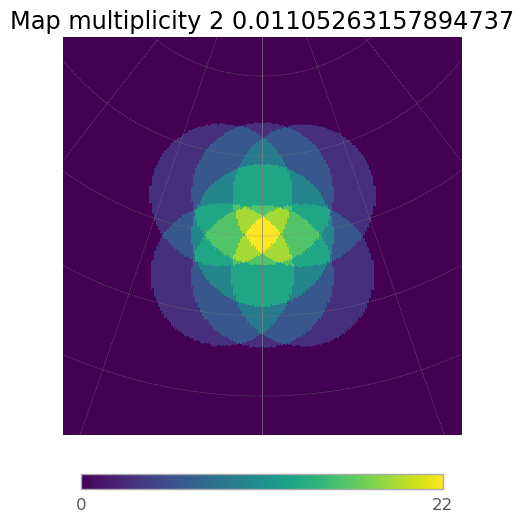

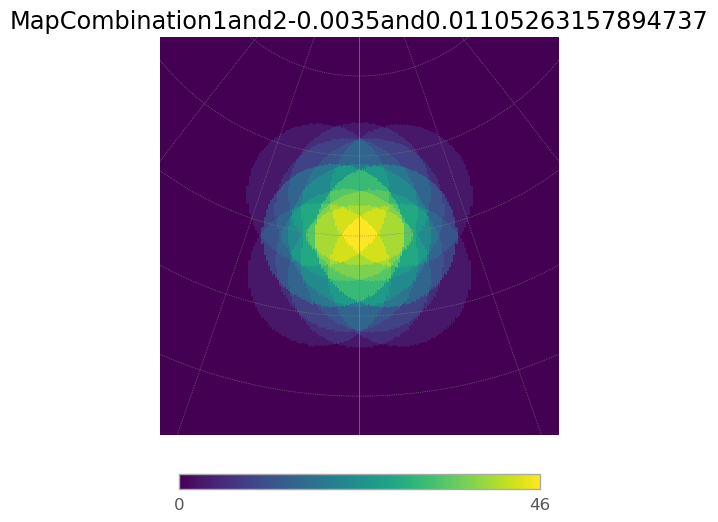

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.39it/s]
7it [00:01,  5.90it/s]
6it [00:01,  5.61it/s]
7it [00:01,  5.98it/s]
6it [00:01,  5.73it/s]
7it [00:01,  6.01it/s]
6it [00:01,  4.60it/s]


11.07872850264112


7it [00:01,  5.82it/s]


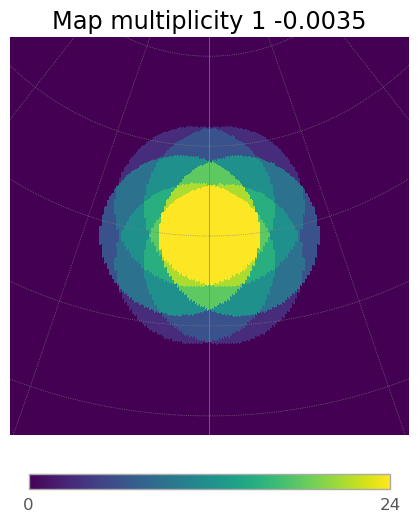

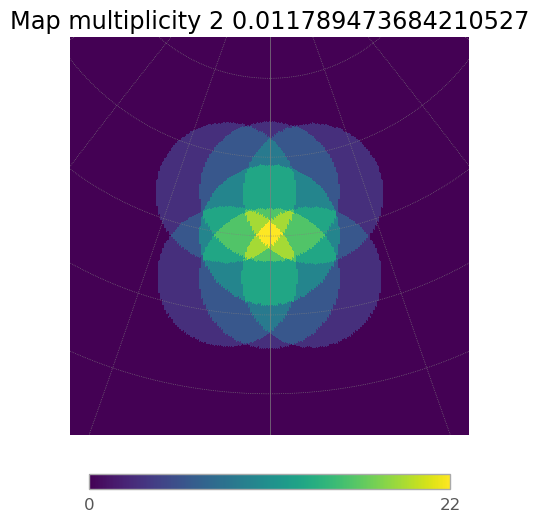

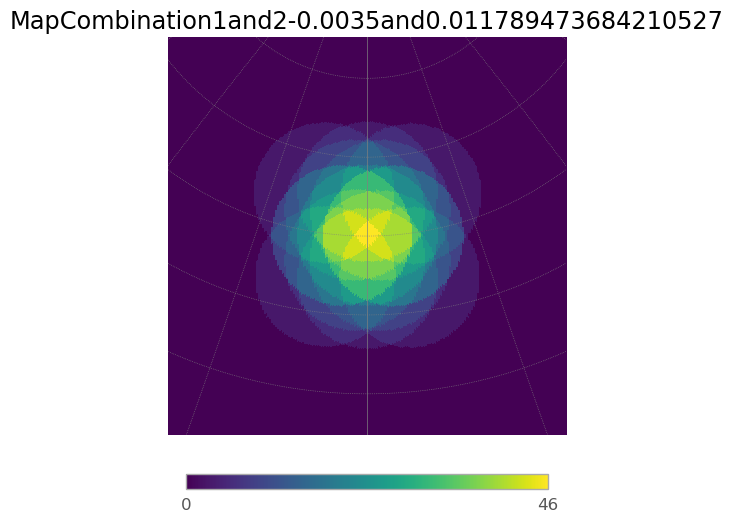

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.32it/s]
7it [00:01,  5.77it/s]
6it [00:01,  5.80it/s]
7it [00:01,  5.81it/s]
6it [00:01,  5.92it/s]
7it [00:01,  5.97it/s]
6it [00:01,  5.16it/s]


11.07872850264112


7it [00:01,  5.90it/s]


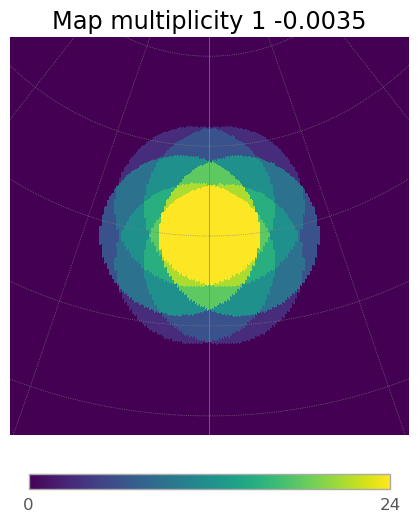

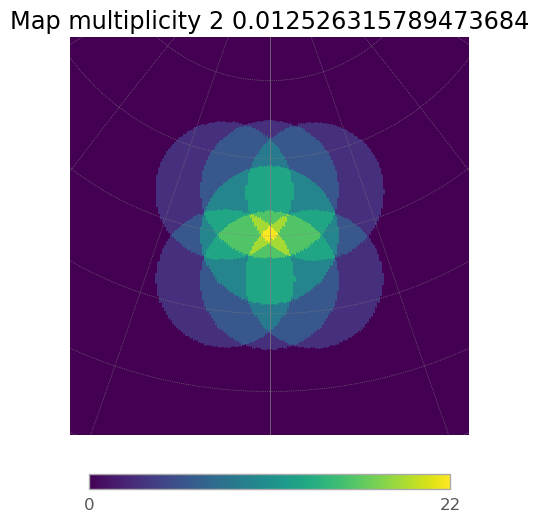

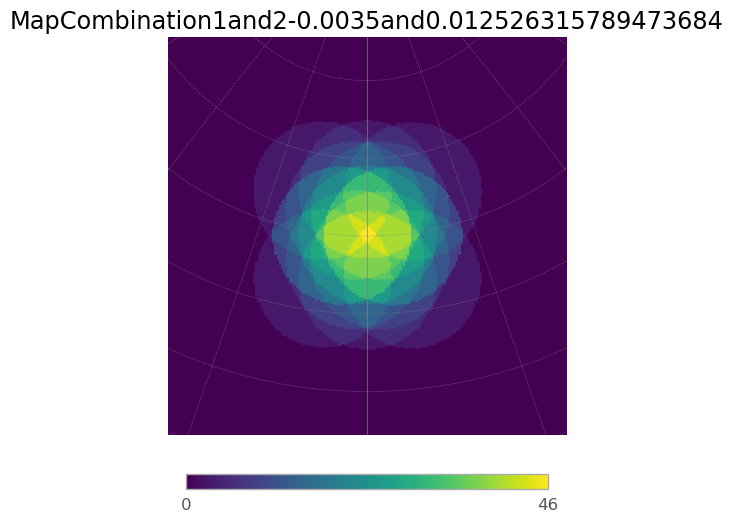

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.38it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.85it/s]
7it [00:01,  5.85it/s]
6it [00:01,  5.89it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.34it/s]


11.07872850264112


7it [00:01,  5.98it/s]


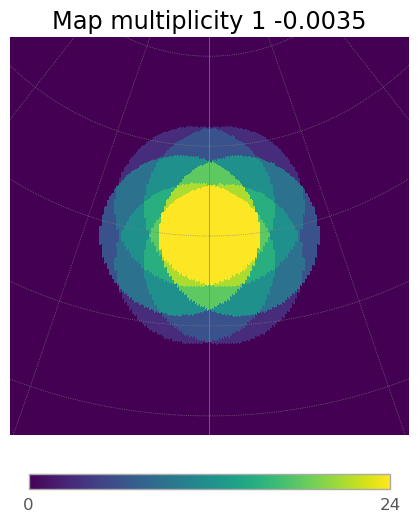

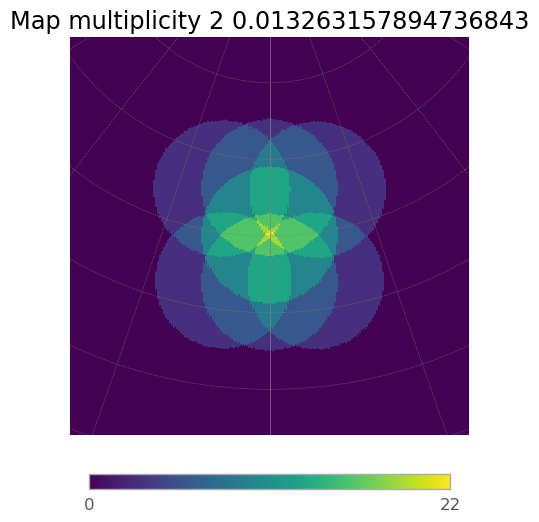

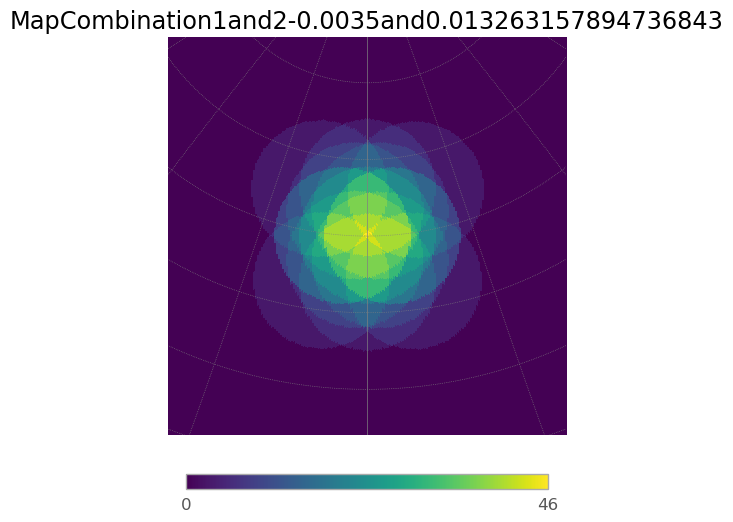

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.90it/s]
7it [00:01,  5.16it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.49it/s]
6it [00:01,  5.64it/s]
7it [00:01,  5.52it/s]
6it [00:01,  5.59it/s]


11.07872850264112


7it [00:01,  5.52it/s]


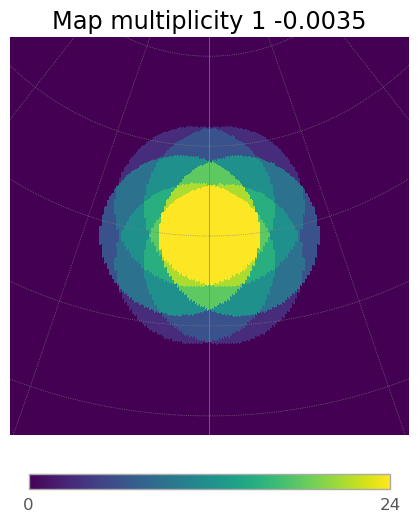

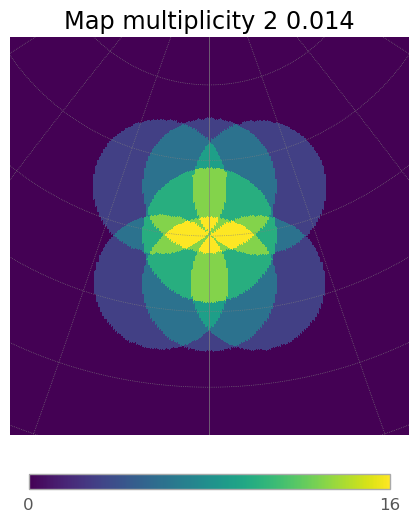

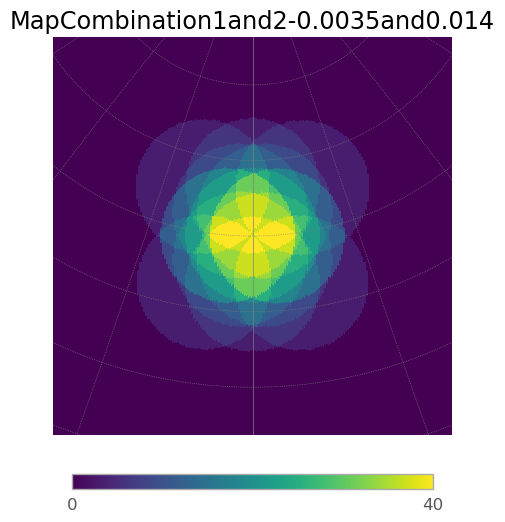

In [60]:
#NOT ENOUGH DIV 
FoV_not_enough=[]
multiplicity_not_enough=[]
for divergence in div:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=-0.0035, div2=divergence, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_not_enough.append(FoV)
    multiplicity_not_enough.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.16it/s]
7it [00:01,  5.35it/s]
6it [00:01,  5.24it/s]
7it [00:01,  5.40it/s]
6it [00:01,  5.45it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.09it/s]


13.07274650697345


7it [00:01,  5.59it/s]


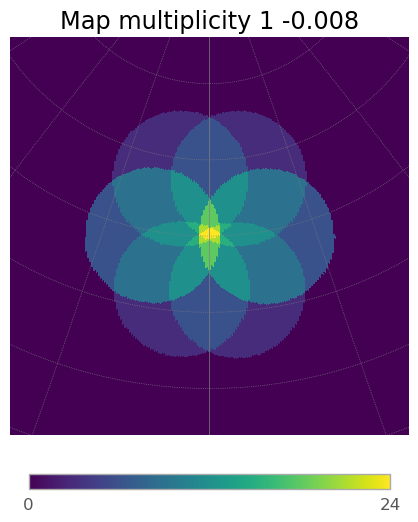

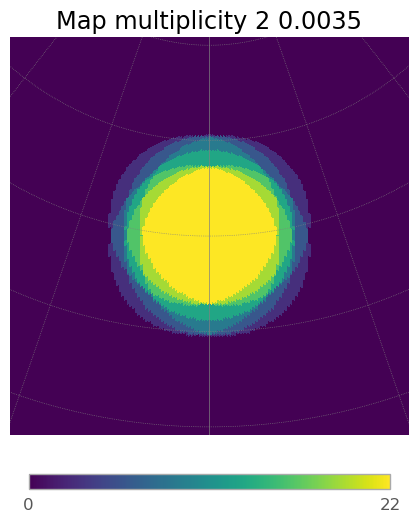

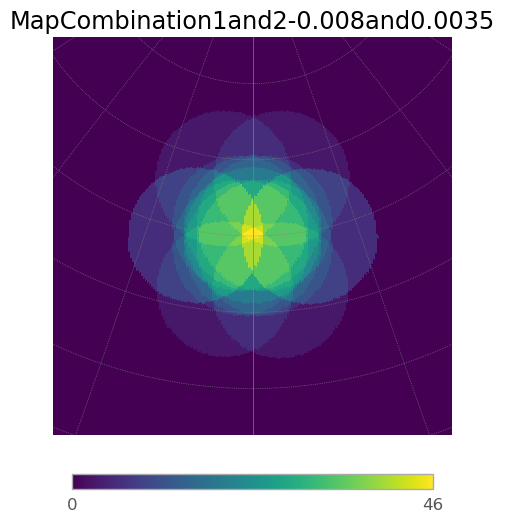

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.16it/s]
7it [00:01,  5.39it/s]
6it [00:01,  5.43it/s]
7it [00:01,  5.36it/s]
6it [00:01,  5.78it/s]
7it [00:01,  5.53it/s]
6it [00:01,  5.38it/s]


12.92400673955597


7it [00:01,  4.81it/s]


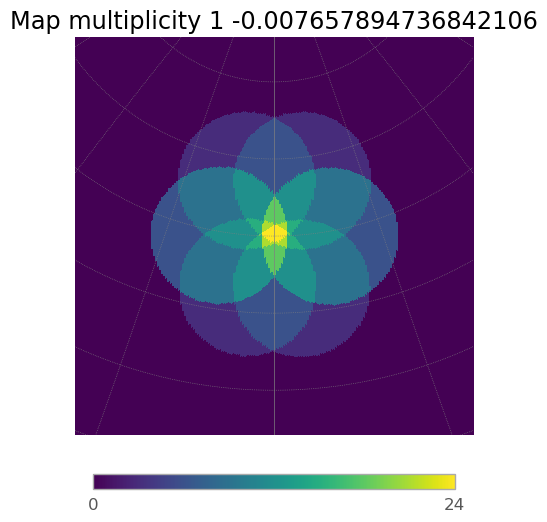

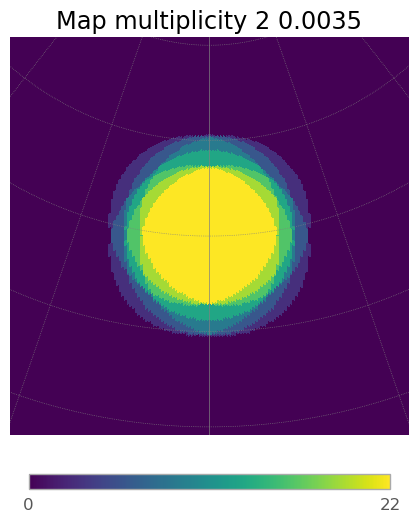

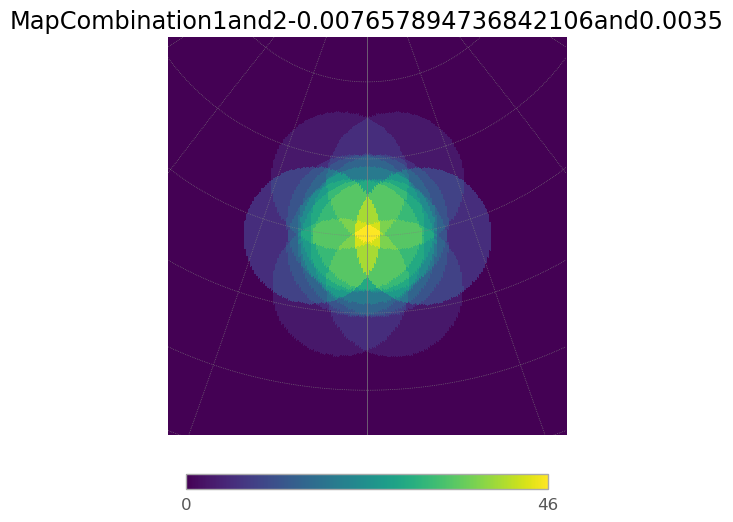

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.61it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.45it/s]
7it [00:01,  5.90it/s]
6it [00:01,  5.60it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.68it/s]


12.777253173559846


7it [00:01,  5.79it/s]


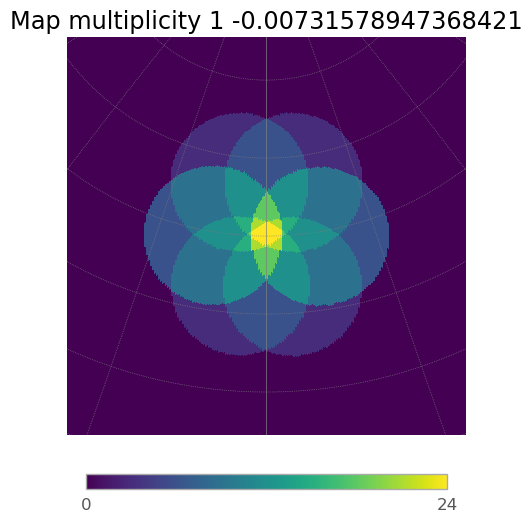

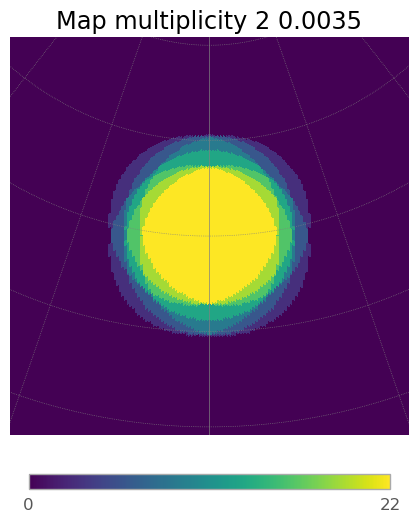

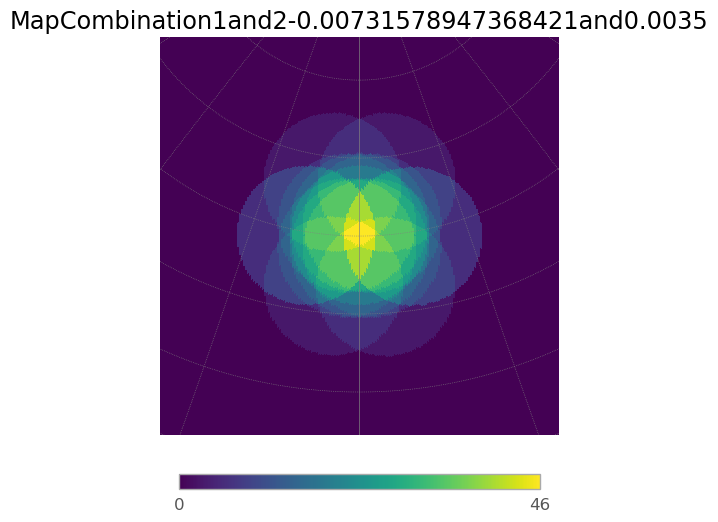

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.51it/s]
7it [00:01,  5.72it/s]
6it [00:01,  5.50it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.71it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.65it/s]


12.627950271658865


7it [00:01,  5.89it/s]


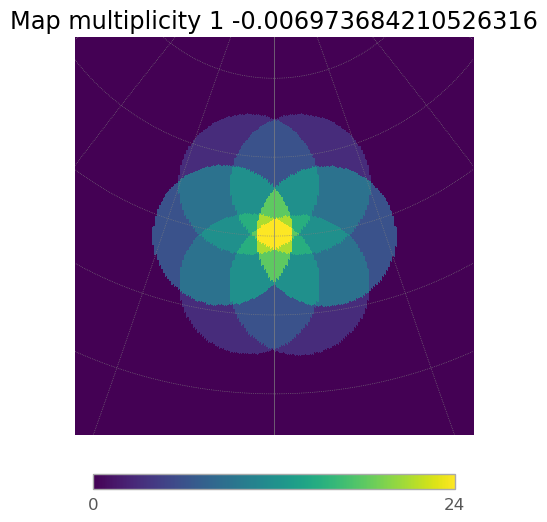

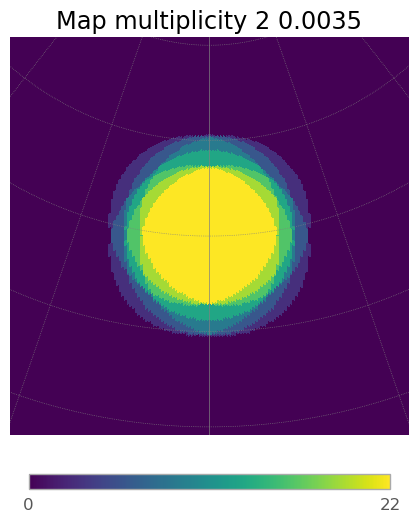

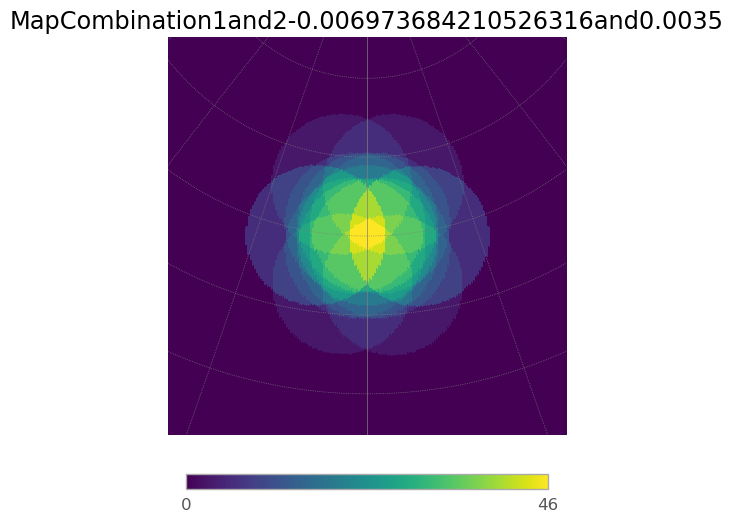

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.61it/s]
7it [00:01,  5.83it/s]
6it [00:01,  5.78it/s]
7it [00:01,  5.63it/s]
6it [00:01,  5.85it/s]
7it [00:01,  5.79it/s]
6it [00:01,  5.44it/s]


12.477899317404567


7it [00:01,  5.77it/s]


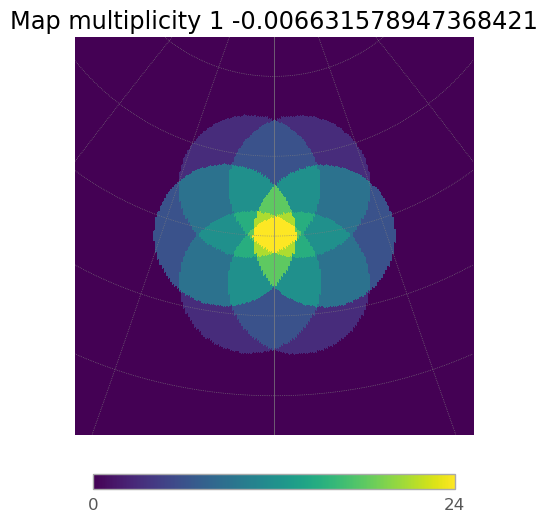

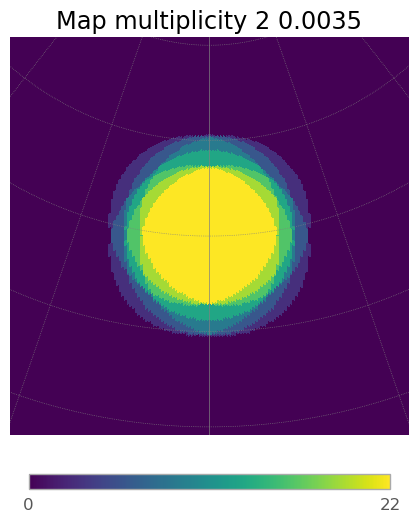

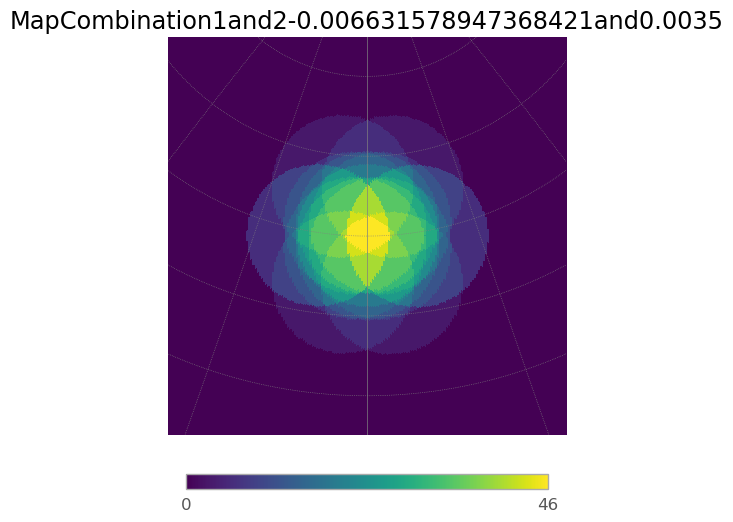

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.08it/s]
7it [00:01,  5.53it/s]
6it [00:01,  5.34it/s]
7it [00:01,  5.62it/s]
6it [00:01,  5.60it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.37it/s]


12.325629936598338


7it [00:01,  5.70it/s]


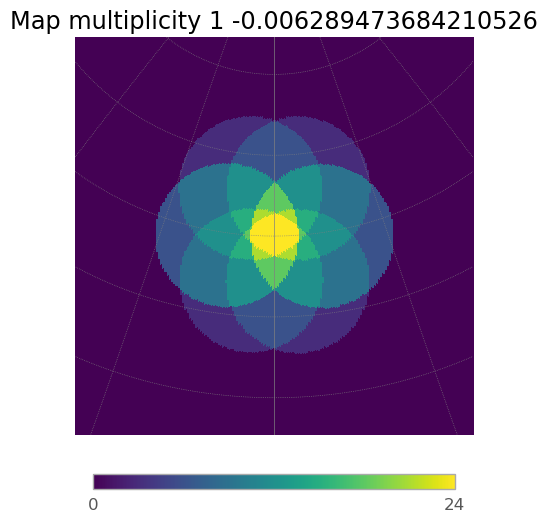

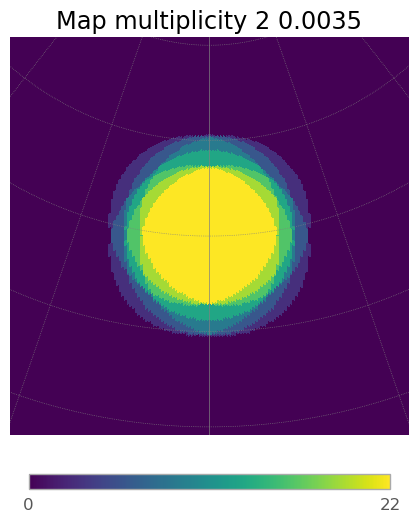

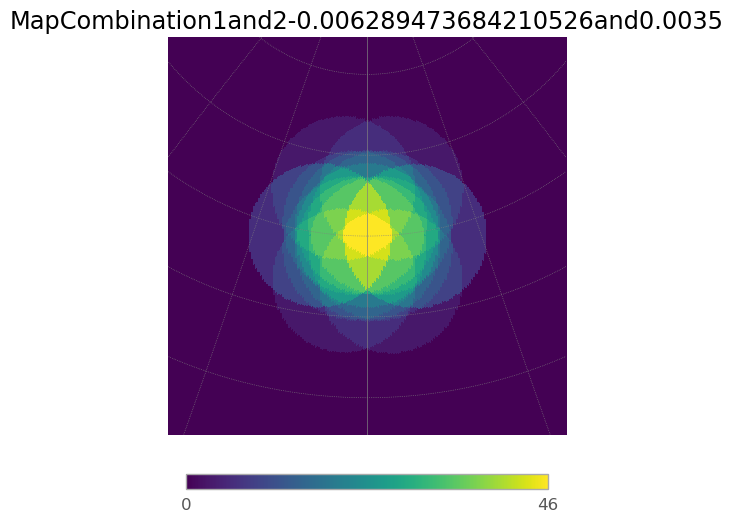

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.62it/s]
7it [00:01,  5.85it/s]
6it [00:01,  5.56it/s]
7it [00:01,  5.78it/s]
6it [00:01,  5.83it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.67it/s]


12.174201697236496


7it [00:01,  5.91it/s]


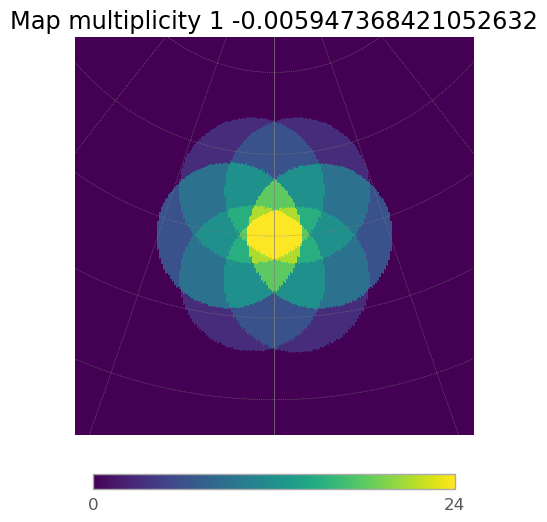

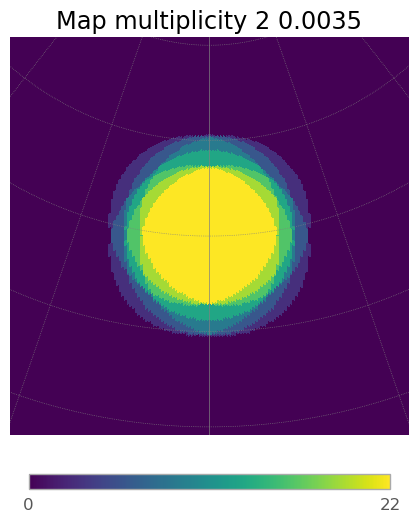

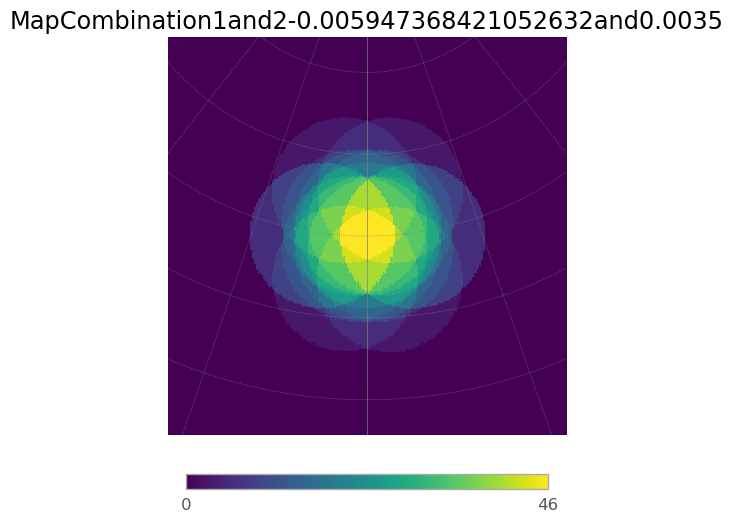

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.73it/s]
7it [00:01,  5.81it/s]
6it [00:01,  5.76it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.96it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.55it/s]


12.02129132297544


7it [00:01,  5.95it/s]


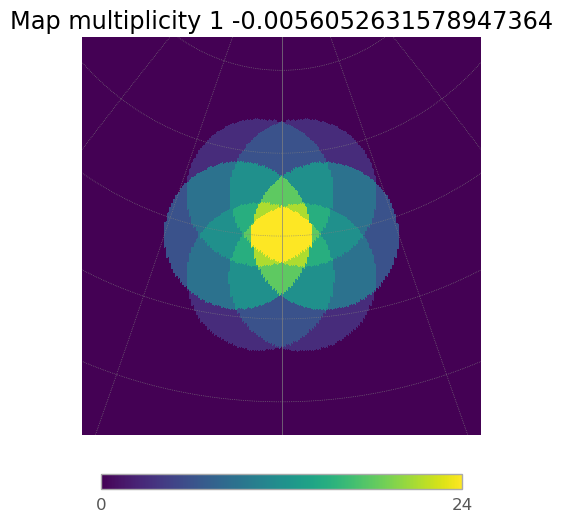

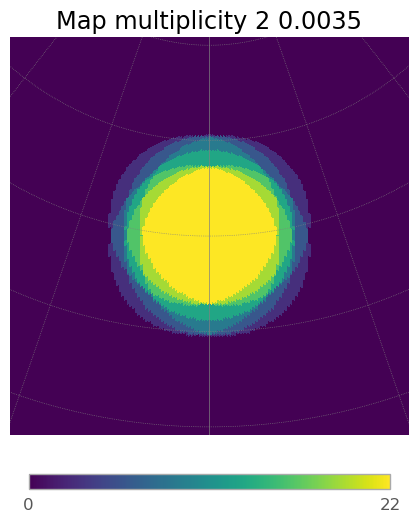

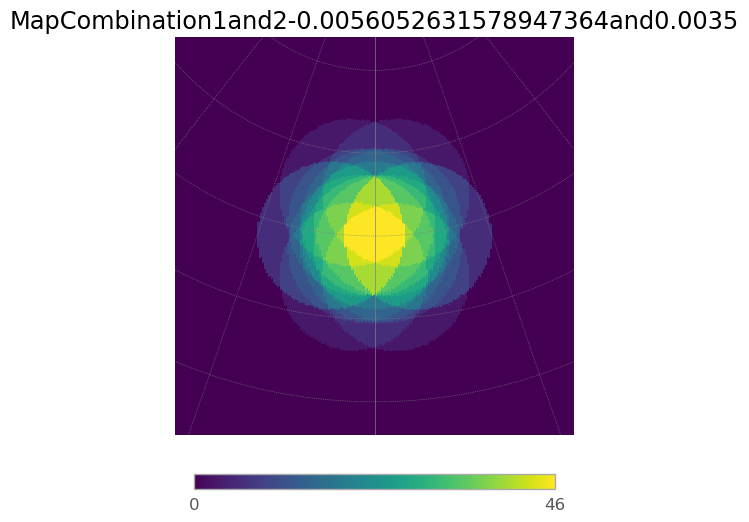

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.80it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.64it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.24it/s]
7it [00:01,  5.74it/s]
6it [00:01,  5.77it/s]


11.872876079129934


7it [00:01,  5.81it/s]


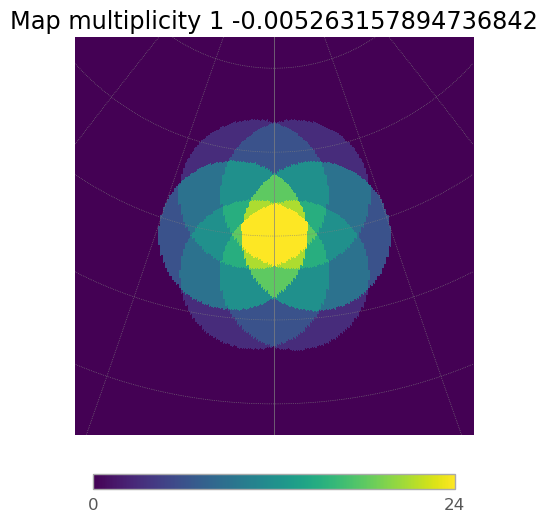

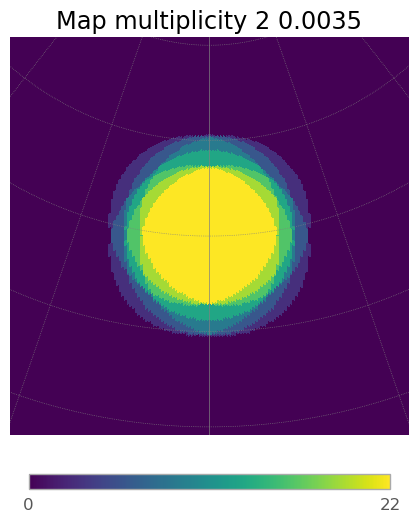

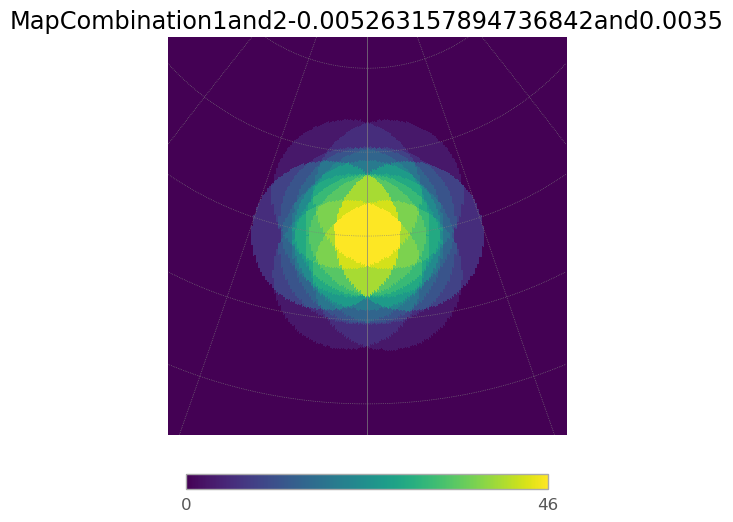

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.80it/s]
7it [00:01,  6.01it/s]
6it [00:01,  5.69it/s]
7it [00:01,  5.53it/s]
6it [00:01,  5.53it/s]
7it [00:01,  6.05it/s]
6it [00:01,  5.63it/s]


11.718078320078305


7it [00:01,  5.63it/s]


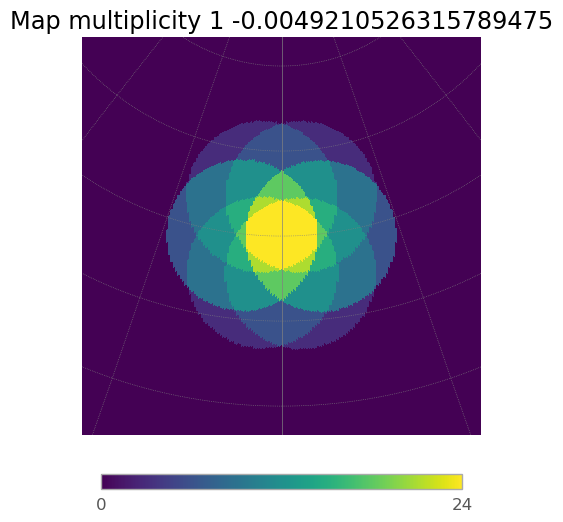

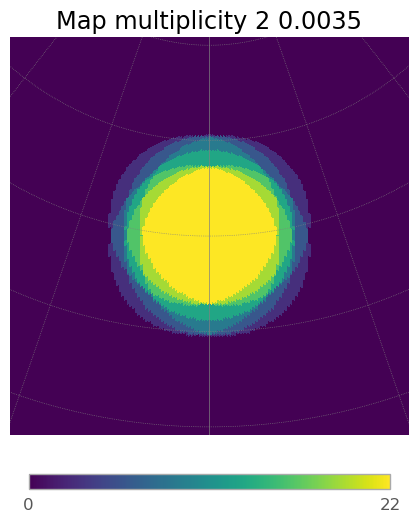

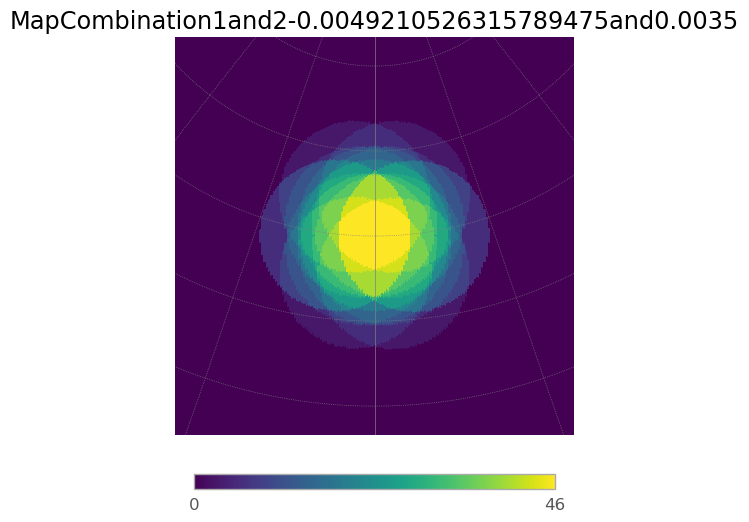

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.73it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.24it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.86it/s]
7it [00:01,  5.96it/s]
6it [00:01,  5.40it/s]


11.560264906130477


7it [00:01,  5.80it/s]


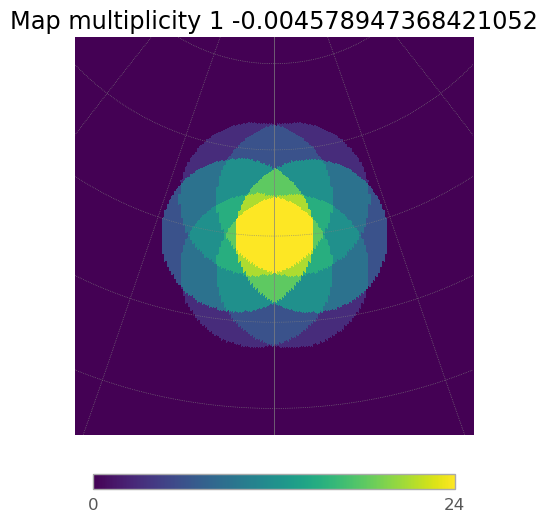

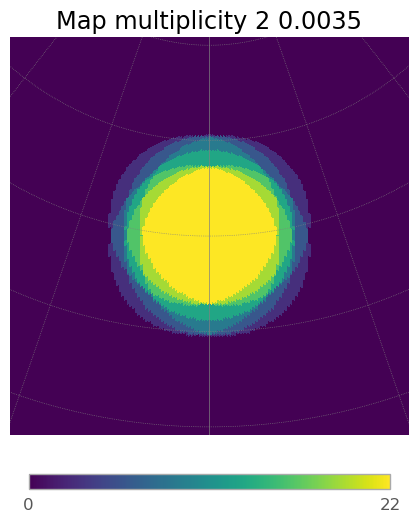

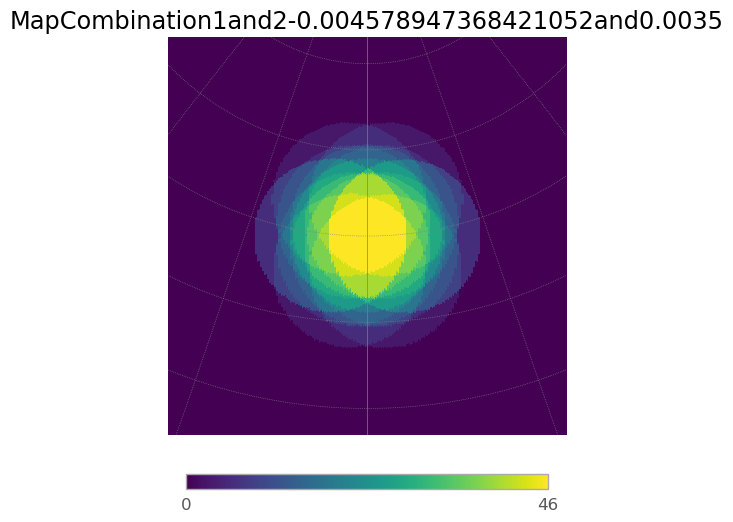

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.40it/s]
7it [00:01,  5.59it/s]
6it [00:01,  4.63it/s]
7it [00:01,  4.17it/s]
6it [00:01,  4.44it/s]
7it [00:01,  5.02it/s]
6it [00:01,  3.41it/s]


11.410943652822338


7it [00:01,  5.05it/s]


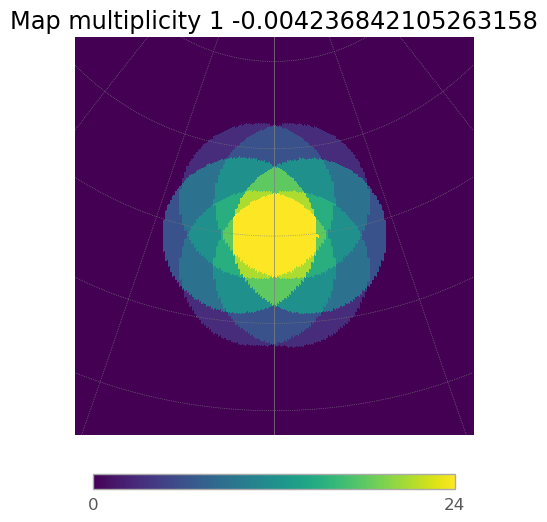

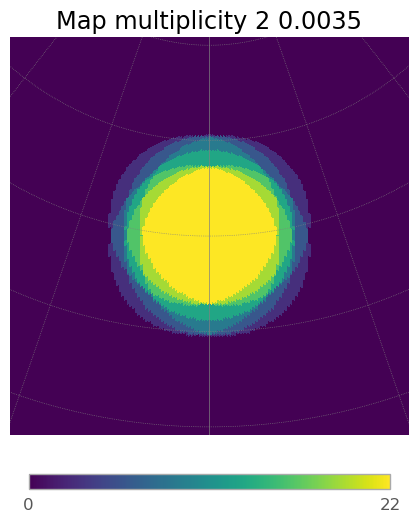

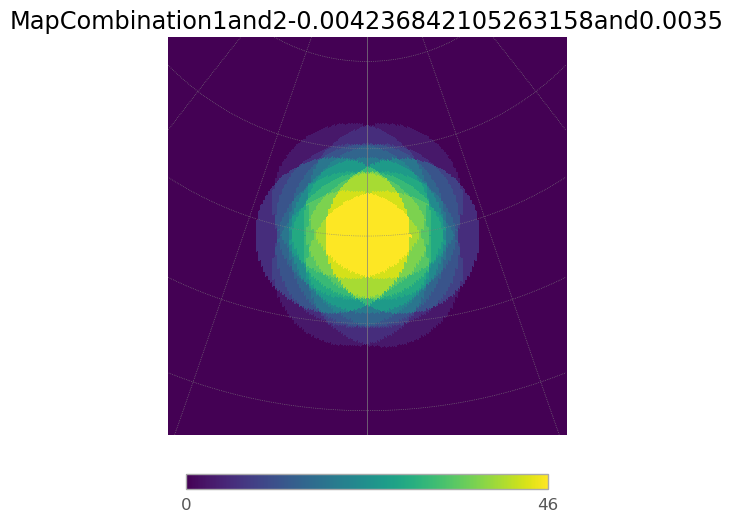

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.27it/s]
7it [00:01,  4.88it/s]
6it [00:01,  4.06it/s]
7it [00:01,  5.20it/s]
6it [00:01,  5.31it/s]
7it [00:01,  5.07it/s]
6it [00:01,  5.05it/s]


11.255058166276156


7it [00:01,  5.72it/s]


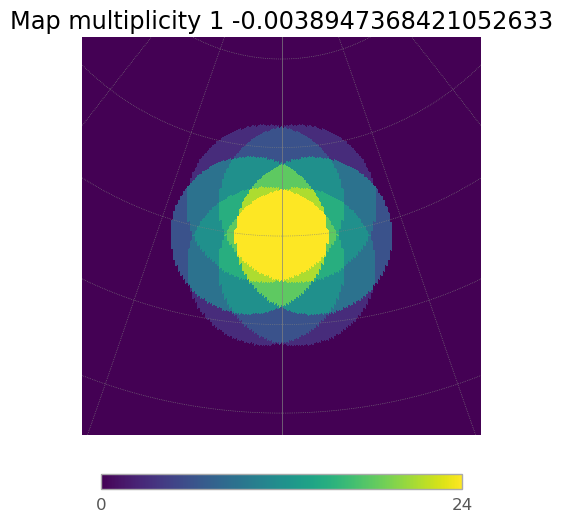

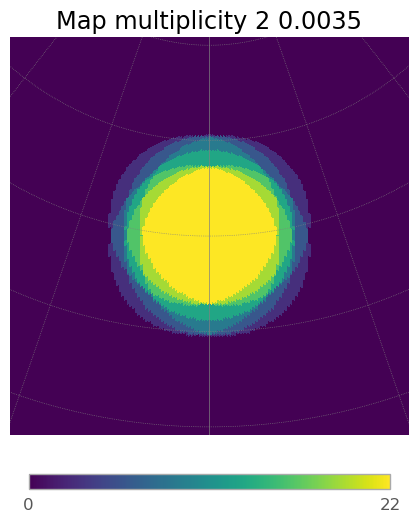

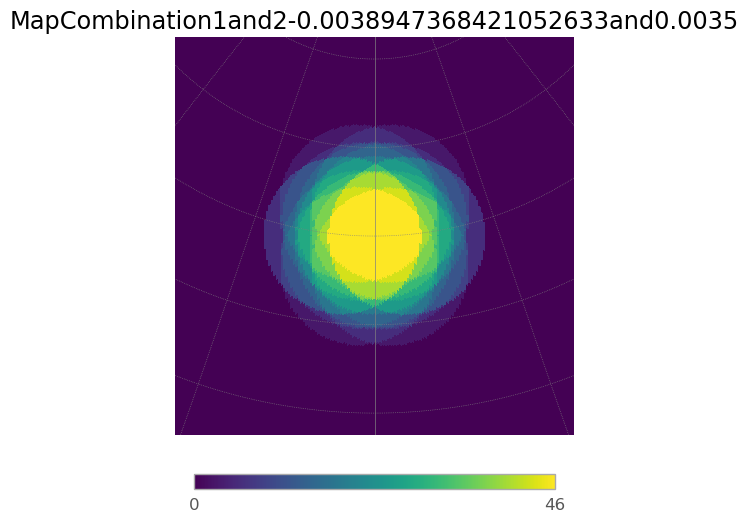

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.24it/s]
7it [00:01,  5.10it/s]
6it [00:01,  5.52it/s]
7it [00:01,  5.75it/s]
6it [00:01,  5.68it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.58it/s]


11.099979267606752


7it [00:01,  5.22it/s]


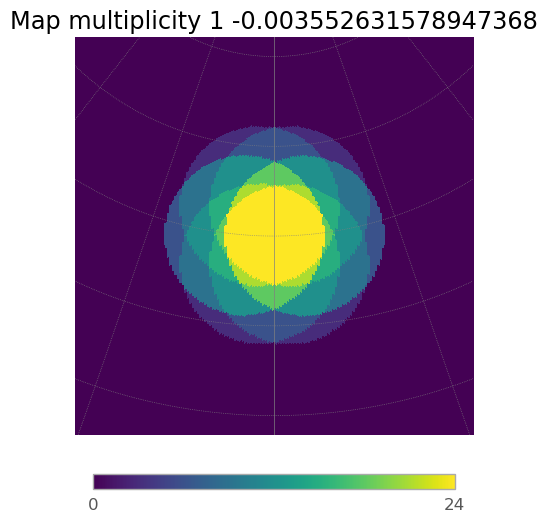

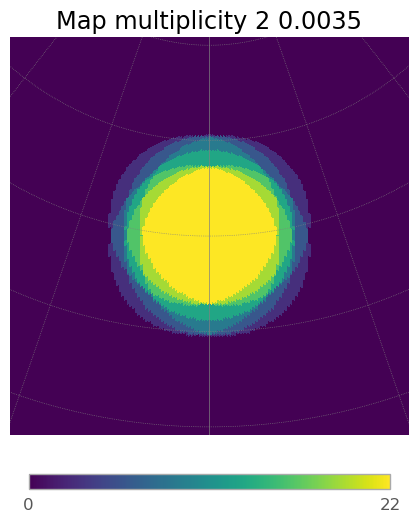

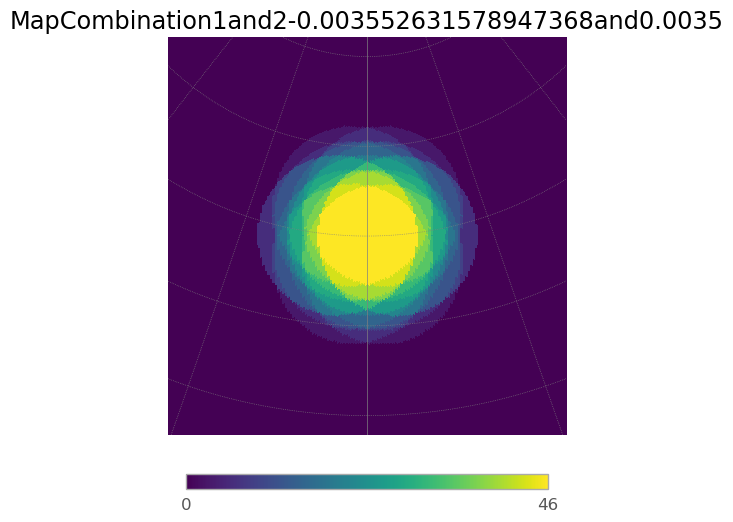

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.59it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.57it/s]
7it [00:01,  5.74it/s]
6it [00:01,  5.74it/s]
7it [00:01,  5.95it/s]
6it [00:01,  5.54it/s]


10.94471688244769


7it [00:01,  5.79it/s]


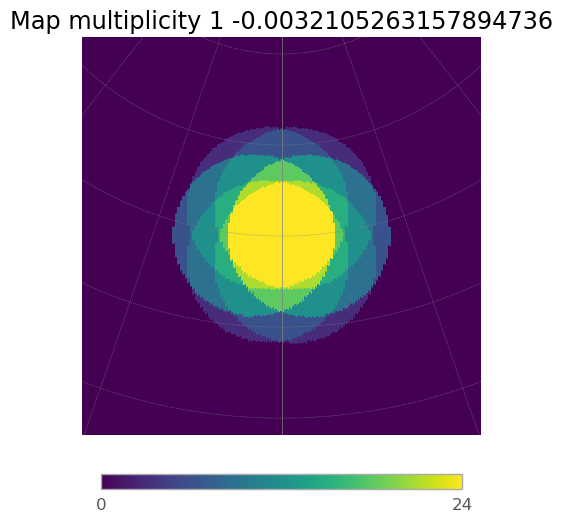

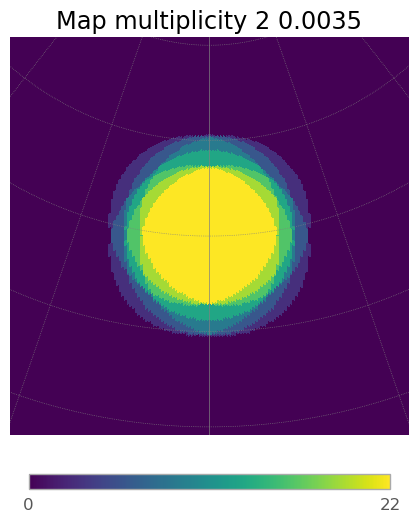

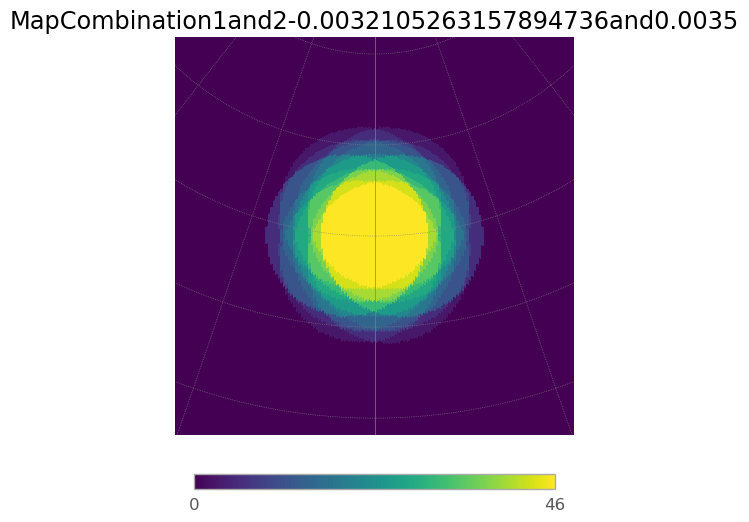

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.42it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.01it/s]
7it [00:01,  5.53it/s]
6it [00:01,  5.46it/s]
7it [00:01,  5.09it/s]
6it [00:01,  5.25it/s]


10.786010643608968


7it [00:01,  5.66it/s]


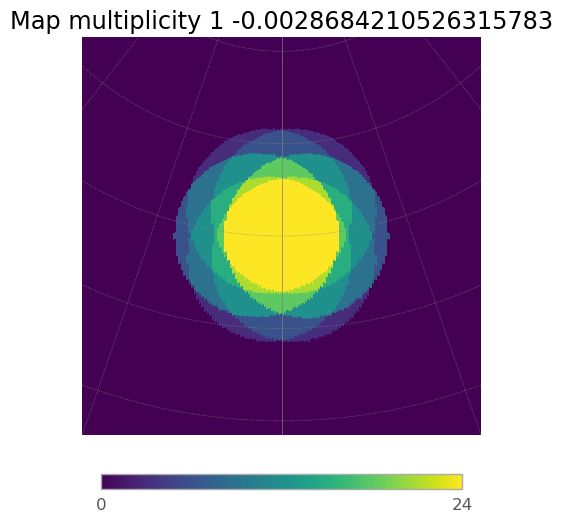

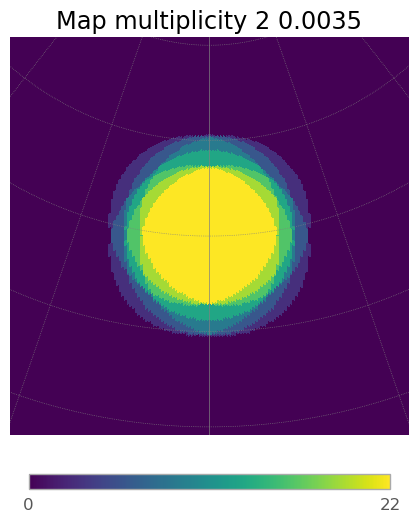

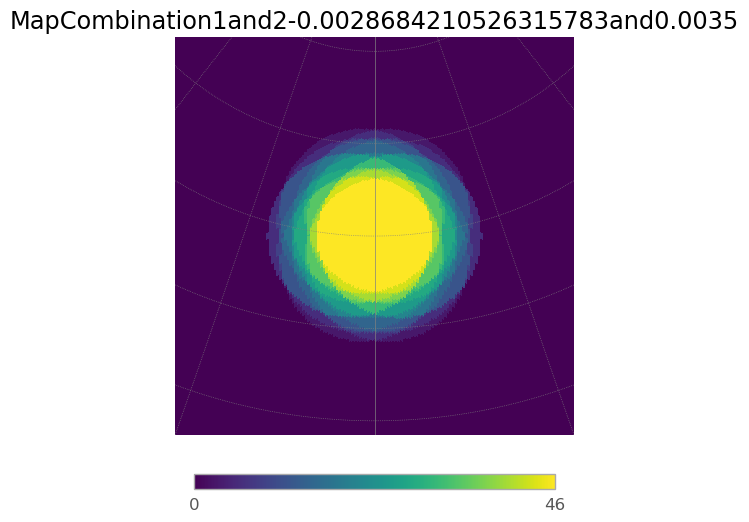

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.26it/s]
7it [00:01,  5.62it/s]
6it [00:01,  5.54it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.40it/s]
7it [00:01,  5.40it/s]
6it [00:01,  5.62it/s]


10.626537351232152


7it [00:01,  5.70it/s]


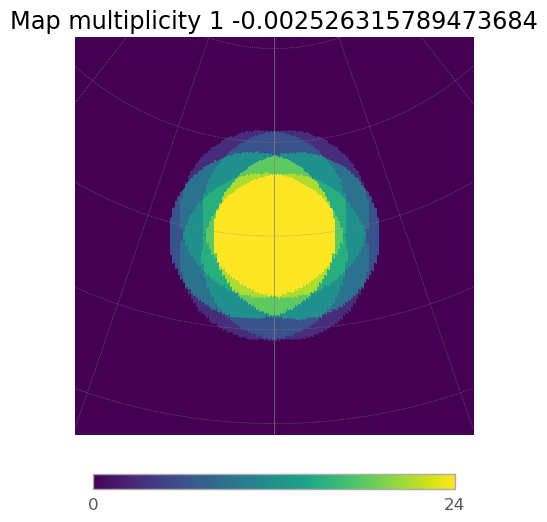

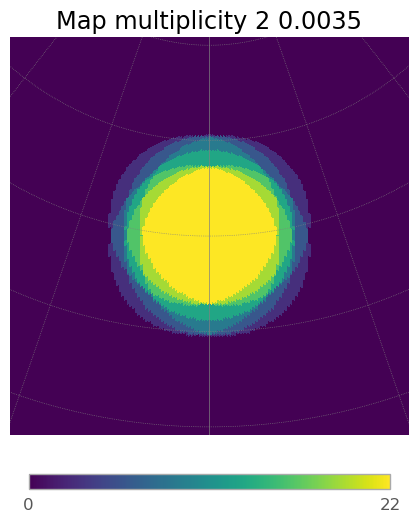

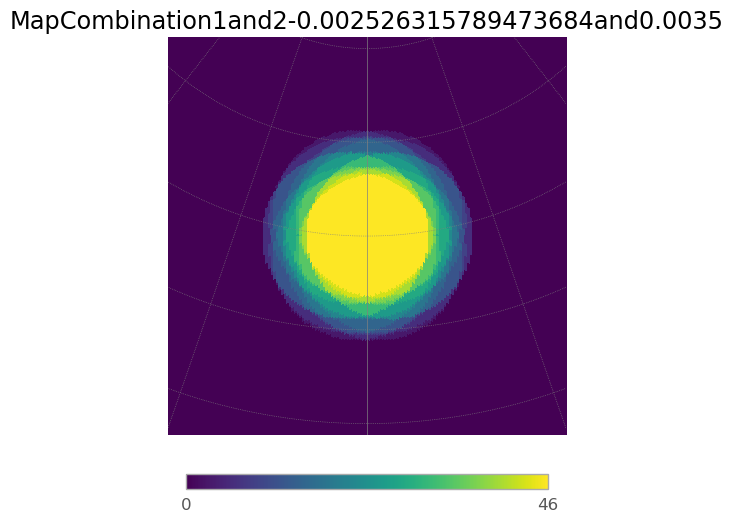

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.31it/s]
7it [00:01,  5.12it/s]
6it [00:01,  5.00it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.34it/s]
7it [00:01,  4.96it/s]
6it [00:01,  5.03it/s]


10.468520350865969


7it [00:01,  5.63it/s]


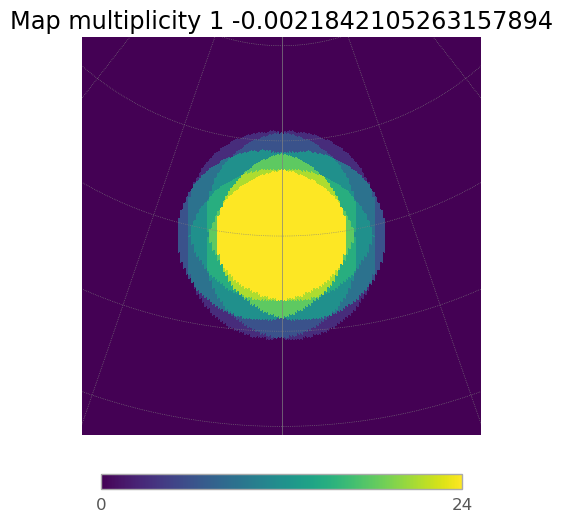

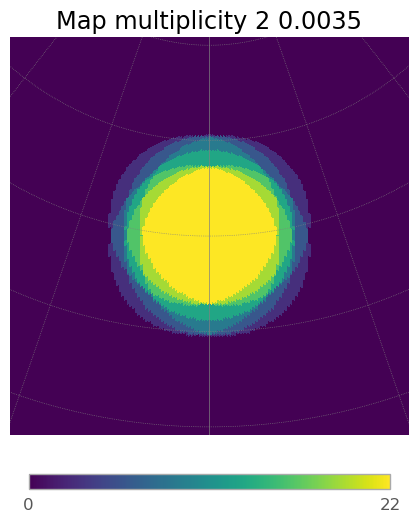

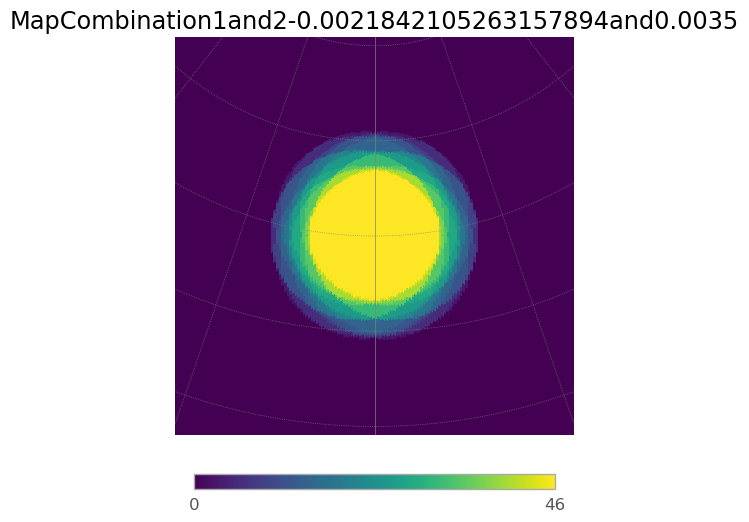

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.09it/s]
7it [00:01,  5.40it/s]
6it [00:01,  4.99it/s]
7it [00:01,  5.31it/s]
6it [00:01,  5.82it/s]
7it [00:01,  5.60it/s]
6it [00:01,  5.71it/s]


10.313268190994826


7it [00:01,  5.92it/s]


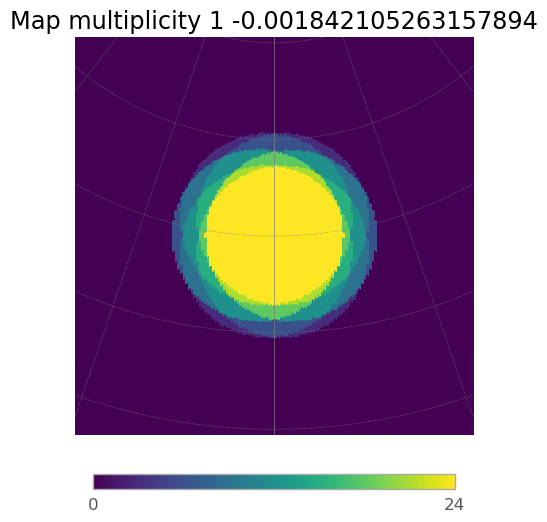

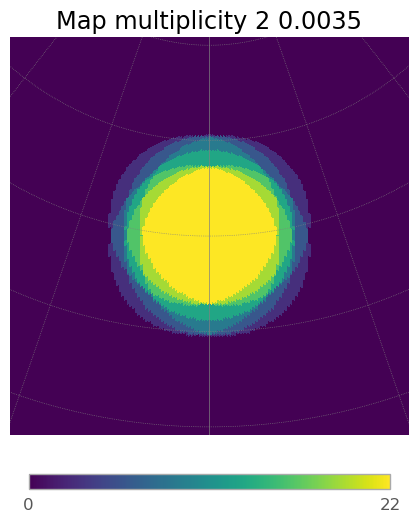

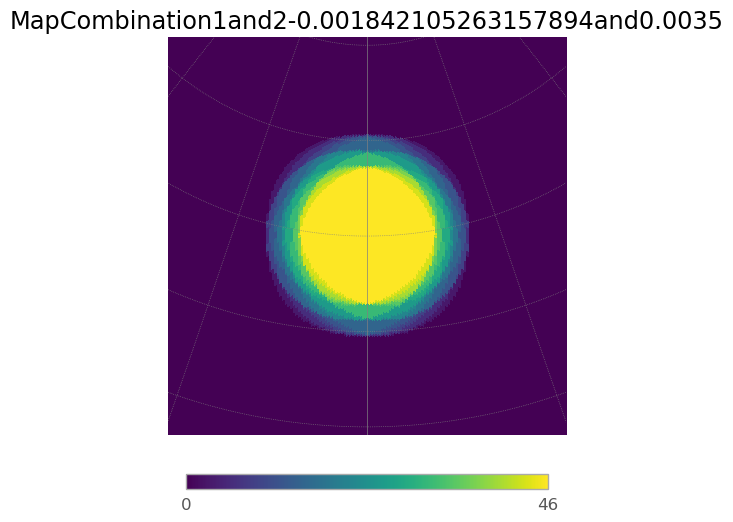

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.25it/s]
7it [00:01,  4.78it/s]
6it [00:01,  5.38it/s]
7it [00:01,  5.83it/s]
6it [00:01,  5.82it/s]
7it [00:01,  5.72it/s]
6it [00:01,  5.45it/s]


10.154555831829411


7it [00:01,  5.59it/s]


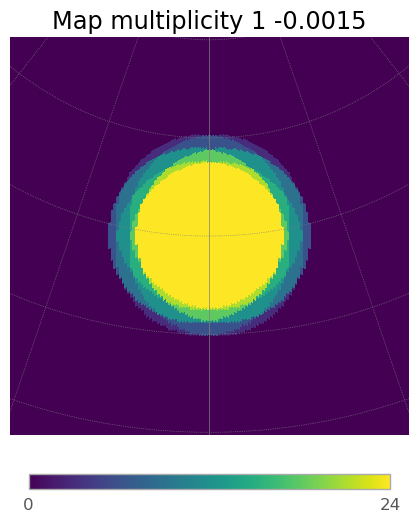

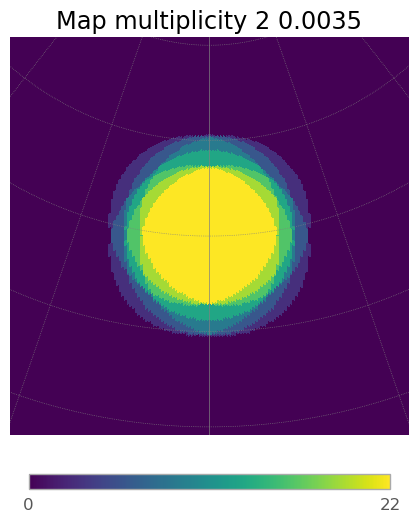

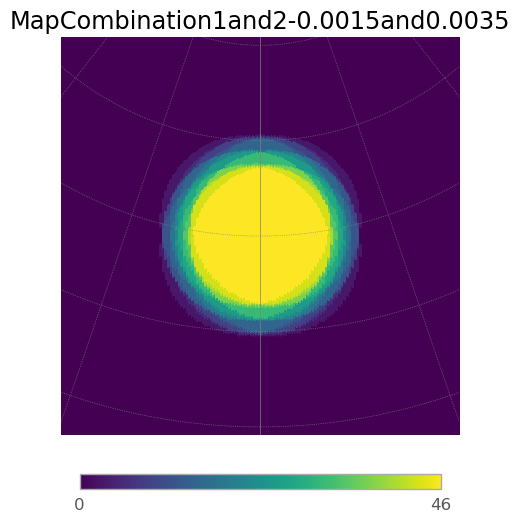

In [61]:
#TOO MUCH 
conv=np.linspace(-0.0080,-0.0015, 20)
FoV_too_much=[]
multiplicity_too_much=[]
for convergence in conv:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=convergence, div2=0.0035, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_too_much.append(FoV)
    multiplicity_too_much.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


46it [00:08,  5.73it/s]
46it [00:08,  5.56it/s]
46it [00:08,  5.38it/s]
46it [00:08,  5.34it/s]


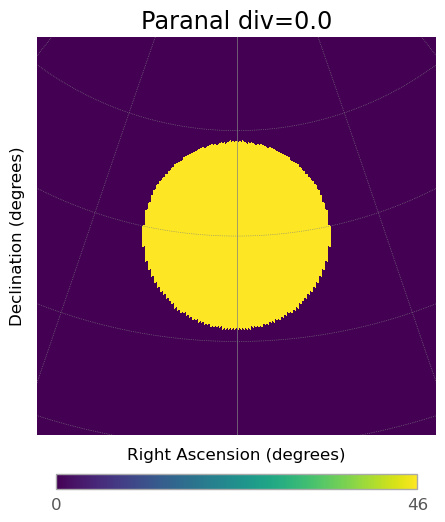

46it [00:08,  5.29it/s]
46it [00:08,  5.55it/s]
46it [00:08,  5.42it/s]
46it [00:08,  5.38it/s]


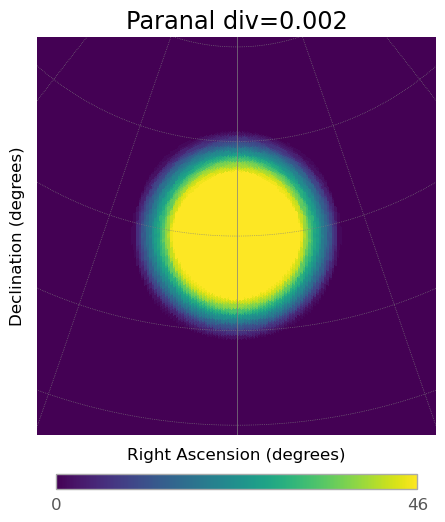

46it [00:08,  5.23it/s]
46it [00:09,  4.88it/s]
46it [00:09,  5.10it/s]
46it [00:09,  5.00it/s]


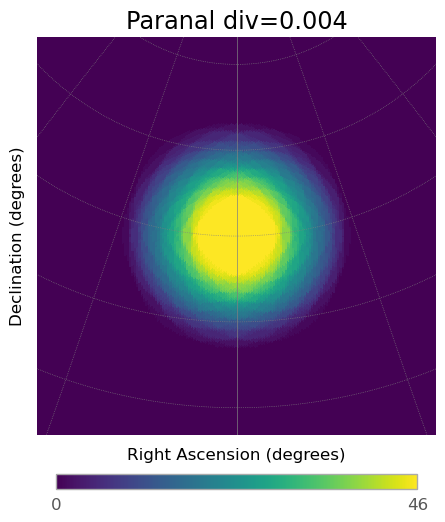

46it [00:09,  5.03it/s]
46it [00:08,  5.21it/s]
46it [00:09,  5.02it/s]
46it [00:07,  5.82it/s]


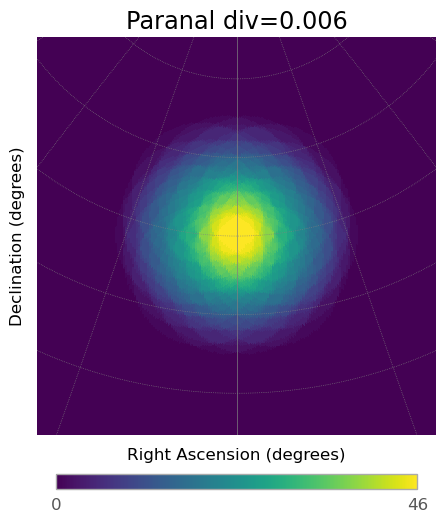

46it [00:07,  6.44it/s]
46it [00:07,  6.51it/s]
46it [00:06,  6.67it/s]
46it [00:07,  5.93it/s]


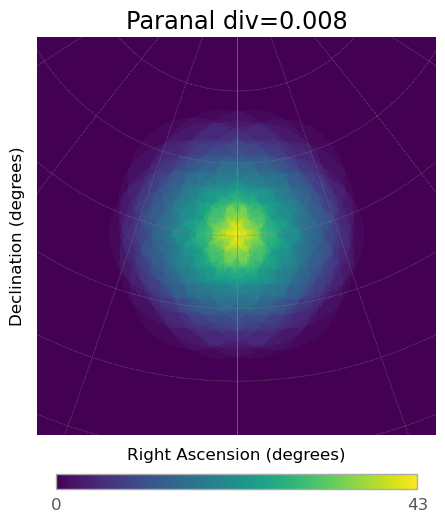

In [62]:

FoV_full_array=[]
multiplicity_full_array=[]

div_full_array=np.linspace(0,0.008, 5)
for divergence in div_full_array:  #This is the one that diverges        
    full_array.divergent_pointing(div=divergence, az=0, alt=70)
    FoV=full_array.hFoV(m_cut=3)[0]
    multiplicity=full_array.hFoV(m_cut=3)[1]
    FoV_full_array.append(FoV)
    multiplicity_full_array.append(multiplicity)
    full_array.multiplicity_plot()


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.35it/s]
7it [00:01,  5.41it/s]
6it [00:01,  5.70it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.64it/s]
7it [00:01,  5.72it/s]
6it [00:01,  5.38it/s]


13.07274650697345


7it [00:01,  5.90it/s]


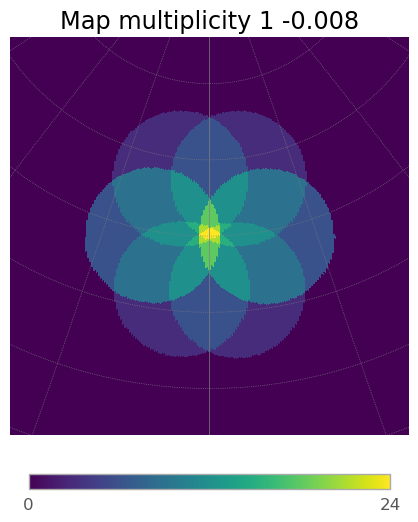

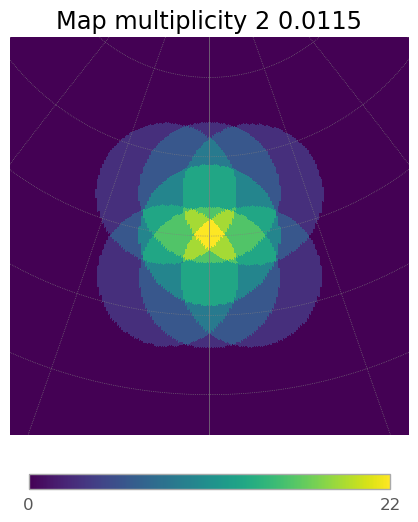

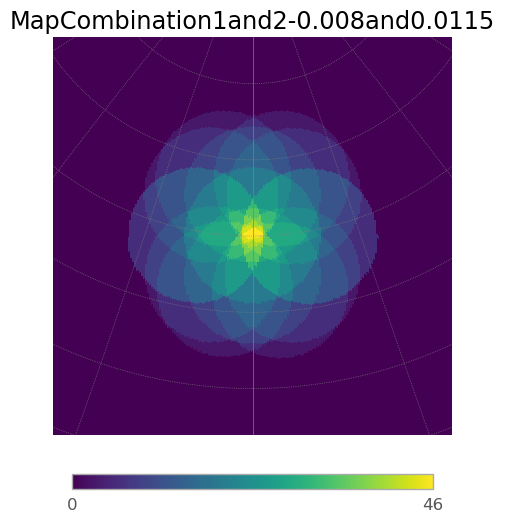

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.64it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.50it/s]
7it [00:01,  5.74it/s]
6it [00:01,  5.57it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.66it/s]


12.92400673955597


7it [00:01,  5.85it/s]


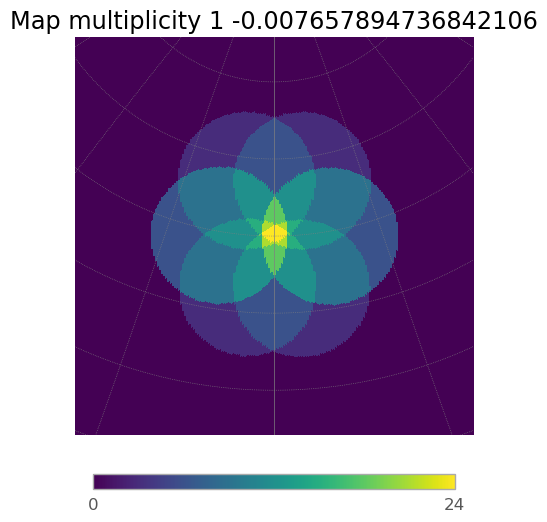

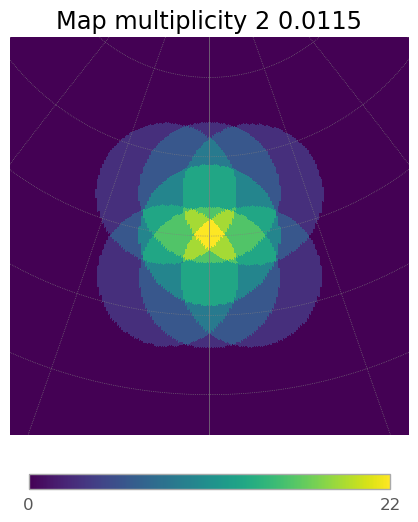

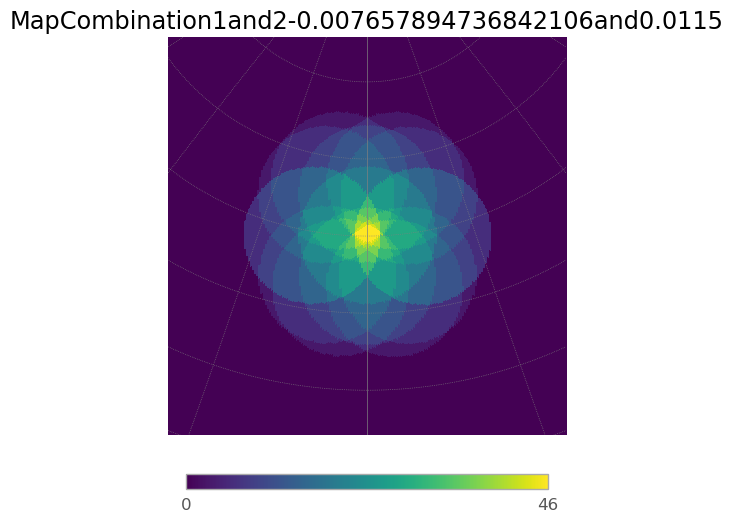

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.19it/s]
7it [00:01,  5.45it/s]
6it [00:01,  5.51it/s]
7it [00:01,  5.56it/s]
6it [00:01,  5.49it/s]
7it [00:01,  5.87it/s]
6it [00:01,  5.37it/s]


12.777253173559846


7it [00:01,  5.77it/s]


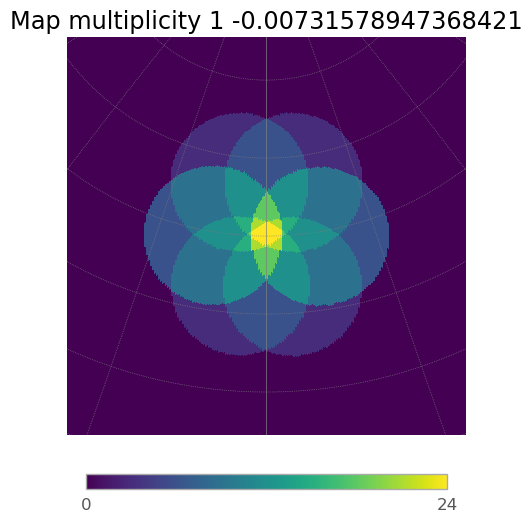

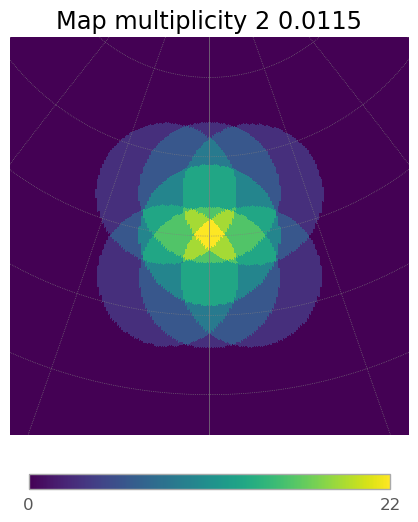

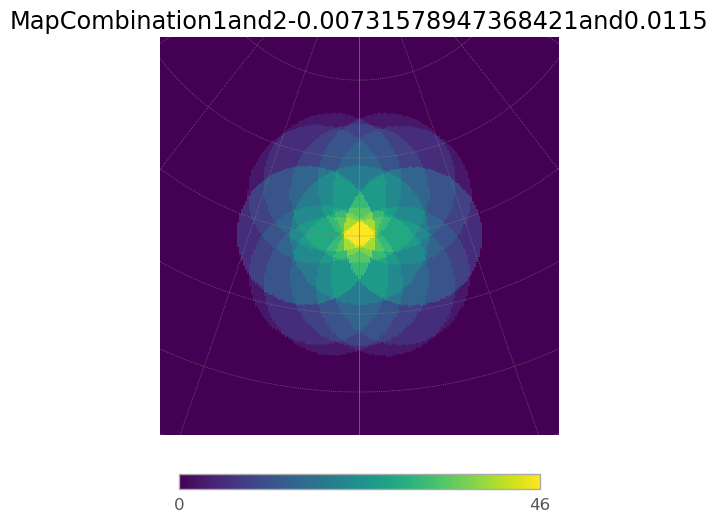

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.74it/s]
7it [00:01,  5.19it/s]
6it [00:01,  5.54it/s]
7it [00:01,  5.63it/s]
6it [00:01,  5.31it/s]
7it [00:01,  5.41it/s]
6it [00:01,  5.25it/s]


12.627950271658865


7it [00:01,  5.57it/s]


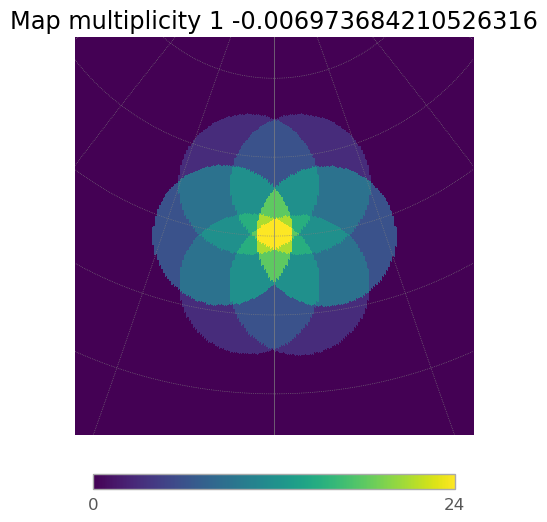

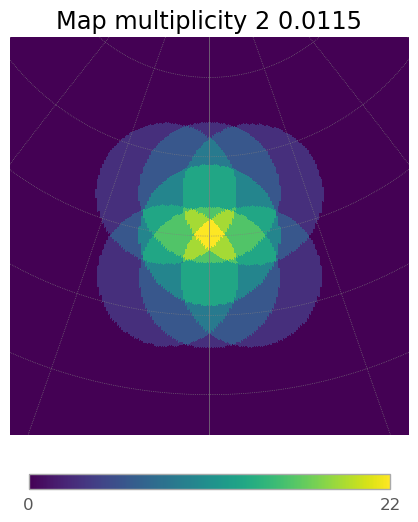

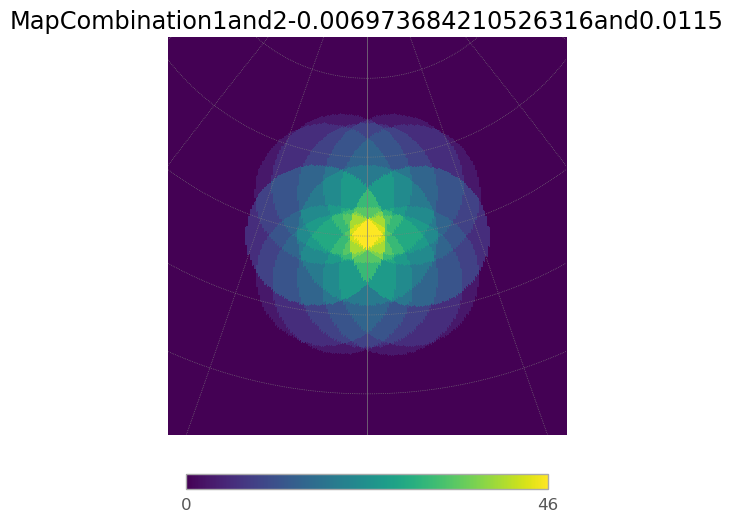

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.21it/s]
7it [00:01,  4.20it/s]
6it [00:01,  4.40it/s]
7it [00:01,  4.10it/s]
6it [00:01,  3.74it/s]
7it [00:01,  3.79it/s]
6it [00:01,  3.40it/s]


12.477899317404567


7it [00:01,  5.32it/s]


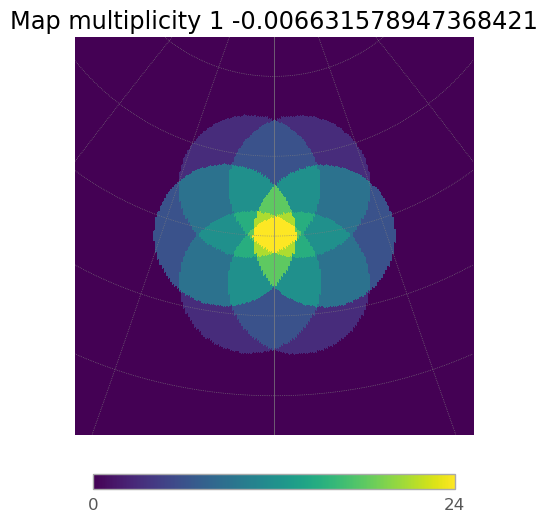

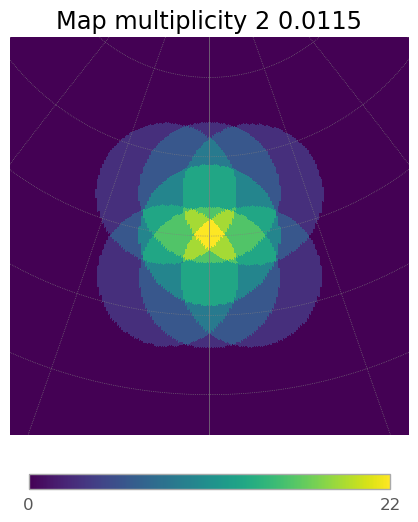

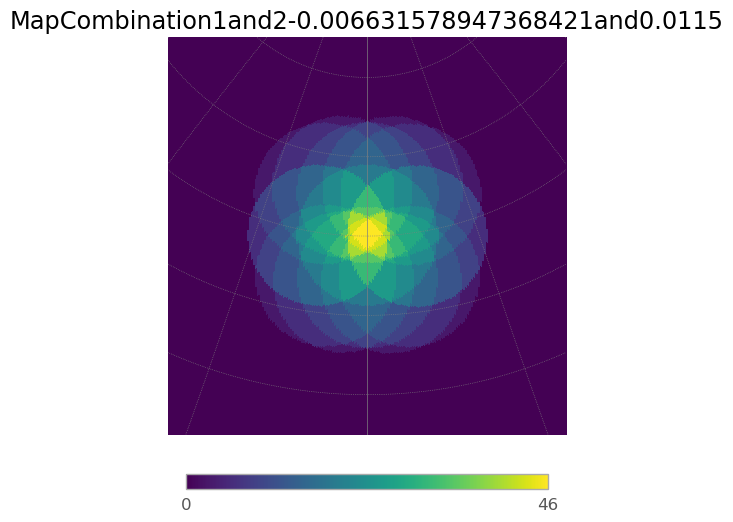

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.30it/s]
7it [00:01,  5.48it/s]
6it [00:01,  5.48it/s]
7it [00:01,  5.57it/s]
6it [00:01,  5.58it/s]
7it [00:01,  5.24it/s]
6it [00:01,  5.30it/s]


12.325629936598338


7it [00:01,  5.60it/s]


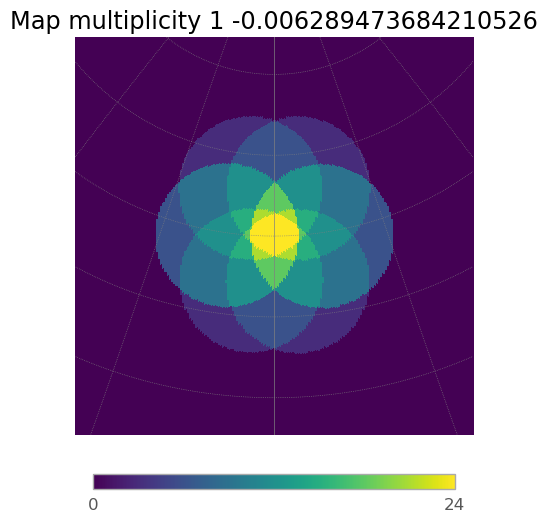

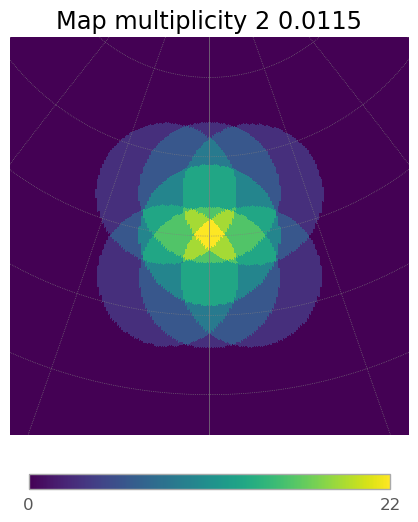

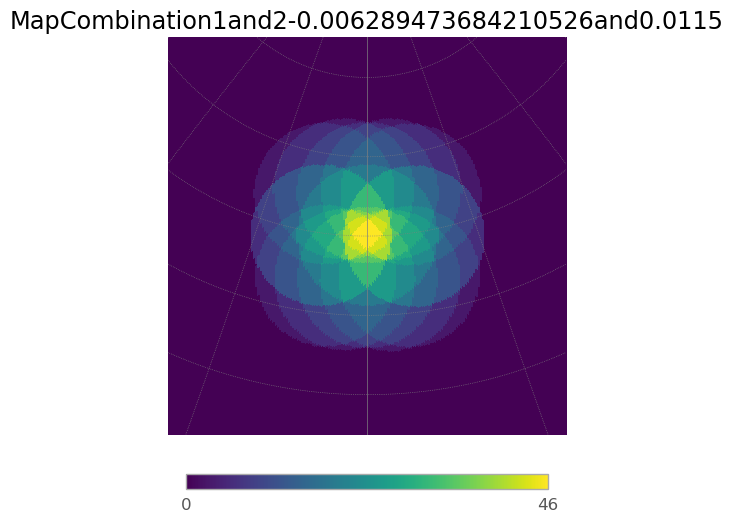

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.69it/s]
7it [00:01,  5.08it/s]
6it [00:01,  5.15it/s]
7it [00:01,  5.37it/s]
6it [00:01,  5.73it/s]
7it [00:01,  5.55it/s]
6it [00:01,  5.51it/s]


12.174201697236496


7it [00:01,  5.55it/s]


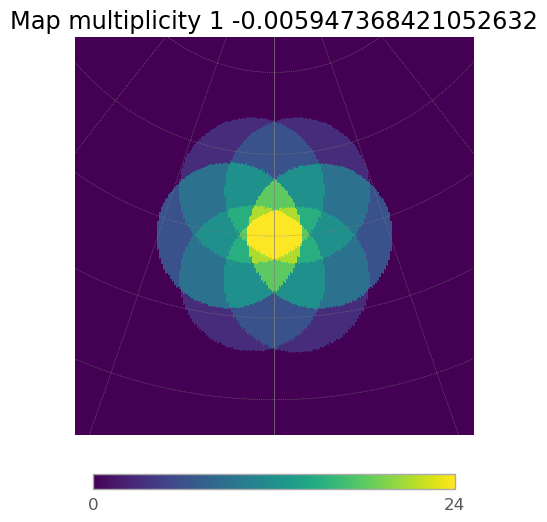

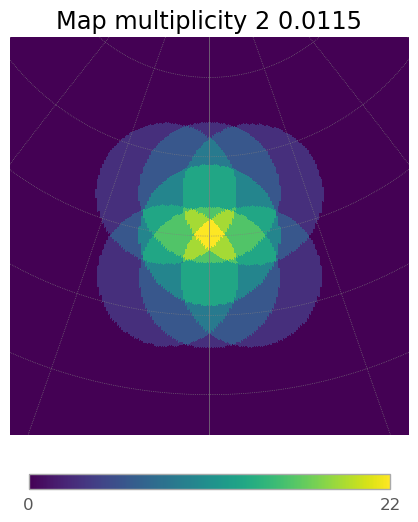

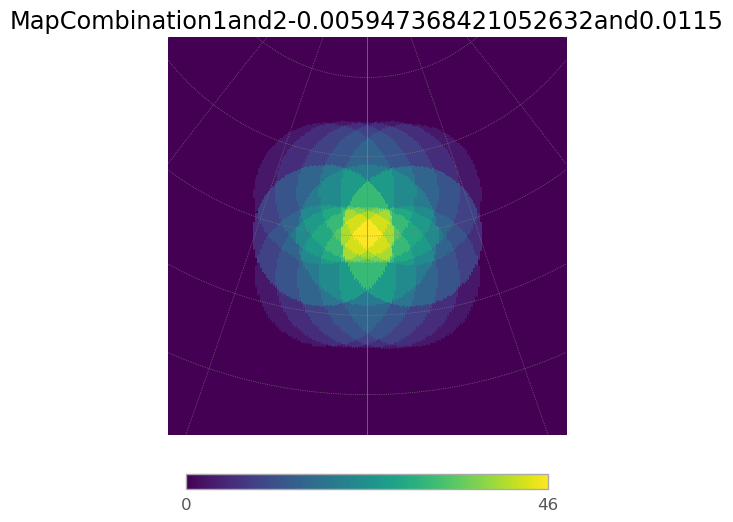

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.67it/s]
7it [00:01,  5.16it/s]
6it [00:01,  5.30it/s]
7it [00:01,  5.60it/s]
6it [00:01,  5.48it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.32it/s]


12.02129132297544


7it [00:01,  5.25it/s]


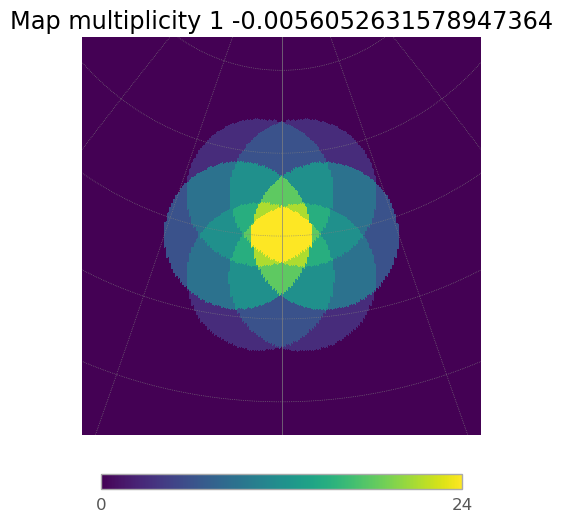

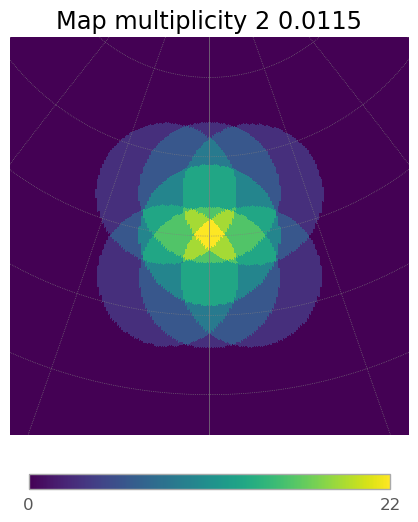

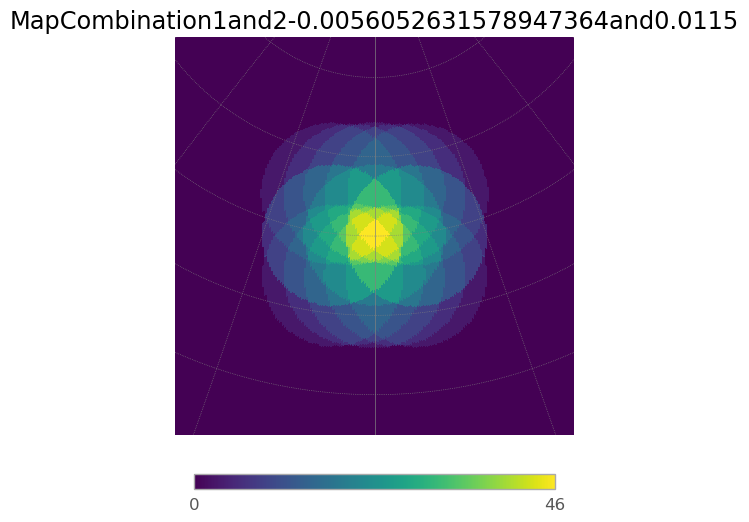

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.41it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.54it/s]
7it [00:01,  5.55it/s]
6it [00:01,  5.80it/s]
7it [00:01,  5.68it/s]
6it [00:01,  5.26it/s]


11.872876079129934


7it [00:01,  5.74it/s]


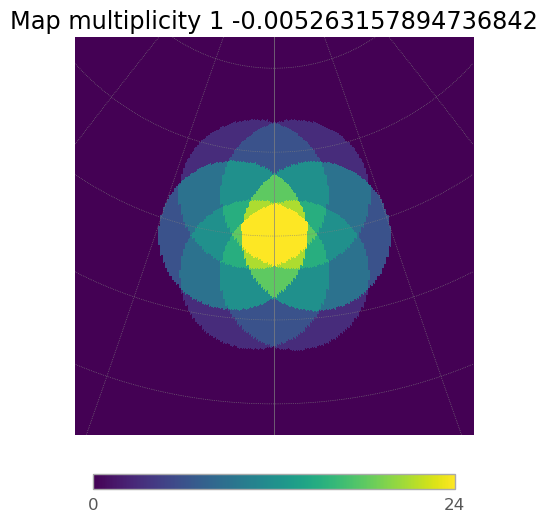

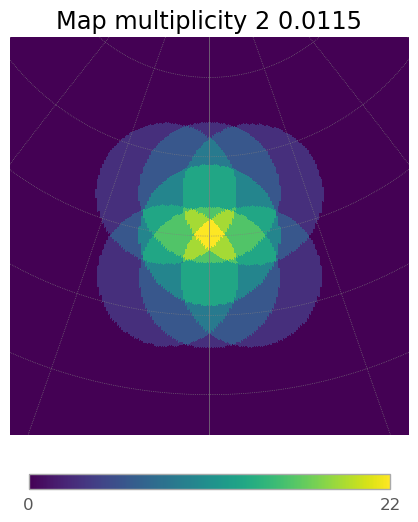

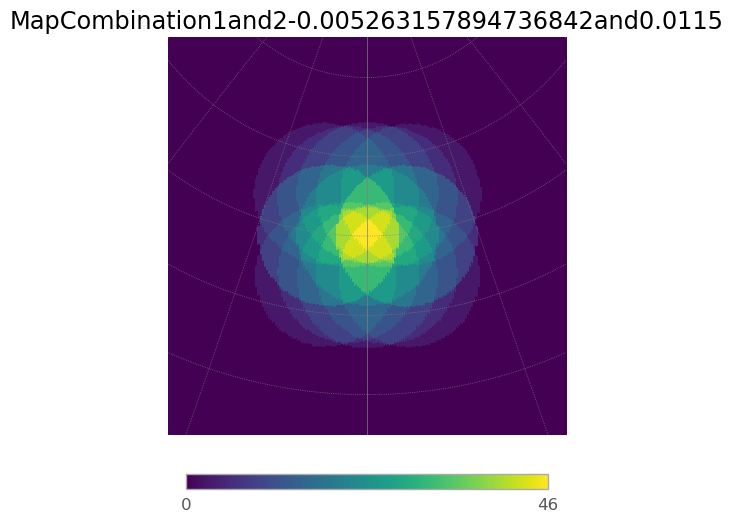

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.55it/s]
7it [00:01,  5.59it/s]
6it [00:01,  5.65it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.85it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.47it/s]


11.718078320078305


7it [00:01,  5.81it/s]


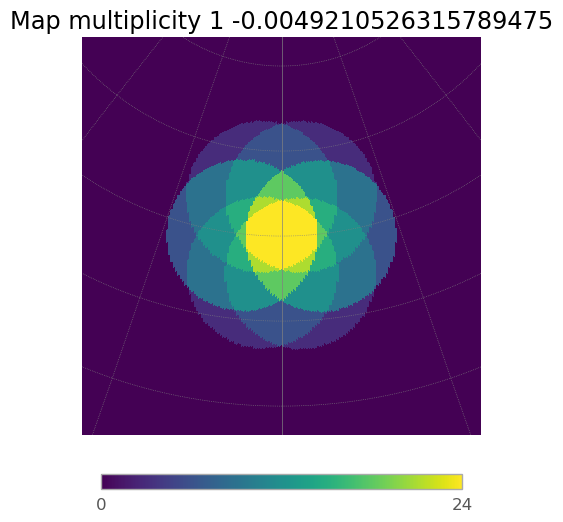

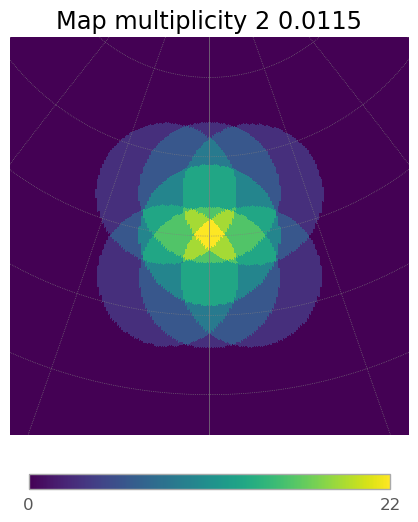

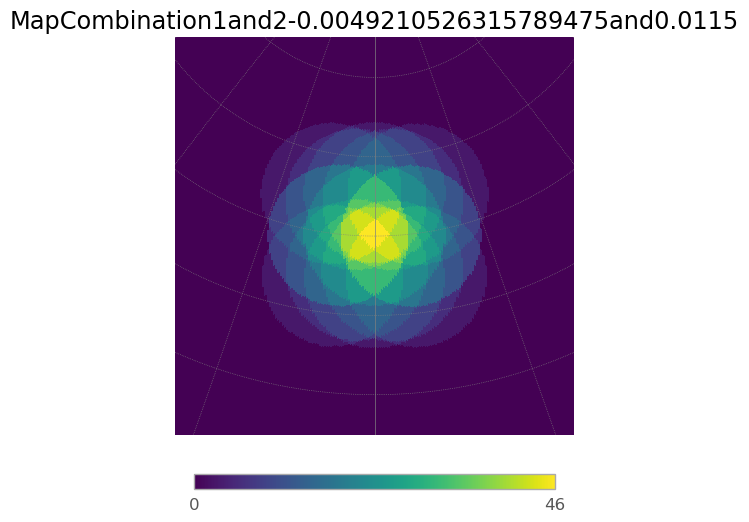

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.25it/s]
7it [00:01,  5.27it/s]
6it [00:01,  4.63it/s]
7it [00:01,  5.13it/s]
6it [00:01,  5.01it/s]
7it [00:01,  5.61it/s]
6it [00:01,  5.45it/s]


11.560264906130477


7it [00:01,  5.32it/s]


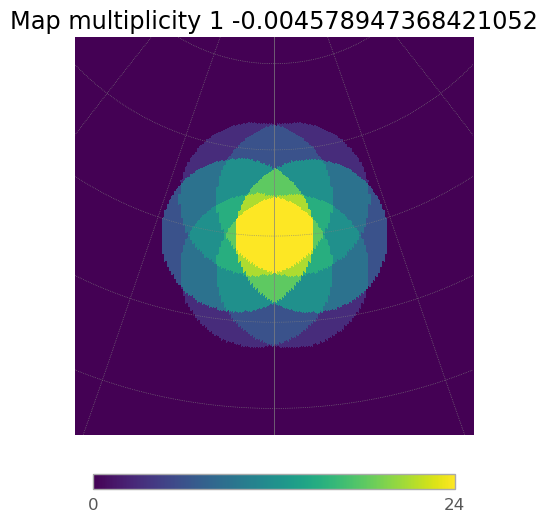

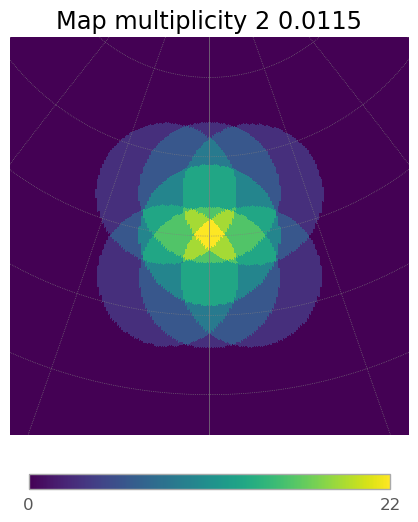

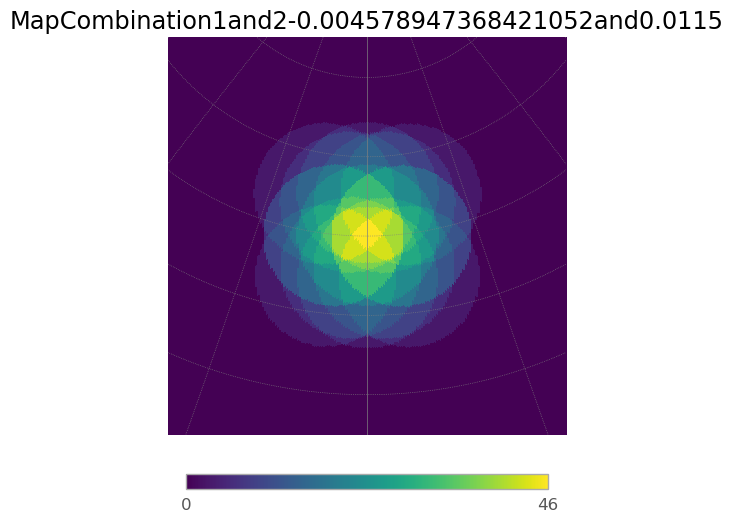

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.00it/s]
7it [00:01,  5.26it/s]
6it [00:01,  5.19it/s]
7it [00:01,  5.35it/s]
6it [00:01,  5.52it/s]
7it [00:01,  5.27it/s]
6it [00:01,  5.19it/s]


11.410943652822338


7it [00:01,  5.17it/s]


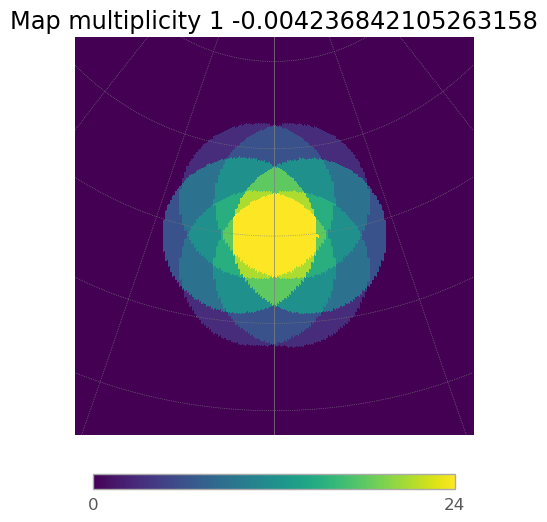

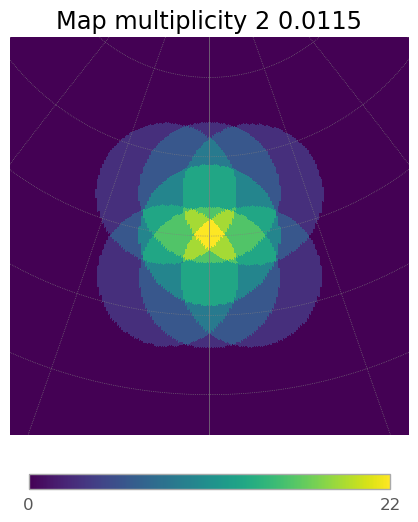

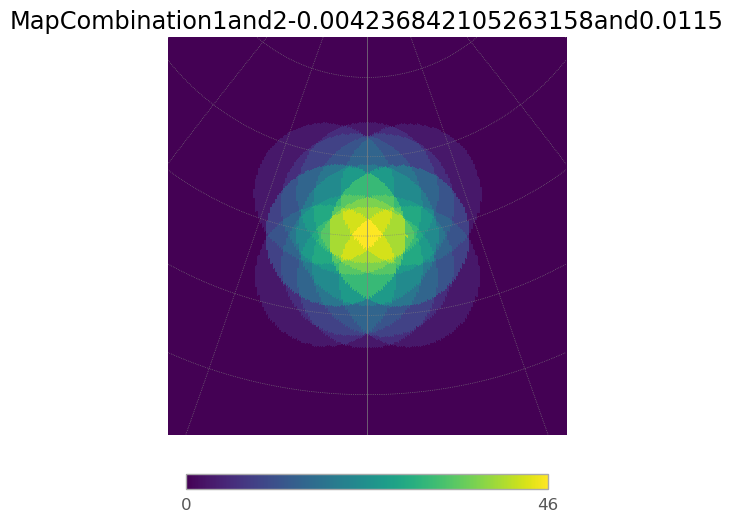

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.31it/s]
7it [00:01,  5.20it/s]
6it [00:01,  5.21it/s]
7it [00:01,  5.34it/s]
6it [00:01,  4.76it/s]
7it [00:01,  5.63it/s]
6it [00:01,  5.49it/s]


11.255058166276156


7it [00:01,  5.37it/s]


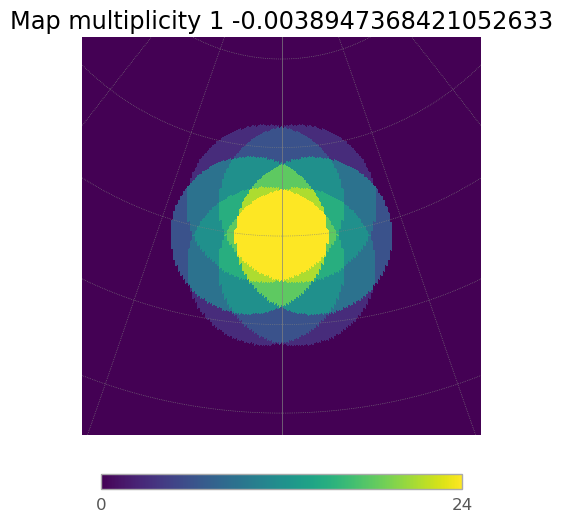

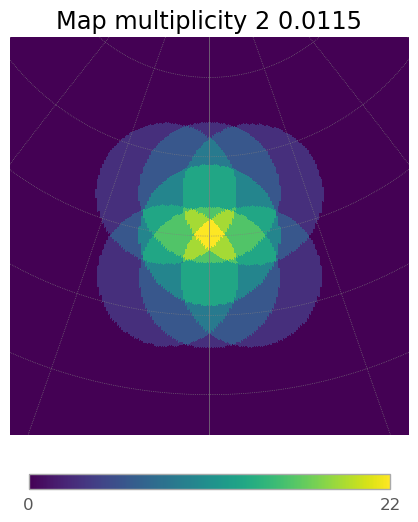

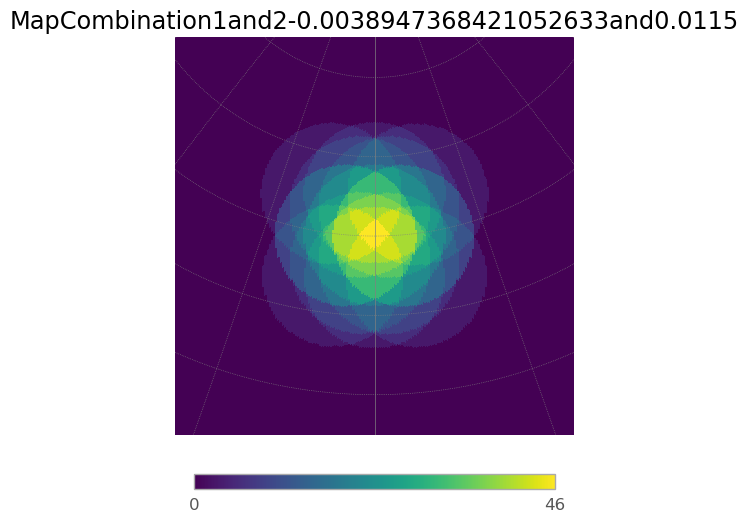

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.48it/s]
7it [00:01,  5.83it/s]
6it [00:01,  5.52it/s]
7it [00:01,  5.74it/s]
6it [00:01,  5.76it/s]
7it [00:01,  5.73it/s]
6it [00:01,  5.68it/s]


11.099979267606752


7it [00:01,  5.89it/s]


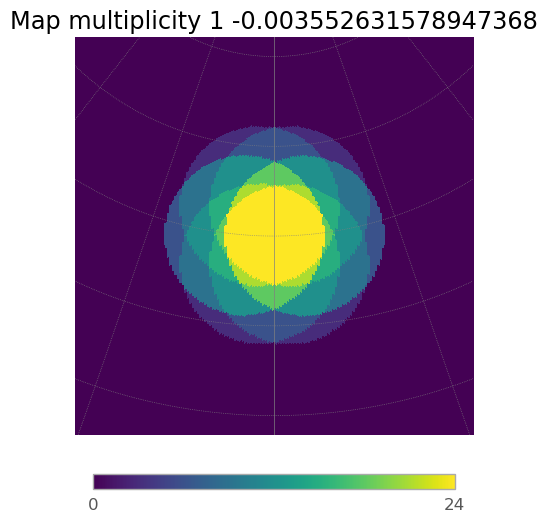

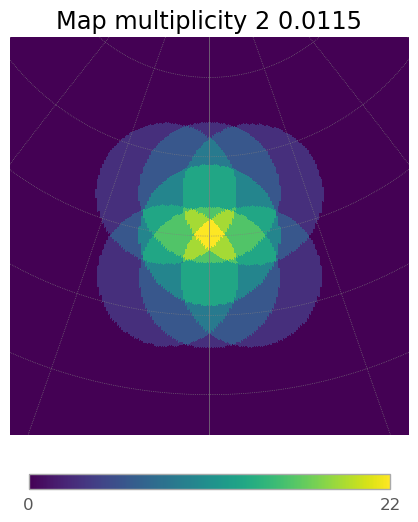

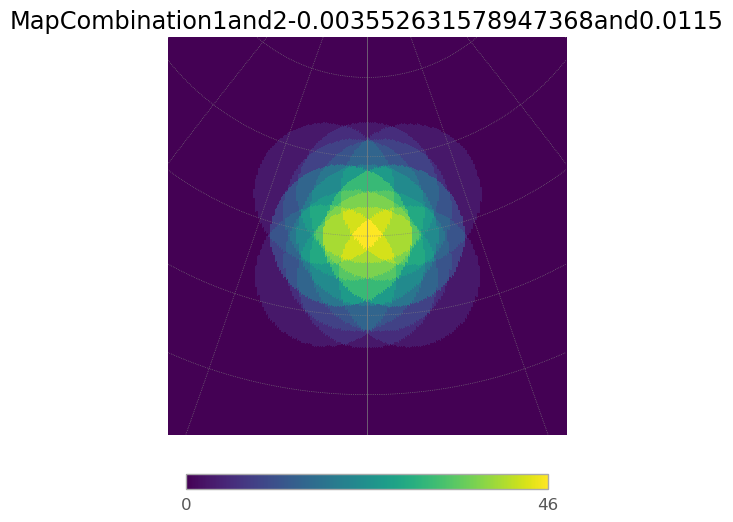

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.63it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.36it/s]
7it [00:01,  5.55it/s]
6it [00:01,  5.69it/s]
7it [00:01,  5.85it/s]
6it [00:01,  5.51it/s]


10.94471688244769


7it [00:01,  5.96it/s]


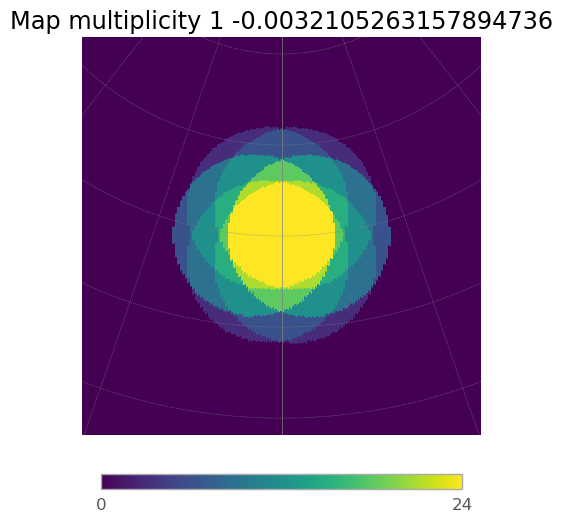

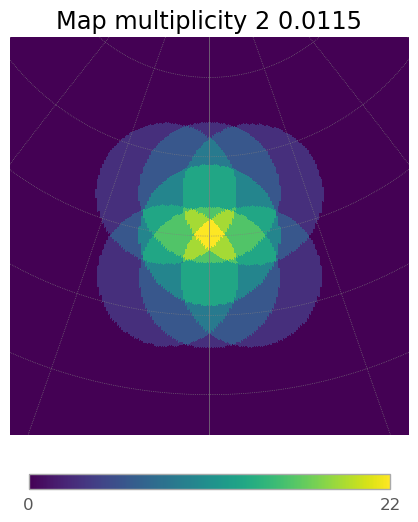

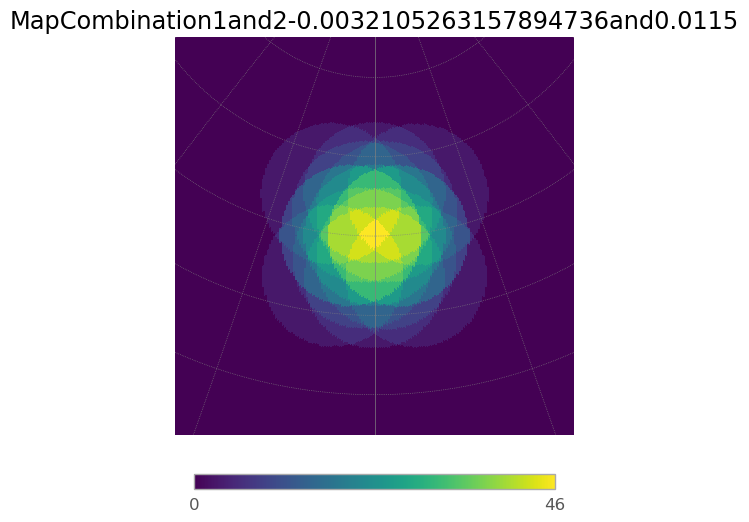

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.57it/s]
7it [00:01,  5.22it/s]
6it [00:01,  5.62it/s]
7it [00:01,  5.61it/s]
6it [00:01,  5.51it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.58it/s]


10.786010643608968


7it [00:01,  5.80it/s]


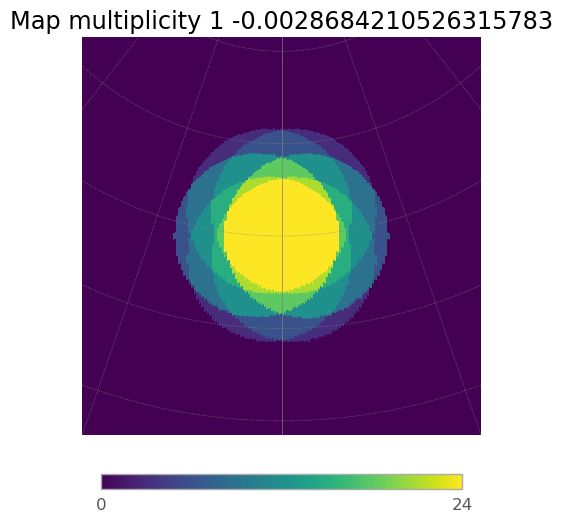

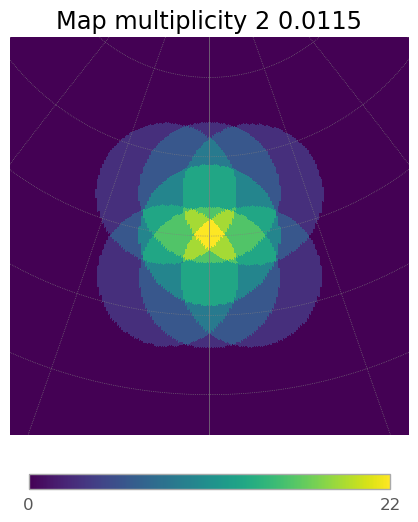

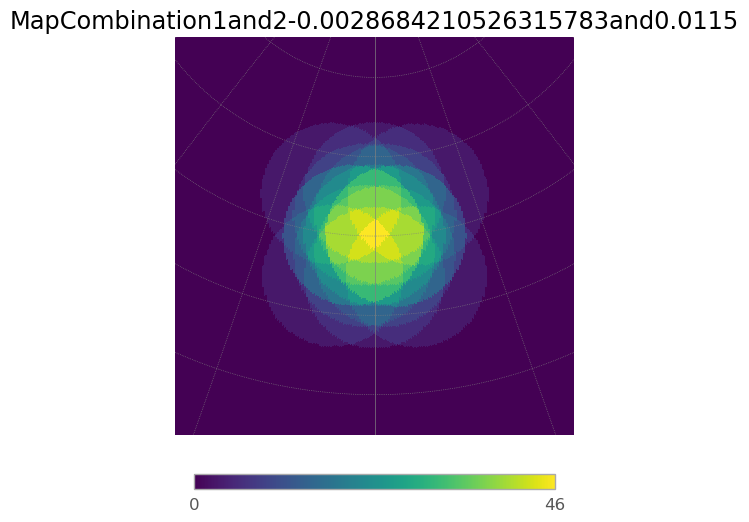

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.46it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.58it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.84it/s]
7it [00:01,  5.82it/s]
6it [00:01,  5.68it/s]


10.626537351232152


7it [00:01,  5.97it/s]


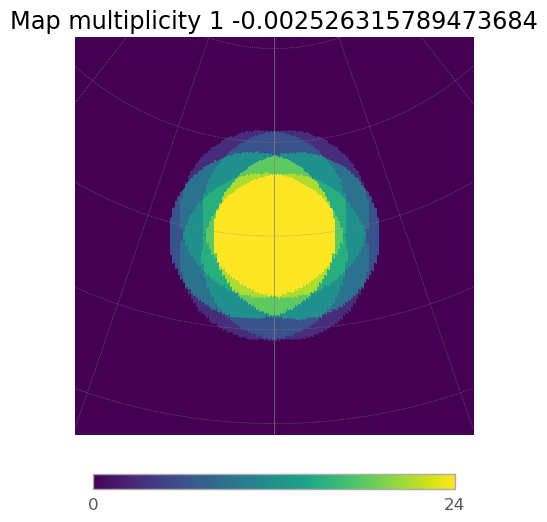

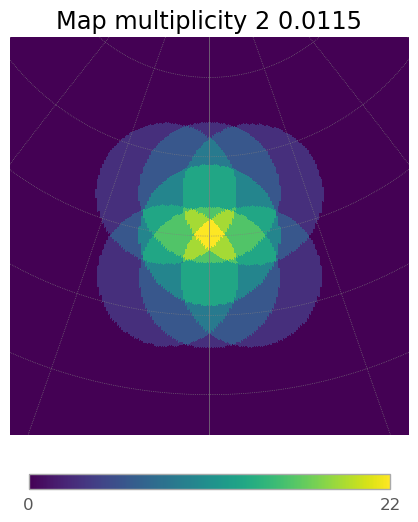

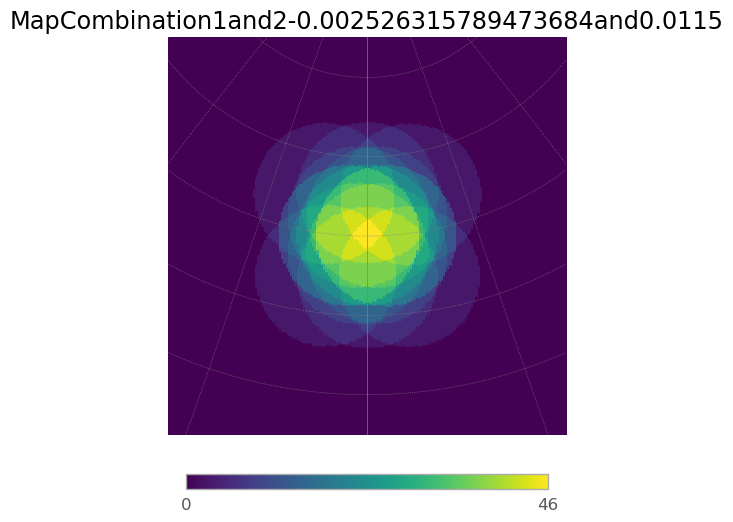

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.22it/s]
7it [00:01,  5.92it/s]
6it [00:01,  5.68it/s]
7it [00:01,  5.88it/s]
6it [00:01,  5.93it/s]
7it [00:01,  5.82it/s]
6it [00:01,  5.29it/s]


10.468520350865969


7it [00:01,  5.88it/s]


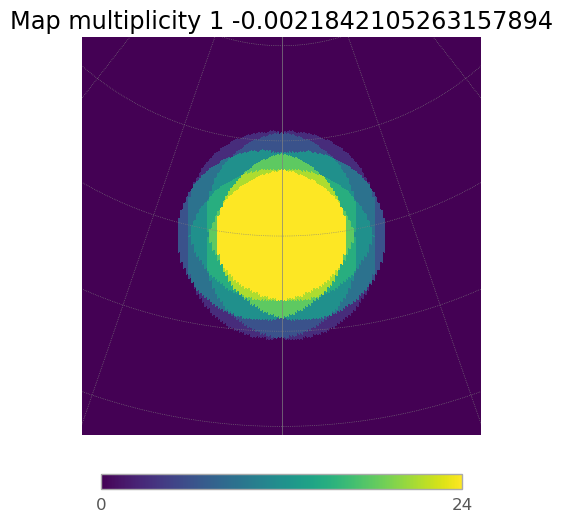

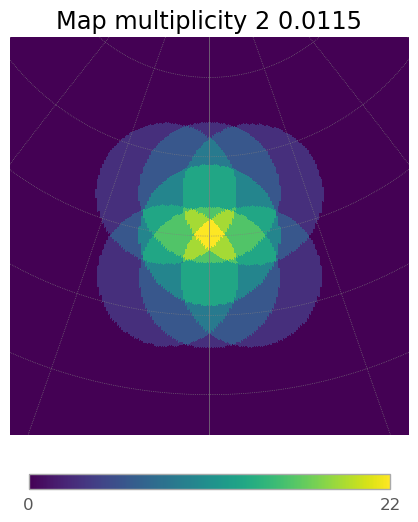

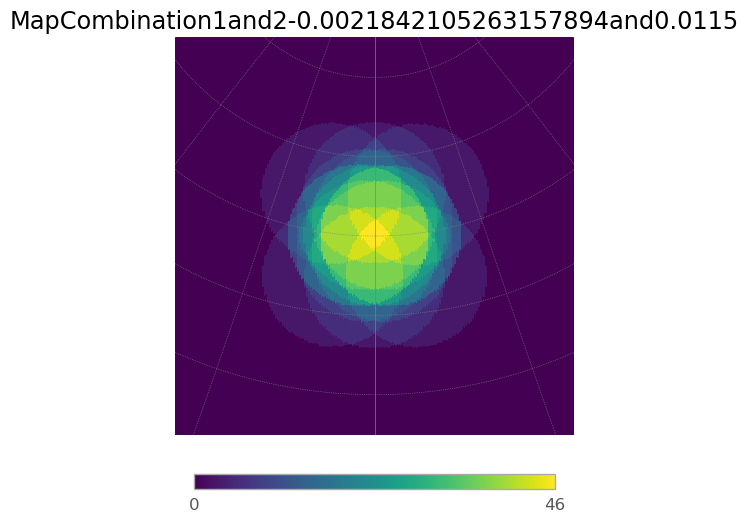

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.48it/s]
7it [00:01,  5.54it/s]
6it [00:01,  5.44it/s]
7it [00:01,  6.01it/s]
6it [00:01,  5.88it/s]
7it [00:01,  5.79it/s]
6it [00:01,  5.59it/s]


10.313268190994826


7it [00:01,  5.93it/s]


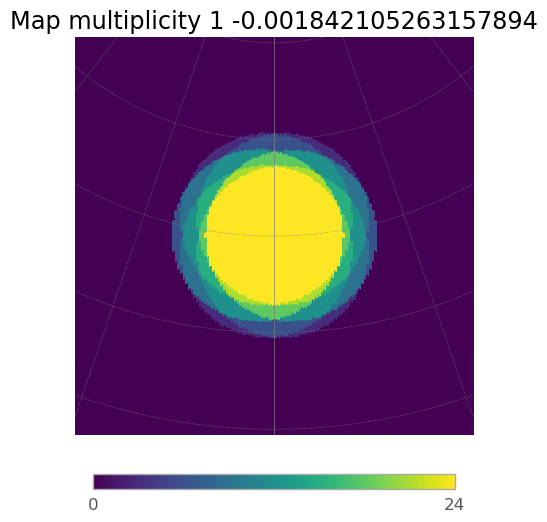

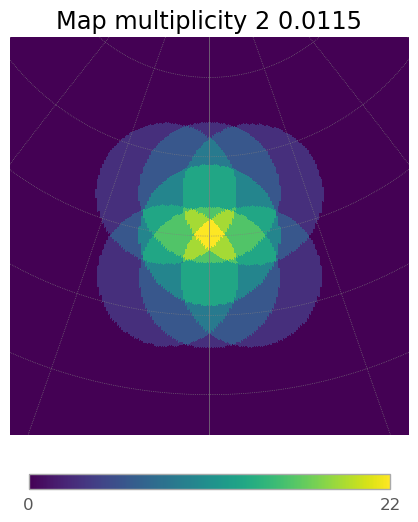

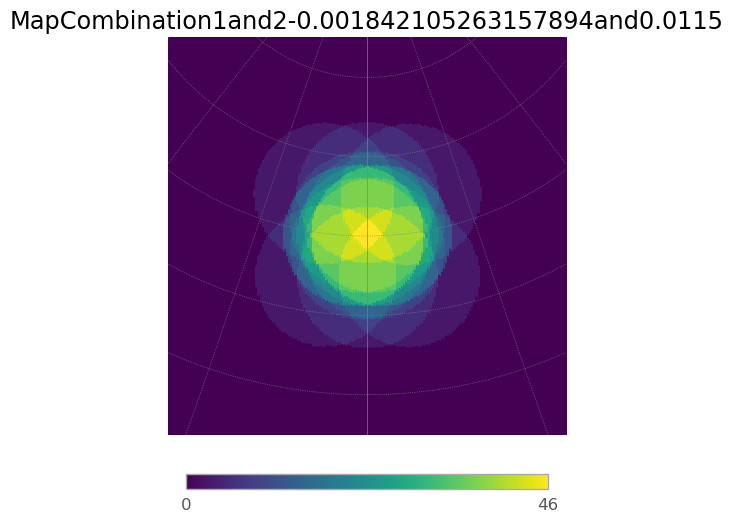

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.83it/s]
7it [00:01,  5.91it/s]
6it [00:01,  5.47it/s]
7it [00:01,  5.40it/s]
6it [00:01,  5.76it/s]
7it [00:01,  6.21it/s]
6it [00:01,  5.57it/s]


10.154555831829411


7it [00:01,  5.95it/s]


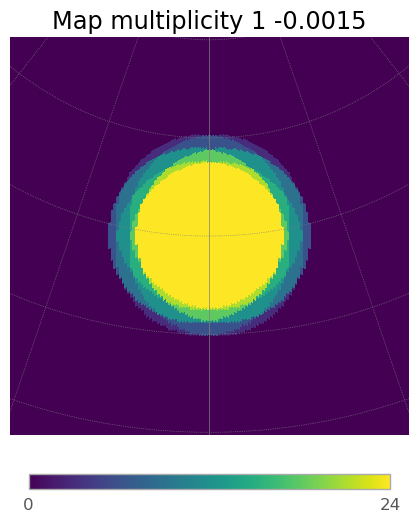

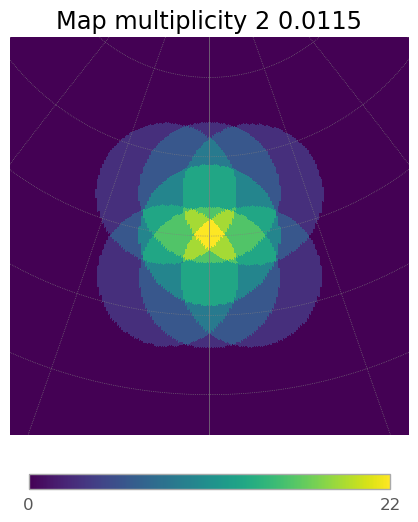

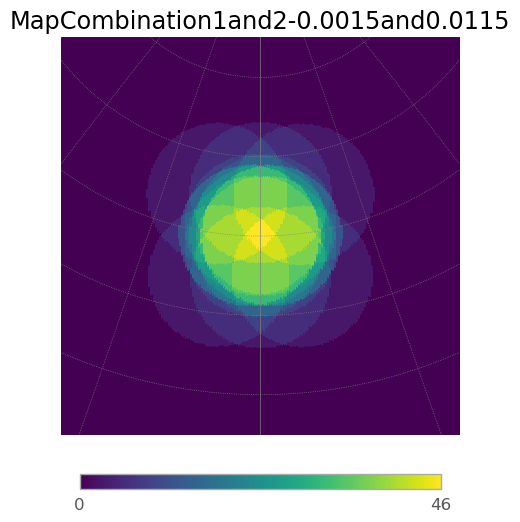

In [63]:
conv=np.linspace(-0.0080,-0.0015, 20)
FoV_second_best_conv=[]
multiplicity_second_best_conv=[]
for convergence in conv:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=convergence, div2=0.0115, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_second_best_conv.append(FoV)
    multiplicity_second_best_conv.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.65it/s]
7it [00:01,  5.82it/s]
6it [00:01,  5.49it/s]
7it [00:01,  5.78it/s]
6it [00:01,  5.84it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.69it/s]


13.07274650697345


7it [00:01,  5.88it/s]


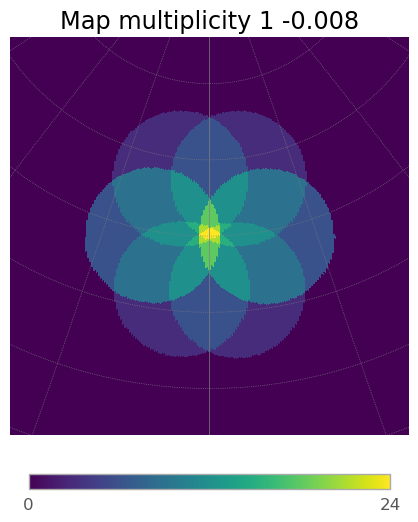

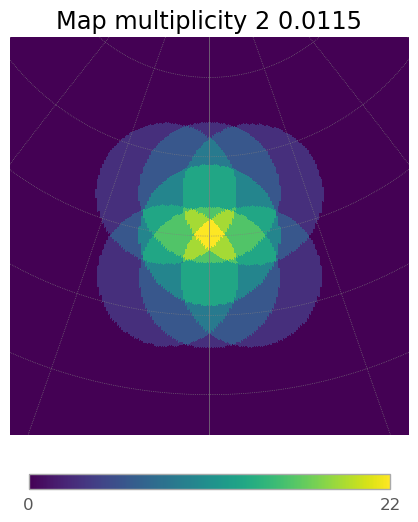

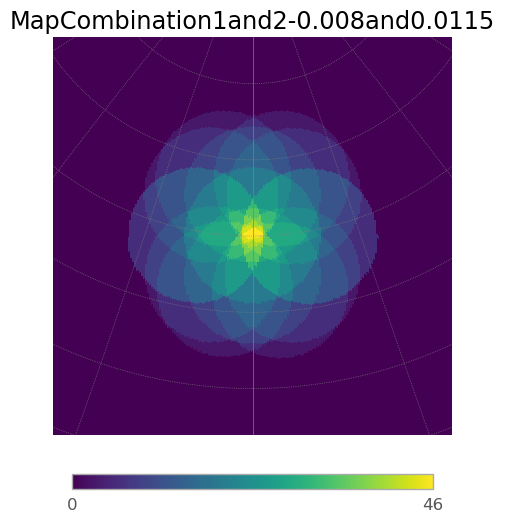

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.33it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.59it/s]
7it [00:01,  5.84it/s]
6it [00:01,  5.94it/s]
7it [00:01,  5.41it/s]
6it [00:01,  5.06it/s]


12.92400673955597


7it [00:01,  5.49it/s]


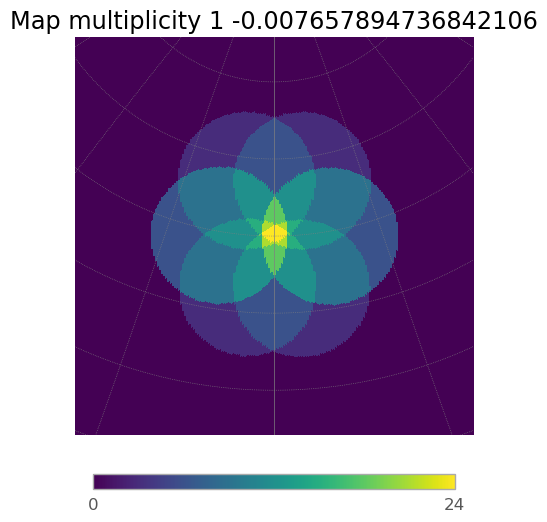

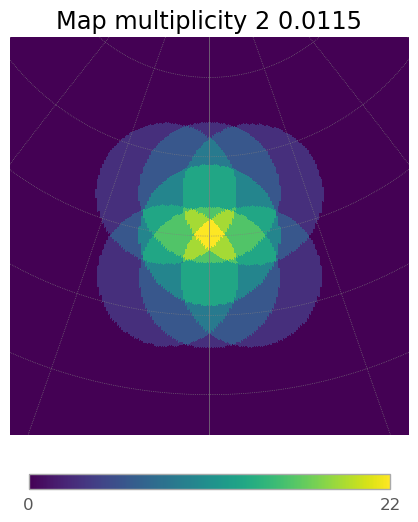

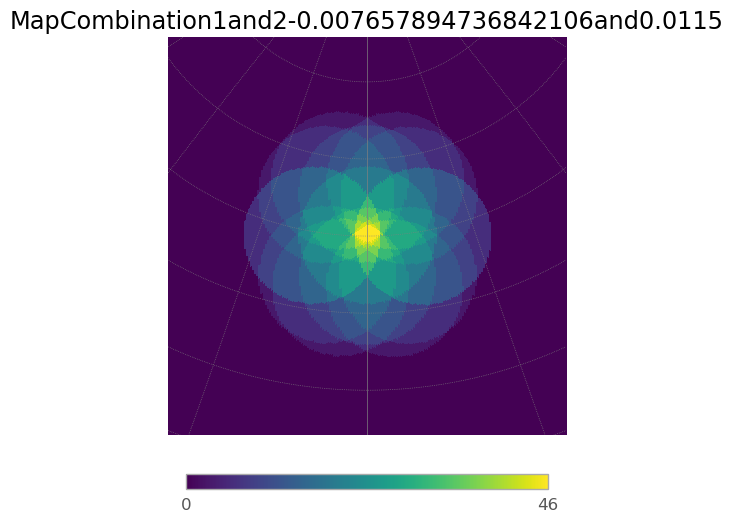

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.84it/s]
7it [00:01,  5.01it/s]
6it [00:01,  4.66it/s]
7it [00:01,  5.38it/s]
6it [00:01,  5.80it/s]
7it [00:01,  5.64it/s]
6it [00:01,  5.70it/s]


12.777253173559846


7it [00:01,  5.72it/s]


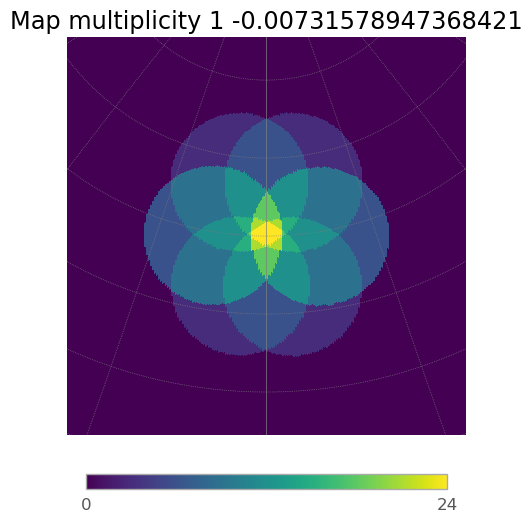

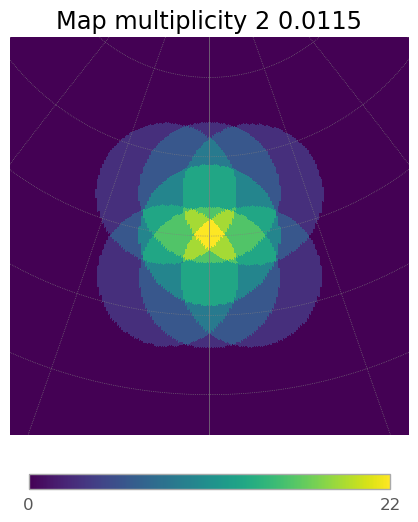

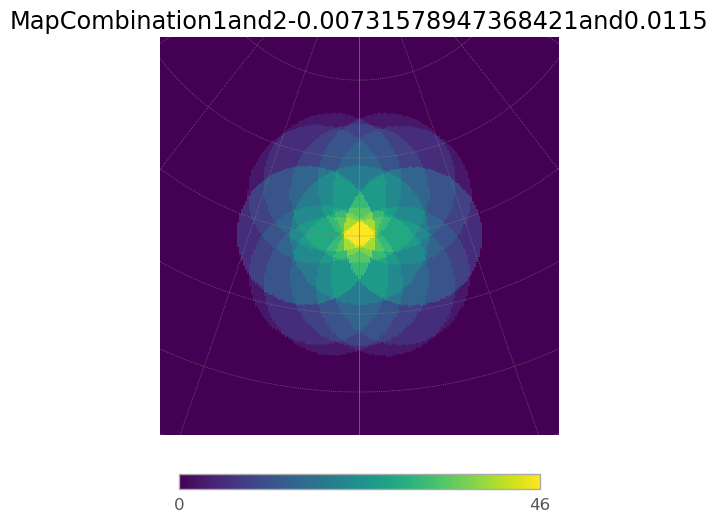

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.36it/s]
7it [00:01,  5.44it/s]
6it [00:01,  5.53it/s]
7it [00:01,  5.77it/s]
6it [00:01,  4.58it/s]
7it [00:01,  5.50it/s]
6it [00:01,  4.03it/s]


12.627950271658865


7it [00:01,  6.20it/s]


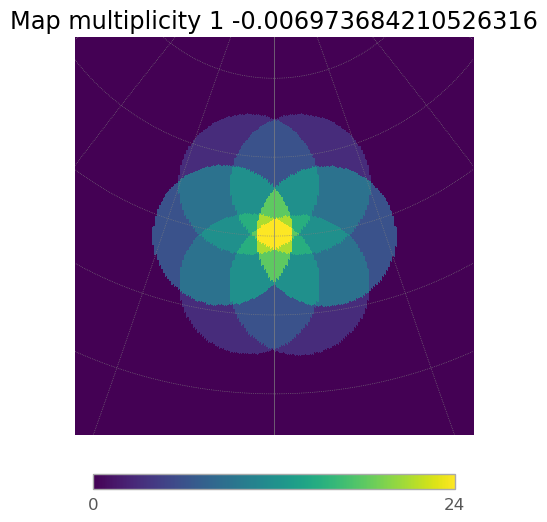

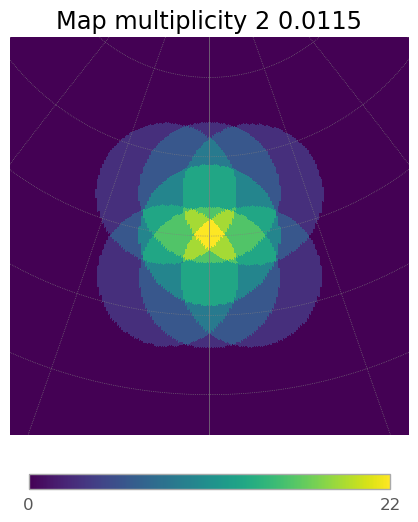

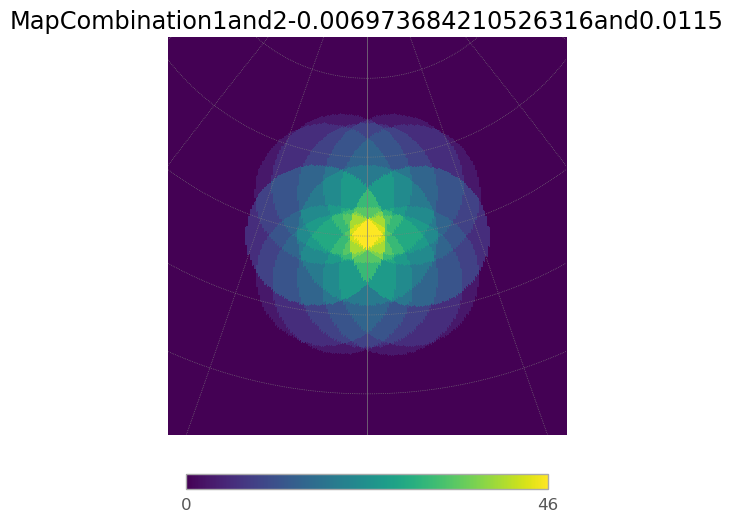

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.29it/s]
7it [00:01,  6.58it/s]
6it [00:00,  6.68it/s]
7it [00:01,  6.82it/s]
6it [00:00,  6.73it/s]
7it [00:01,  6.91it/s]
6it [00:00,  6.15it/s]


12.477899317404567


7it [00:01,  6.64it/s]


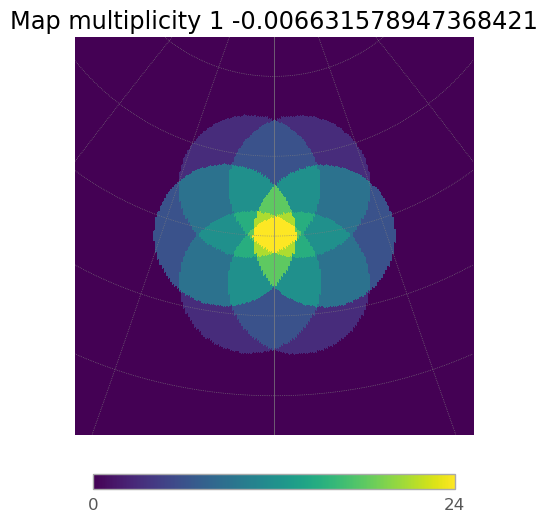

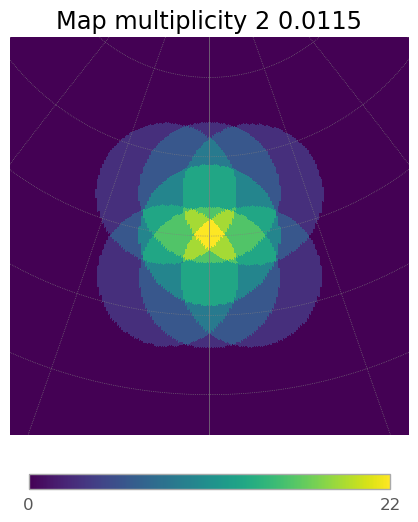

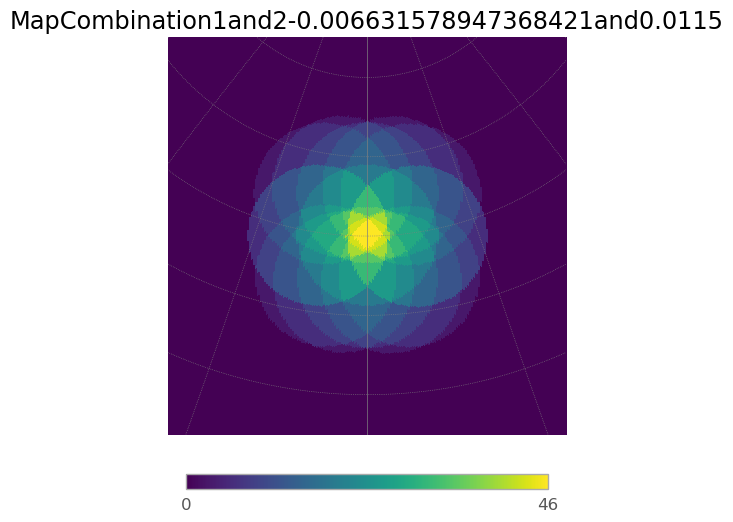

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:00,  6.45it/s]
7it [00:01,  6.80it/s]
6it [00:00,  6.65it/s]
7it [00:01,  6.75it/s]
6it [00:00,  6.93it/s]
7it [00:01,  6.82it/s]
6it [00:00,  6.18it/s]


12.325629936598338


7it [00:01,  6.58it/s]


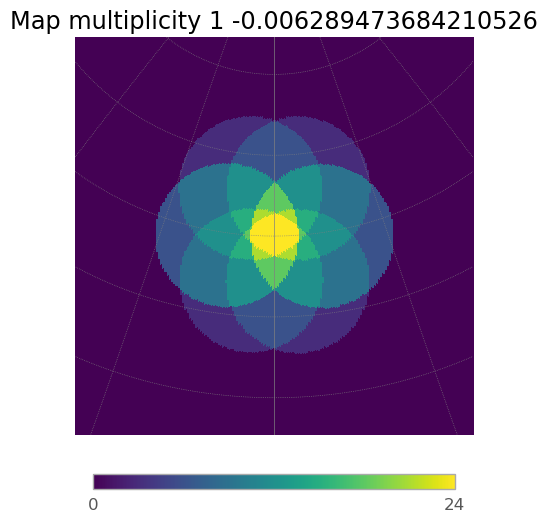

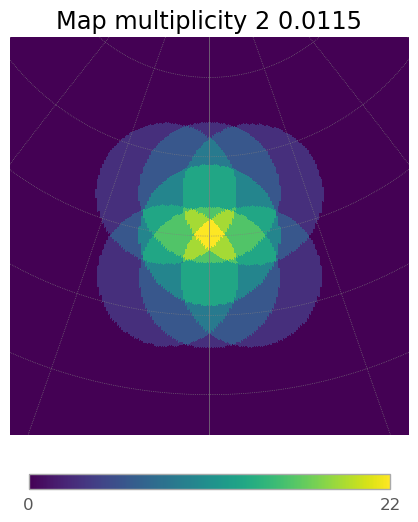

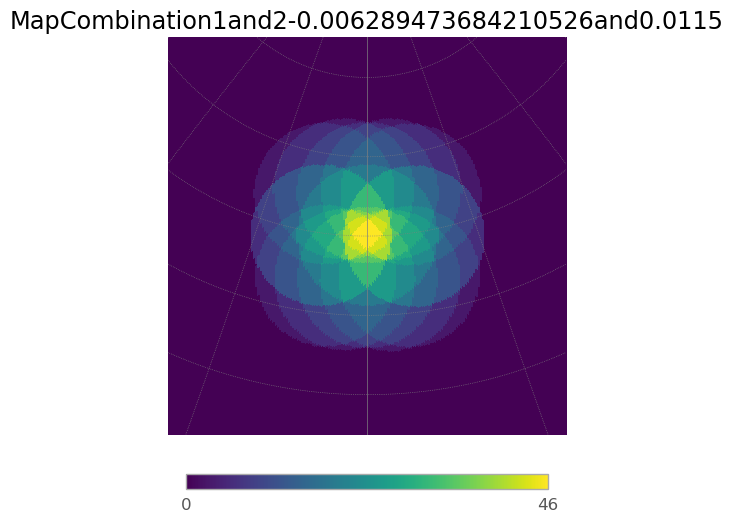

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.78it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.58it/s]
7it [00:01,  5.89it/s]
6it [00:01,  5.75it/s]
7it [00:01,  5.95it/s]
6it [00:01,  5.53it/s]


12.174201697236496


7it [00:01,  5.78it/s]


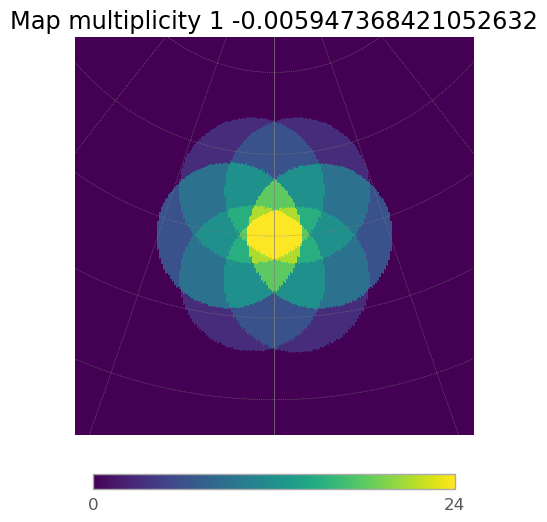

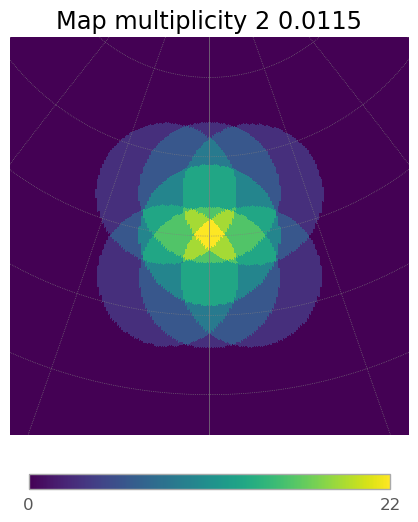

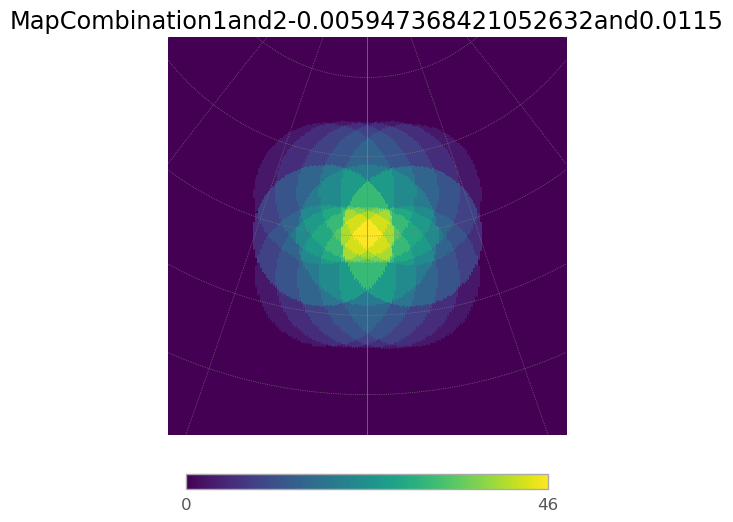

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.62it/s]
7it [00:01,  5.80it/s]
6it [00:01,  5.36it/s]
7it [00:01,  5.60it/s]
6it [00:01,  5.35it/s]
7it [00:01,  5.66it/s]
6it [00:01,  5.23it/s]


12.02129132297544


7it [00:01,  5.39it/s]


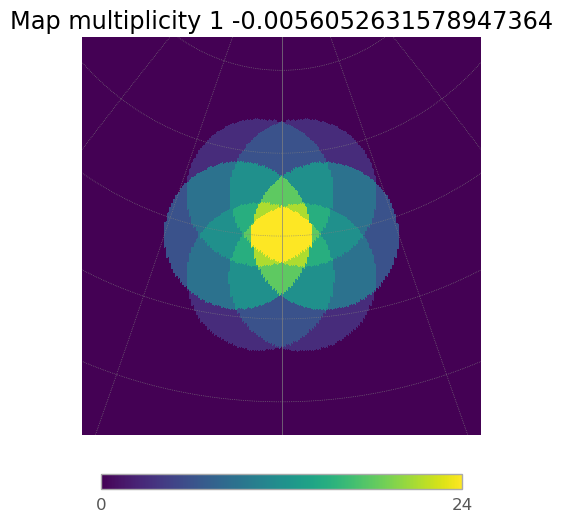

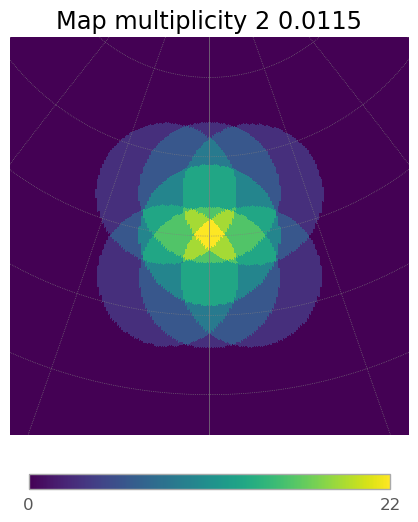

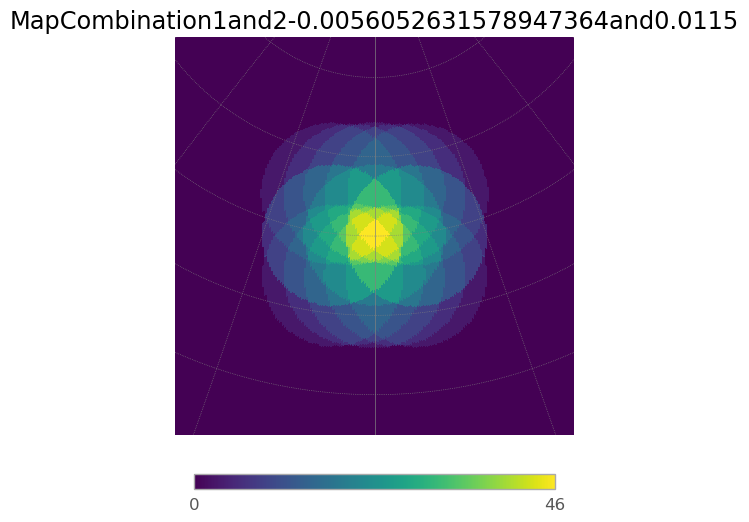

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.42it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.55it/s]
7it [00:01,  5.78it/s]
6it [00:01,  4.35it/s]
7it [00:01,  5.65it/s]
6it [00:01,  4.78it/s]


11.872876079129934


7it [00:01,  5.49it/s]


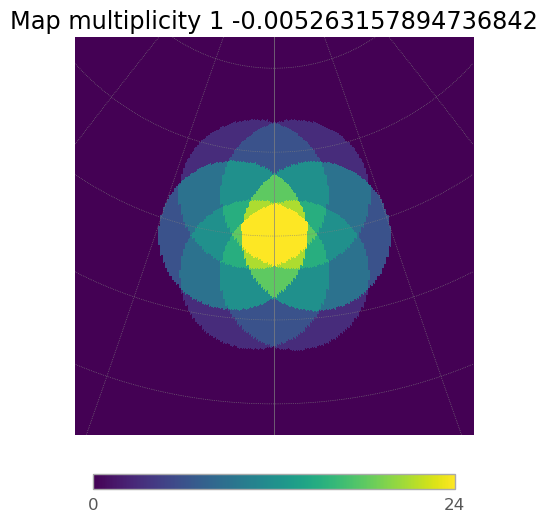

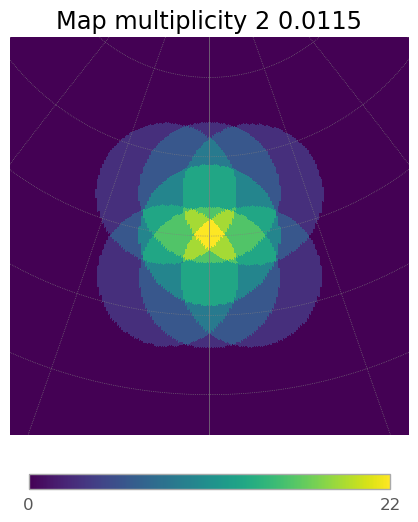

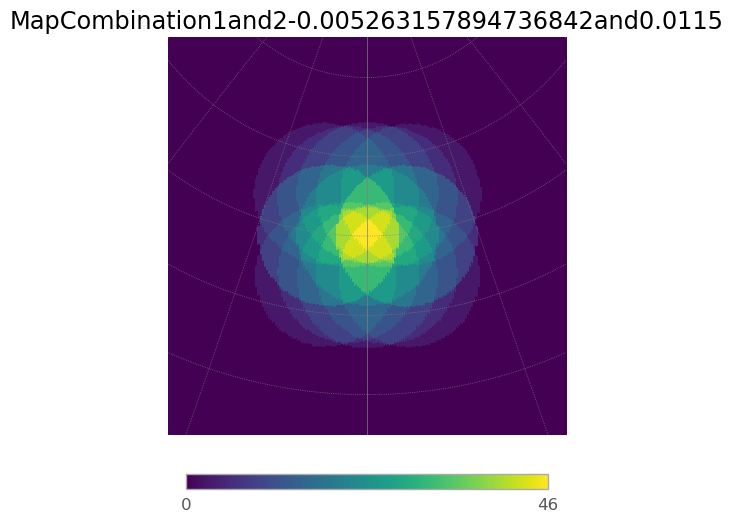

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.10it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.22it/s]
7it [00:01,  5.41it/s]
6it [00:01,  5.15it/s]
7it [00:01,  5.39it/s]
6it [00:01,  5.47it/s]


11.718078320078305


7it [00:01,  5.67it/s]


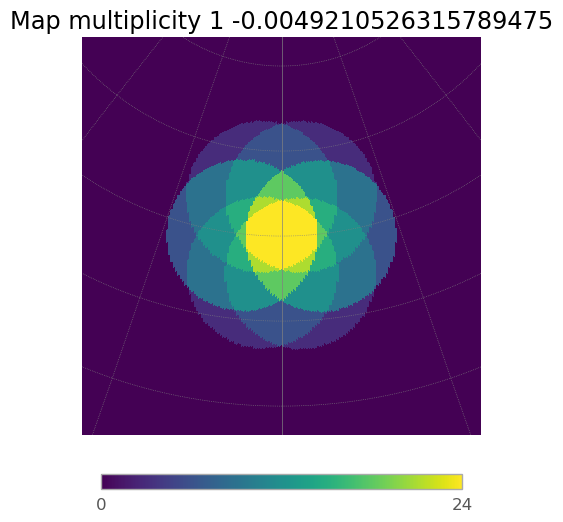

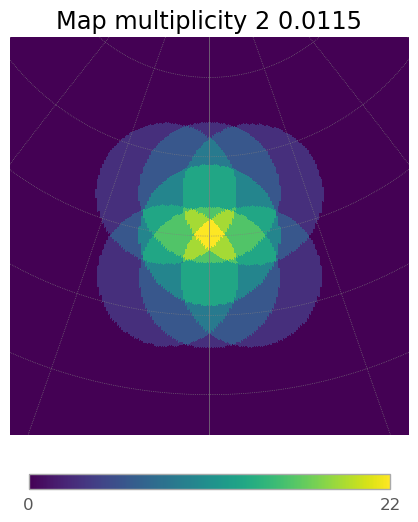

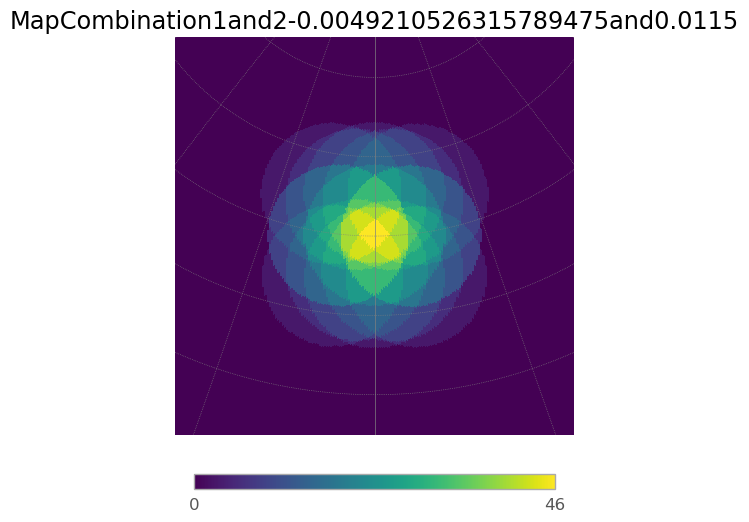

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.34it/s]
7it [00:01,  5.48it/s]
6it [00:01,  5.29it/s]
7it [00:01,  5.17it/s]
6it [00:01,  5.32it/s]
7it [00:01,  5.01it/s]
6it [00:01,  5.39it/s]


11.560264906130477


7it [00:01,  4.36it/s]


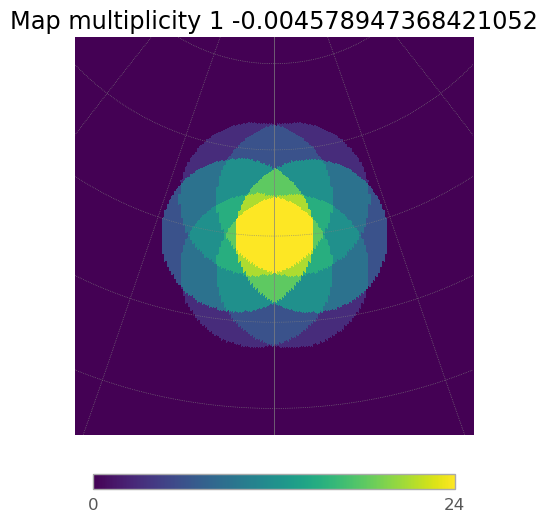

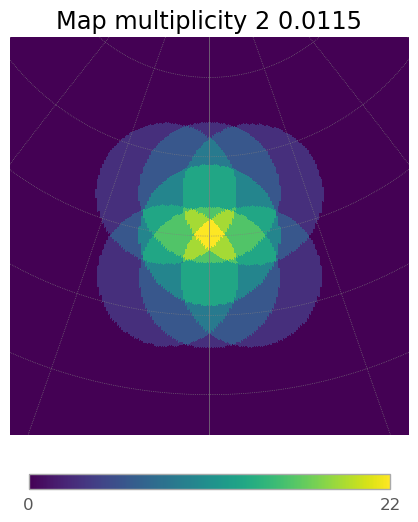

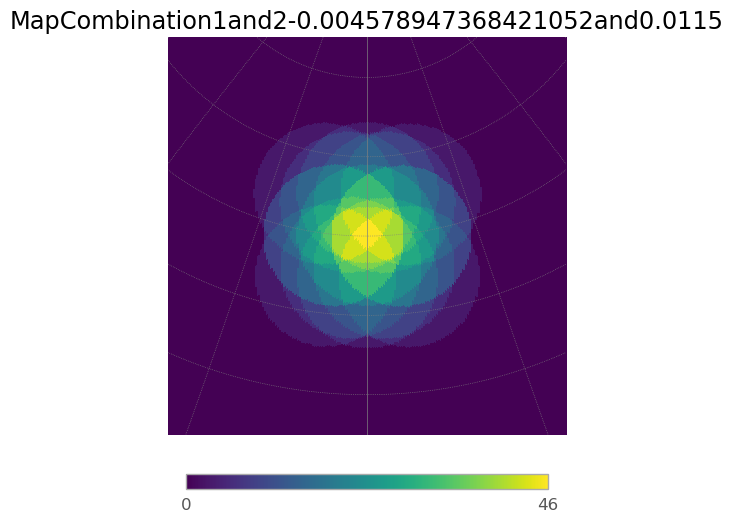

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.08it/s]
7it [00:01,  5.70it/s]
6it [00:01,  5.35it/s]
7it [00:01,  5.60it/s]
6it [00:01,  5.58it/s]
7it [00:01,  5.69it/s]
6it [00:01,  5.69it/s]


11.410943652822338


7it [00:01,  5.62it/s]


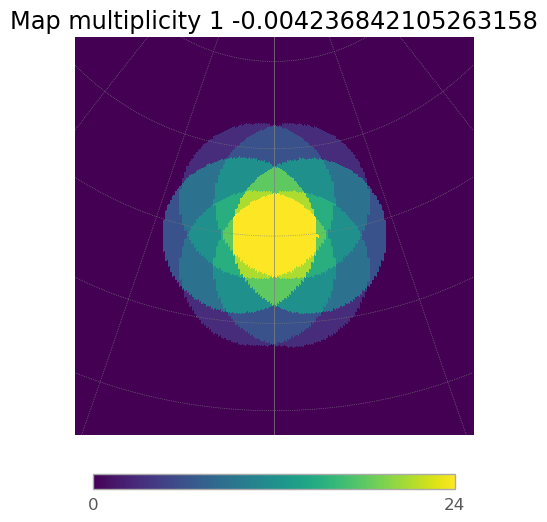

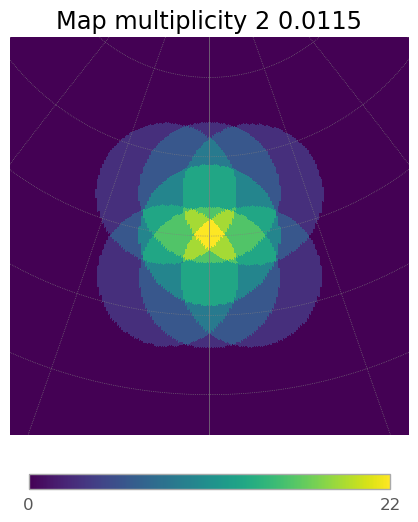

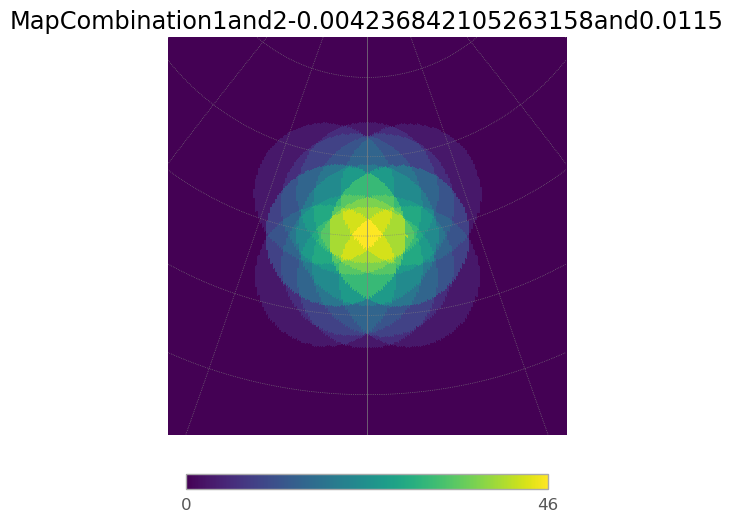

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  3.44it/s]
7it [00:01,  4.70it/s]
6it [00:01,  5.40it/s]
7it [00:01,  4.61it/s]
6it [00:01,  5.87it/s]
7it [00:01,  5.58it/s]
6it [00:01,  5.32it/s]


11.255058166276156


7it [00:01,  5.39it/s]


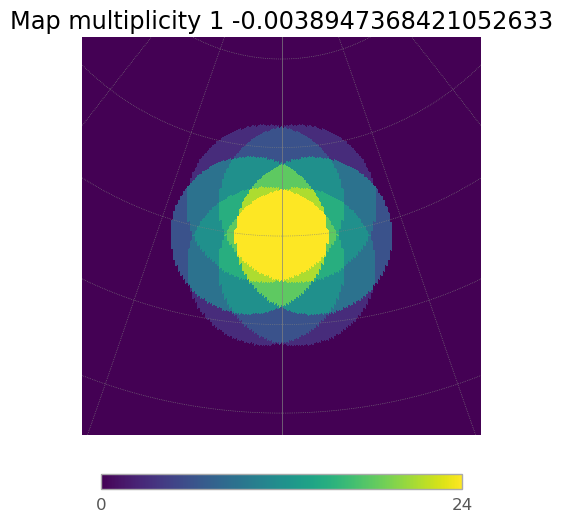

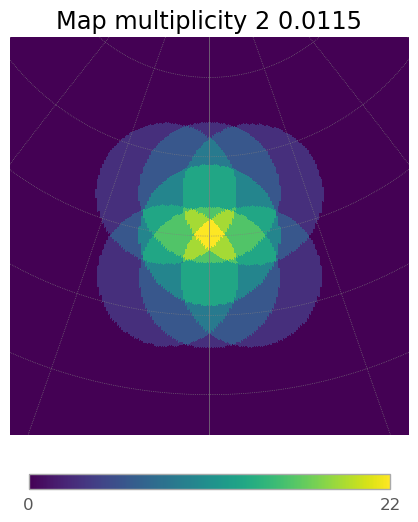

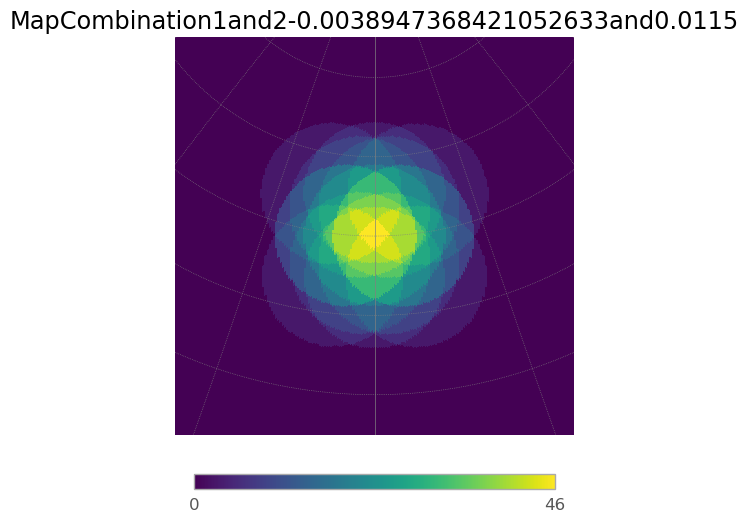

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.52it/s]
7it [00:01,  5.51it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.78it/s]
6it [00:01,  5.14it/s]
7it [00:01,  5.36it/s]
6it [00:01,  5.49it/s]


11.099979267606752


7it [00:01,  5.58it/s]


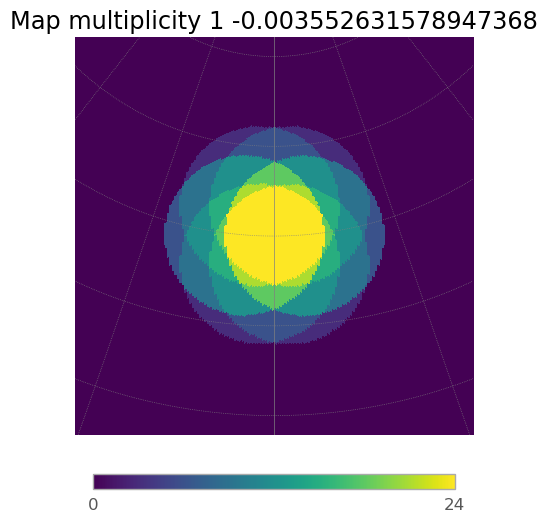

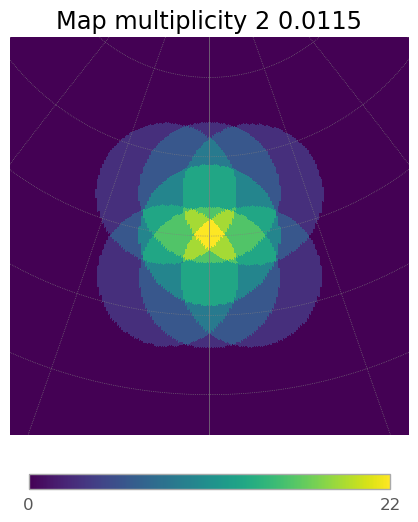

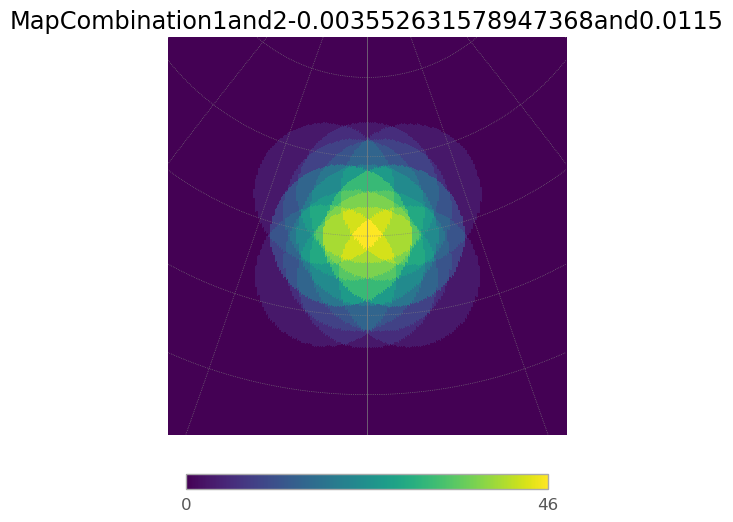

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.65it/s]
7it [00:01,  5.80it/s]
6it [00:01,  5.57it/s]
7it [00:01,  5.71it/s]
6it [00:01,  5.70it/s]
7it [00:01,  5.77it/s]
6it [00:01,  5.36it/s]


10.94471688244769


7it [00:01,  4.92it/s]


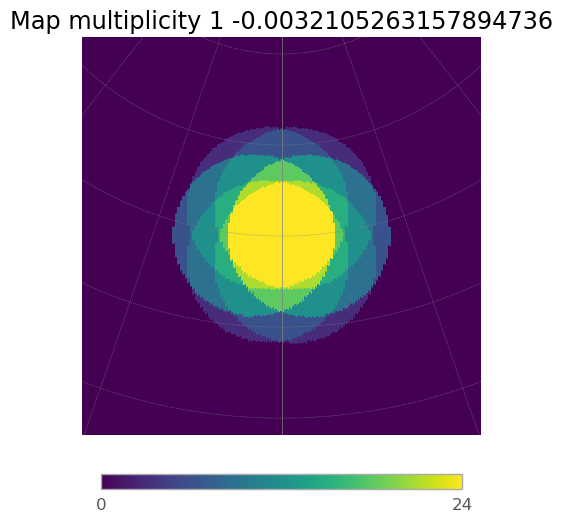

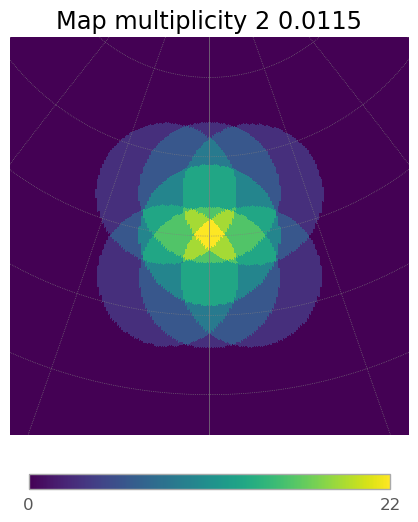

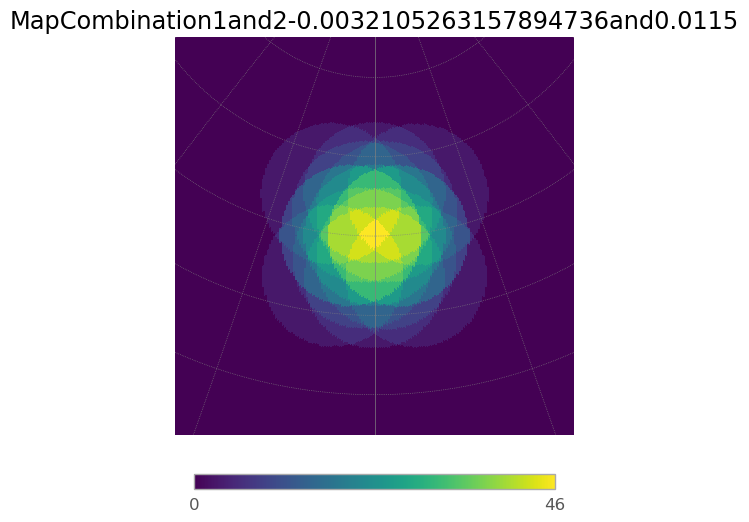

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.07it/s]
7it [00:01,  5.55it/s]
6it [00:01,  5.13it/s]
7it [00:01,  5.37it/s]
6it [00:01,  5.49it/s]
7it [00:01,  5.54it/s]
6it [00:01,  4.16it/s]


10.786010643608968


7it [00:01,  5.26it/s]


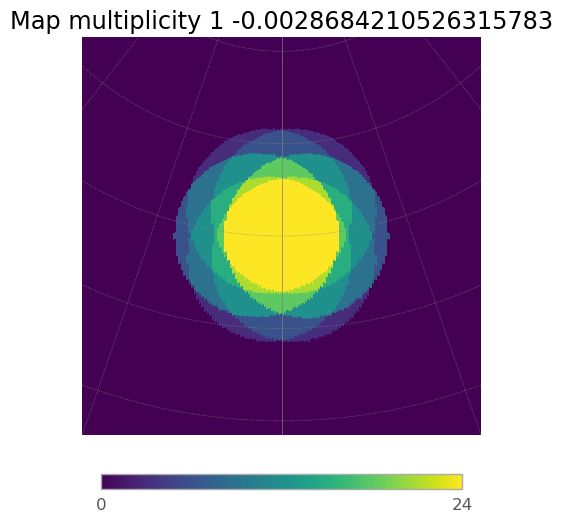

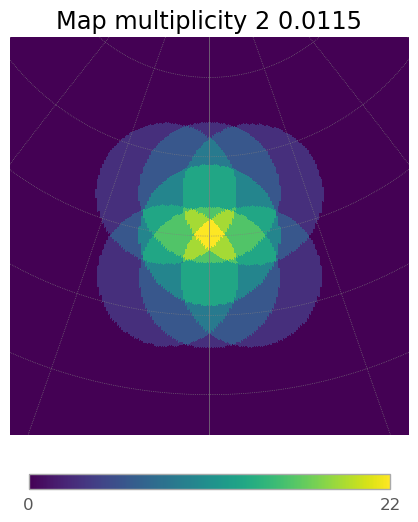

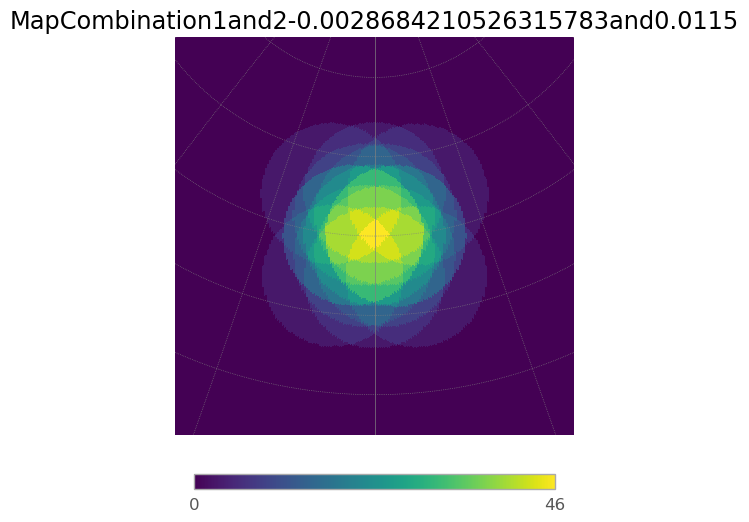

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.90it/s]
7it [00:01,  5.86it/s]
6it [00:01,  5.56it/s]
7it [00:01,  5.77it/s]
6it [00:01,  5.32it/s]
7it [00:01,  5.50it/s]
6it [00:01,  5.57it/s]


10.626537351232152


7it [00:01,  5.53it/s]


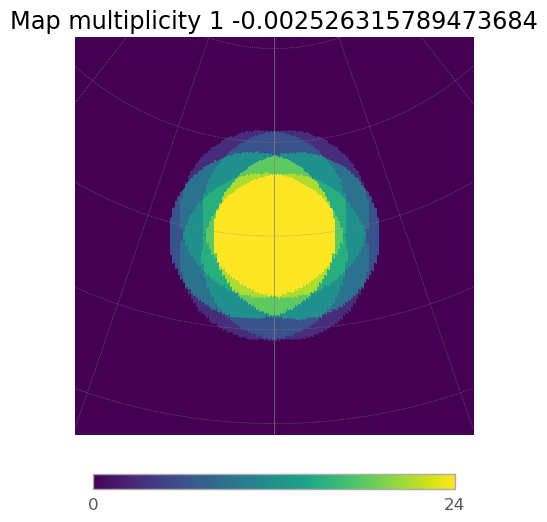

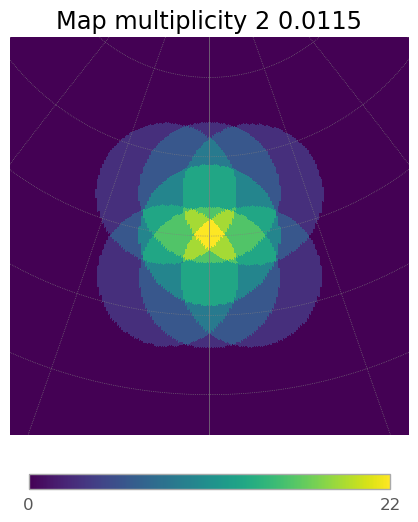

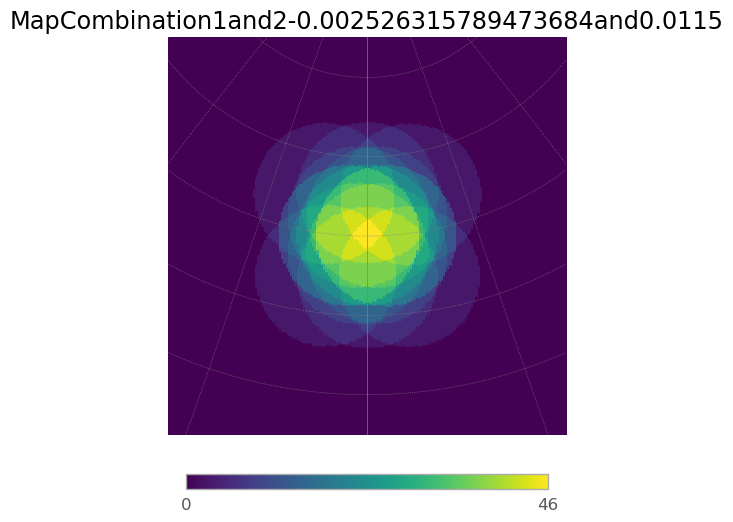

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.34it/s]
7it [00:01,  5.50it/s]
6it [00:01,  5.23it/s]
7it [00:01,  4.82it/s]
6it [00:01,  5.49it/s]
7it [00:01,  5.39it/s]
6it [00:01,  5.30it/s]


10.468520350865969


7it [00:01,  5.38it/s]


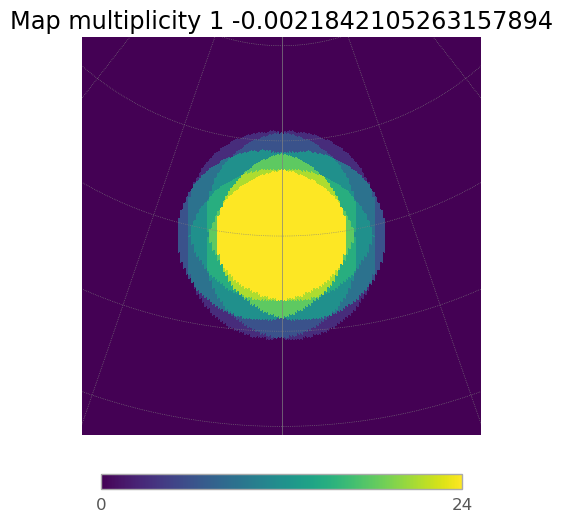

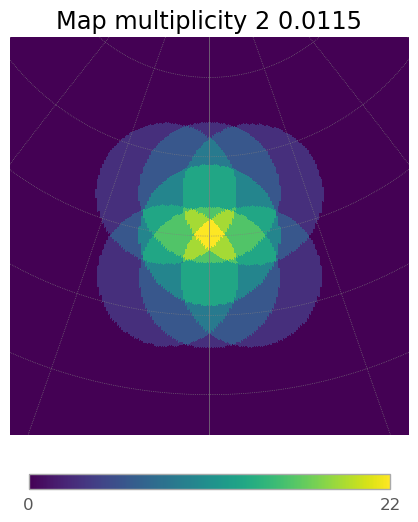

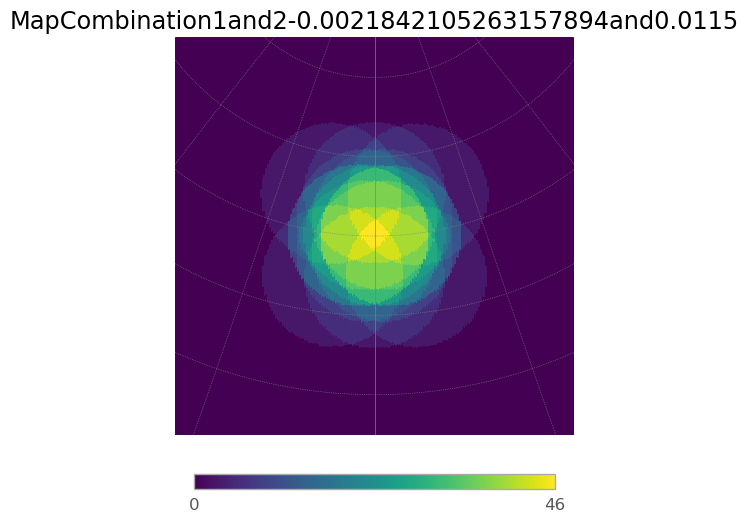

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.49it/s]
7it [00:01,  5.34it/s]
6it [00:01,  5.34it/s]
7it [00:01,  5.05it/s]
6it [00:01,  5.24it/s]
7it [00:01,  5.68it/s]
6it [00:01,  5.44it/s]


10.313268190994826


7it [00:01,  5.48it/s]


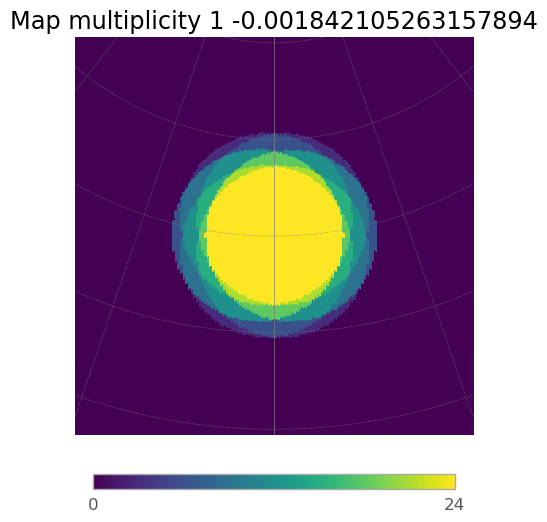

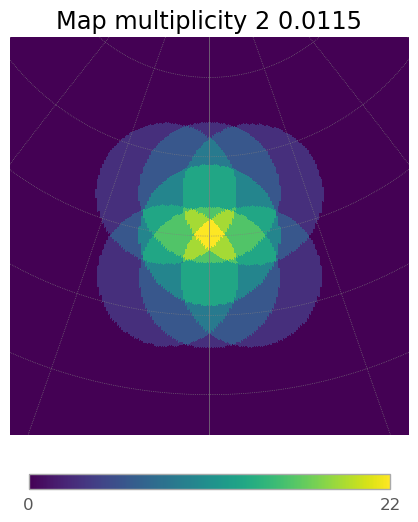

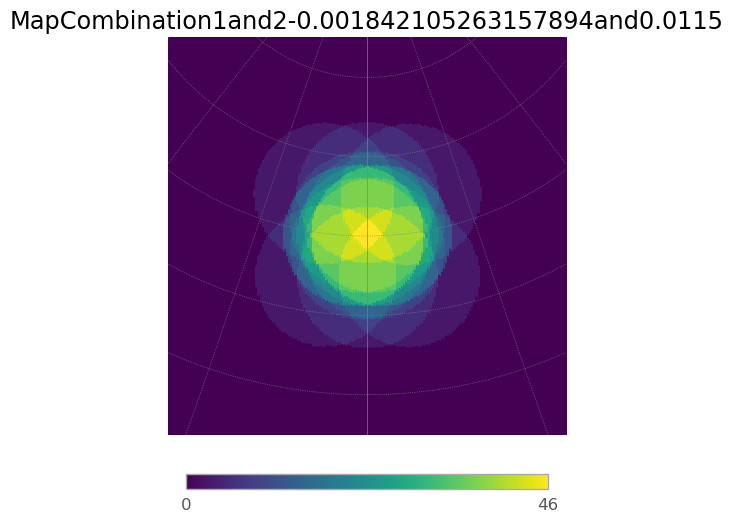

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.38it/s]
7it [00:01,  5.60it/s]
6it [00:01,  5.15it/s]
7it [00:01,  5.45it/s]
6it [00:01,  5.44it/s]
7it [00:01,  5.40it/s]
6it [00:01,  5.42it/s]


10.154555831829411


7it [00:01,  5.33it/s]


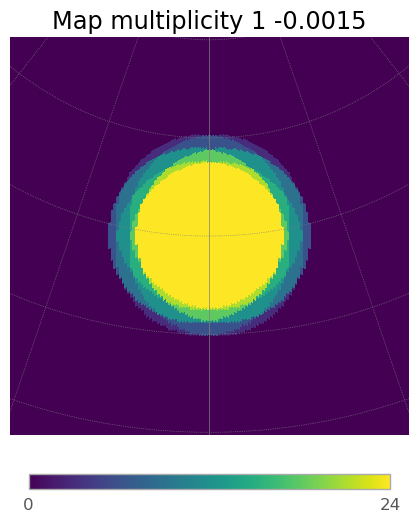

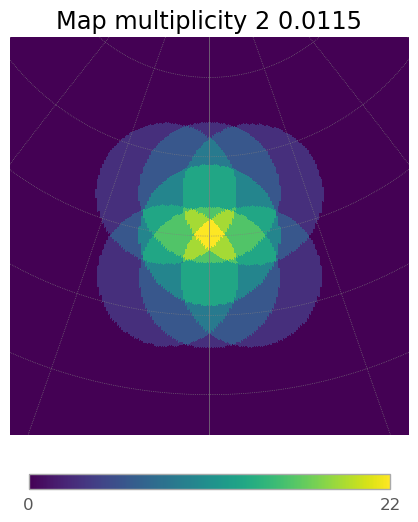

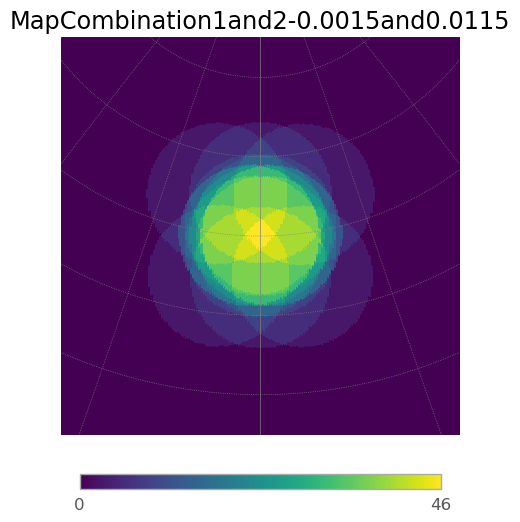

In [64]:
FoV_second_best_conv=[]
multiplicity_second_best_conv=[]
for convergence in conv:  #This is the one that diverges        
    array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=convergence, div2=0.0115, az=0, alt=70)
    FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
    multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
    FoV_second_best_conv.append(FoV)
    multiplicity_second_best_conv.append(multiplicity)
    array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)


-6.117531919482756 rad
-6.212627447878219 rad
-0.07055785930136649 rad
-0.16565338769682958 rad
-0.09968327749706374 rad
-6.183502029682522 rad


6it [00:01,  5.27it/s]
6it [00:01,  5.40it/s]


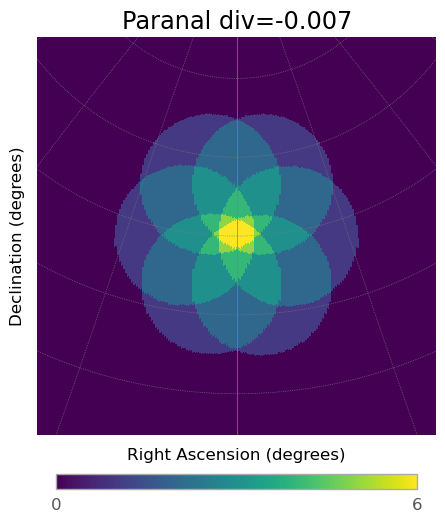

In [65]:
array_conv_2.divergent_pointing(div=-0.007, az=0, alt=70)
array_conv_2.multiplicity_plot()

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.71it/s]
7it [00:01,  5.33it/s]
6it [00:01,  5.02it/s]


12.63943362564255


7it [00:01,  5.52it/s]


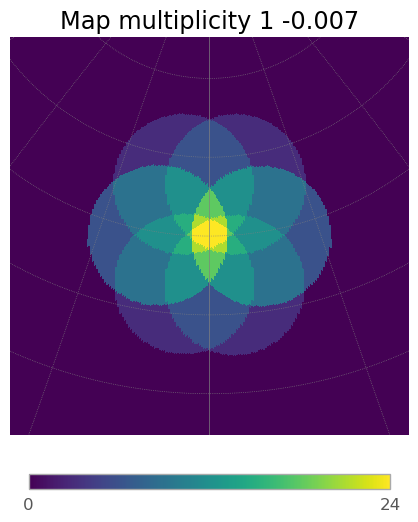

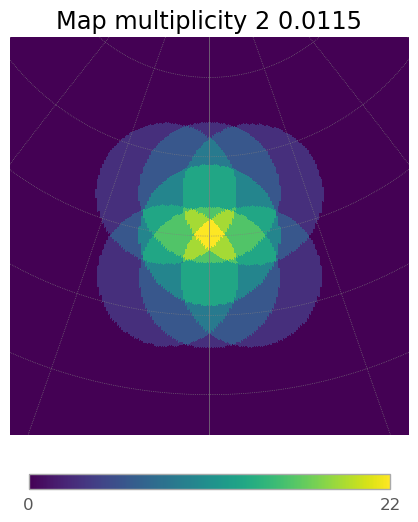

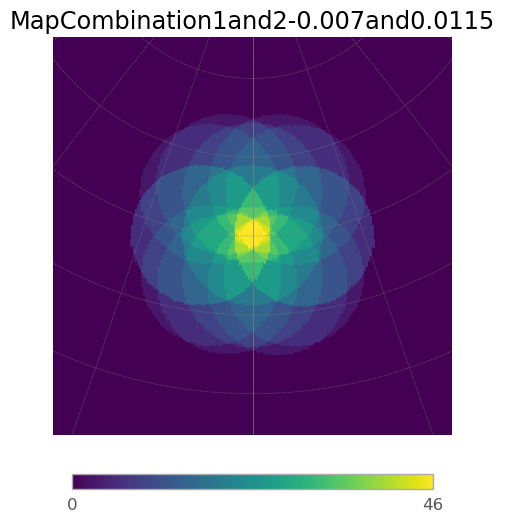

In [66]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=-0.007, div2=0.0115, az=0, alt=70)
array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  5.12it/s]
7it [00:01,  5.73it/s]
6it [00:01,  5.33it/s]
7it [00:01,  5.41it/s]


FoV 193.5883248532382
Multiplicity 14.77645305514158


6it [00:01,  5.30it/s]
7it [00:01,  5.55it/s]
6it [00:01,  5.15it/s]


12.63943362564255


7it [00:01,  4.84it/s]


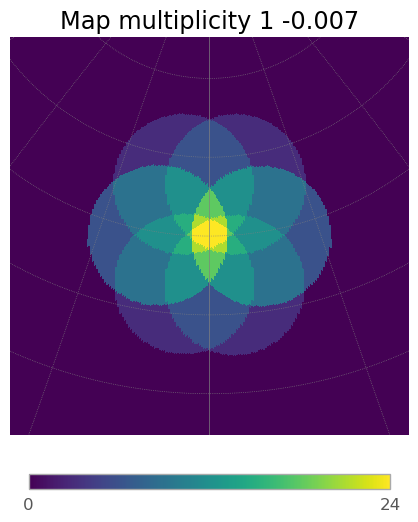

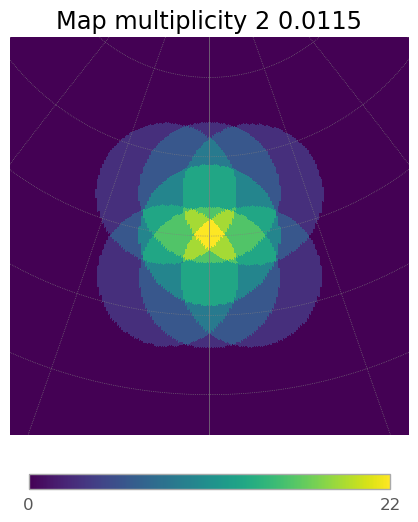

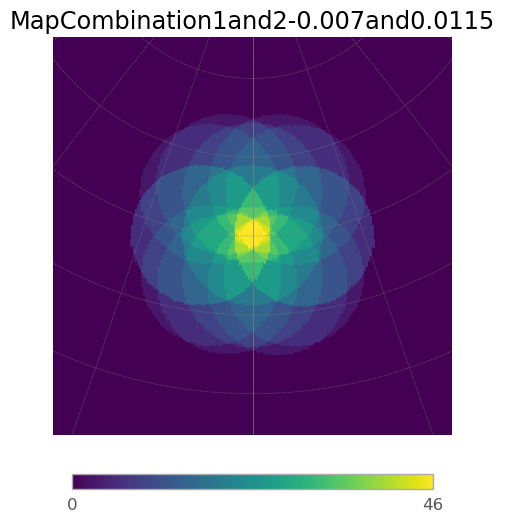

In [67]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=-0.007, div2=0.0115, az=0, alt=70)
FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
print(f"FoV {FoV}")
print(f"Multiplicity {multiplicity}")
multiplicity_second_best_conv.append(multiplicity)
array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)





In [68]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2, div1=0.01, div2=0.0115, az=0, alt=70)
array_conv_2.table

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,0.0,816.83,21.83,346.570,69.464,20.536,5.600,4.450,62.462,0.341,0.081,0.936,816.88
2,-840.0,404.67,16.75,351.088,74.443,15.557,5.600,4.450,62.462,0.265,0.042,0.963,932.41
3,-840.0,-404.67,55.92,8.912,74.505,15.495,5.600,4.450,62.462,0.264,-0.041,0.964,932.62
4,0.0,-816.83,65.42,13.430,69.551,20.449,5.600,4.450,62.462,0.340,-0.081,0.937,817.54
5,839.67,-404.67,17.75,5.426,65.486,24.514,5.600,4.450,62.462,0.413,-0.039,0.910,932.29
6,839.67,404.67,10.08,354.574,65.468,24.532,5.600,4.450,62.462,0.413,0.039,0.910,932.44


In [69]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=-0.01, div2=0.0115, az=0, alt=70)
array_conv_2.table

the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,0.0,816.83,21.83,13.436,69.503,20.497,5.600,4.450,62.462,0.341,-0.081,0.937,816.88
2,-840.0,404.67,16.75,5.427,65.549,24.451,5.600,4.450,62.462,0.412,-0.039,0.910,932.41
3,-840.0,-404.67,55.92,354.573,65.458,24.542,5.600,4.450,62.462,0.413,0.039,0.910,932.62
4,0.0,-816.83,65.42,346.564,69.416,20.584,5.600,4.450,62.462,0.342,0.082,0.936,817.54
5,839.67,-404.67,17.75,351.085,74.489,15.511,5.600,4.450,62.462,0.264,0.041,0.964,932.29
6,839.67,404.67,10.08,8.915,74.501,15.499,5.600,4.450,62.462,0.264,-0.041,0.964,932.44


In [70]:
array_div_2.table

id,x,y,z,az,alt,zn,focal,radius,fov,p_x,p_y,p_z,d_tel
,m,m,m,deg,deg,deg,m,deg,deg2,,,,m
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,-7.75,0.0,22.5,-0.000,70.027,19.973,5.600,4.450,62.462,0.342,0.000,0.940,6.92
2,415.67,402.0,12.42,353.238,67.280,22.720,5.600,4.450,62.462,0.384,0.045,0.922,579.22
3,415.67,-402.0,27.92,6.762,67.319,22.681,5.600,4.450,62.462,0.383,-0.045,0.923,579.10
4,429.33,0.0,16.08,-0.000,67.349,22.651,5.600,4.450,62.462,0.385,0.000,0.923,430.57
5,-415.67,-402.0,48.25,8.928,72.447,17.553,5.600,4.450,62.462,0.298,-0.047,0.953,577.91
6,-415.67,402.0,15.58,351.072,72.381,17.619,5.600,4.450,62.462,0.299,0.047,0.953,577.50
7,-429.67,0.0,29.42,-0.000,72.699,17.301,5.600,4.450,62.462,0.297,0.000,0.955,428.54


the barycenter for the calculations[-0.73913043  0.         29.65217391]
the barycenter for the calculations of the second divergence[-0.73913043  0.         29.65217391]


6it [00:01,  4.57it/s]
7it [00:01,  5.36it/s]
6it [00:01,  4.87it/s]
7it [00:01,  5.03it/s]


FoV 208.7087244302456
Multiplicity 13.70631479736098


6it [00:01,  5.20it/s]
7it [00:01,  5.42it/s]
6it [00:01,  4.98it/s]


13.07274650697345


7it [00:01,  5.34it/s]


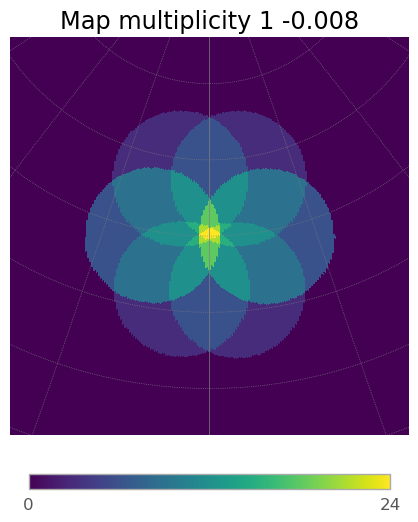

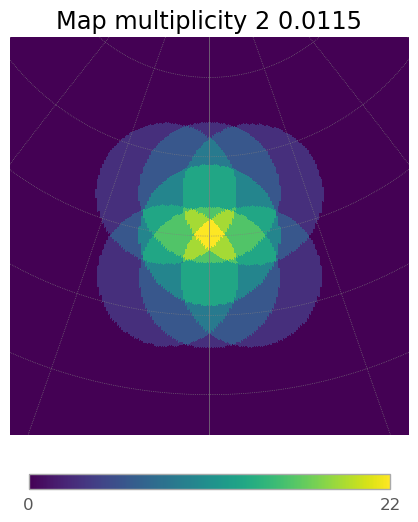

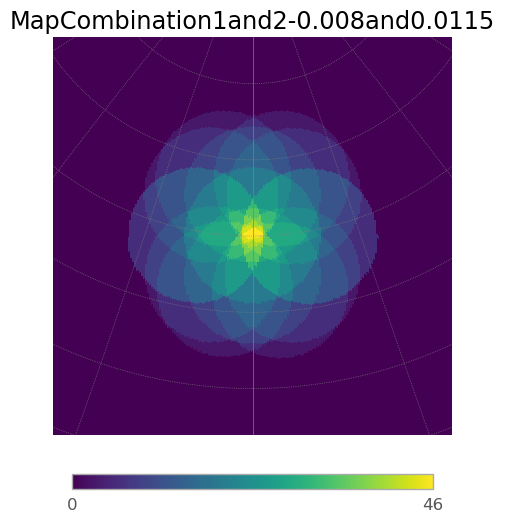

In [71]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=-0.008, div2=0.0115, az=0, alt=70)
FoV=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[0]
multiplicity=array_conv_2.hFoV_for_2_arrays(array_2=array_div_2, subarray_mult=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)[1]
print(f"FoV {FoV}")
print(f"Multiplicity {multiplicity}")
multiplicity_second_best_conv.append(multiplicity)
array_conv_2.multiplicity_plot_2_div(array_div_2, subarray_mult_1=number_of_telescopes_subarray_4_first_half, subarray_mult_2=number_of_telescopes_subarray_4_second_half)



In [72]:
fig, axes = plt.subplots(2, 2, figsize=(20,12)) 
# Plot Full Array
# Full Array with m_cut = 3
l1=axes[0,0].plot(div_full_array, FoV_full_array, label='FoV', marker='o', color='darkgreen')
ax2 = axes[0,0].twinx()
l2=ax2.plot(div_full_array, multiplicity_full_array, label='Multiplicities',marker='*', color='limegreen')
axes[0,0].set_title('Full Array m_cut 3')
axes[0,0].set_xlabel('Divergence')
axes[0,0].set_ylabel('Field of view (m > 3) [deg$^2$]')
ax2.set_ylabel('Multiplicities (m>3)')
axeslegend = l1+l2
axes[0,0].legend(axeslegend, [l.get_label() for l in axeslegend])



#Plot the ones for subarray second best
l1=axes[0,1].plot(div, FoV_second_best, label='FoV',marker='o', color='darkgreen')
ax5=axes[0,1].twinx()
l2=ax5.plot(div, multiplicity_second_best, label='Multiplicity', marker='*', color='limegreen')
axes[0,1].set_title('SUBARRAY INTERSECTING TELESCOPE')
axes[0,1].set_xlabel('Divergence')
axes[0,1].set_ylabel('Field of view [deg$^2$]')
ax5.set_ylabel('Multiplicities')
axeslegend = l1+l2
axes[0,1].legend(axeslegend, [l.get_label() for l in axeslegend])
#Plot but changing the conv not div 


l1=axes[1,0].plot(conv, FoV_second_best_conv, label='FoV',marker='o', color='darkgreen')
ax5=axes[1,0].twinx()
l2=ax5.plot(conv, multiplicity_second_best_conv, label='Multiplicity', marker='*', color='limegreen')
axes[1,0].set_title('Configuration with Two dive with div=0.0115 and varying convergence')
axes[1,0].set_xlabel('Convergence')
axes[1,0].set_ylabel('Field of view [deg$^2$]')
ax5.set_ylabel('Multiplicities')
axeslegend = l1+l2
axes[1,0].legend(axeslegend, [l.get_label() for l in axeslegend])



l1=axes[1,1].plot(conv, FoV_too_much, label='FoV',marker='o', color='darkgreen')
ax5=axes[1,1].twinx()
l2=ax5.plot(conv, multiplicity_too_much, label='Multiplicity', marker='*', color='limegreen')
axes[1,1].set_title('SUBARRAY INTERSECTING TELESCOPE too much')
axes[1,1].set_xlabel('Divergence')
axes[1,1].set_ylabel('Field of view [deg$^2$]')
ax5.set_ylabel('Multiplicities')
axeslegend = l1+l2
axes[1,1].legend(axeslegend, [l.get_label() for l in axeslegend])




# Adjust layout
plt.tight_layout()



plt.show()

ValueError: x and y must have same first dimension, but have shapes (20,) and (22,)

In [ ]:
#plt.plot( FoV_second_best, multiplicity_second_best, label='best',marker='o', color='darkgreen')
plt.plot( FoV_second_best_conv, multiplicity_second_best_conv, label='best_conv',marker='o', color='purple')
plt.plot( FoV_full_array,multiplicity_full_array, label='full',marker='o', color='limegreen')
#plt.plot( FoV_too_much,  multiplicity_too_much, label='too much', marker='o' )
plt.xlabel("FoV")
plt.ylabel("Multiplicity")
plt.legend()
plt.show()

In [ ]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=0.02, div2=0.0115, az=0, alt=70)

In [ ]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=0.02, div2=0.0115, az=0, alt=70)
array_conv_2.table

In [ ]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div_2, div1=-0.02, div2=0.0115, az=0, alt=70)
array_conv_2.table

In [ ]:
array_conv_2.divergent_pointing_2_div(complete_array=full_array, tel_group_2=array_div_2,complete_array=array_SST_2_diff_div_try_2, div1=-0.004, div2=0.0115, az=0, alt=70)
array_conv_2.multiplicity_plot_2_div(array_div_2)
#array_conv_2.multiplicity_plot()

In [ ]:
array_div_2.divergent_pointing(div=-0.0115, az=0, alt=70)
array_div_2.multiplicity_plot()

In [ ]:
ax=array_conv_2.display("xyz")
ax_2 = array_div_2.display("xyz")
plt.show()

In [ ]:
#array_alt_1.display("xyz")
#array_conv_2.divergent_pointing_2_div(tel_group_2=array_div_2, div1=-0.02, div2=0.02, az=0, alt=70)
#fig = plt.figure()
ax = array_conv_2.display("xyz")
ax_2 = array_div_2.display("xyz")
colors = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}
colors_2 = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels_2 = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}
colors_3 = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels_3 = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}

#array_3.display("xyz",color=c,label=label)

for i in range(len(array_conv_2.table)):
    # Color each telescope point according to the FoV
    ax.scatter(array_conv_2.table['x'][i], array_conv_2.table['y'][i], array_conv_2.table['z'][i], 
               color=colors[i], label=fov_labels[colors[i]])
for i in range(len(array_div_2.table)):
    # Color each telescope point according to the FoV
    ax.scatter(array_div_2.table['x'][i], array_div_2.table['y'][i], array_div_2.table['z'][i], 
               color=colors[i], label="violet")

# Display a legend with unique labels
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), loc='lower left')
ax.text2D(0.05, 0.95, "Config of SST ", 
          transform=ax.transAxes, fontsize=18)



plt.show()

In [ ]:
array_conv.divergent_pointing_2_div(complete_array=full_array,tel_group_2=array_div, div1=-0.007, div2=0.01, az=0, alt=60)
array_conv.multiplicity_plot_2_div(array_div, subarray_mult_1=number_of_telescopes_subarray_3_first_half, subarray_mult_2=number_of_telescopes_subarray_3_second_half)

In [ ]:
#array_alt_1.display("xyz")
#fig = plt.figure()
ax = array_div_2.display("xyz")
colors = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}
colors_2 = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels_2 = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}
colors_3 = [
    'lightseagreen' if np.isclose(fov, 14.5356) else
    'blueviolet' if np.isclose(fov, 46.707) else 
    'green' if np.isclose(fov, 62.462) else
    'red'  # Default color if none of the conditions match
    for fov in array.table["fov"]
]
fov_labels_3 = {
    'lightseagreen': 'LST',
    'blueviolet': 'MST',
    'green': 'SST'
}

#array_3.display("xyz",color=c,label=label)

for i in range(len(array_div_2.table)):
    # Color each telescope point according to the FoV
    ax.scatter(array_div_2.table['x'][i], array_div_2.table['y'][i], array_div_2.table['z'][i], 
               color=colors[i], label=fov_labels[colors[i]])

# Display a legend with unique labels
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), loc='lower left')
ax.text2D(0.05, 0.95, "Array_1 of MST ", 
          transform=ax.transAxes, fontsize=18)


plt.show()

In [ ]:
## IN THE MULTIPLICITY PLOTS!!!! THERE IS A PROBLEM WITH THE POINTING THE PI!!!1